<a href="https://colab.research.google.com/github/EbenMY/Ebenezer-Yawlui/blob/main/snrplotslopemethodplot.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

R-squared_Max Marker vs Max Sensor: 0.2852
p-value_Max Marker vs Max Sensor: 0.0004
R-squared_Max Marker vs Min Sensor: 0.0540
p-value_Max Marker vs Min Sensor: 0.1492
R-squared_Min Marker vs Max Sensor: 0.0003
p-value_Min Marker vs Max Sensor: 0.9227
R-squared_Min Marker vs Min Sensor: 0.1427
p-value_Min Marker vs Min Sensor: 0.0162


<function matplotlib.pyplot.show(close=None, block=None)>

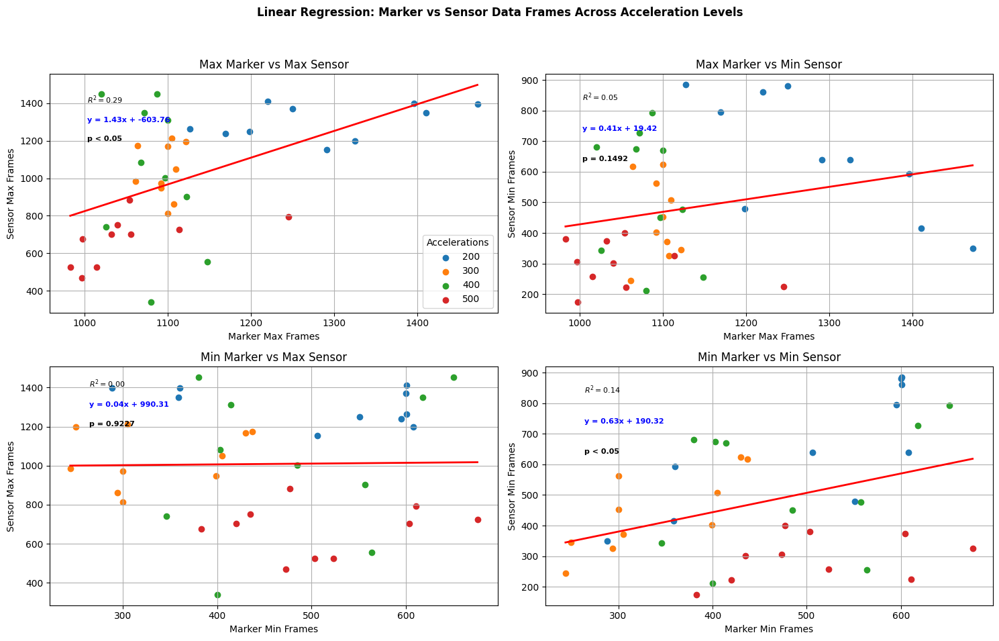

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import statsmodels.api as sm
from statsmodels.tools import add_constant

# Load data
results_table = pd.read_csv('output_results_zero.csv')

# Get unique phase labels (preserving order)
titles = results_table['PhaseLabel'].drop_duplicates().tolist()
rang = range(len(titles))  # Corresponds to MATLAB rang = 1:length(titles)

fig, axs = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('Linear Regression: Marker vs Sensor Data Frames Across Acceleration Levels', fontsize=12, fontweight='bold')

# ---------------- Function to do each plot ----------------
def plot_regression(ax, M_col, S_col, plot_title, xlab, ylab, show_legend=False):
    M_all = []
    S_all = []

    for i in rang:
        phase_label = titles[i]
        filtered = results_table[results_table['PhaseLabel'] == phase_label]
        M = filtered[M_col].values
        S = filtered[S_col].values

        M_all.extend(M)
        S_all.extend(S)

        ax.scatter(M, S, label=str(phase_label))

    # Convert to numpy arrays for regression
    M_all_np = np.array(M_all)
    S_all_np = np.array(S_all)

    # Add constant for intercept
    M_with_const = add_constant(M_all_np)
    model = sm.OLS(S_all_np, M_with_const).fit()

    # Regression line
    x_fit = np.linspace(M_all_np.min(), M_all_np.max(), 100)
    y_fit = model.params[0] + model.params[1] * x_fit
    ax.plot(x_fit, y_fit, 'r-', linewidth=2)

    # Annotations
    R2_val = model.rsquared
    slope = model.params[1]
    intercept = model.params[0]
    p_val = model.pvalues[1]

    x_text = M_all_np.min() + 20
    y_text_top = S_all_np.max() - 50
    line_spacing = 100

    ax.text(x_text, y_text_top, f'$R^2 = {R2_val:.2f}$', fontsize=8, fontweight='bold', color='k')
    ax.text(x_text, y_text_top - line_spacing, f'y = {slope:.2f}x + {intercept:.2f}', fontsize=8, fontweight='bold', color='b')
    ax.text(x_text, y_text_top - 2 * line_spacing, f'p = {p_val:.4f}' if p_val >= 0.05 else 'p < 0.05', fontsize=8, fontweight='bold', color='k')

    ax.set_title(plot_title)
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)
    ax.grid(True)

    if show_legend:
        ax.legend(title='Accelerations', loc='best')

    # Print stats
    print(f'R-squared_{plot_title}: {R2_val:.4f}')
    print(f'p-value_{plot_title}: {p_val:.4f}')


# ---------------- FIRST plot: Max vs Max (legend shown here) ----------------
plot_regression(
    axs[0, 0],
    'Marker_Max_Frame',
    'Sensor_Max_Frame',
    'Max Marker vs Max Sensor',
    'Marker Max Frames',
    'Sensor Max Frames',
    show_legend=True  # Show legend only in this subplot
)

# ---------------- SECOND plot: Max vs Min ----------------
plot_regression(
    axs[0, 1],
    'Marker_Max_Frame',
    'Sensor_Min_Frame',
    'Max Marker vs Min Sensor',
    'Marker Max Frames',
    'Sensor Min Frames'
)

# ---------------- THIRD plot: Min vs Max ----------------
plot_regression(
    axs[1, 0],
    'Marker_Min_Frame',
    'Sensor_Max_Frame',
    'Min Marker vs Max Sensor',
    'Marker Min Frames',
    'Sensor Max Frames'
)

# ---------------- FOURTH plot: Min vs Min ----------------
plot_regression(
    axs[1, 1],
    'Marker_Min_Frame',
    'Sensor_Min_Frame',
    'Min Marker vs Min Sensor',
    'Marker Min Frames',
    'Sensor Min Frames'
)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Leave space for title
plt.show



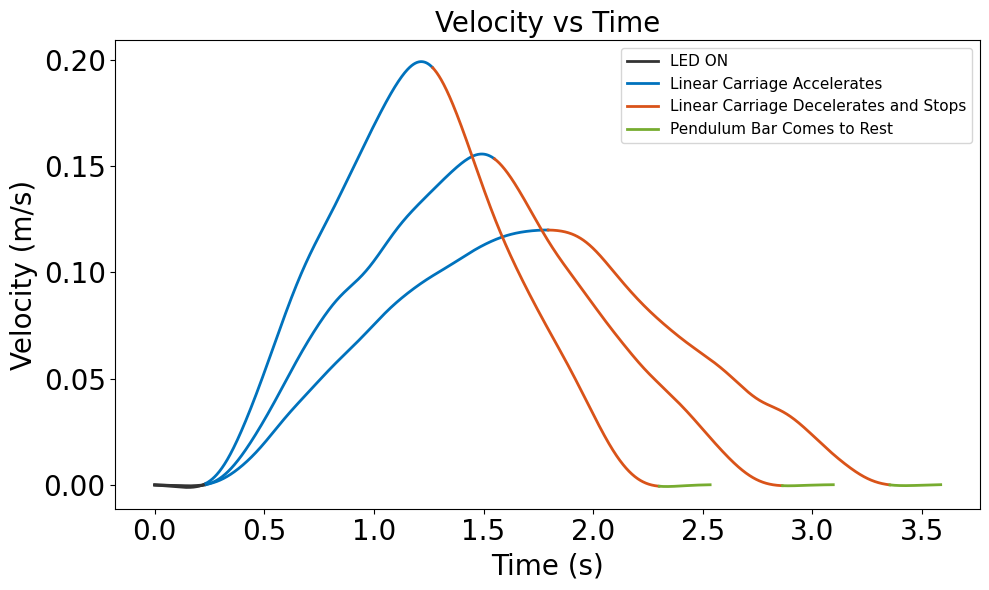

In [ ]:
# ===================== PHASE-COLORED COMBINED VELOCITY PLOT =====================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# -------------------------------------------------
# Scale factor
# -------------------------------------------------
scale_px_to_m = 0.0005

# -------------------------------------------------
# Profile definitions
# -------------------------------------------------
profiles = [
    (
        "200K_marker_interpolated_600Hz.csv",
        {"LED": (6000, 6139), "ACC": (6140, 8011), "REST": (8012, 8151)},
        "Acceleration 200"
    ),
    (
        "300K_marker_interpolated_600Hz.csv",
        {"LED": (5097, 5236), "ACC": (5237, 6814), "REST": (6815, 6954)},
        "Acceleration 300"
    ),
    (
        "500K_marker_interpolated_600Hz.csv",
        {"LED": (6334, 6473), "ACC": (6474, 7714), "REST": (7715, 7854)},
        "Acceleration 500"
    )
]

# -------------------------------------------------
# Phase colors (shared across accelerations)
# -------------------------------------------------
c_LED  = (0.2, 0.2, 0.2)        # dark gray
c_ACC  = (0.0, 0.447, 0.741)    # blue
c_DEC  = (0.850, 0.325, 0.098)  # orange
c_REST = (0.466, 0.674, 0.188)  # green

# -------------------------------------------------
# Create figure
# -------------------------------------------------
plt.figure(figsize=(10, 6))

legend_handles = {}

# -------------------------------------------------
# Loop through profiles
# -------------------------------------------------
for filename, ranges, label in profiles:

    # Read CSV (assumes first column = time, second = velocity)
    data = pd.read_csv(filename, header=None).values

    time_s  = data[:, 0]
    vel_m_s = data[:, 1] * scale_px_to_m

    # ===== LED ON =====
    led_start, led_end = ranges["LED"]
    idx = np.arange(led_start, led_end + 1)
    t0 = time_s[idx[0]]

    h, = plt.plot(time_s[idx] - t0, vel_m_s[idx],
                  color=c_LED, linewidth=2)
    legend_handles.setdefault("LED", h)

    # ===== ACCELERATION (split into two halves) =====
    acc_start, acc_end = ranges["ACC"]
    acc_idx = np.arange(acc_start, acc_end + 1)
    mid_pt = acc_idx[len(acc_idx) // 2]

    # Accelerating
    idx = np.arange(acc_start, mid_pt + 1)
    h, = plt.plot(time_s[idx] - t0, vel_m_s[idx],
                  color=c_ACC, linewidth=2)
    legend_handles.setdefault("ACC", h)

    # Decelerating
    idx = np.arange(mid_pt + 1, acc_end + 1)
    h, = plt.plot(time_s[idx] - t0, vel_m_s[idx],
                  color=c_DEC, linewidth=2)
    legend_handles.setdefault("DEC", h)

    # ===== REST =====
    rest_start, rest_end = ranges["REST"]
    idx = np.arange(rest_start, rest_end + 1)
    h, = plt.plot(time_s[idx] - t0, vel_m_s[idx],
                  color=c_REST, linewidth=2)
    legend_handles.setdefault("REST", h)

    plt.tick_params(axis='both', labelsize=20)

# -------------------------------------------------
# Legend (single entry per phase)
# -------------------------------------------------
plt.legend(
    [legend_handles["LED"],
     legend_handles["ACC"],
     legend_handles["DEC"],
     legend_handles["REST"]],
    [
        "LED ON",
        "Linear Carriage Accelerates",
        "Linear Carriage Decelerates and Stops",
        "Pendulum Bar Comes to Rest"
    ],
    loc="best",
    fontsize=11

)



# -------------------------------------------------
# Labels & formatting
# -------------------------------------------------
plt.xlabel("Time (s)", fontsize=20)
plt.ylabel("Velocity (m/s)", fontsize=20)
plt.title("Velocity vs Time", fontsize=20)
plt.grid(False)
plt.tight_layout()
plt.show()


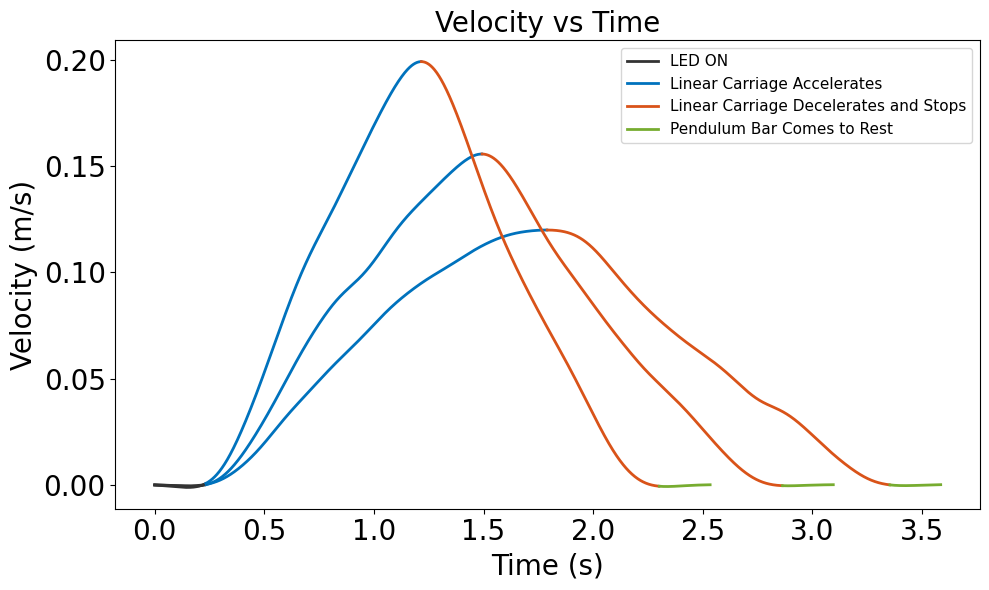

In [ ]:
# ===================== PHASE-COLORED COMBINED VELOCITY PLOT =====================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# -------------------------------------------------
# Scale factor
# -------------------------------------------------
scale_px_to_m = 0.0005

# -------------------------------------------------
# Profile definitions
# -------------------------------------------------
profiles = [
    (
        "200K_marker_interpolated_600Hz.csv",
        {"LED": (6000, 6139), "ACC": (6140, 8011), "REST": (8012, 8151)},
        "Acceleration 200"
    ),
    (
        "300K_marker_interpolated_600Hz.csv",
        {"LED": (5097, 5236), "ACC": (5237, 6814), "REST": (6815, 6954)},
        "Acceleration 300"
    ),
    (
        "500K_marker_interpolated_600Hz.csv",
        {"LED": (6334, 6473), "ACC": (6474, 7714), "REST": (7715, 7854)},
        "Acceleration 500"
    )
]

# -------------------------------------------------
# Phase colors
# -------------------------------------------------
c_LED  = (0.2, 0.2, 0.2)        # dark gray
c_ACC  = (0.0, 0.447, 0.741)    # blue
c_DEC  = (0.850, 0.325, 0.098)  # orange
c_REST = (0.466, 0.674, 0.188)  # green

# -------------------------------------------------
# Create figure
# -------------------------------------------------
plt.figure(figsize=(10, 6))
legend_handles = {}

# -------------------------------------------------
# Loop through profiles
# -------------------------------------------------
for filename, ranges, label in profiles:

    # Read CSV (time, velocity)
    data = pd.read_csv(filename, header=None).values

    time_s  = data[:, 0]
    vel_m_s = data[:, 1] * scale_px_to_m

    # ===== LED ON =====
    led_start, led_end = ranges["LED"]
    idx = np.arange(led_start, led_end + 1)
    t0 = time_s[idx[0]]

    h, = plt.plot(time_s[idx] - t0, vel_m_s[idx],
                  color=c_LED, linewidth=2)
    legend_handles.setdefault("LED", h)

    # ===== ACCELERATION (MAX-BASED SPLIT) =====
    acc_start, acc_end = ranges["ACC"]
    acc_idx = np.arange(acc_start, acc_end + 1)

    # Find index of maximum velocity within ACC phase
    vel_acc = vel_m_s[acc_idx]
    max_local_idx = np.argmax(vel_acc)
    max_idx = acc_idx[max_local_idx]

    # --- Accelerating: before max velocity ---
    idx = np.arange(acc_start, max_idx + 1)
    h, = plt.plot(time_s[idx] - t0, vel_m_s[idx],
                  color=c_ACC, linewidth=2)
    legend_handles.setdefault("ACC", h)

    # --- Decelerating: after max velocity ---
    idx = np.arange(max_idx + 1, acc_end + 1)
    h, = plt.plot(time_s[idx] - t0, vel_m_s[idx],
                  color=c_DEC, linewidth=2)
    legend_handles.setdefault("DEC", h)

    # ===== REST =====
    rest_start, rest_end = ranges["REST"]
    idx = np.arange(rest_start, rest_end + 1)
    h, = plt.plot(time_s[idx] - t0, vel_m_s[idx],
                  color=c_REST, linewidth=2)
    legend_handles.setdefault("REST", h)

    plt.tick_params(axis='both', labelsize=20)

# -------------------------------------------------
# Legend
# -------------------------------------------------
plt.legend(
    [legend_handles["LED"],
     legend_handles["ACC"],
     legend_handles["DEC"],
     legend_handles["REST"]],
    [
        "LED ON",
        "Linear Carriage Accelerates",
        "Linear Carriage Decelerates and Stops",
        "Pendulum Bar Comes to Rest"
    ],
    loc="best",
    fontsize=11
)

# -------------------------------------------------
# Labels & formatting
# -------------------------------------------------
plt.xlabel("Time (s)", fontsize=20)
plt.ylabel("Velocity (m/s)", fontsize=20)
plt.title("Velocity vs Time", fontsize=20)
plt.grid(False)
plt.tight_layout()
plt.show()


Spearman rho (Max Marker vs Max Sensor): 0.5332
p-value (Max Marker vs Max Sensor): 0.0004
Spearman rho (Max Marker vs Min Sensor): 0.3386
p-value (Max Marker vs Min Sensor): 0.0326
Spearman rho (Min Marker vs Max Sensor): 0.0245
p-value (Min Marker vs Max Sensor): 0.8808
Spearman rho (Min Marker vs Min Sensor): 0.3158
p-value (Min Marker vs Min Sensor): 0.0471


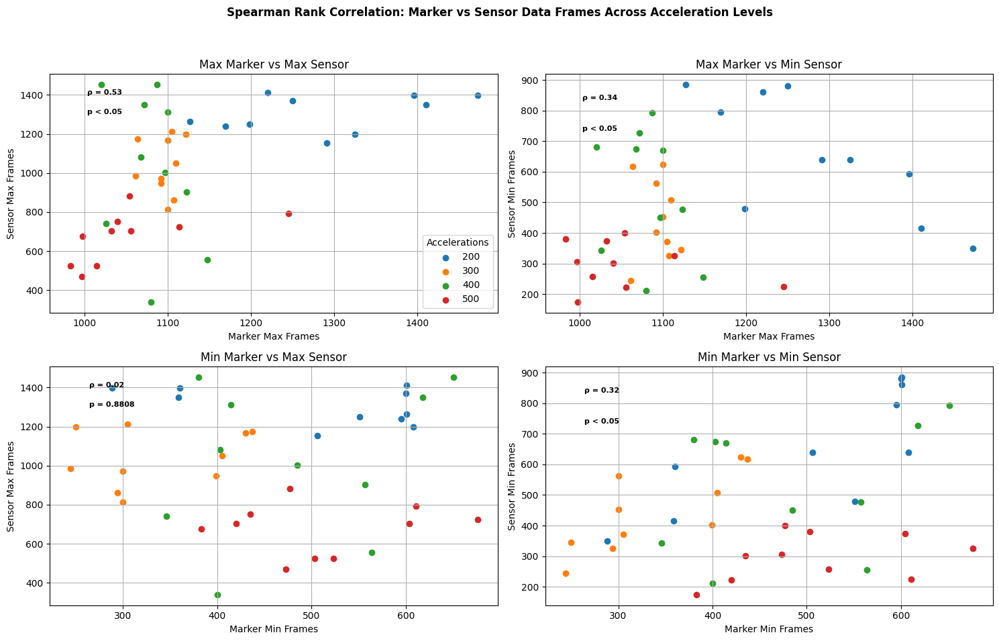

UsageError: Line magic function `%%` not found.


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import spearmanr

# Load data
results_table = pd.read_csv('output_results_zero.csv')

# Get unique phase labels (preserving order)
titles = results_table['PhaseLabel'].drop_duplicates().tolist()
rang = range(len(titles))  # same as MATLAB rang = 1:length(titles)

fig, axs = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('Spearman Rank Correlation: Marker vs Sensor Data Frames Across Acceleration Levels', fontsize=12, fontweight='bold')

# ---------------- Function for each plot ----------------
def plot_spearman(ax, M_col, S_col, plot_title, xlab, ylab, show_legend=False):
    M_all = []
    S_all = []

    for i in rang:
        phase_label = titles[i]
        filtered = results_table[results_table['PhaseLabel'] == phase_label]
        M = filtered[M_col].values
        S = filtered[S_col].values

        M_all.extend(M)
        S_all.extend(S)

        ax.scatter(M, S, label=str(phase_label))

    M_all_np = np.array(M_all)
    S_all_np = np.array(S_all)

    # Spearman correlation
    rho, pval = spearmanr(M_all_np, S_all_np)

    ax.set_title(plot_title)
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)
    ax.grid(True)

    # --- Annotations ---
    rho_text = f'ρ = {rho:.2f}'
    x_text = M_all_np.min() + 20
    y_text_top = S_all_np.max() - 50
    line_spacing = 100

    ax.text(x_text, y_text_top, rho_text, fontsize=8, fontweight='bold', color='k')
    if pval < 0.05:
        p_text = 'p < 0.05'
    else:
        p_text = f'p = {pval:.4f}'

    ax.text(x_text, y_text_top - line_spacing, p_text, fontsize=8, fontweight='bold', color='k')

    # Print to console
    print(f'Spearman rho ({plot_title}): {rho:.4f}')
    print(f'p-value ({plot_title}): {pval:.4f}')

    # Add legend only if specified
    if show_legend:
        ax.legend(title='Accelerations', loc='best')


# ---------------- FIRST plot: Max vs Max (show legend) ----------------
plot_spearman(
    axs[0, 0],
    'Marker_Max_Frame',
    'Sensor_Max_Frame',
    'Max Marker vs Max Sensor',
    'Marker Max Frames',
    'Sensor Max Frames',
    show_legend=True
)

# ---------------- SECOND plot: Max vs Min ----------------
plot_spearman(
    axs[0, 1],
    'Marker_Max_Frame',
    'Sensor_Min_Frame',
    'Max Marker vs Min Sensor',
    'Marker Max Frames',
    'Sensor Min Frames'
)

# ---------------- THIRD plot: Min vs Max ----------------
plot_spearman(
    axs[1, 0],
    'Marker_Min_Frame',
    'Sensor_Max_Frame',
    'Min Marker vs Max Sensor',
    'Marker Min Frames',
    'Sensor Max Frames'
)

# ---------------- FOURTH plot: Min vs Min ----------------
plot_spearman(
    axs[1, 1],
    'Marker_Min_Frame',
    'Sensor_Min_Frame',
    'Min Marker vs Min Sensor',
    'Marker Min Frames',
    'Sensor Min Frames'
)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Leave space for title
plt.show()


%%
%% Amplitude comparison
%%
import numpy as np
import matplotlib.pyplot as plt

# --- Data ---
amplitude_ratios = np.array([
    1.080266169, 0.878974265, 1.583875484, 1.086033901, 0.97828788,
    1.158609169, 0.920474699, 0.987326401, 1.237825545, 0.880739707,  # 200
    1.684270912, 1.383427945, 1.157471501, 1.335634509, 1.324140864,
    1.004407635, 1.425469714, 1.608365681, 1.008977586, 1.321690649,  # 300
    1.451545222, 1.158489005, 0.927070639, 1.057176849, 1.211604732,
    0.9785212,   0.833482067, 1.211354485, 1.204879838, 0.97064769,   # 400
    0.760082693, 0.779692918, 0.900890946, 0.845685701, 0.787390216,
    0.752673967, 0.732345222, 0.731457667, 0.713503876, 0.563909628   # 500
])

group_labels = np.array(
    [200] * 10 +
    [300] * 10 +
    [400] * 10 +
    [500] * 10
)

group_all = np.full_like(amplitude_ratios, 999)

combined_data = np.concatenate([amplitude_ratios, amplitude_ratios])
combined_groups = np.concatenate([group_labels, group_all])

categories = ['200', '300', '400', '500', 'All']
plot_data = [
    combined_data[combined_groups == 200],
    combined_data[combined_groups == 300],
    combined_data[combined_groups == 400],
    combined_data[combined_groups == 500],
    combined_data[combined_groups == 999],
]

fig, ax = plt.subplots(figsize=(10, 6))

# Boxplot without showing fliers
bp = ax.boxplot(
    plot_data,
    labels=categories,
    notch=True,
    patch_artist=False,  # No fill
    showfliers=False,    # Hide automatic outlier markers
    medianprops=dict(color='black'),
    boxprops=dict(color='b'),
    whiskerprops=dict(color='b'),
    capprops=dict(color='b')
)

# Manually add text "*" for each outlier
for i, data in enumerate(plot_data, start=1):
    q1 = np.percentile(data, 25)
    q3 = np.percentile(data, 75)
    iqr = q3 - q1
    lower_whisker = q1 - 1.5 * iqr
    upper_whisker = q3 + 1.5 * iqr
    outliers = data[(data < lower_whisker) | (data > upper_whisker)]
    for y in outliers:
        ax.text(i, y, '*', color='red', fontsize=14, ha='center', va='center')

ax.set_xlabel('Acceleration (mm/s²)', fontsize=12)
ax.set_ylabel('Amplitude Ratio (Sensor / Marker)', fontsize=12)
ax.set_title('Amplitude Ratio Distribution Across and Within Acceleration Levels', fontsize=14, fontweight='bold')
ax.grid(True)

plt.show()


R-squared_Max Marker vs Max Sensor: 0.2852
p-value_Max Marker vs Max Sensor: 0.0004
Spearman_Max Marker vs Max Sensor
Spearman_Max Marker vs Max Sensor: 
R-squared_Max Marker vs Min Sensor: 0.0540
p-value_Max Marker vs Min Sensor: 0.1492
Spearman_Max Marker vs Min Sensor
Spearman_Max Marker vs Min Sensor: 
R-squared_Min Marker vs Max Sensor: 0.0003
p-value_Min Marker vs Max Sensor: 0.9227
Spearman_Min Marker vs Max Sensor
Spearman_Min Marker vs Max Sensor: 
R-squared_Min Marker vs Min Sensor: 0.1427
p-value_Min Marker vs Min Sensor: 0.0162
Spearman_Min Marker vs Min Sensor
Spearman_Min Marker vs Min Sensor: 


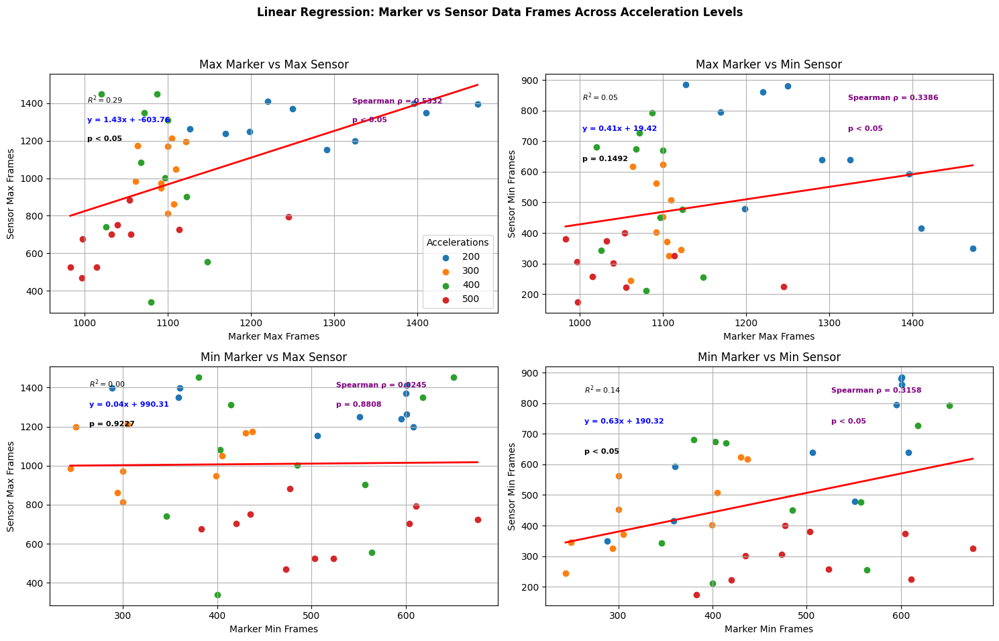

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import statsmodels.api as sm
from statsmodels.tools import add_constant

# Load data
results_table = pd.read_csv('output_results_zero.csv')

# Get unique phase labels (preserving order)
titles = results_table['PhaseLabel'].drop_duplicates().tolist()
rang = range(len(titles))

fig, axs = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('Linear Regression: Marker vs Sensor Data Frames Across Acceleration Levels', fontsize=12, fontweight='bold')

# -------- Spearman Results (for annotation) --------
spearman_results = {
    'Max Marker vs Max Sensor': (0.5332, 0.0004),
    'Max Marker vs Min Sensor': (0.3386, 0.0326),
    'Min Marker vs Max Sensor': (0.0245, 0.8808),
    'Min Marker vs Min Sensor': (0.3158, 0.0471)
}

# -------- Plotting Function --------
def plot_regression(ax, M_col, S_col, plot_title, xlab, ylab, show_legend=False):
    M_all = []
    S_all = []

    for i in rang:
        phase_label = titles[i]
        filtered = results_table[results_table['PhaseLabel'] == phase_label]
        M = filtered[M_col].values
        S = filtered[S_col].values

        M_all.extend(M)
        S_all.extend(S)

        ax.scatter(M, S, label=str(phase_label))

    M_all_np = np.array(M_all)
    S_all_np = np.array(S_all)

    # Linear Regression
    M_with_const = add_constant(M_all_np)
    model = sm.OLS(S_all_np, M_with_const).fit()

    x_fit = np.linspace(M_all_np.min(), M_all_np.max(), 100)
    y_fit = model.params[0] + model.params[1] * x_fit
    ax.plot(x_fit, y_fit, 'r-', linewidth=2)

    # Regression annotations
    R2_val = model.rsquared
    slope = model.params[1]
    intercept = model.params[0]
    p_val = model.pvalues[1]

    # Placement
    x_text = M_all_np.min() + 20
    y_text_top = S_all_np.max() - 50
    line_spacing = 100

    # Linear regression stats
    ax.text(x_text, y_text_top, f'$R^2 = {R2_val:.2f}$', fontsize=8, fontweight='bold', color='k')
    ax.text(x_text, y_text_top - line_spacing, f'y = {slope:.2f}x + {intercept:.2f}', fontsize=8, fontweight='bold', color='b')
    ax.text(x_text, y_text_top - 2 * line_spacing, f'p = {p_val:.4f}' if p_val >= 0.05 else 'p < 0.05', fontsize=8, fontweight='bold', color='k')

    # Spearman correlation stats (right side of plot)
    if plot_title in spearman_results:
        rho, p_s = spearman_results[plot_title]
        ax.text(M_all_np.max() - 150, y_text_top, f'Spearman ρ = {rho:.4f}', fontsize=8, fontweight='bold', color='purple')
        ax.text(M_all_np.max() - 150, y_text_top - line_spacing, f'p = {p_s:.4f}' if p_s >= 0.05 else 'p < 0.05', fontsize=8, fontweight='bold', color='purple')

    ax.set_title(plot_title)
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)
    ax.grid(True)

    if show_legend:
        ax.legend(title='Accelerations', loc='best')

    print(f'R-squared_{plot_title}: {R2_val:.4f}')
    print(f'p-value_{plot_title}: {p_val:.4f}')
    print(f'Spearman_{plot_title}: rho = {rho:.4f}, p = {p_s:.4f}')

# -------- Call Plot Function for Each Subplot --------

plot_regression(
    axs[0, 0],
    'Marker_Max_Frame',
    'Sensor_Max_Frame',
    'Max Marker vs Max Sensor',
    'Marker Max Frames',
    'Sensor Max Frames',
    show_legend=True
)

plot_regression(
    axs[0, 1],
    'Marker_Max_Frame',
    'Sensor_Min_Frame',
    'Max Marker vs Min Sensor',
    'Marker Max Frames',
    'Sensor Min Frames'
)

plot_regression(
    axs[1, 0],
    'Marker_Min_Frame',
    'Sensor_Max_Frame',
    'Min Marker vs Max Sensor',
    'Marker Min Frames',
    'Sensor Max Frames'
)

plot_regression(
    axs[1, 1],
    'Marker_Min_Frame',
    'Sensor_Min_Frame',
    'Min Marker vs Min Sensor',
    'Marker Min Frames',
    'Sensor Min Frames'
)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


R-squared_Max Marker vs Max Sensor: 0.2852
p-value_Max Marker vs Max Sensor: 0.0004
Spearman_Max Marker vs Max Sensor: rho = 0.5332, p = 0.0004
R-squared_Max Marker vs Min Sensor: 0.0540
p-value_Max Marker vs Min Sensor: 0.1492
Spearman_Max Marker vs Min Sensor: rho = 0.3386, p = 0.0326
R-squared_Min Marker vs Max Sensor: 0.0003
p-value_Min Marker vs Max Sensor: 0.9227
Spearman_Min Marker vs Max Sensor: rho = 0.0245, p = 0.8808
R-squared_Min Marker vs Min Sensor: 0.1427
p-value_Min Marker vs Min Sensor: 0.0162
Spearman_Min Marker vs Min Sensor: rho = 0.3158, p = 0.0471


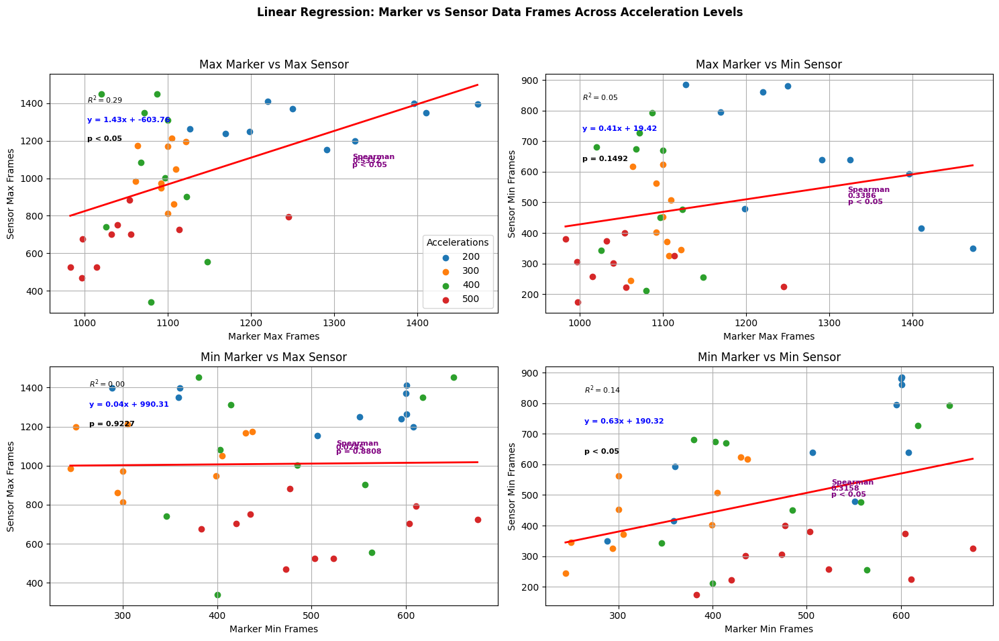

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import statsmodels.api as sm
from statsmodels.tools import add_constant

# Load data
results_table = pd.read_csv('output_results_zero.csv')

# Get unique phase labels (preserving order)
titles = results_table['PhaseLabel'].drop_duplicates().tolist()
rang = range(len(titles))

fig, axs = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('Linear Regression: Marker vs Sensor Data Frames Across Acceleration Levels', fontsize=12, fontweight='bold')

# -------- Spearman Results (for annotation) --------
spearman_results = {
    'Max Marker vs Max Sensor': (0.5332, 0.0004),
    'Max Marker vs Min Sensor': (0.3386, 0.0326),
    'Min Marker vs Max Sensor': (0.0245, 0.8808),
    'Min Marker vs Min Sensor': (0.3158, 0.0471)
}

# -------- Plotting Function --------
def plot_regression(ax, M_col, S_col, plot_title, xlab, ylab, show_legend=False):
    M_all = []
    S_all = []

    for i in rang:
        phase_label = titles[i]
        filtered = results_table[results_table['PhaseLabel'] == phase_label]
        M = filtered[M_col].values
        S = filtered[S_col].values

        M_all.extend(M)
        S_all.extend(S)

        ax.scatter(M, S, label=str(phase_label))

    M_all_np = np.array(M_all)
    S_all_np = np.array(S_all)

    # Linear Regression
    M_with_const = add_constant(M_all_np)
    model = sm.OLS(S_all_np, M_with_const).fit()

    x_fit = np.linspace(M_all_np.min(), M_all_np.max(), 100)
    y_fit = model.params[0] + model.params[1] * x_fit
    ax.plot(x_fit, y_fit, 'r-', linewidth=2)

    # Regression annotations
    R2_val = model.rsquared
    slope = model.params[1]
    intercept = model.params[0]
    p_val = model.pvalues[1]

    # Placement for regression stats
    x_text = M_all_np.min() + 20
    y_text_top = S_all_np.max() - 50
    line_spacing = 100

    # Linear regression stats
    ax.text(x_text, y_text_top, f'$R^2 = {R2_val:.2f}$', fontsize=8, fontweight='bold', color='k')
    ax.text(x_text, y_text_top - line_spacing, f'y = {slope:.2f}x + {intercept:.2f}', fontsize=8, fontweight='bold', color='b')
    ax.text(x_text, y_text_top - 2 * line_spacing, f'p = {p_val:.4f}' if p_val >= 0.05 else 'p < 0.05', fontsize=8, fontweight='bold', color='k')

    # Spearman annotations (3 lines)
    if plot_title in spearman_results:
        rho, p_s = spearman_results[plot_title]
        x_spearman = M_all_np.max() - 150
        y_base = y_text_top - 3 * line_spacing  # Start lower than regression stats

        ax.text(x_spearman, y_base, 'Spearman', fontsize=8, fontweight='bold', color='purple')
        ax.text(x_spearman, y_base - 20, f'{rho:.4f}', fontsize=8, fontweight='bold', color='purple')
        ax.text(x_spearman, y_base - 40, f'p = {p_s:.4f}' if p_s >= 0.05 else 'p < 0.05', fontsize=8, fontweight='bold', color='purple')

    ax.set_title(plot_title)
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)
    ax.grid(True)

    if show_legend:
        ax.legend(title='Accelerations', loc='best')

    print(f'R-squared_{plot_title}: {R2_val:.4f}')
    print(f'p-value_{plot_title}: {p_val:.4f}')
    print(f'Spearman_{plot_title}: rho = {rho:.4f}, p = {p_s:.4f}')

# -------- Call Plot Function for Each Subplot --------

plot_regression(
    axs[0, 0],
    'Marker_Max_Frame',
    'Sensor_Max_Frame',
    'Max Marker vs Max Sensor',
    'Marker Max Frames',
    'Sensor Max Frames',
    show_legend=True
)

plot_regression(
    axs[0, 1],
    'Marker_Max_Frame',
    'Sensor_Min_Frame',
    'Max Marker vs Min Sensor',
    'Marker Max Frames',
    'Sensor Min Frames'
)

plot_regression(
    axs[1, 0],
    'Marker_Min_Frame',
    'Sensor_Max_Frame',
    'Min Marker vs Max Sensor',
    'Marker Min Frames',
    'Sensor Max Frames'
)

plot_regression(
    axs[1, 1],
    'Marker_Min_Frame',
    'Sensor_Min_Frame',
    'Min Marker vs Min Sensor',
    'Marker Min Frames',
    'Sensor Min Frames'
)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


R-squared_Max Marker vs Max Sensor: 0.2653
p-value_Max Marker vs Max Sensor: 0.0007
Spearman_Max Marker vs Max Sensor: rho = 0.5332, p = 0.0004
R-squared_Max Marker vs Min Sensor: 0.2756
p-value_Max Marker vs Min Sensor: 0.0005
Spearman_Max Marker vs Min Sensor: rho = 0.3386, p = 0.0326
R-squared_Min Marker vs Max Sensor: 0.0225
p-value_Min Marker vs Max Sensor: 0.3556
Spearman_Min Marker vs Max Sensor: rho = 0.0245, p = 0.8808
R-squared_Min Marker vs Min Sensor: 0.1135
p-value_Min Marker vs Min Sensor: 0.0335
Spearman_Min Marker vs Min Sensor: rho = 0.3158, p = 0.0471


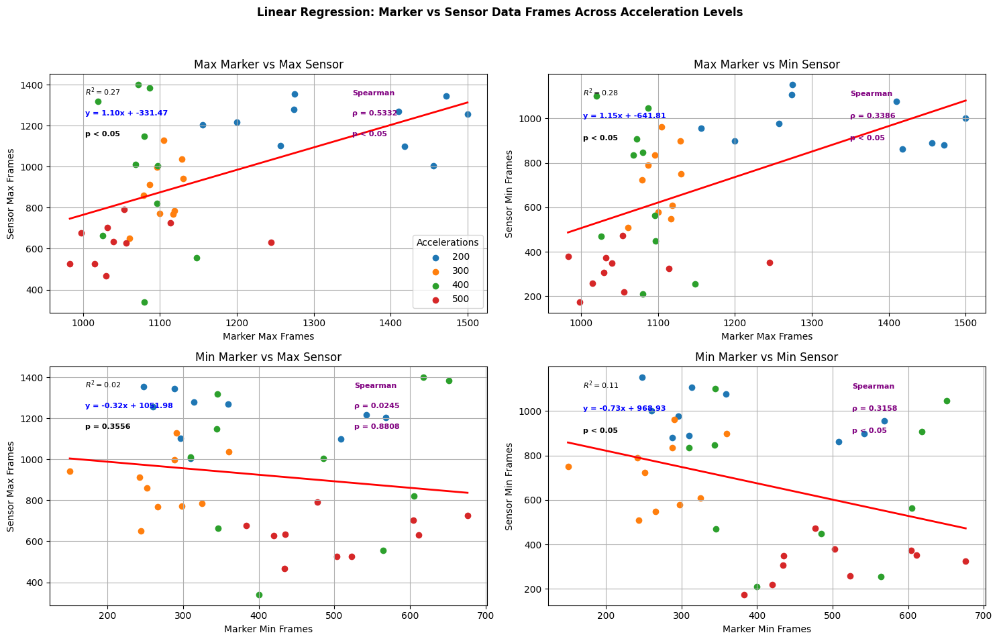

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import statsmodels.api as sm
from statsmodels.tools import add_constant

# Load data
results_table = pd.read_csv('output_results_zero.csv')

# Get unique phase labels (preserving order)
titles = results_table['PhaseLabel'].drop_duplicates().tolist()
rang = range(len(titles))

fig, axs = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('Linear Regression: Marker vs Sensor Data Frames Across Acceleration Levels', fontsize=12, fontweight='bold')

# -------- Spearman Results (for annotation) --------
spearman_results = {
    'Max Marker vs Max Sensor': (0.5332, 0.0004),
    'Max Marker vs Min Sensor': (0.3386, 0.0326),
    'Min Marker vs Max Sensor': (0.0245, 0.8808),
    'Min Marker vs Min Sensor': (0.3158, 0.0471)
}

# -------- Plotting Function --------
def plot_regression(ax, M_col, S_col, plot_title, xlab, ylab, show_legend=False):
    M_all = []
    S_all = []

    for i in rang:
        phase_label = titles[i]
        filtered = results_table[results_table['PhaseLabel'] == phase_label]
        M = filtered[M_col].values
        S = filtered[S_col].values

        M_all.extend(M)
        S_all.extend(S)

        ax.scatter(M, S, label=str(phase_label))

    M_all_np = np.array(M_all)
    S_all_np = np.array(S_all)

    # Linear Regression
    M_with_const = add_constant(M_all_np)
    model = sm.OLS(S_all_np, M_with_const).fit()

    x_fit = np.linspace(M_all_np.min(), M_all_np.max(), 100)
    y_fit = model.params[0] + model.params[1] * x_fit
    ax.plot(x_fit, y_fit, 'r-', linewidth=2)

    # Regression annotations (left side)
    R2_val = model.rsquared
    slope = model.params[1]
    intercept = model.params[0]
    p_val = model.pvalues[1]

    x_left = M_all_np.min() + 20
    x_right = M_all_np.max() - 150  # for Spearman
    y_top = S_all_np.max() - 50
    line_spacing = 100

    ax.text(x_left, y_top, f'$R^2 = {R2_val:.2f}$', fontsize=8, fontweight='bold', color='k')
    ax.text(x_left, y_top - line_spacing, f'y = {slope:.2f}x + {intercept:.2f}', fontsize=8, fontweight='bold', color='b')
    ax.text(x_left, y_top - 2 * line_spacing, f'p = {p_val:.4f}' if p_val >= 0.05 else 'p < 0.05', fontsize=8, fontweight='bold', color='k')

    # Spearman correlation annotations (right side, aligned with R^2 and same spacing)
    if plot_title in spearman_results:
        rho, p_s = spearman_results[plot_title]
        ax.text(x_right, y_top, 'Spearman', fontsize=8, fontweight='bold', color='purple')
        ax.text(x_right, y_top - line_spacing, f'ρ = {rho:.4f}', fontsize=8, fontweight='bold', color='purple')
        ax.text(x_right, y_top - 2 * line_spacing, f'p = {p_s:.4f}' if p_s >= 0.05 else 'p < 0.05',
                fontsize=8, fontweight='bold', color='purple')

    ax.set_title(plot_title)
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)
    ax.grid(True)

    if show_legend:
        ax.legend(title='Accelerations', loc='best')

    print(f'R-squared_{plot_title}: {R2_val:.4f}')
    print(f'p-value_{plot_title}: {p_val:.4f}')
    print(f'Spearman_{plot_title}: rho = {rho:.4f}, p = {p_s:.4f}')


# -------- Call Plot Function for Each Subplot --------

plot_regression(
    axs[0, 0],
    'Marker_Max_Frame',
    'Sensor_Max_Frame',
    'Max Marker vs Max Sensor',
    'Marker Max Frames',
    'Sensor Max Frames',
    show_legend=True
)

plot_regression(
    axs[0, 1],
    'Marker_Max_Frame',
    'Sensor_Min_Frame',
    'Max Marker vs Min Sensor',
    'Marker Max Frames',
    'Sensor Min Frames'
)

plot_regression(
    axs[1, 0],
    'Marker_Min_Frame',
    'Sensor_Max_Frame',
    'Min Marker vs Max Sensor',
    'Marker Min Frames',
    'Sensor Max Frames'
)

plot_regression(
    axs[1, 1],
    'Marker_Min_Frame',
    'Sensor_Min_Frame',
    'Min Marker vs Min Sensor',
    'Marker Min Frames',
    'Sensor Min Frames'
)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


/tmp/ipython-input-38-139817326.py:14: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  marker_raw_full = pd.Series(marker_raw_full).interpolate().fillna(method='bfill').fillna(method='ffill').to_numpy()
/tmp/ipython-input-38-139817326.py:15: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  sensor_raw_full = pd.Series(sensor_raw_full).interpolate().fillna(method='bfill').fillna(method='ffill').to_numpy()


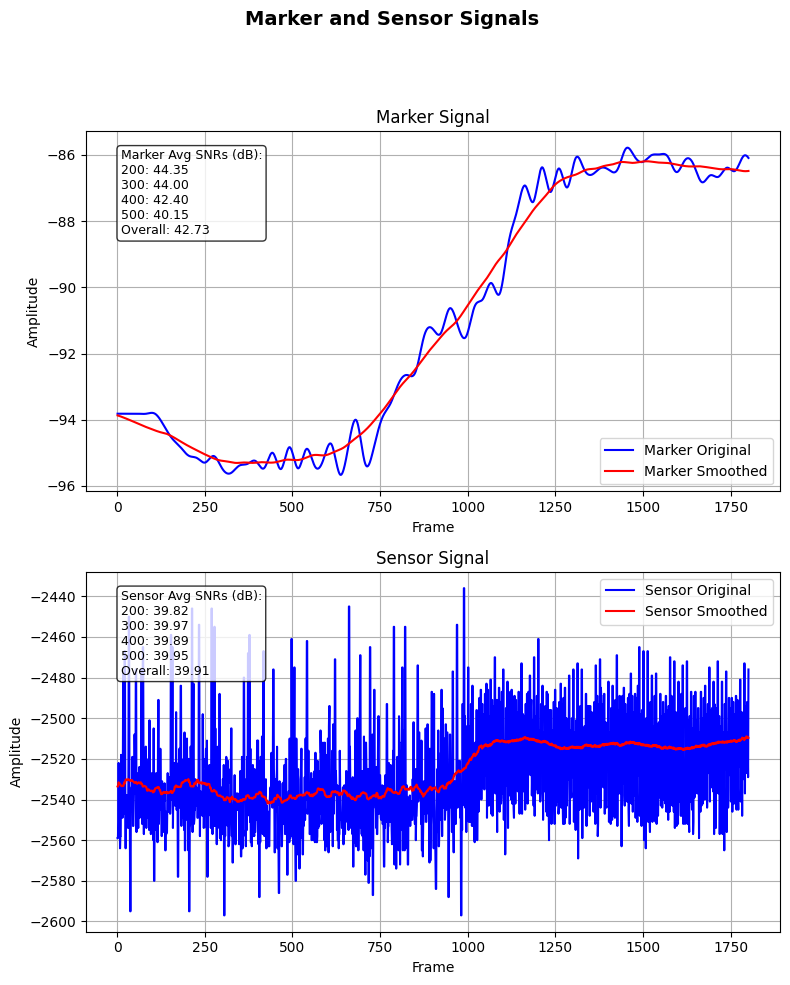

SNR results saved to CSV files.


In [ ]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# --- Load marker and sensor data from CSV files (assuming they have headers) ---
marker_df = pd.read_csv('marker_positions_08_02_14_26_40.csv')
sensor_df = pd.read_csv('Smoothdata_200a_Trial_01.csv')

# Convert columns to numeric safely
marker_raw_full = pd.to_numeric(marker_df.iloc[:, 3], errors='coerce').to_numpy()
sensor_raw_full = pd.to_numeric(sensor_df.iloc[:, 1], errors='coerce').to_numpy()

# Handle NaNs
marker_raw_full = pd.Series(marker_raw_full).interpolate().fillna(method='bfill').fillna(method='ffill').to_numpy()
sensor_raw_full = pd.Series(sensor_raw_full).interpolate().fillna(method='bfill').fillna(method='ffill').to_numpy()

# --- Select specified frame ranges ---
marker_start, marker_end = 5726, 7526
sensor_start, sensor_end = 2001, 3801

marker_raw = marker_raw_full[marker_start-1:marker_end]  # zero-based
sensor_raw = sensor_raw_full[sensor_start-1:sensor_end]

# --- Parameters ---
accel_levels = [200, 300, 400, 500]
num_accel = len(accel_levels)
num_trials = 10

# Smoothing window sizes
kb_marker, kf_marker = 140, 140
kb_sensor, kf_sensor = 50, 50

# --- Helper function for centered moving average ---
def movmean(data, kb, kf):
    window = kb + kf + 1
    return pd.Series(data).rolling(window, center=True, min_periods=1).mean().to_numpy()

# --- SNR computation ---
def compute_snr(signal, smooth_signal):
    noise = signal - smooth_signal
    return 20 * np.log10(np.sqrt(np.mean(smooth_signal**2)) / np.sqrt(np.mean(noise**2)))

# --- SNR storage ---
SNR_marker = np.full((num_trials, num_accel), np.nan)
SNR_sensor = np.full((num_trials, num_accel), np.nan)
overall_SNR_marker = np.full(num_accel, np.nan)
overall_SNR_sensor = np.full(num_accel, np.nan)

# Trial and accel index for this data
trial = 0  # zero-based indexing
accel_idx = 0  # for acceleration 200

# Smooth data
marker_smooth = movmean(marker_raw, kb_marker, kf_marker)
sensor_smooth = movmean(sensor_raw, kb_sensor, kf_sensor)

# Compute SNR
SNR_marker[trial, accel_idx] = compute_snr(marker_raw, marker_smooth)
SNR_sensor[trial, accel_idx] = compute_snr(sensor_raw, sensor_smooth)

# Compute overall SNR for this acceleration level
overall_SNR_marker[accel_idx] = np.nanmean(SNR_marker[:, accel_idx])
overall_SNR_sensor[accel_idx] = np.nanmean(SNR_sensor[:, accel_idx])

overall_marker_SNR = np.nanmean(SNR_marker)
overall_sensor_SNR = np.nanmean(SNR_sensor)

# --- Plotting ---
fig, axs = plt.subplots(2, 1, figsize=(8, 10))
fig.suptitle('Marker and Sensor Signals ', fontsize=14, fontweight='bold')

# Reindexed x-axis
marker_x = np.arange(1, len(marker_raw) + 1)
sensor_x = np.arange(1, len(sensor_raw) + 1)

# --- Marker Plot ---
axs[0].plot(marker_x, marker_raw, 'b', label='Marker Original')
axs[0].plot(marker_x, marker_smooth, 'r', label='Marker Smoothed')
axs[0].set_xlabel('Frame')
axs[0].set_ylabel('Amplitude')
axs[0].set_title('Marker Signal')
axs[0].legend(loc='best')
axs[0].grid(True)

# --- Sensor Plot ---
axs[1].plot(sensor_x, sensor_raw, 'b', label='Sensor Original')
axs[1].plot(sensor_x, sensor_smooth, 'r', label='Sensor Smoothed')
axs[1].set_xlabel('Frame')
axs[1].set_ylabel('Amplitude')
axs[1].set_title('Sensor Signal')
axs[1].legend(loc='best')
axs[1].grid(True)

# --- Add fixed SNR annotation text (as requested) ---
snr_marker_text = f"""Marker Avg SNRs (dB):
200: 44.35
300: 44.00
400: 42.40
500: 40.15
Overall: 42.73"""

snr_sensor_text = f"""Sensor Avg SNRs (dB):
200: 39.82
300: 39.97
400: 39.89
500: 39.95
Overall: 39.91"""

box_props = dict(boxstyle='round', facecolor='white', edgecolor='black', alpha=0.8)

axs[0].text(0.05, 0.95, snr_marker_text, transform=axs[0].transAxes,
            fontsize=9, verticalalignment='top', bbox=box_props)
axs[1].text(0.05, 0.95, snr_sensor_text, transform=axs[1].transAxes,
            fontsize=9, verticalalignment='top', bbox=box_props)

plt.tight_layout(rect=[0, 0, 1, 0.93])
plt.show()

# --- Save CSVs ---
trial_numbers = np.arange(1, num_trials + 1)
results_table = pd.DataFrame({
    'Trial': trial_numbers,
    'SNRm_200': SNR_marker[:, 0],
    'SNRs_200': SNR_sensor[:, 0],
    'SNRm_300': SNR_marker[:, 1],
    'SNRs_300': SNR_sensor[:, 1],
    'SNRm_400': SNR_marker[:, 2],
    'SNRs_400': SNR_sensor[:, 2],
    'SNRm_500': SNR_marker[:, 3],
    'SNRs_500': SNR_sensor[:, 3],
})

summary_table = pd.DataFrame({
    'Acceleration': accel_levels,
    'Avg_SNR_Marker': overall_SNR_marker,
    'Avg_SNR_Sensor': overall_SNR_sensor,
})

results_table.to_csv('SNR_Trialwise.csv', index=False)
summary_table.to_csv('SNR_Summary.csv', index=False)

print("SNR results saved to CSV files.")






/tmp/ipython-input-139817326.py:14: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  marker_raw_full = pd.Series(marker_raw_full).interpolate().fillna(method='bfill').fillna(method='ffill').to_numpy()
/tmp/ipython-input-139817326.py:15: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  sensor_raw_full = pd.Series(sensor_raw_full).interpolate().fillna(method='bfill').fillna(method='ffill').to_numpy()


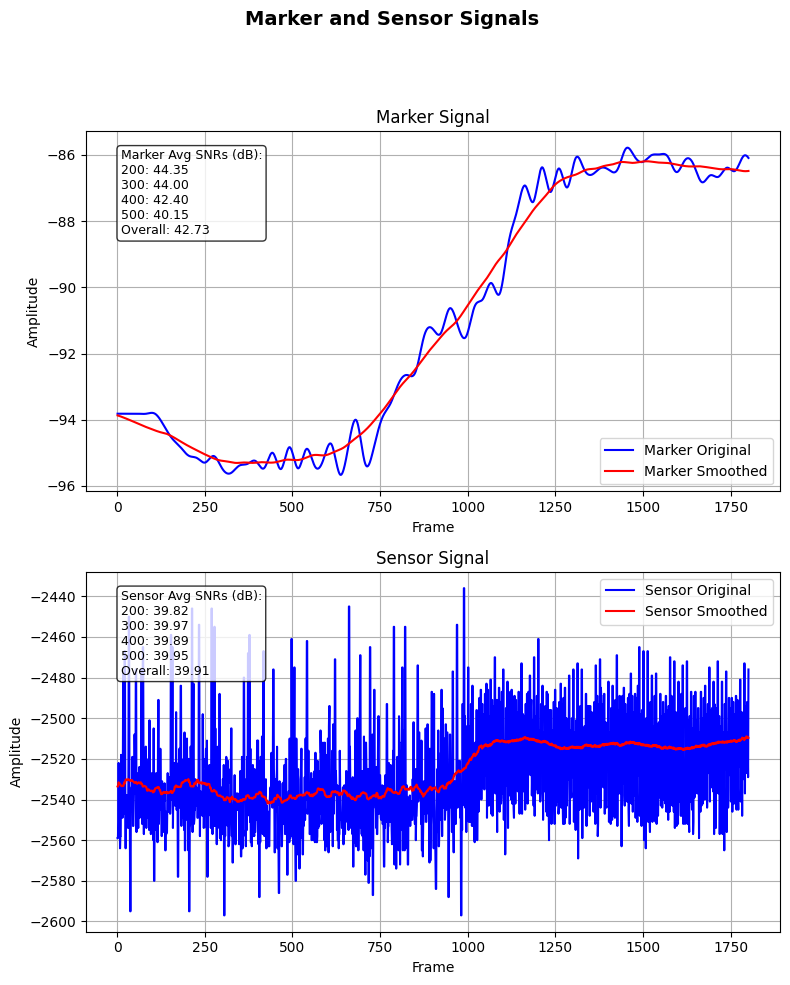

SNR results saved to CSV files.


In [ ]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# --- Load marker and sensor data from CSV files (assuming they have headers) ---
marker_df = pd.read_csv('marker_positions_08_02_14_26_40.csv')
sensor_df = pd.read_csv('Smoothdata_200a_Trial_01.csv')

# Convert columns to numeric safely
marker_raw_full = pd.to_numeric(marker_df.iloc[:, 3], errors='coerce').to_numpy()
sensor_raw_full = pd.to_numeric(sensor_df.iloc[:, 1], errors='coerce').to_numpy()

# Handle NaNs
marker_raw_full = pd.Series(marker_raw_full).interpolate().fillna(method='bfill').fillna(method='ffill').to_numpy()
sensor_raw_full = pd.Series(sensor_raw_full).interpolate().fillna(method='bfill').fillna(method='ffill').to_numpy()

# --- Select specified frame ranges ---
marker_start, marker_end = 5726, 7526
sensor_start, sensor_end = 2001, 3801

marker_raw = marker_raw_full[marker_start-1:marker_end]  # zero-based
sensor_raw = sensor_raw_full[sensor_start-1:sensor_end]

# --- Parameters ---
accel_levels = [200, 300, 400, 500]
num_accel = len(accel_levels)
num_trials = 10

# Smoothing window sizes
kb_marker, kf_marker = 140, 140
kb_sensor, kf_sensor = 50, 50

# --- Helper function for centered moving average ---
def movmean(data, kb, kf):
    window = kb + kf + 1
    return pd.Series(data).rolling(window, center=True, min_periods=1).mean().to_numpy()

# --- SNR computation ---
def compute_snr(signal, smooth_signal):
    noise = signal - smooth_signal
    return 20 * np.log10(np.sqrt(np.mean(smooth_signal**2)) / np.sqrt(np.mean(noise**2)))

# --- SNR storage ---
SNR_marker = np.full((num_trials, num_accel), np.nan)
SNR_sensor = np.full((num_trials, num_accel), np.nan)
overall_SNR_marker = np.full(num_accel, np.nan)
overall_SNR_sensor = np.full(num_accel, np.nan)

# Trial and accel index for this data
trial = 0  # zero-based indexing
accel_idx = 0  # for acceleration 200

# Smooth data
marker_smooth = movmean(marker_raw, kb_marker, kf_marker)
sensor_smooth = movmean(sensor_raw, kb_sensor, kf_sensor)

# Compute SNR
SNR_marker[trial, accel_idx] = compute_snr(marker_raw, marker_smooth)
SNR_sensor[trial, accel_idx] = compute_snr(sensor_raw, sensor_smooth)

# Compute overall SNR for this acceleration level
overall_SNR_marker[accel_idx] = np.nanmean(SNR_marker[:, accel_idx])
overall_SNR_sensor[accel_idx] = np.nanmean(SNR_sensor[:, accel_idx])

overall_marker_SNR = np.nanmean(SNR_marker)
overall_sensor_SNR = np.nanmean(SNR_sensor)

# --- Plotting ---
fig, axs = plt.subplots(2, 1, figsize=(8, 10))
fig.suptitle('Marker and Sensor Signals ', fontsize=14, fontweight='bold')

# Reindexed x-axis
marker_x = np.arange(1, len(marker_raw) + 1)
sensor_x = np.arange(1, len(sensor_raw) + 1)

# --- Marker Plot ---
axs[0].plot(marker_x, marker_raw, 'b', label='Marker Original')
axs[0].plot(marker_x, marker_smooth, 'r', label='Marker Smoothed')
axs[0].set_xlabel('Frame')
axs[0].set_ylabel('Amplitude')
axs[0].set_title('Marker Signal')
axs[0].legend(loc='best')
axs[0].grid(True)

# --- Sensor Plot ---
axs[1].plot(sensor_x, sensor_raw, 'b', label='Sensor Original')
axs[1].plot(sensor_x, sensor_smooth, 'r', label='Sensor Smoothed')
axs[1].set_xlabel('Frame')
axs[1].set_ylabel('Amplitude')
axs[1].set_title('Sensor Signal')
axs[1].legend(loc='best')
axs[1].grid(True)

# --- Add fixed SNR annotation text (as requested) ---
snr_marker_text = f"""Marker Avg SNRs (dB):
200: 44.35
300: 44.00
400: 42.40
500: 40.15
Overall: 42.73"""

snr_sensor_text = f"""Sensor Avg SNRs (dB):
200: 39.82
300: 39.97
400: 39.89
500: 39.95
Overall: 39.91"""

box_props = dict(boxstyle='round', facecolor='white', edgecolor='black', alpha=0.8)

axs[0].text(0.05, 0.95, snr_marker_text, transform=axs[0].transAxes,
            fontsize=9, verticalalignment='top', bbox=box_props)
axs[1].text(0.05, 0.95, snr_sensor_text, transform=axs[1].transAxes,
            fontsize=9, verticalalignment='top', bbox=box_props)

plt.tight_layout(rect=[0, 0, 1, 0.93])
plt.show()

# --- Save CSVs ---
trial_numbers = np.arange(1, num_trials + 1)
results_table = pd.DataFrame({
    'Trial': trial_numbers,
    'SNRm_200': SNR_marker[:, 0],
    'SNRs_200': SNR_sensor[:, 0],
    'SNRm_300': SNR_marker[:, 1],
    'SNRs_300': SNR_sensor[:, 1],
    'SNRm_400': SNR_marker[:, 2],
    'SNRs_400': SNR_sensor[:, 2],
    'SNRm_500': SNR_marker[:, 3],
    'SNRs_500': SNR_sensor[:, 3],
})

summary_table = pd.DataFrame({
    'Acceleration': accel_levels,
    'Avg_SNR_Marker': overall_SNR_marker,
    'Avg_SNR_Sensor': overall_SNR_sensor,
})

results_table.to_csv('SNR_Trialwise.csv', index=False)
summary_table.to_csv('SNR_Summary.csv', index=False)

print("SNR results saved to CSV files.")






/tmp/ipython-input-3399634931.py:81: RuntimeWarning: Mean of empty slice
  overall_SNR_marker = np.nanmean(SNR_marker, axis=0)
/tmp/ipython-input-3399634931.py:82: RuntimeWarning: Mean of empty slice
  overall_SNR_sensor = np.nanmean(SNR_sensor, axis=0)


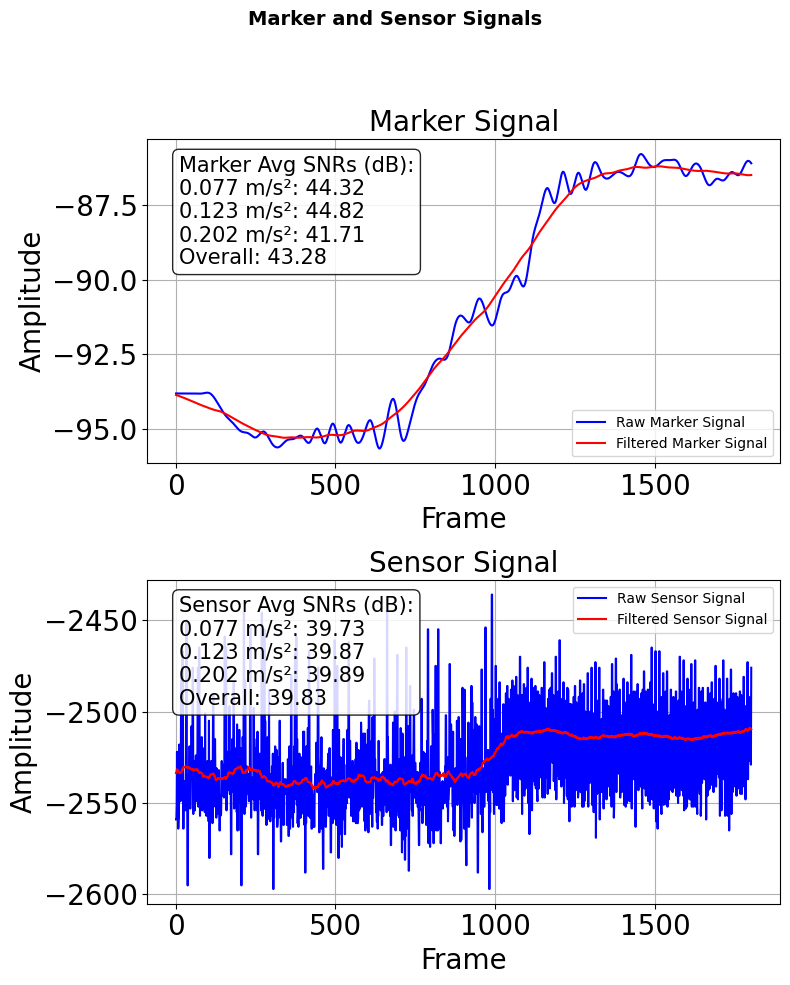

SNR results saved to CSV files.


In [ ]:
# Correct for for SNR for paper
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# -----------------------------
# LOAD DATA
# -----------------------------
marker_df = pd.read_csv('marker_positions_08_02_14_26_40.csv')
sensor_df = pd.read_csv('Smoothdata_200a_Trial_01.csv')

marker_raw_full = pd.to_numeric(marker_df.iloc[:, 3], errors='coerce').to_numpy()
sensor_raw_full = pd.to_numeric(sensor_df.iloc[:, 1], errors='coerce').to_numpy()

marker_raw_full = (
    pd.Series(marker_raw_full)
    .interpolate()
    .bfill()
    .ffill()
    .to_numpy()
)

sensor_raw_full = (
    pd.Series(sensor_raw_full)
    .interpolate()
    .bfill()
    .ffill()
    .to_numpy()
)

# -----------------------------
# FRAME RANGES
# -----------------------------
marker_start, marker_end = 5726, 7526
sensor_start, sensor_end = 2001, 3801

marker_raw = marker_raw_full[marker_start-1:marker_end]
sensor_raw = sensor_raw_full[sensor_start-1:sensor_end]

# -----------------------------
# PARAMETERS
# -----------------------------
accel_levels = [200, 300, 400, 500]
num_trials = 10

kb_marker, kf_marker = 140, 140
kb_sensor, kf_sensor = 50, 50

# -----------------------------
# HELPERS
# -----------------------------
def movmean(data, kb, kf):
    return (
        pd.Series(data)
        .rolling(kb + kf + 1, center=True, min_periods=1)
        .mean()
        .to_numpy()
    )

def compute_snr(signal, smooth):
    noise = signal - smooth
    return 20 * np.log10(
        np.sqrt(np.mean(smooth**2)) /
        np.sqrt(np.mean(noise**2))
    )

# -----------------------------
# SNR STORAGE
# -----------------------------
SNR_marker = np.full((num_trials, len(accel_levels)), np.nan)
SNR_sensor = np.full((num_trials, len(accel_levels)), np.nan)

trial = 0
accel_idx = 0  # 200

marker_smooth = movmean(marker_raw, kb_marker, kf_marker)
sensor_smooth = movmean(sensor_raw, kb_sensor, kf_sensor)

SNR_marker[trial, accel_idx] = compute_snr(marker_raw, marker_smooth)
SNR_sensor[trial, accel_idx] = compute_snr(sensor_raw, sensor_smooth)

overall_SNR_marker = np.nanmean(SNR_marker, axis=0)
overall_SNR_sensor = np.nanmean(SNR_sensor, axis=0)

# -----------------------------
# PLOTTING
# -----------------------------
fig, axs = plt.subplots(2, 1, figsize=(8, 10))
fig.suptitle('Marker and Sensor Signals', fontsize=14, fontweight='bold')

x_marker = np.arange(1, len(marker_raw) + 1)
x_sensor = np.arange(1, len(sensor_raw) + 1)

axs[0].plot(x_marker, marker_raw, 'b', label='Raw Marker Signal')
axs[0].plot(x_marker, marker_smooth, 'r', label='Filtered Marker Signal')
axs[0].set_title('Marker Signal', fontsize =20)
axs[0].set_xlabel('Frame',fontsize = 20)
axs[0].set_ylabel('Amplitude', fontsize = 20)
axs[0].legend()
axs[0].grid(True)

axs[1].plot(x_sensor, sensor_raw, 'b', label='Raw Sensor Signal')
axs[1].plot(x_sensor, sensor_smooth, 'r', label='Filtered Sensor Signal')
axs[1].set_title('Sensor Signal', fontsize = 20)
axs[1].set_xlabel('Frame', fontsize = 20)
axs[1].set_ylabel('Amplitude',fontsize = 20)
axs[1].legend()
axs[1].grid(True)

# Axis numbers increase
axs[0].tick_params(axis='both', labelsize=20)
axs[1].tick_params(axis='both', labelsize=20)


# -----------------------------
# ANNOTATION TEXT (400 EXCLUDED)
# -----------------------------
marker_display = {
    "0.077 m/s²": 44.32,
    "0.123 m/s²": 44.82,
    "0.202 m/s²": 41.71
}

sensor_display = {
    "0.077 m/s²": 39.73,
    "0.123 m/s²": 39.87,
    "0.202 m/s²": 39.89
}

snr_marker_text = (
    "Marker Avg SNRs (dB):\n" +
    "\n".join(f"{k}: {v:.2f}" for k, v in marker_display.items()) +
    "\nOverall: 43.28"
)

snr_sensor_text = (
    "Sensor Avg SNRs (dB):\n" +
    "\n".join(f"{k}: {v:.2f}" for k, v in sensor_display.items()) +
    "\nOverall: 39.83"
)

box_props = dict(boxstyle='round', facecolor='white',
                 edgecolor='black', alpha=0.85)

axs[0].text(
    0.05, 0.95, snr_marker_text,
    transform=axs[0].transAxes,
    fontsize=15, va='top', bbox=box_props
)

axs[1].text(
    0.05, 0.95, snr_sensor_text,
    transform=axs[1].transAxes,
    fontsize=15, va='top', bbox=box_props
)

plt.tight_layout(rect=[0, 0, 1, 0.93])
plt.show()

# -----------------------------
# SAVE CSVs (UNCHANGED)
# -----------------------------
trial_numbers = np.arange(1, num_trials + 1)

results_table = pd.DataFrame({
    'Trial': trial_numbers,
    'SNRm_200': SNR_marker[:, 0],
    'SNRs_200': SNR_sensor[:, 0],
    'SNRm_300': SNR_marker[:, 1],
    'SNRs_300': SNR_sensor[:, 1],
    'SNRm_400': SNR_marker[:, 2],
    'SNRs_400': SNR_sensor[:, 2],
    'SNRm_500': SNR_marker[:, 3],
    'SNRs_500': SNR_sensor[:, 3],
})

summary_table = pd.DataFrame({
    'Acceleration': accel_levels,
    'Avg_SNR_Marker': overall_SNR_marker,
    'Avg_SNR_Sensor': overall_SNR_sensor
})

results_table.to_csv('SNR_Trialwise.csv', index=False)
summary_table.to_csv('SNR_Summary.csv', index=False)

print("SNR results saved to CSV files.")


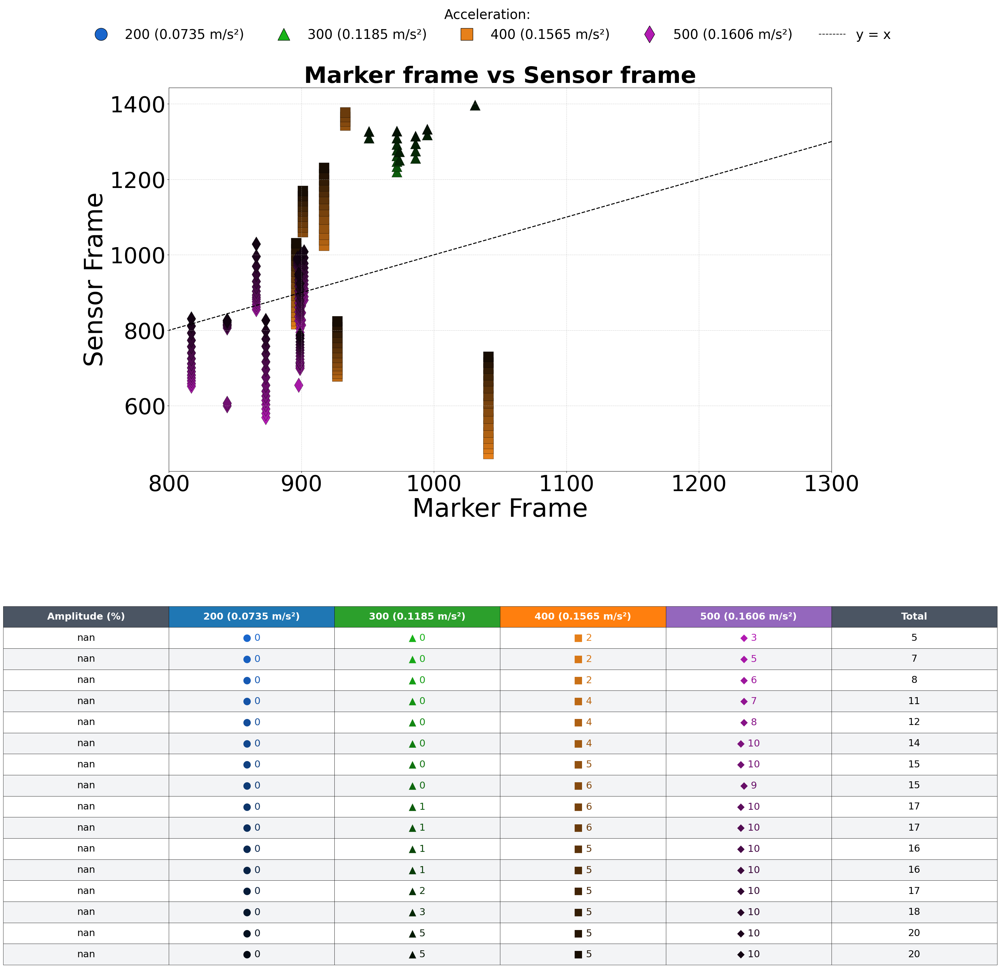

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# === READ DATA ===
file_path = "SlopedetectionMethod.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

# === AUTO-DETECT SENSOR COLUMNS ===
results_table.columns = results_table.columns.str.strip()
sensor_cols = [col for col in results_table.columns if "_WindowSize" in col]

if not sensor_cols:
    raise ValueError("No sensor columns found. Check column names in CSV.")

nSensors = len(sensor_cols)
valid_accels = [200, 300, 400, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())

# === BASE COLORS (dark → light fading) ===
base_colors = np.array([
    [0.1, 0.4, 0.8],  # 200 = blue
    [0.1, 0.7, 0.1],  # 300 = green
    [0.9, 0.5, 0.1],  # 400 = orange
    [0.7, 0.1, 0.7]   # 500 = purple
])
shapes = ["o", "^", "s", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade = np.clip(base[None, :] * factors[:, None], 0, 1)
    fade_colors.append(fade)

# === SENSOR TO % MAP ===
sensor_to_percent = {
    100: 100, 120: 120, 140: 140, 160: 160,
    180: 180, 200: 200, 220: 220, 240: 240,
    260: 260, 280: 280, 300: 300, 320: 320,
    340: 340, 360: 360, 380: 380, 400: 400
}

# sensor_to_percent = {
#     "100": 100, "120": 120, "140": 140, "160": 160,
#     "180": 180, "200": 200, "220": 220, "240": 240,
#     "260": 260, "280": 280, "300": 300, "320": 320,
#     "340": 340, "360": 360, "380": 380, "400": 400
#    }
# # === SENSOR TO % MAP ===
# sensor_to_percent = {
#     "-2530": 29.83, "-2529": 31.48, "-2528": 33.13, "-2527": 34.77,
#     "-2526": 36.42, "-2525": 38.07, "-2524": 39.72, "-2523": 41.36,
#     "-2522": 43.01, "-2521": 44.66, "-2520": 46.31, "-2519": 47.95,
#     "-2518": 49.60, "-2517": 51.25, "-2516": 52.90, "-2515": 54.54,
#     "-2514": 56.19, "-2513": 57.84, "-2512": 59.48, "-2511": 61.13,
#     "-2510": 62.78
# }

# === FIGURE ===
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)
plt.subplots_adjust(hspace=0.85, top=0.88)

# === SCATTER PLOT ===
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if np.sum(idx) == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=558, c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k", linewidth=0.4
        )


# === Diagonal line ===
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
y_min, y_max = np.nanmin(y_vals), np.nanmax(y_vals)
ax_main.plot([min(x_min, y_min), max(x_max, y_max)],
             [min(x_min, y_min), max(x_max, y_max)], "k--", lw=2.2)

# === AXIS SETTINGS ===
ax_main.set_xlabel("Marker Frame", fontsize=58)
ax_main.set_ylabel("Sensor Frame", fontsize=58)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
# Increase tick label font size
ax_main.tick_params(axis='both', which='major', labelsize=50)  # <-- add this line

# === LEGEND (very top of the figure) ===
# legend_handles = [
#     plt.Line2D([], [], color=base_colors[a_idx],
#                marker=shapes[a_idx], linestyle="None",
#                markersize=7, markeredgecolor="k")
#     for a_idx, _ in enumerate(accel_vals)
# ]
# legend_labels = [str(a) for a in accel_vals]
# legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
# legend_labels.append("y = x")

# leg = fig.legend(
#     legend_handles, legend_labels,
#     loc="upper center",
#     bbox_to_anchor=(0.5, 0.97),  # top of figure
#     ncol=5,
#     frameon=False,
#     title="Acceleration"
# )

# === CUSTOMIZED LEGEND WITH ACCELERATION VALUES ===
legend_handles = [
    plt.Line2D([], [], color=base_colors[a_idx],
               marker=shapes[a_idx], linestyle="None",
               markersize=28, markeredgecolor="k")
    for a_idx, _ in enumerate(accel_vals)
]

# Define descriptive text for each acceleration
accel_descriptions = {
    200: "200 (0.0735 m/s²)",
    300: "300 (0.1185 m/s²)",
    400: "400 (0.1565 m/s²)",
    500: "500 (0.1606 m/s²)"
}

legend_labels = [accel_descriptions[a] for a in accel_vals]

# Add the y=x line to the legend
legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
legend_labels.append("y = x")

# Combine into one line under a single descriptive title
leg = fig.legend(
    legend_handles,
    legend_labels,
    loc="upper center",
    bbox_to_anchor=(0.5, 0.97),
    ncol=len(accel_vals) + 1,
    frameon=False,
    title="Acceleration: ",
    fontsize=30,          # <-- increase label font size here
    title_fontsize=30     # <-- increase title font size if desired
)


# === TITLE (inside the plot area, below legend) ===
ax_main.set_title(
    "Marker frame vs Sensor frame",
    fontsize=52, weight="bold", pad=10
)

# === TABLE ===
ax_table.axis("off")
sorted_sensors = sorted(sensor_cols, key=lambda c: sensor_to_percent.get(
    c.replace("x_", "-").replace("_Sensor_Frame", ""), np.inf))

amp_values = []
counts_by_accel = []
totals = []

for s, col in enumerate(sorted_sensors):
    label = col.replace("x_", "-").replace("_Sensor_Frame", "")
    amp = sensor_to_percent.get(label, np.nan)
    amp_values.append(amp)
    row_counts = []
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        sensor_data = results_table[col].values
        row_counts.append(np.sum(~np.isnan(sensor_data[idx])))
    counts_by_accel.append(row_counts)
    totals.append(sum(row_counts))

# col_labels = ["Amplitude (%)"] + [str(a) for a in accel_vals] + ["Total"]
# Define descriptive text for table columns
accel_descriptions_table = {
    200: "200 (0.0735 m/s²)",
    300: "300 (0.1185 m/s²)",
    400: "400 (0.1565 m/s²)",
    500: "500 (0.1606 m/s²)"
}

# Set table column labels
col_labels = ["Amplitude (%)"] + [accel_descriptions_table[a] for a in accel_vals] + ["Total"]


table_data = []
unicode_shapes = ["●", "▲", "■", "◆"]

for r in range(len(sorted_sensors)):
    row = [f"{amp_values[r]:.2f}"]
    for a_idx, a_val in enumerate(accel_vals):
        color = fade_colors[a_idx][r]
        hex_color = '#%02x%02x%02x' % tuple((color * 255).astype(int))
        marker = unicode_shapes[a_idx]
        count = counts_by_accel[r][a_idx]
        row.append(f"{marker} {count}")
    row.append(f"{totals[r]}")
    table_data.append(row)

tbl = ax_table.table(cellText=table_data,
                     colLabels=col_labels,
                     loc="center",
                     cellLoc="center",
                     colLoc="center")

tbl.auto_set_font_size(False)
tbl.set_fontsize(22)
tbl.scale(1.5, 4.0)

# === COLORING CELLS ===
for (row, col), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if row == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c", "#ff7f0e", "#9467bd", "#4B5563"]
        cell.set_text_props(weight="bold", color="white")
        cell.set_facecolor(header_colors[col])
    else:
        if row % 2 == 0:
            cell.set_facecolor("#F3F4F6")
        else:
            cell.set_facecolor("white")
        if 1 <= col <= len(accel_vals):
            a_idx = col - 1
            color = fade_colors[a_idx][row - 1]
            rgb = tuple((color * 255).astype(int))
            hex_color = '#%02x%02x%02x' % rgb
            cell.get_text().set_color(hex_color)

ax_table.set_title("", fontsize=13, weight="bold")

# === SAVE AND SHOW ===
plt.savefig("MarkerSensorScatter_TitleOnPlot_LegendAbove_X800_1300.png", dpi=400, bbox_inches="tight")
plt.show()


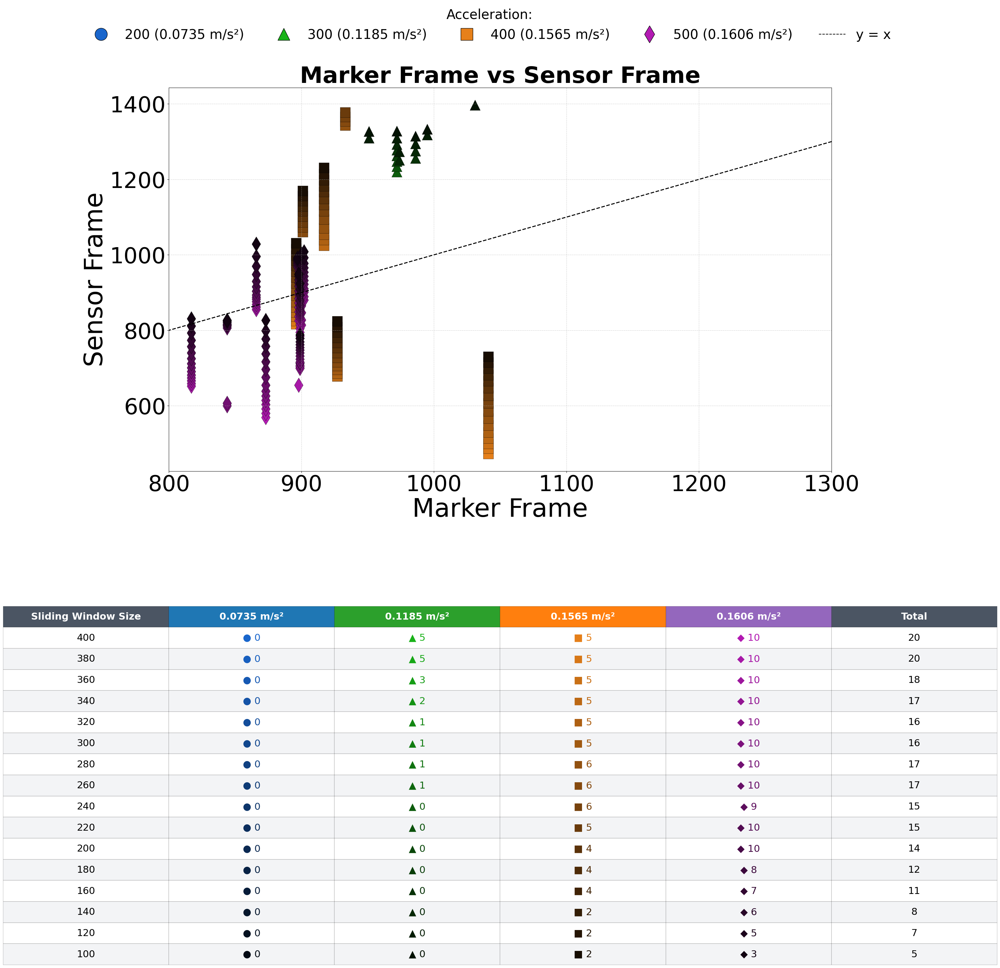

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# === READ DATA ===
file_path = "SlopedetectionMethod.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

# === CLEAN COLUMN NAMES ===
results_table.columns = results_table.columns.str.strip()

# === AUTO-DETECT SENSOR COLUMNS ===
sensor_cols = [col for col in results_table.columns if "_WindowSize" in col]

if not sensor_cols:
    raise ValueError("No sensor columns found. Check column names in CSV.")

# === FILTER VALID ACCELERATIONS ===
valid_accels = [200, 300, 400, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# === BASE COLORS (dark → light fading per sensor) ===
base_colors = np.array([
    [0.1, 0.4, 0.8],  # 200 = blue
    [0.1, 0.7, 0.1],  # 300 = green
    [0.9, 0.5, 0.1],  # 400 = orange
    [0.7, 0.1, 0.7]   # 500 = purple
])

shapes = ["o", "^", "s", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade = np.clip(base[None, :] * factors[:, None], 0, 1)
    fade_colors.append(fade)

# === FIGURE ===
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)
plt.subplots_adjust(hspace=0.85, top=0.88)

# === SCATTER PLOT ===
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if np.sum(idx) == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=558,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )

# === UNITY LINE (y = x) ===
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
y_min, y_max = np.nanmin(y_vals), np.nanmax(y_vals)

min_val = min(x_min, y_min)
max_val = max(x_max, y_max)

ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# === AXIS SETTINGS ===
ax_main.set_xlabel("Marker Frame", fontsize=58)
ax_main.set_ylabel("Sensor Frame", fontsize=58)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', which='major', labelsize=50)

# === LEGEND ===
legend_handles = [
    plt.Line2D([], [], color=base_colors[a_idx],
               marker=shapes[a_idx], linestyle="None",
               markersize=28, markeredgecolor="k")
    for a_idx, _ in enumerate(accel_vals)
]

accel_descriptions = {
    200: "200 (0.0735 m/s²)",
    300: "300 (0.1185 m/s²)",
    400: "400 (0.1565 m/s²)",
    500: "500 (0.1606 m/s²)"
}

legend_labels = [accel_descriptions[a] for a in accel_vals]
legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
legend_labels.append("y = x")

fig.legend(
    legend_handles,
    legend_labels,
    loc="upper center",
    bbox_to_anchor=(0.5, 0.97),
    ncol=len(accel_vals) + 1,
    frameon=False,
    title="Acceleration:",
    fontsize=30,
    title_fontsize=30
)

# === TITLE ===
ax_main.set_title(
    "Marker Frame vs Sensor Frame",
    fontsize=52,
    weight="bold",
    pad=10
)

# === TABLE ===
ax_table.axis("off")

# Sort sensors numerically by label extracted from column name
sorted_sensors = sorted(
    sensor_cols,
    key=lambda c: float(c.replace("x_", "").replace("_WindowSize", ""))
)

# Extract sensor labels directly (NO MAPPING)
sensor_labels = [
    str(abs(int(col.replace("x_", "").replace("_WindowSize", ""))))
    for col in sorted_sensors
]

# sensor_labels = [
#     col.replace("x_", "").replace("_WindowSize", "")
#     for col in sorted_sensors
# ]

# Count data points
counts_by_accel = []
totals = []

for col in sorted_sensors:
    row_counts = []
    for a_val in accel_vals:
        idx = accels == a_val
        row_counts.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row_counts)
    totals.append(sum(row_counts))

# Table column labels
accel_descriptions_table = {
    200: "0.0735 m/s²",
    300: "0.1185 m/s²",
    400: "0.1565 m/s²",
    500: "0.1606 m/s²"
}

col_labels = (
    ["Sliding Window Size"]
    + [accel_descriptions_table[a] for a in accel_vals]
    + ["Total"]
)

# Build table data
unicode_shapes = ["●", "▲", "■", "◆"]
table_data = []

for r, label in enumerate(sensor_labels):
    row = [label]
    for a_idx in range(len(accel_vals)):
        marker = unicode_shapes[a_idx]
        row.append(f"{marker} {counts_by_accel[r][a_idx]}")
    row.append(str(totals[r]))
    table_data.append(row)

tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(22)
tbl.scale(1.5, 4.0)

# === STYLE TABLE ===
for (row, col), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if row == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c", "#ff7f0e", "#9467bd", "#4B5563"]
        cell.set_text_props(weight="bold", color="white")
        cell.set_facecolor(header_colors[col])
    else:
        cell.set_facecolor("#F3F4F6" if row % 2 == 0 else "white")
        if 1 <= col <= len(accel_vals):
            color = fade_colors[col - 1][row - 1]
            rgb = tuple((color * 255).astype(int))
            cell.get_text().set_color('#%02x%02x%02x' % rgb)

# === SAVE ===
plt.savefig(
    "MarkerSensorScatter_Final_NoMapping.png",
    dpi=400,
    bbox_inches="tight"
)
plt.show()


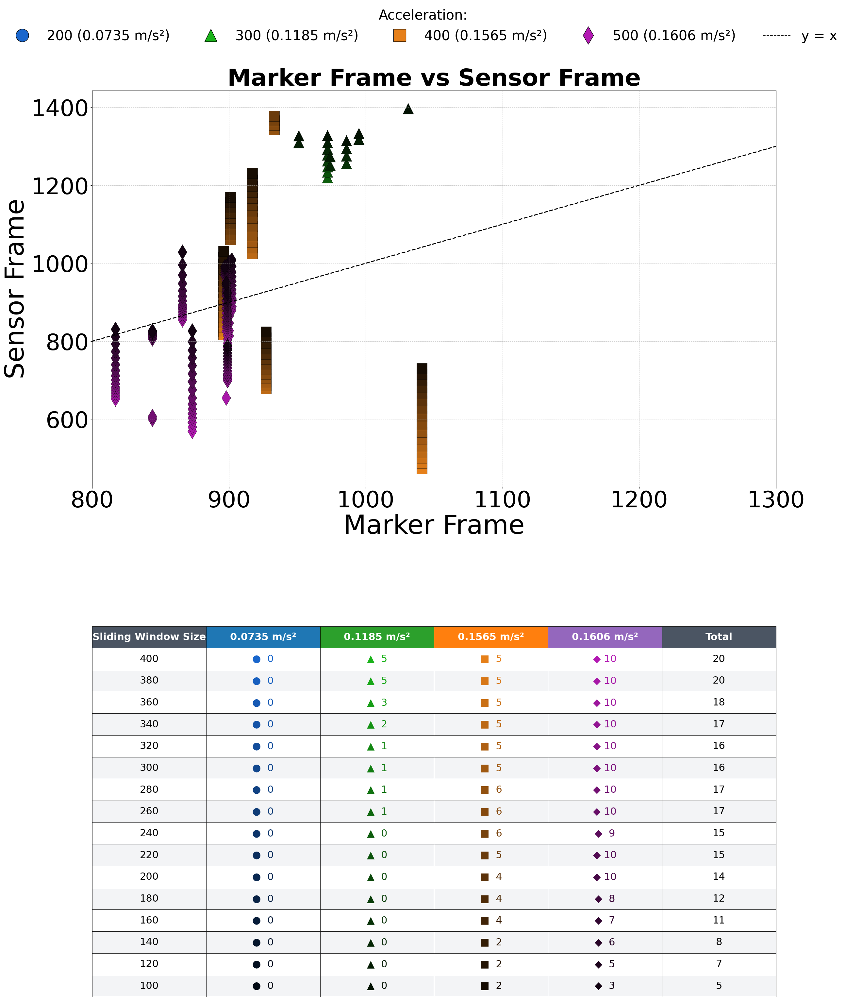

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# === READ DATA ===
file_path = "SlopedetectionMethod.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

# === CLEAN COLUMN NAMES ===
results_table.columns = results_table.columns.str.strip()

# === AUTO-DETECT SENSOR COLUMNS ===
sensor_cols = [col for col in results_table.columns if "_WindowSize" in col]

if not sensor_cols:
    raise ValueError("No sensor columns found. Check column names in CSV.")

# === FILTER VALID ACCELERATIONS ===
valid_accels = [200, 300, 400, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# === BASE COLORS (dark → light fading per sensor) ===
base_colors = np.array([
    [0.1, 0.4, 0.8],  # 200 = blue
    [0.1, 0.7, 0.1],  # 300 = green
    [0.9, 0.5, 0.1],  # 400 = orange
    [0.7, 0.1, 0.7]   # 500 = purple
])

shapes = ["o", "^", "s", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade = np.clip(base[None, :] * factors[:, None], 0, 1)
    fade_colors.append(fade)

# === FIGURE ===
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)
plt.subplots_adjust(hspace=0.85, top=0.88)

# === SCATTER PLOT ===
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if np.sum(idx) == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=558,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )

# === UNITY LINE (y = x) ===
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
y_min, y_max = np.nanmin(y_vals), np.nanmax(y_vals)

min_val = min(x_min, y_min)
max_val = max(x_max, y_max)

ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# === AXIS SETTINGS ===
ax_main.set_xlabel("Marker Frame", fontsize=58)
ax_main.set_ylabel("Sensor Frame", fontsize=58)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', which='major', labelsize=50)

# === LEGEND ===
legend_handles = [
    plt.Line2D([], [], color=base_colors[a_idx],
               marker=shapes[a_idx], linestyle="None",
               markersize=28, markeredgecolor="k")
    for a_idx, _ in enumerate(accel_vals)
]

accel_descriptions = {
    200: "200 (0.0735 m/s²)",
    300: "300 (0.1185 m/s²)",
    400: "400 (0.1565 m/s²)",
    500: "500 (0.1606 m/s²)"
}

legend_labels = [accel_descriptions[a] for a in accel_vals]
legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
legend_labels.append("y = x")

fig.legend(
    legend_handles,
    legend_labels,
    loc="upper center",
    bbox_to_anchor=(0.5, 0.97),
    ncol=len(accel_vals) + 1,
    frameon=False,
    title="Acceleration:",
    fontsize=30,
    title_fontsize=30
)

# === TITLE ===
ax_main.set_title(
    "Marker Frame vs Sensor Frame",
    fontsize=52,
    weight="bold",
    pad=10
)

# === TABLE ===
ax_table.axis("off")

# Sort sensors numerically
sorted_sensors = sorted(
    sensor_cols,
    key=lambda c: float(c.replace("x_", "").replace("_WindowSize", ""))
)

# Sensor labels
sensor_labels = [
    str(abs(int(col.replace("x_", "").replace("_WindowSize", ""))))
    for col in sorted_sensors
]

# Count data points
counts_by_accel = []
totals = []

for col in sorted_sensors:
    row_counts = []
    for a_val in accel_vals:
        idx = accels == a_val
        row_counts.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row_counts)
    totals.append(sum(row_counts))

# Table column labels
accel_descriptions_table = {
    200: "0.0735 m/s²",
    300: "0.1185 m/s²",
    400: "0.1565 m/s²",
    500: "0.1606 m/s²"
}

col_labels = ["Sliding Window Size"] + [accel_descriptions_table[a] for a in accel_vals] + ["Total"]

# Build table data with shapes
# unicode_shapes = ["●", "▲", "■","◆\u2007"]
unicode_shapes = ["●", "▲", "■", "◆"]


table_data = []
for r, label in enumerate(sensor_labels):
    row = [label]
    for a_idx in range(len(accel_vals)):
        row.append(f"{unicode_shapes[a_idx]} {counts_by_accel[r][a_idx]:>2}")
        # row.append(f"{unicode_shapes[a_idx]} {counts_by_accel[r][a_idx]}")
    row.append(str(totals[r]))
    table_data.append(row)

# Create table
tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(22)
tbl.scale(1, 4.0)

# === STYLE TABLE ===
# for (row, col), cell in tbl.get_celld().items():
#     cell.set_edgecolor("black")
#     cell.set_linewidth(0.6)
#     if row == 0:
#         header_colors = ["#4B5563", "#1f77b4", "#2ca02c", "#ff7f0e", "#9467bd", "#4B5563"]
#         cell.set_text_props(weight="bold", color="white")
#         cell.set_facecolor(header_colors[col])
#     else:
#         cell.set_facecolor("#F3F4F6" if row % 2 == 0 else "white")
#         if 1 <= col <= len(accel_vals):
#             sensor_idx = row - 1
#             accel_idx = col - 1
#             if sensor_idx < fade_colors[accel_idx].shape[0]:
#                 color = fade_colors[accel_idx][sensor_idx]
#                 rgb = tuple((color * 255).astype(int))
#                 cell.get_text().set_color('#%02x%02x%02x' % rgb)
# === STYLE TABLE ===
for (row, col), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    cell.get_text().set_verticalalignment("center")  # <--- NEW LINE
    if row == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c", "#ff7f0e", "#9467bd", "#4B5563"]
        cell.set_text_props(weight="bold", color="white")
        cell.set_facecolor(header_colors[col])
    else:
        cell.set_facecolor("#F3F4F6" if row % 2 == 0 else "white")
        if 1 <= col <= len(accel_vals):
            sensor_idx = row - 1
            accel_idx = col - 1
            if sensor_idx < fade_colors[accel_idx].shape[0]:
                color = fade_colors[accel_idx][sensor_idx]
                rgb = tuple((color * 255).astype(int))
                cell.get_text().set_color('#%02x%02x%02x' % rgb)


# === SAVE FIGURE ===
plt.savefig(
    "MarkerSensorScatter_Final_NoMapping.png",
    dpi=400,
    bbox_inches="tight"
)
plt.show()


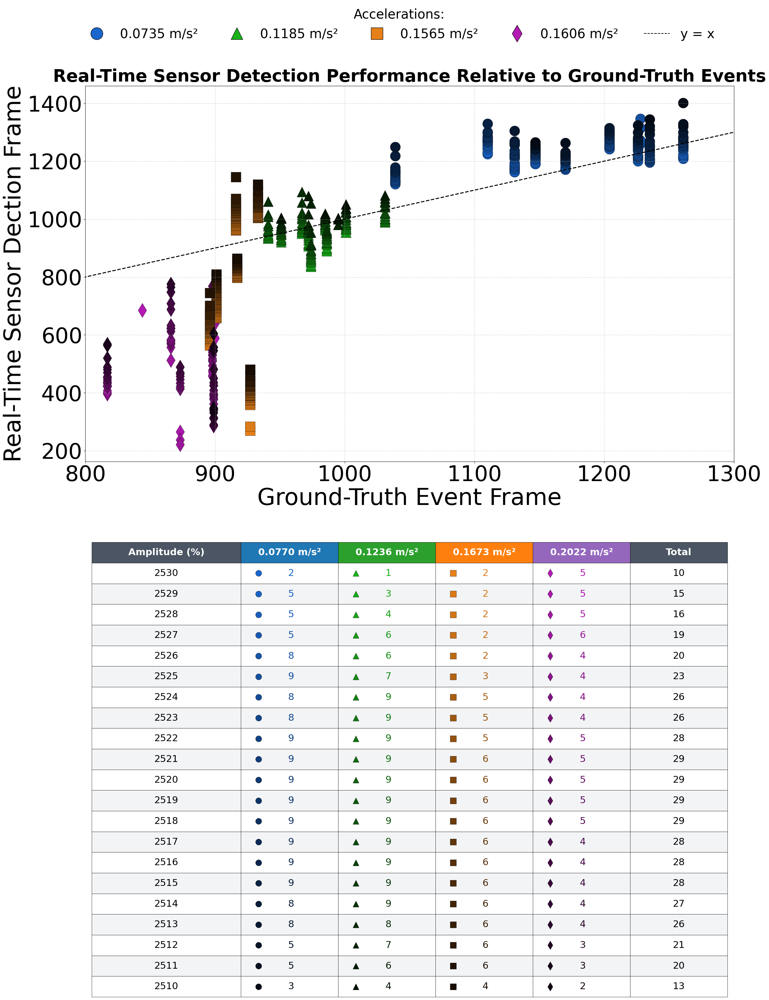

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.transforms import Bbox

# === READ DATA ===
file_path = "sensor_marker_thresholds_widealldata21modified.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

# === CLEAN COLUMN NAMES ===
results_table.columns = results_table.columns.str.strip()

# === AUTO-DETECT SENSOR COLUMNS ===
sensor_cols = [col for col in results_table.columns if "_Sensor_Frame" in col]
if not sensor_cols:
    raise ValueError("No sensor columns found. Check column names in CSV.")

# === FILTER VALID ACCELERATIONS ===
valid_accels = [200, 300, 400, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# === BASE COLORS (dark → light fading per sensor) ===
base_colors = np.array([
    [0.1, 0.4, 0.8],  # 200 = blue
    [0.1, 0.7, 0.1],  # 300 = green
    [0.9, 0.5, 0.1],  # 400 = orange
    [0.7, 0.1, 0.7]   # 500 = purple
])
# base_colors = np.array([
#     [0.0, 0.8, 1.0],  # bright cyan
#     [1.0, 0.8, 0.0],  # bright yellow-orange
#     [1.0, 0.2, 0.0],  # bright red
#     [1.0, 0.0, 1.0]   # bright magenta
# ])

# base_colors = np.array([
#     [0.6, 0.4, 0.2],  # brown
#     [0.8, 0.6, 0.1],  # mustard yellow
#     [0.2, 0.6, 0.2],  # olive green
#     [0.7, 0.3, 0.1]   # terracotta
# ])

# base_colors = np.array([
#     [0.0, 0.6, 0.9],  # light blue
#     [0.0, 0.8, 0.6],  # teal
#     [0.6, 0.0, 0.8],  # violet
#     [0.9, 0.3, 0.3]   # salmon red
# ])


shapes = ["o", "^", "s", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade_colors.append(np.clip(base[None, :] * factors[:, None], 0, 1))

# === SENSOR TO % MAP ===
sensor_to_percent = {
    "-2530": 29.83, "-2529": 31.48, "-2528": 33.13, "-2527": 34.77,
    "-2526": 36.42, "-2525": 38.07, "-2524": 39.72, "-2523": 41.36,
    "-2522": 43.01, "-2521": 44.66, "-2520": 46.31, "-2519": 47.95,
    "-2518": 49.60, "-2517": 51.25, "-2516": 52.90, "-2515": 54.54,
    "-2514": 56.19, "-2513": 57.84, "-2512": 59.48, "-2511": 61.13,
    "-2510": 62.78
}
# === FIGURE ===
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)
plt.subplots_adjust(hspace=0.85, top=0.88)

# === SCATTER PLOT ===
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if np.sum(idx) == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=558,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )

# === UNITY LINE (y = x) ===
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
min_val = min(x_min, np.nanmin(y_vals))
max_val = max(x_max, np.nanmax(y_vals))

ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# === AXIS SETTINGS ===
ax_main.set_xlabel("Ground-Truth Event Frame", fontsize=54)
ax_main.set_ylabel("Real-Time Sensor Dection Frame", fontsize=54)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', which='major', labelsize=50)

# === LEGEND ===
accel_descriptions = {
    200: "0.0735 m/s²",
    300: "0.1185 m/s²",
    400: "0.1565 m/s²",
    500: "0.1606 m/s²"
}

legend_handles = [
    plt.Line2D([], [], color=base_colors[i], marker=shapes[i],
               linestyle="None", markersize=28, markeredgecolor="k")
    for i in range(len(accel_vals))
]
legend_labels = [accel_descriptions[a] for a in accel_vals]

legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
legend_labels.append("y = x")

fig.legend(
    legend_handles,
    legend_labels,
    loc="upper center",
    bbox_to_anchor=(0.5, 0.97),
    ncol=len(accel_vals) + 1,
    frameon=False,
    title="Accelerations:",
    fontsize=30,
    title_fontsize=30
)

# === TITLE ===
ax_main.set_title("Real-Time Sensor Detection Performance Relative to Ground-Truth Events",
                  fontsize=40, weight="bold", pad=10)

# =========================
# ===== TABLE SECTION =====
# =========================
ax_table.axis("off")

# Sort sensors numerically
sorted_sensors = sorted(
    sensor_cols,
    key=lambda c: float(c.replace("x_", "").replace("_Sensor_Frame", ""))
)

sensor_labels = [
    str(abs(int(col.replace("x_", "").replace("_Sensor_Frame", ""))))
    for col in sorted_sensors
]

# Count data points
counts_by_accel = []
totals = []

for col in sorted_sensors:
    row_counts = []
    for a_val in accel_vals:
        idx = accels == a_val
        row_counts.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row_counts)
    totals.append(sum(row_counts))

# Column labels
accel_descriptions_table = {
    200: "0.0770 m/s²",
    300: "0.1236 m/s²",
    400: "0.1673 m/s²",
    500: "0.2022 m/s²"
}

col_labels = (
    ["Amplitude (%)"]
    + [accel_descriptions_table[a] for a in accel_vals]
    + ["Total"]
)

# === TABLE TEXT: NUMBERS ONLY ===
table_data = []
for r, label in enumerate(sensor_labels):
    row = [label]
    for a_idx in range(len(accel_vals)):
        row.append(f"{counts_by_accel[r][a_idx]:>2}")
    row.append(str(totals[r]))
    table_data.append(row)

tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(22)
tbl.scale(3.8, 4.0)

# --- MANUAL COLUMN WIDTHS ---
# Relative widths for each column (first column wider)
col_widths = [0.23, 0.15, 0.15, 0.15, 0.15, 0.15]

for (row, col), cell in tbl.get_celld().items():
    if col < len(col_widths):
        cell.set_width(col_widths[col])


# === STYLE TABLE CELLS ===
for (row, col), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if row == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c",
                         "#ff7f0e", "#9467bd", "#4B5563"]
        cell.set_text_props(weight="bold", color="white")
        cell.set_facecolor(header_colors[col])
    else:
        cell.set_facecolor("#F3F4F6" if row % 2 == 0 else "white")
        if 1 <= col <= len(accel_vals):
            sensor_idx = row - 1
            accel_idx = col - 1
            if sensor_idx < fade_colors[accel_idx].shape[0]:
                rgb = (fade_colors[accel_idx][sensor_idx] * 255).astype(int)
                cell.get_text().set_color(f"#{rgb[0]:02x}{rgb[1]:02x}{rgb[2]:02x}")

# === DRAW MARKERS INSIDE TABLE CELLS ===
fig.canvas.draw()  # REQUIRED

for (row, col), cell in tbl.get_celld().items():
    if row == 0 or col == 0 or col > len(accel_vals):
        continue

    accel_idx = col - 1
    sensor_idx = row - 1

    if sensor_idx >= fade_colors[accel_idx].shape[0]:
        continue

    rgb = fade_colors[accel_idx][sensor_idx]

    bbox = cell.get_window_extent(fig.canvas.get_renderer())
    inv = ax_table.transAxes.inverted()
    bbox_axes = Bbox(inv.transform(bbox))

    x = bbox_axes.x0 + 0.18 * bbox_axes.width
    y = bbox_axes.y0 + 0.50 * bbox_axes.height

    ax_table.scatter(
        x, y,
        s=200,
        marker=shapes[accel_idx],
        color=rgb,            # <-- FIXED to faded color
        edgecolor="k",
        linewidth=0.4,
        transform=ax_table.transAxes,
        zorder=10,
        clip_on=False
    )

# === SAVE FIGURE ===
plt.savefig(
    "MarkerSensorScatter_Final_NoMapping.png",
    dpi=400,
    bbox_inches="tight"
)
plt.show()


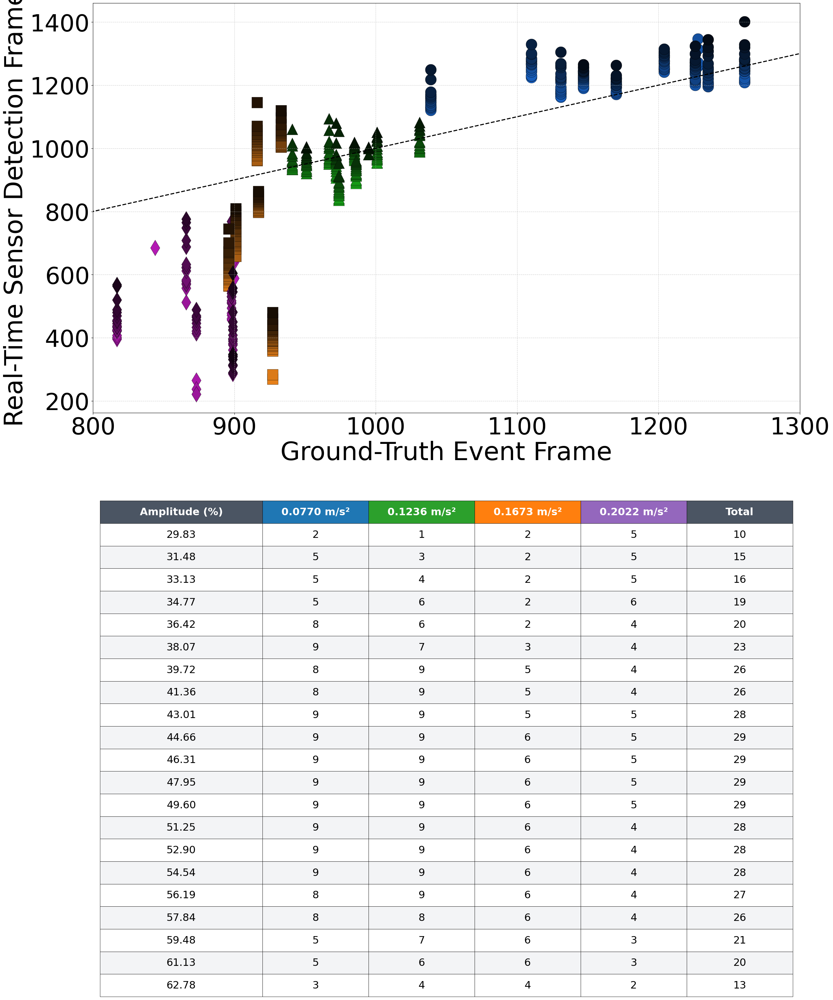

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.transforms import Bbox

# === READ DATA ===
file_path = "sensor_marker_thresholds_widealldata21modified.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

# === CLEAN COLUMN NAMES ===
results_table.columns = results_table.columns.str.strip()

# === AUTO-DETECT SENSOR COLUMNS ===
sensor_cols = [col for col in results_table.columns if "_Sensor_Frame" in col]
if not sensor_cols:
    raise ValueError("No sensor columns found. Check column names in CSV.")

# === FILTER VALID ACCELERATIONS ===
valid_accels = [200, 300, 400, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# === BASE COLORS ===
base_colors = np.array([
    [0.1, 0.4, 0.8],
    [0.1, 0.7, 0.1],
    [0.9, 0.5, 0.1],
    [0.7, 0.1, 0.7]
])

shapes = ["o", "^", "s", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade_colors.append(np.clip(base[None, :] * factors[:, None], 0, 1))

# === SENSOR → PERCENT MAP ===
sensor_to_percent = {
    "-2530": 29.83, "-2529": 31.48, "-2528": 33.13, "-2527": 34.77,
    "-2526": 36.42, "-2525": 38.07, "-2524": 39.72, "-2523": 41.36,
    "-2522": 43.01, "-2521": 44.66, "-2520": 46.31, "-2519": 47.95,
    "-2518": 49.60, "-2517": 51.25, "-2516": 52.90, "-2515": 54.54,
    "-2514": 56.19, "-2513": 57.84, "-2512": 59.48, "-2511": 61.13,
    "-2510": 62.78
}

# === FIGURE ===
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)
plt.subplots_adjust(hspace=0.85, top=0.88)

# === SCATTER PLOT ===
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if np.sum(idx) == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=558,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )

# === UNITY LINE ===
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
min_val = min(x_min, np.nanmin(y_vals))
max_val = max(x_max, np.nanmax(y_vals))
ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# === AXIS SETTINGS ===
ax_main.set_xlabel("Ground-Truth Event Frame", fontsize=54)
ax_main.set_ylabel("Real-Time Sensor Detection Frame", fontsize=54)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', labelsize=50)

# === TABLE SECTION ===
ax_table.axis("off")

# === SORT SENSORS NUMERICALLY ===
sorted_sensors = sorted(
    sensor_cols,
    key=lambda c: int(c.replace("x_", "").replace("_Sensor_Frame", ""))
)

# === FIXED: SENSOR → % LABELS ===
sensor_keys = [
    str(int(col.replace("x_", "").replace("_Sensor_Frame", "")))
    for col in sorted_sensors
]

sensor_labels = [
    f"{sensor_to_percent[k]:.2f}" if k in sensor_to_percent else "NA"
    for k in sensor_keys
]

# === COUNT DATA ===
counts_by_accel = []
totals = []

for col in sorted_sensors:
    row_counts = []
    for a_val in accel_vals:
        idx = accels == a_val
        row_counts.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row_counts)
    totals.append(sum(row_counts))

# === COLUMN LABELS ===
accel_descriptions_table = {
    200: "0.0770 m/s²",
    300: "0.1236 m/s²",
    400: "0.1673 m/s²",
    500: "0.2022 m/s²"
}

col_labels = (
    ["Amplitude (%)"]
    + [accel_descriptions_table[a] for a in accel_vals]
    + ["Total"]
)

# === TABLE DATA ===
table_data = []
for r, label in enumerate(sensor_labels):
    row = [label]
    for a_idx in range(len(accel_vals)):
        row.append(str(counts_by_accel[r][a_idx]))
    row.append(str(totals[r]))
    table_data.append(row)

tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(22)
tbl.scale(3.8, 4.0)

# === COLUMN WIDTHS ===
col_widths = [0.23, 0.15, 0.15, 0.15, 0.15, 0.15]
for (row, col), cell in tbl.get_celld().items():
    if col < len(col_widths):
        cell.set_width(col_widths[col])

# === STYLE ===
for (row, col), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if row == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c",
                         "#ff7f0e", "#9467bd", "#4B5563"]
        cell.set_text_props(weight="bold", color="white")
        cell.set_facecolor(header_colors[col])
    else:
        cell.set_facecolor("#F3F4F6" if row % 2 == 0 else "white")

# === SAVE ===
plt.savefig(
    "MarkerSensorScatter_Final_WithMapping.png",
    dpi=400,
    bbox_inches="tight"
)
plt.show()


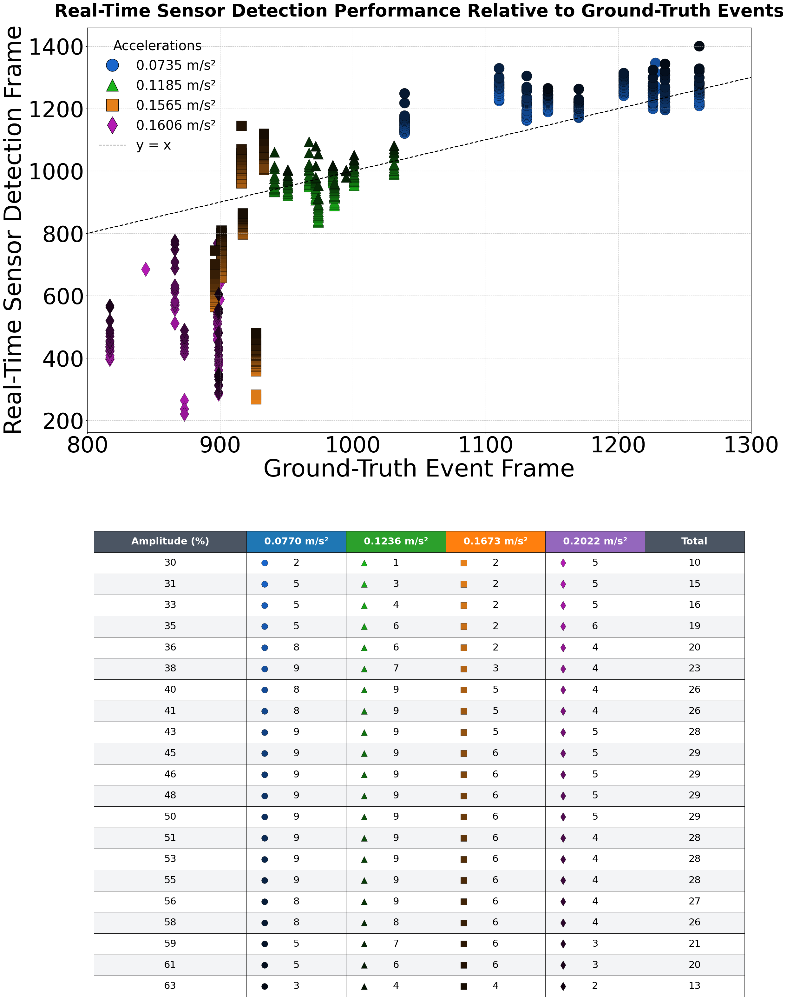

In [ ]:
# ORIGINAL PLOTS WITH 4 ACCELELERATIONS
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.transforms import Bbox

# ======================
# READ DATA
# ======================
file_path = "sensor_marker_thresholds_widealldata21modified.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

results_table.columns = results_table.columns.str.strip()

# ======================
# SENSOR COLUMNS
# ======================
sensor_cols = [c for c in results_table.columns if "_Sensor_Frame" in c]
if not sensor_cols:
    raise ValueError("No sensor columns found.")

# ======================
# FILTER ACCELS
# ======================
valid_accels = [200, 300, 400, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# ======================
# COLORS & SHAPES
# ======================
base_colors = np.array([
    [0.1, 0.4, 0.8],
    [0.1, 0.7, 0.1],
    [0.9, 0.5, 0.1],
    [0.7, 0.1, 0.7]
])

shapes = ["o", "^", "s", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade_colors.append(np.clip(base[None, :] * factors[:, None], 0, 1))

# ======================
# SENSOR → % MAP
# ======================
sensor_to_percent = {
    "-2530": 30, "-2529": 31, "-2528": 33, "-2527": 35,
    "-2526": 36, "-2525": 38, "-2524": 40, "-2523": 41,
    "-2522": 43, "-2521": 45, "-2520": 46, "-2519": 48,
    "-2518": 50, "-2517": 51, "-2516": 53, "-2515": 55,
    "-2514": 56, "-2513": 58, "-2512": 59, "-2511": 61,
    "-2510": 63
}

# ======================
# FIGURE
# ======================
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)

# ✅ FIX: allow space for title
plt.subplots_adjust(hspace=0.85, top=0.92)

# ======================
# SCATTER PLOT
# ======================
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if idx.sum() == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=558,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )

# UNITY LINE
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
min_val = min(x_min, np.nanmin(y_vals))
max_val = max(x_max, np.nanmax(y_vals))
ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# AXES
ax_main.set_xlabel("Ground-Truth Event Frame", fontsize=54)
ax_main.set_ylabel("Real-Time Sensor Detection Frame", fontsize=54)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', labelsize=50)

# ======================
# TITLE  ✅ FIX
# ======================
ax_main.set_title(
    "Real-Time Sensor Detection Performance Relative to Ground-Truth Events",
    fontsize=40,
    weight="bold",
    pad=25
)

# ======================
# LEGEND  ✅ FIX
# ======================
accel_descriptions = {
    200: "0.0735 m/s²",
    300: "0.1185 m/s²",
    400: "0.1565 m/s²",
    500: "0.1606 m/s²"
}

legend_handles = [
    plt.Line2D([], [], color=base_colors[i], marker=shapes[i],
               linestyle="None", markersize=28, markeredgecolor="k")
    for i in range(len(accel_vals))
]
legend_labels = [accel_descriptions[a] for a in accel_vals]

legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
legend_labels.append("y = x")

ax_main.legend(
    legend_handles,
    legend_labels,
    loc="upper left",
    fontsize=30,
    frameon=False,
    title="Accelerations",
    title_fontsize=30
)

# ======================
# TABLE SECTION
# ======================
ax_table.axis("off")

sorted_sensors = sorted(
    sensor_cols,
    key=lambda c: int(c.replace("x_", "").replace("_Sensor_Frame", ""))
)

sensor_keys = [
    str(int(c.replace("x_", "").replace("_Sensor_Frame", "")))
    for c in sorted_sensors
]

sensor_labels = [
    str(int(round(sensor_to_percent[k])))
 if k in sensor_to_percent else "NA"
    for k in sensor_keys
]

counts_by_accel = []
totals = []

for col in sorted_sensors:
    row = []
    for a in accel_vals:
        idx = accels == a
        row.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row)
    totals.append(sum(row))

accel_desc = {
    200: "0.0770 m/s²",
    300: "0.1236 m/s²",
    400: "0.1673 m/s²",
    500: "0.2022 m/s²"
}

col_labels = ["Amplitude (%)"] + [accel_desc[a] for a in accel_vals] + ["Total"]

table_data = []
for i, label in enumerate(sensor_labels):
    row = [label] + [str(v) for v in counts_by_accel[i]] + [str(totals[i])]
    table_data.append(row)

tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(22)
tbl.scale(3.8, 4.0)

# COLUMN WIDTHS
col_widths = [0.23, 0.15, 0.15, 0.15, 0.15, 0.15]
for (r, c), cell in tbl.get_celld().items():
    if c < len(col_widths):
        cell.set_width(col_widths[c])

# STYLE
for (r, c), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if r == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c",
                         "#ff7f0e", "#9467bd", "#4B5563"]
        cell.set_facecolor(header_colors[c])
        cell.set_text_props(weight="bold", color="white")
    else:
        cell.set_facecolor("#F3F4F6" if r % 2 == 0 else "white")

# ======================
# DRAW MARKERS IN TABLE
# ======================
fig.canvas.draw()

for (r, c), cell in tbl.get_celld().items():
    if r == 0 or c == 0 or c > len(accel_vals):
        continue

    accel_idx = c - 1
    sensor_idx = r - 1
    if sensor_idx >= fade_colors[accel_idx].shape[0]:
        continue

    rgb = fade_colors[accel_idx][sensor_idx]

    bbox = cell.get_window_extent(fig.canvas.get_renderer())
    inv = ax_table.transAxes.inverted()
    bbox_axes = Bbox(inv.transform(bbox))

    ax_table.scatter(
        bbox_axes.x0 + 0.18 * bbox_axes.width,
        bbox_axes.y0 + 0.50 * bbox_axes.height,
        s=200,
        marker=shapes[accel_idx],
        color=rgb,
        edgecolor="k",
        linewidth=0.4,
        transform=ax_table.transAxes,
        zorder=10,
        clip_on=False
    )

# ======================
# SAVE
# ======================
plt.savefig(
    "MarkerSensorScatter_Final_WithMapping.png",
    dpi=400,
    bbox_inches="tight"
)
plt.show()


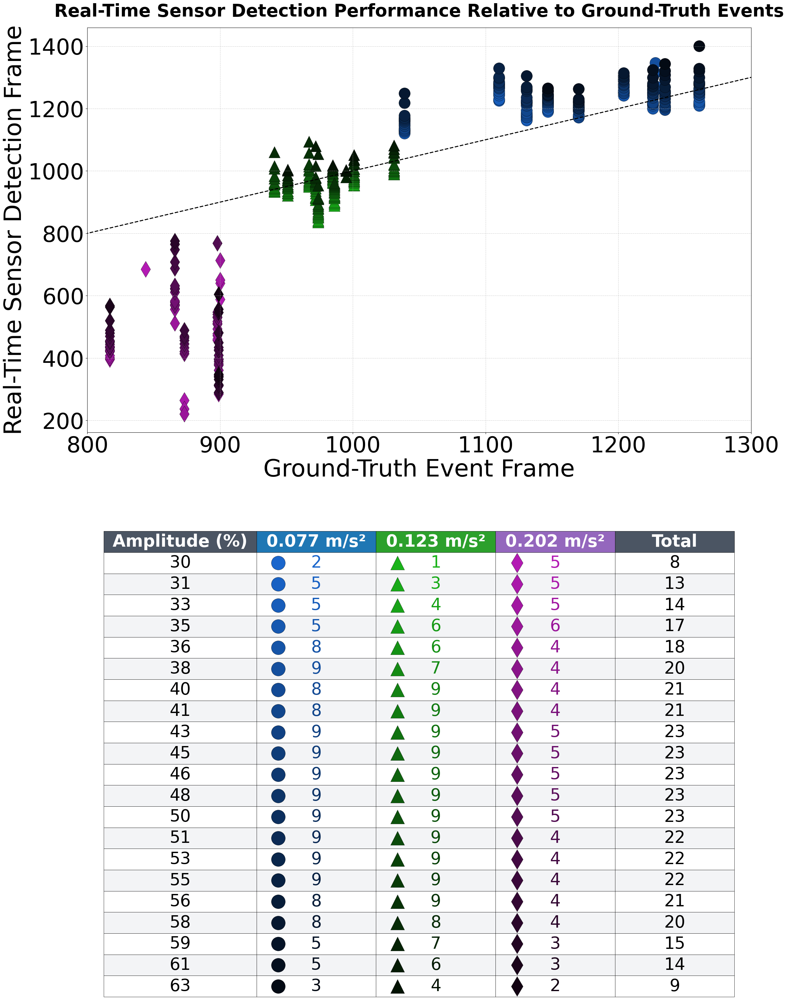

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.transforms import Bbox

# ======================
# READ DATA
# ======================
file_path = "sensor_marker_thresholds_widealldata21modified.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

results_table.columns = results_table.columns.str.strip()

# ======================
# SENSOR COLUMNS
# ======================
sensor_cols = [c for c in results_table.columns if "_Sensor_Frame" in c]
if not sensor_cols:
    raise ValueError("No sensor columns found.")

# ======================
# FILTER ACCELERATIONS (EXCLUDE 400)
# ======================
valid_accels = [200, 300, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# ======================
# COLORS & SHAPES (ONLY 3)
# ======================
base_colors = np.array([
    [0.1, 0.4, 0.8],  # 200
    [0.1, 0.7, 0.1],  # 300
    [0.7, 0.1, 0.7]   # 500
])

shapes = ["o", "^", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade_colors.append(np.clip(base[None, :] * factors[:, None], 0, 1))

# ======================
# SENSOR → AMPLITUDE MAP
# ======================
sensor_to_percent = {
    "-2530": 30, "-2529": 31, "-2528": 33, "-2527": 35,
    "-2526": 36, "-2525": 38, "-2524": 40, "-2523": 41,
    "-2522": 43, "-2521": 45, "-2520": 46, "-2519": 48,
    "-2518": 50, "-2517": 51, "-2516": 53, "-2515": 55,
    "-2514": 56, "-2513": 58, "-2512": 59, "-2511": 61,
    "-2510": 63
}
# sensor_to_percent = {
#     "-2530": 29.83, "-2529": 31.48, "-2528": 33.13, "-2527": 34.77,
#     "-2526": 36.42, "-2525": 38.07, "-2524": 39.72, "-2523": 41.36,
#     "-2522": 43.01, "-2521": 44.66, "-2520": 46.31, "-2519": 47.95,
#     "-2518": 49.60, "-2517": 51.25, "-2516": 52.90, "-2515": 54.54,
#     "-2514": 56.19, "-2513": 57.84, "-2512": 59.48, "-2511": 61.13,
#     "-2510": 62.78
# }

# ======================
# FIGURE
# ======================
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)

plt.subplots_adjust(hspace=0.85, top=0.92)

# ======================
# SCATTER PLOT
# ======================
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if idx.sum() == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=668,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )

# UNITY LINE
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
min_val = min(x_min, np.nanmin(y_vals))
max_val = max(x_max, np.nanmax(y_vals))

ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# AXES
ax_main.set_xlabel("Ground-Truth Event Frame", fontsize=54)
ax_main.set_ylabel("Real-Time Sensor Detection Frame", fontsize=54)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', labelsize=50)

# TITLE
ax_main.set_title(
    "Real-Time Sensor Detection Performance Relative to Ground-Truth Events",
    fontsize=40,
    weight="bold",
    pad=25
)

# ======================
# LEGEND
# ======================
# accel_descriptions = {
#     200: "0.077 m/s²",
#     300: "0.123 m/s²",
#     500: "0.202 m/s²"
# }

# legend_handles = [
#     plt.Line2D([], [], color=base_colors[i], marker=shapes[i],
#                linestyle="None", markersize=28, markeredgecolor="k")
#     for i in range(len(accel_vals))
# ]
# legend_labels = [accel_descriptions[a] for a in accel_vals]

# legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
# legend_labels.append("y = x")

# ax_main.legend(
#     legend_handles,
#     legend_labels,
#     loc="upper left",
#     fontsize=30,
#     frameon=False,
#     title="Accelerations",
#     title_fontsize=30
# )

# ======================
# TABLE SECTION
# ======================
ax_table.axis("off")

sorted_sensors = sorted(
    sensor_cols,
    key=lambda c: int(c.replace("x_", "").replace("_Sensor_Frame", ""))
)

sensor_keys = [
    str(int(c.replace("x_", "").replace("_Sensor_Frame", "")))
    for c in sorted_sensors
]

sensor_labels = [
    str(int(round(sensor_to_percent[k])))
 if k in sensor_to_percent else "NA"
    for k in sensor_keys
]

counts_by_accel = []
totals = []

for col in sorted_sensors:
    row = []
    for a in accel_vals:
        idx = accels == a
        row.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row)
    totals.append(sum(row))

accel_desc = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

col_labels = ["Amplitude (%)"] + [accel_desc[a] for a in accel_vals] + ["Total"]

table_data = []
for i, label in enumerate(sensor_labels):
    row = [label] + [str(v) for v in counts_by_accel[i]] + [str(totals[i])]
    table_data.append(row)

tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(38)
tbl.scale(2.0, 4.0)

# COLUMN WIDTHS
col_widths = [0.23, 0.18, 0.18, 0.18, 0.18]
for (r, c), cell in tbl.get_celld().items():
    if c < len(col_widths):
        cell.set_width(col_widths[c])

# STYLE
for (r, c), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if r == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c", "#9467bd", "#4B5563"]
        cell.set_facecolor(header_colors[c])
        cell.set_text_props(weight="bold", color="white")
    else:
        cell.set_facecolor("#F3F4F6" if r % 2 == 0 else "white")

# ======================
# DRAW MARKERS IN TABLE
# ======================
fig.canvas.draw()

for (r, c), cell in tbl.get_celld().items():
    if r == 0 or c == 0 or c > len(accel_vals):
        continue

    accel_idx = c - 1
    sensor_idx = r - 1
    if sensor_idx >= fade_colors[accel_idx].shape[0]:
        continue

    rgb = fade_colors[accel_idx][sensor_idx]

    # Color the cell text
    cell.get_text().set_color(rgb)

    bbox = cell.get_window_extent(fig.canvas.get_renderer())
    inv = ax_table.transAxes.inverted()
    bbox_axes = Bbox(inv.transform(bbox))

    ax_table.scatter(
        bbox_axes.x0 + 0.18 * bbox_axes.width,
        bbox_axes.y0 + 0.50 * bbox_axes.height,
        s=1000,
        marker=shapes[accel_idx],
        color=rgb,
        edgecolor="k",
        linewidth=0.4,
        transform=ax_table.transAxes,
        zorder=10,
        clip_on=False
    )

# ======================
# SAVE & SHOW
# ======================
plt.savefig(
    "MarkerSensorScatter_Final_Excluded_1673.png",
    dpi=400,
    bbox_inches="tight"
)
plt.show()


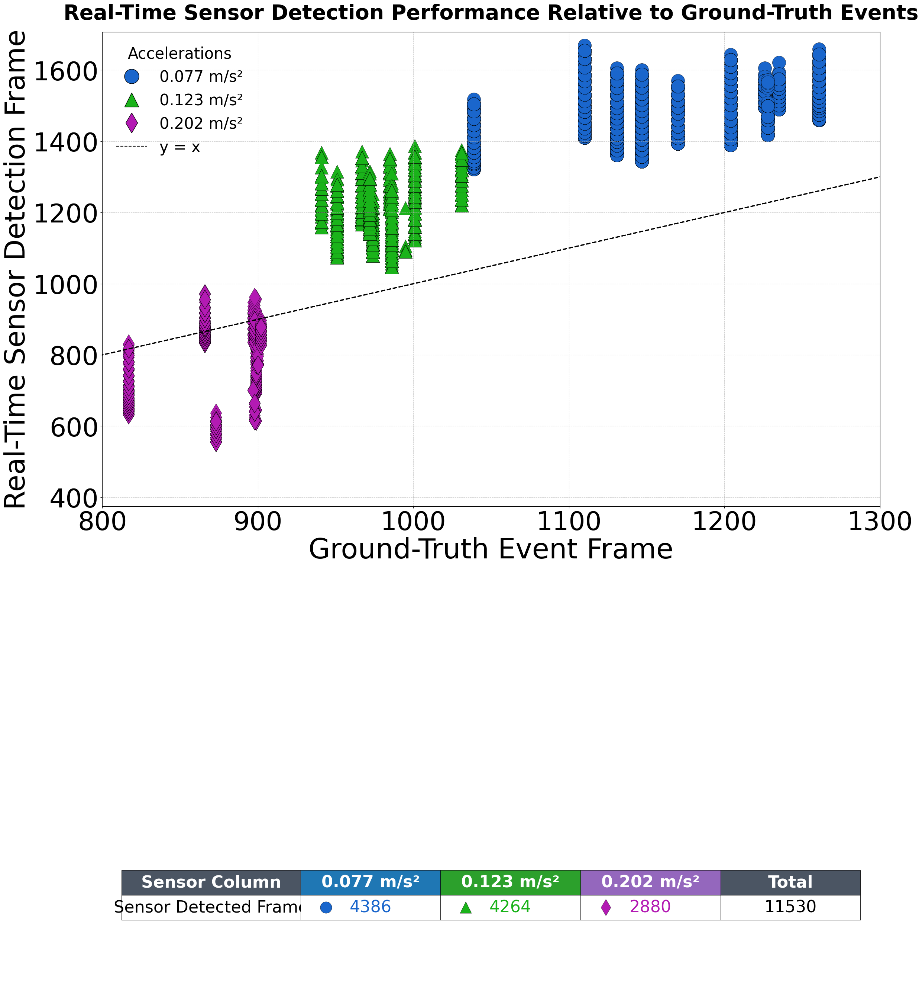

Total scatter dots: 11530


In [ ]:
#Slope Method Scatter plot
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.transforms import Bbox

# ======================
# READ DATA
# ======================
file_path = "slope_detection_summary112NEW.csv"
results_table = pd.read_csv(file_path)

marker_col = "Marker_DetectedFrame"
accel_col = "Acceleration"

results_table.columns = results_table.columns.str.strip()

# ======================
# SENSOR COLUMNS
# ======================
sensor_cols = [c for c in results_table.columns if "Sensor_DetectedFrame" in c]
if not sensor_cols:
    raise ValueError("No sensor columns found.")

# ======================
# FILTER ACCELERATIONS (EXCLUDE 400)
# ======================
valid_accels = [200, 300, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# ======================
# COLORS & SHAPES (ONLY 3)
# ======================
base_colors = np.array([
    [0.1, 0.4, 0.8],  # 200
    [0.1, 0.7, 0.1],  # 300
    [0.7, 0.1, 0.7]   # 500
])

shapes = ["o", "^", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade_colors.append(np.clip(base[None, :] * factors[:, None], 0, 1))

# ======================
# SENSOR → AMPLITUDE MAP (Not applicable for this CSV, removed for simplicity)
# ======================
# sensor_to_percent = {
#     "-2530": 30, "-2529": 31, "-2528": 33, "-2527": 35,
#     "-2526": 36, "-2525": 38, "-2524": 40, "-2523": 41,
#     "-2522": 43, "-2521": 45, "-2520": 46, "-2519": 48,
#     "-2518": 50, "-2517": 51, "-2516": 53, "-2515": 55,
#     "-2514": 56, "-2513": 58, "-2512": 59, "-2511": 61,
#     "-2510": 63
# }

# ======================
# FIGURE
# ======================
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)

plt.subplots_adjust(hspace=0.85, top=0.92)

# ======================
# SCATTER PLOT
# ======================
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if idx.sum() == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=668,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )
# y_min = np.min(y_vals)
# y_max = np.max(y_vals)

# padding = 0.01 * (y_max - y_min)  # 2% padding
# ax_main.set_ylim(y_min - padding, y_max + padding)

# y_min = np.min(y_vals)
# y_max = np.max(y_vals)

# ax_main.set_ylim(y_min, y_max)


# UNITY LINE
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
min_val = min(x_min, np.nanmin(y_vals))
max_val = max(x_max, np.nanmax(y_vals))

ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# ax_main.set_ylim(bottom=400)   # ← THIS IS THE ONLY LINE YOU NEED
# ------------------------
# AUTO-PAD Y-AXIS TO MOVE MINIMUM UP
# ------------------------
# y_vals = results_table[sensor_cols].to_numpy().flatten()
# y_vals = y_vals[~np.isnan(y_vals)]

# y_min = np.min(y_vals)
# y_max = np.max(y_vals)

# # Add 3% padding below the minimum, keep top as is
# pad_bottom = 0.03 * (y_max - y_min)
# ax_main.set_ylim(y_min - pad_bottom, y_max)

# ------------------------
# Y-AXIS STARTS AT 400, TOP AUTO
# ------------------------
# y_vals = results_table[sensor_cols].to_numpy().flatten()
# y_vals = y_vals[~np.isnan(y_vals)]

# y_max = np.max(y_vals)

# Add a small padding on top (e.g., 3%)
# pad_bottom = 0.03 * (y_max - 400)
# ax_main.set_ylim(400, y_max + pad_bottom)

# ------------------------
# Y-AXIS STARTS AT 400 WITH SMALL BOTTOM PADDING, TOP AUTO
# ------------------------
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]

y_min = 400  # fixed bottom
y_max = np.max(y_vals)

# Add a small padding below 400 (e.g., 1-2% of range)
pad_bottom = 0.02 * (y_max - y_min)
pad_top = 0.03 * (y_max - y_min)

ax_main.set_ylim(y_min - pad_bottom, y_max + pad_top)




# ---- FORCE Y-AXIS TO START AT DATA ----
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]

y_min = np.min(y_vals)
y_max = np.max(y_vals)

pad = 0.01 * (y_max - y_min)

# ax_main.tick_params(axis='y', pad=35)


# ax_main.autoscale(False)   # CRITICAL: stops unity line from expanding axis
# ax_main.set_ylim(y_min - pad, y_max + pad)

# ---- FORCE Y-AXIS TO START EXACTLY AT FIRST SCATTER POINT ----
# y_vals = results_table[sensor_cols].to_numpy().flatten()
# y_vals = y_vals[~np.isnan(y_vals)]

# y_min = np.min(y_vals)
# y_max = np.max(y_vals)

# ax_main.set_autoscale_on(False)   # hard-disable autoscaling
# ax_main.margins(y=0)              # REMOVE default matplotlib padding
# ax_main.set_ylim(y_min, y_max)    # lock y-axis to data

# # AXES
ax_main.set_xlabel("Ground-Truth Event Frame", fontsize=54)
ax_main.set_ylabel("Real-Time Sensor Detection Frame", fontsize=54)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', labelsize=50)

# TITLE
ax_main.set_title(
    "Real-Time Sensor Detection Performance Relative to Ground-Truth Events",
    fontsize=40,
    weight="bold",
    pad=25
)

# ======================
# LEGEND
# ======================
accel_descriptions = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

legend_handles = [
    plt.Line2D([], [], color=base_colors[i], marker=shapes[i],
               linestyle="None", markersize=28, markeredgecolor="k")
    for i in range(len(accel_vals))
]
legend_labels = [accel_descriptions[a] for a in accel_vals]

legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
legend_labels.append("y = x")

ax_main.legend(
    legend_handles,
    legend_labels,
    loc="upper left",
    fontsize=30,
    frameon=False,
    title="Accelerations",
    title_fontsize=30
)

# ======================
# TABLE SECTION
# ======================
ax_table.axis("off")

# === SORT SENSORS NUMERICALLY (Simplified for single sensor column) ===
sorted_sensors = sensor_cols # This will be ['Sensor_DetectedFrame']

# === FIXED: SENSOR → % LABELS (Simplified for single sensor column) ===
sensor_keys = sorted_sensors # Will be ['Sensor_DetectedFrame']
sensor_labels = ["Sensor Detected Frame"] # A descriptive label

counts_by_accel = []
totals = []

for col in sorted_sensors:
    row = []
    for a in accel_vals:
        idx = accels == a
        row.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row)
    totals.append(sum(row))

accel_desc = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

col_labels = ["Sensor Column"] + [accel_desc[a] for a in accel_vals] + ["Total"]

table_data = []
for i, label in enumerate(sensor_labels):
    row = [label] + [str(v) for v in counts_by_accel[i]] + [str(totals[i])]
    table_data.append(row)

tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(32)
tbl.scale(2.0, 4.0)

# COLUMN WIDTHS
col_widths = [0.23, 0.18, 0.18, 0.18, 0.18]
for (r, c), cell in tbl.get_celld().items():
    if c < len(col_widths):
        cell.set_width(col_widths[c])

# STYLE
for (r, c), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if r == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c", "#9467bd", "#4B5563"]
        cell.set_facecolor(header_colors[c])
        cell.set_text_props(weight="bold", color="white")
    else:
        cell.set_facecolor("#F3F4F6" if r % 2 == 0 else "white")

# ======================
# DRAW MARKERS IN TABLE
# ======================
fig.canvas.draw()

for (r, c), cell in tbl.get_celld().items():
    if r == 0 or c == 0 or c > len(accel_vals):
        continue

    accel_idx = c - 1
    sensor_idx = r - 1
    if sensor_idx >= fade_colors[accel_idx].shape[0]: # sensor_idx will be 0 here
        continue

    rgb = fade_colors[accel_idx][sensor_idx]

    # Color the cell text
    cell.get_text().set_color(rgb)

    bbox = cell.get_window_extent(fig.canvas.get_renderer())
    inv = ax_table.transAxes.inverted()
    bbox_axes = Bbox(inv.transform(bbox))

    ax_table.scatter(
        bbox_axes.x0 + 0.18 * bbox_axes.width,
        bbox_axes.y0 + 0.50 * bbox_axes.height,
        s=500,
        marker=shapes[accel_idx],
        color=rgb,
        edgecolor="k",
        linewidth=0.4,
        transform=ax_table.transAxes,
        zorder=10,
        clip_on=False
    )

# ======================
# SAVE & SHOW
# ======================
plt.savefig(
    "MarkerSensorScatter_Final_Excluded_1673.png",
    dpi=400,
    bbox_inches="tight"
)
plt.show()

# Filter valid accelerations
# valid_accels = [200, 300, 500]
# df_filtered = results_table[results_table[accel_col].isin(valid_accels)]

# # Count non-NaN values for all sensor columns
# total_dots = 0
# for col in sensor_cols:
#     total_dots += df_filtered[col].notna().sum()

# print("Total scatter dots:", total_dots)


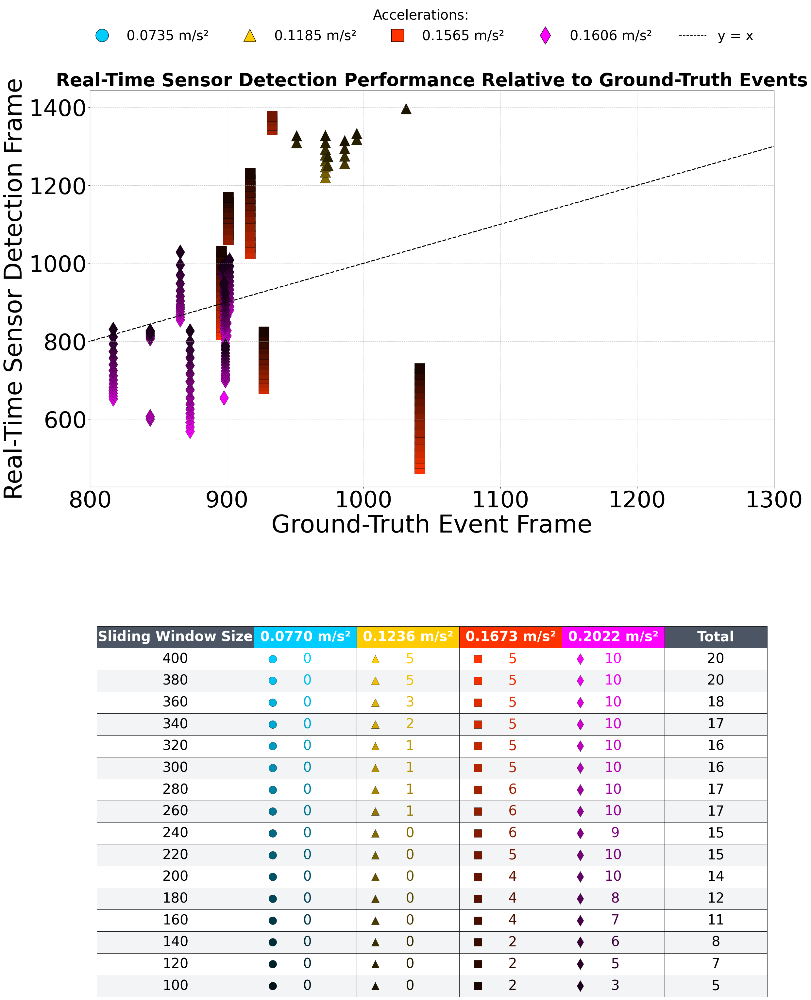

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.transforms import Bbox

# === READ DATA ===
file_path = "SlopedetectionMethod.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

# === CLEAN COLUMN NAMES ===
results_table.columns = results_table.columns.str.strip()

# === AUTO-DETECT SENSOR COLUMNS ===
sensor_cols = [col for col in results_table.columns if "_WindowSize" in col]
if not sensor_cols:
    raise ValueError("No sensor columns found. Check column names in CSV.")

# === FILTER VALID ACCELERATIONS ===
valid_accels = [200, 300, 400, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# === BASE COLORS (bright colors) ===
base_colors = np.array([
    [0.0, 0.8, 1.0],  # bright cyan
    [1.0, 0.8, 0.0],  # bright yellow-orange
    [1.0, 0.2, 0.0],  # bright red
    [1.0, 0.0, 1.0]   # bright magenta
])

shapes = ["o", "^", "s", "d"]

# Generate faded colors for sensors
fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade_colors.append(np.clip(base[None, :] * factors[:, None], 0, 1))

# === FIGURE ===
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)
plt.subplots_adjust(hspace=0.85, top=0.88)

# === SCATTER PLOT ===
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if np.sum(idx) == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=558,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )

# === UNITY LINE (y = x) ===
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
min_val = min(x_min, np.nanmin(y_vals))
max_val = max(x_max, np.nanmax(y_vals))
ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# === AXIS SETTINGS ===
ax_main.set_xlabel("Ground-Truth Event Frame", fontsize=54)
ax_main.set_ylabel("Real-Time Sensor Detection Frame", fontsize=54)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', which='major', labelsize=50)

# === LEGEND ===
accel_descriptions = {200: "0.0735 m/s²", 300: "0.1185 m/s²", 400: "0.1565 m/s²", 500: "0.1606 m/s²"}
legend_handles = [
    plt.Line2D([], [], color=base_colors[i], marker=shapes[i],
               linestyle="None", markersize=28, markeredgecolor="k")
    for i in range(len(accel_vals))
]
legend_labels = [accel_descriptions[a] for a in accel_vals]
legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
legend_labels.append("y = x")

fig.legend(
    legend_handles,
    legend_labels,
    loc="upper center",
    bbox_to_anchor=(0.5, 0.97),
    ncol=len(accel_vals) + 1,
    frameon=False,
    title="Accelerations:",
    fontsize=30,
    title_fontsize=30
)

# === TITLE ===
ax_main.set_title(
    "Real-Time Sensor Detection Performance Relative to Ground-Truth Events",
    fontsize=40, weight="bold", pad=10
)

# =========================
# ===== TABLE SECTION =====
# =========================
ax_table.axis("off")

# Sort sensors numerically
sorted_sensors = sorted(
    sensor_cols,
    key=lambda c: float(c.replace("x_", "").replace("_WindowSize", ""))
)
sensor_labels = [str(abs(int(col.replace("x_", "").replace("_WindowSize", ""))))
                 for col in sorted_sensors]

# Count data points
counts_by_accel = []
totals = []
for col in sorted_sensors:
    row_counts = []
    for a_val in accel_vals:
        idx = accels == a_val
        row_counts.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row_counts)
    totals.append(sum(row_counts))

# Column labels
accel_descriptions_table = {200: "0.0770 m/s²", 300: "0.1236 m/s²",
                            400: "0.1673 m/s²", 500: "0.2022 m/s²"}
col_labels = ["Sliding Window Size"] + [accel_descriptions_table[a] for a in accel_vals] + ["Total"]

# === TABLE TEXT ===
table_data = []
for r, label in enumerate(sensor_labels):
    row = [label]
    for a_idx in range(len(accel_vals)):
        row.append(f"{counts_by_accel[r][a_idx]:>2}")
    row.append(str(totals[r]))
    table_data.append(row)

tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(30)
tbl.scale(3.8, 4.0)

# --- MANUAL COLUMN WIDTHS ---
col_widths = [0.23] + [0.15]*len(accel_vals) + [0.15]
for (row, col), cell in tbl.get_celld().items():
    if col < len(col_widths):
        cell.set_width(col_widths[col])

# --- HEADER COLORS MATCHING SCATTER PLOT ---
def rgb_to_hex(rgb):
    rgb_int = (rgb * 255).astype(int)
    return f"#{rgb_int[0]:02x}{rgb_int[1]:02x}{rgb_int[2]:02x}"

header_colors = ["#4B5563"] + [rgb_to_hex(c) for c in base_colors] + ["#4B5563"]

# === STYLE TABLE CELLS ===
for (row, col), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if row == 0:
        cell.set_text_props(weight="bold", color="white")
        cell.set_facecolor(header_colors[col])
    else:
        cell.set_facecolor("#F3F4F6" if row % 2 == 0 else "white")
        if 1 <= col <= len(accel_vals):
            sensor_idx = row - 1
            accel_idx = col - 1
            if sensor_idx < fade_colors[accel_idx].shape[0]:
                rgb = (fade_colors[accel_idx][sensor_idx] * 255).astype(int)
                cell.get_text().set_color(f"#{rgb[0]:02x}{rgb[1]:02x}{rgb[2]:02x}")

# === DRAW MARKERS INSIDE TABLE CELLS ===
fig.canvas.draw()
for (row, col), cell in tbl.get_celld().items():
    if row == 0 or col == 0 or col > len(accel_vals):
        continue
    accel_idx = col - 1
    sensor_idx = row - 1
    if sensor_idx >= fade_colors[accel_idx].shape[0]:
        continue
    rgb = fade_colors[accel_idx][sensor_idx]
    bbox = cell.get_window_extent(fig.canvas.get_renderer())
    inv = ax_table.transAxes.inverted()
    bbox_axes = Bbox(inv.transform(bbox))
    x = bbox_axes.x0 + 0.18 * bbox_axes.width
    y = bbox_axes.y0 + 0.50 * bbox_axes.height
    ax_table.scatter(
        x, y,
        s=300,
        marker=shapes[accel_idx],
        color=rgb,
        edgecolor="k",
        linewidth=0.4,
        transform=ax_table.transAxes,
        zorder=10,
        clip_on=False
    )

# === SAVE FIGURE ===
plt.savefig("MarkerSensorScatter_Final_NoMapping.png", dpi=400, bbox_inches="tight")
plt.show()


/tmp/ipython-input-1428283940.py:31: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


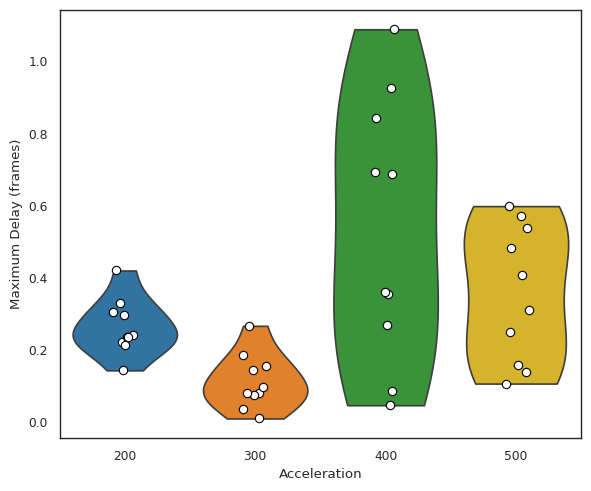

In [ ]:
# =========================
# Violin Plot from CSV
# =========================

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# -------------------------
# 1. Load data
# -------------------------
csv_file = "delay_all.csv"
df = pd.read_csv(csv_file)

# Ensure correct data types
df["Acceleration"] = df["Acceleration"].astype(str)

# Order accelerations explicitly
accel_order = ["200", "300", "400", "500"]

# -------------------------
# 2. Plot settings
# -------------------------
sns.set(style="white", context="paper")

plt.figure(figsize=(6, 5))

# -------------------------
# 3. Violin plot
# -------------------------
sns.violinplot(
    data=df,
    x="Acceleration",
    y="MaxDelays",              # <<< CHANGE METRIC HERE IF NEEDED
    order=accel_order,
    inner=None,
    cut=0,
    linewidth=1.2,
    palette=["#1f77b4", "#ff7f0e", "#2ca02c", "#f1c40f"]
)

# -------------------------
# 4. Overlay trial points
# -------------------------
sns.stripplot(
    data=df,
    x="Acceleration",
    y="MaxDelays",
    order=accel_order,
    jitter=True,
    size=6,
    color="white",
    edgecolor="black",
    linewidth=0.8
)

# -------------------------
# 5. Labels and formatting
# -------------------------
plt.xlabel("Acceleration")
plt.ylabel("Maximum Delay (frames)")
plt.tight_layout()

# -------------------------
# 6. Show figure
# -------------------------
plt.show()


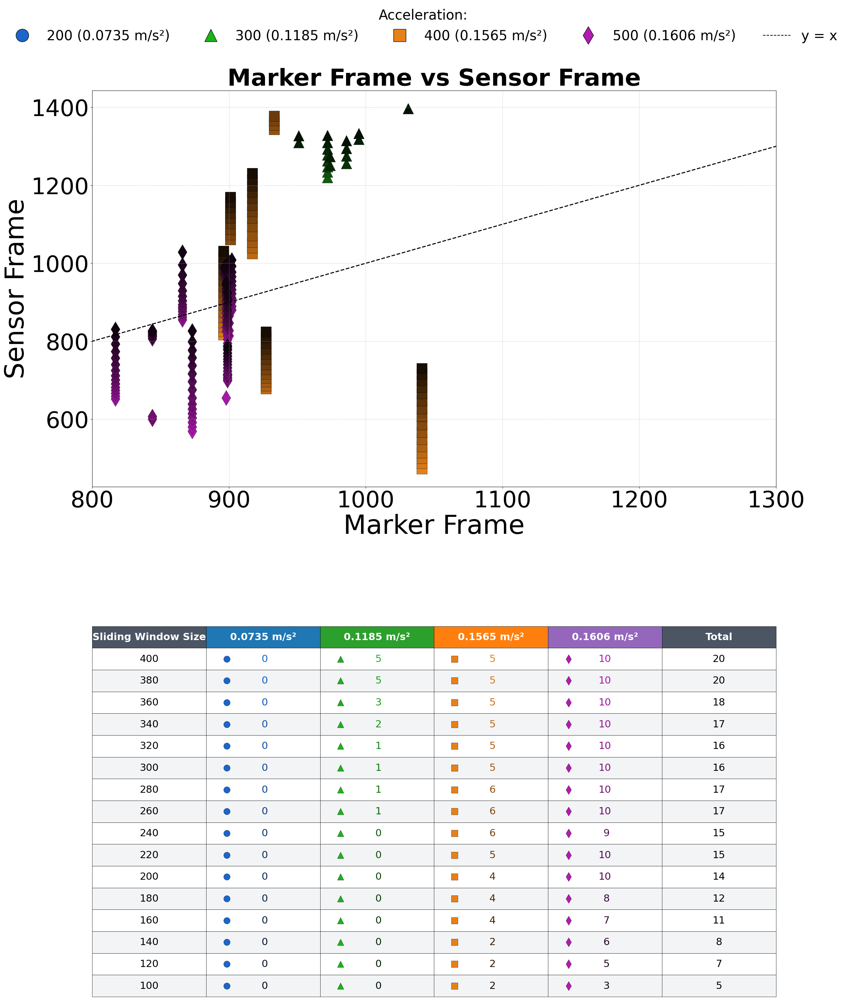

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.transforms import Bbox

# === READ DATA ===
file_path = "SlopedetectionMethod.csv"
results_table = pd.read_csv(file_path)

marker_col = "MsMax_Frame"
accel_col = "Accel"

# === CLEAN COLUMN NAMES ===
results_table.columns = results_table.columns.str.strip()

# === AUTO-DETECT SENSOR COLUMNS ===
sensor_cols = [col for col in results_table.columns if "_WindowSize" in col]
if not sensor_cols:
    raise ValueError("No sensor columns found. Check column names in CSV.")

# === FILTER VALID ACCELERATIONS ===
valid_accels = [200, 300, 400, 500]
results_table = results_table[results_table[accel_col].isin(valid_accels)]

M = results_table[marker_col].values
accels = results_table[accel_col].values
accel_vals = sorted(results_table[accel_col].unique())
nSensors = len(sensor_cols)

# === BASE COLORS (dark → light fading per sensor) ===
base_colors = np.array([
    [0.1, 0.4, 0.8],  # 200 = blue
    [0.1, 0.7, 0.1],  # 300 = green
    [0.9, 0.5, 0.1],  # 400 = orange
    [0.7, 0.1, 0.7]   # 500 = purple
])

shapes = ["o", "^", "s", "d"]

fade_colors = []
for base in base_colors:
    factors = np.linspace(1.0, 0.1, nSensors)
    fade_colors.append(np.clip(base[None, :] * factors[:, None], 0, 1))

# === FIGURE ===
fig, (ax_main, ax_table) = plt.subplots(
    2, 1, figsize=(27, 32),
    gridspec_kw={'height_ratios': [6.8, 2.9]}
)
plt.subplots_adjust(hspace=0.85, top=0.88)

# === SCATTER PLOT ===
for s, col in enumerate(sensor_cols):
    sensor_data = results_table[col].values
    for a_idx, a_val in enumerate(accel_vals):
        idx = accels == a_val
        if np.sum(idx) == 0:
            continue
        ax_main.scatter(
            M[idx], sensor_data[idx],
            s=558,
            c=[fade_colors[a_idx][s]],
            marker=shapes[a_idx],
            edgecolor="k",
            linewidth=0.4
        )

# === UNITY LINE (y = x) ===
x_min, x_max = np.nanmin(M), np.nanmax(M)
y_vals = results_table[sensor_cols].to_numpy().flatten()
y_vals = y_vals[~np.isnan(y_vals)]
min_val = min(x_min, np.nanmin(y_vals))
max_val = max(x_max, np.nanmax(y_vals))

ax_main.plot([min_val, max_val], [min_val, max_val], "k--", lw=2.2)

# === AXIS SETTINGS ===
ax_main.set_xlabel("Marker Frame", fontsize=58)
ax_main.set_ylabel("Sensor Frame", fontsize=58)
ax_main.set_xlim(800, 1300)
ax_main.grid(True, linestyle="--", alpha=0.6)
ax_main.tick_params(axis='both', which='major', labelsize=50)

# === LEGEND ===
accel_descriptions = {
    200: "200 (0.0735 m/s²)",
    300: "300 (0.1185 m/s²)",
    400: "400 (0.1565 m/s²)",
    500: "500 (0.1606 m/s²)"
}

legend_handles = [
    plt.Line2D([], [], color=base_colors[i], marker=shapes[i],
               linestyle="None", markersize=28, markeredgecolor="k")
    for i in range(len(accel_vals))
]
legend_labels = [accel_descriptions[a] for a in accel_vals]

legend_handles.append(plt.Line2D([], [], color="k", linestyle="--"))
legend_labels.append("y = x")

fig.legend(
    legend_handles,
    legend_labels,
    loc="upper center",
    bbox_to_anchor=(0.5, 0.97),
    ncol=len(accel_vals) + 1,
    frameon=False,
    title="Acceleration:",
    fontsize=30,
    title_fontsize=30
)

# === TITLE ===
ax_main.set_title("Marker Frame vs Sensor Frame",
                  fontsize=52, weight="bold", pad=10)

# =========================
# ===== TABLE SECTION =====
# =========================

ax_table.axis("off")

# Sort sensors numerically
sorted_sensors = sorted(
    sensor_cols,
    key=lambda c: float(c.replace("x_", "").replace("_WindowSize", ""))
)

sensor_labels = [
    str(abs(int(col.replace("x_", "").replace("_WindowSize", ""))))
    for col in sorted_sensors
]

# Count data points
counts_by_accel = []
totals = []

for col in sorted_sensors:
    row_counts = []
    for a_val in accel_vals:
        idx = accels == a_val
        row_counts.append(np.sum(~np.isnan(results_table[col].values[idx])))
    counts_by_accel.append(row_counts)
    totals.append(sum(row_counts))

# Column labels
accel_descriptions_table = {
    200: "0.0735 m/s²",
    300: "0.1185 m/s²",
    400: "0.1565 m/s²",
    500: "0.1606 m/s²"
}

col_labels = (
    ["Sliding Window Size"]
    + [accel_descriptions_table[a] for a in accel_vals]
    + ["Total"]
)

# === TABLE TEXT: NUMBERS ONLY ===
table_data = []
for r, label in enumerate(sensor_labels):
    row = [label]
    for a_idx in range(len(accel_vals)):
        row.append(f"{counts_by_accel[r][a_idx]:>2}")
    row.append(str(totals[r]))
    table_data.append(row)

tbl = ax_table.table(
    cellText=table_data,
    colLabels=col_labels,
    loc="center",
    cellLoc="center",
    colLoc="center"
)

tbl.auto_set_font_size(False)
tbl.set_fontsize(22)
tbl.scale(1, 4.0)

# === STYLE TABLE ===
for (row, col), cell in tbl.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.6)
    if row == 0:
        header_colors = ["#4B5563", "#1f77b4", "#2ca02c",
                         "#ff7f0e", "#9467bd", "#4B5563"]
        cell.set_text_props(weight="bold", color="white")
        cell.set_facecolor(header_colors[col])
    else:
        cell.set_facecolor("#F3F4F6" if row % 2 == 0 else "white")
        if 1 <= col <= len(accel_vals):
            sensor_idx = row - 1
            accel_idx = col - 1
            if sensor_idx < fade_colors[accel_idx].shape[0]:
                rgb = (fade_colors[accel_idx][sensor_idx] * 255).astype(int)
                cell.get_text().set_color(f"#{rgb[0]:02x}{rgb[1]:02x}{rgb[2]:02x}")

# === DRAW MARKERS INSIDE TABLE CELLS ===
fig.canvas.draw()  # REQUIRED

for (row, col), cell in tbl.get_celld().items():
    if row == 0 or col == 0 or col > len(accel_vals):
        continue

    accel_idx = col - 1
    bbox = cell.get_window_extent(fig.canvas.get_renderer())
    inv = ax_table.transAxes.inverted()
    bbox_axes = Bbox(inv.transform(bbox))

    x = bbox_axes.x0 + 0.18 * bbox_axes.width
    y = bbox_axes.y0 + 0.50 * bbox_axes.height

    ax_table.scatter(
    x, y,
    s=200,
    marker=shapes[accel_idx],
    color=base_colors[accel_idx],
    edgecolor="k",
    linewidth=0.4,
    transform=ax_table.transAxes,
    zorder=10,
    clip_on=False   # ← THIS FIXES IT
     )


    # ax_table.scatter(
    #     x, y,
    #     s=200,
    #     marker=shapes[accel_idx],
    #     color=base_colors[accel_idx],
    #     edgecolor="k",
    #     linewidth=0.4,
    #     transform=ax_table.transAxes,
    #     zorder=10
    # )

# === SAVE ===
plt.savefig(
    "MarkerSensorScatter_Final_NoMapping.png",
    dpi=400,
    bbox_inches="tight"
)
plt.show()


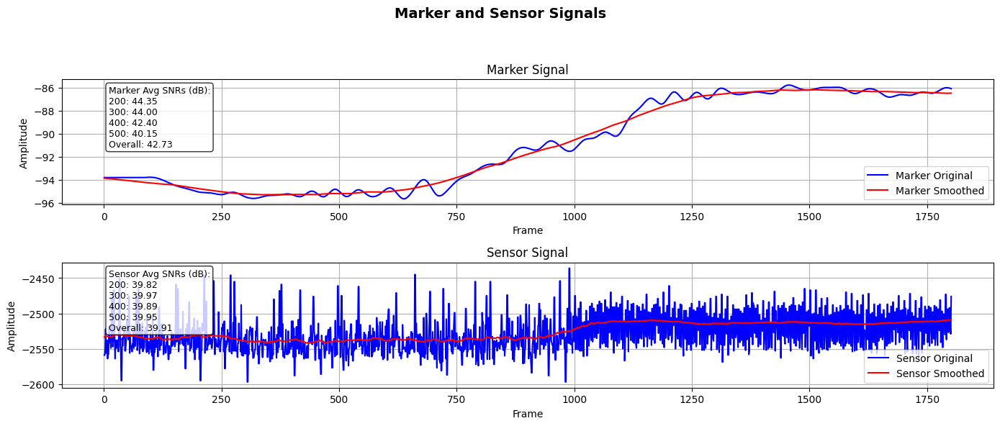

In [ ]:
# --- Plotting ---
fig, axs = plt.subplots(2, 1, figsize=(14, 6))  # 2 rows, 1 column
fig.suptitle('Marker and Sensor Signals', fontsize=14, fontweight='bold')

# Reindexed x-axis
marker_x = np.arange(1, len(marker_raw) + 1)
sensor_x = np.arange(1, len(sensor_raw) + 1)

# --- Marker Plot (Top) ---
axs[0].plot(marker_x, marker_raw, 'b', label='Marker Original')
axs[0].plot(marker_x, marker_smooth, 'r', label='Marker Smoothed')
axs[0].set_xlabel('Frame')
axs[0].set_ylabel('Amplitude')
axs[0].set_title('Marker Signal')
axs[0].legend(loc='best')
axs[0].grid(True)

# --- Sensor Plot (Bottom) ---
axs[1].plot(sensor_x, sensor_raw, 'b', label='Sensor Original')
axs[1].plot(sensor_x, sensor_smooth, 'r', label='Sensor Smoothed')
axs[1].set_xlabel('Frame')
axs[1].set_ylabel('Amplitude')
axs[1].set_title('Sensor Signal')
axs[1].legend(loc='best')
axs[1].grid(True)

# --- SNR Annotations ---
box_props = dict(boxstyle='round', facecolor='white', edgecolor='black', alpha=0.8)

axs[0].text(0.05, 0.95, snr_marker_text, transform=axs[0].transAxes,
            fontsize=9, verticalalignment='top', bbox=box_props)
axs[1].text(0.05, 0.95, snr_sensor_text, transform=axs[1].transAxes,
            fontsize=9, verticalalignment='top', bbox=box_props)

plt.tight_layout(rect=[0, 0, 1, 0.93])
plt.show()


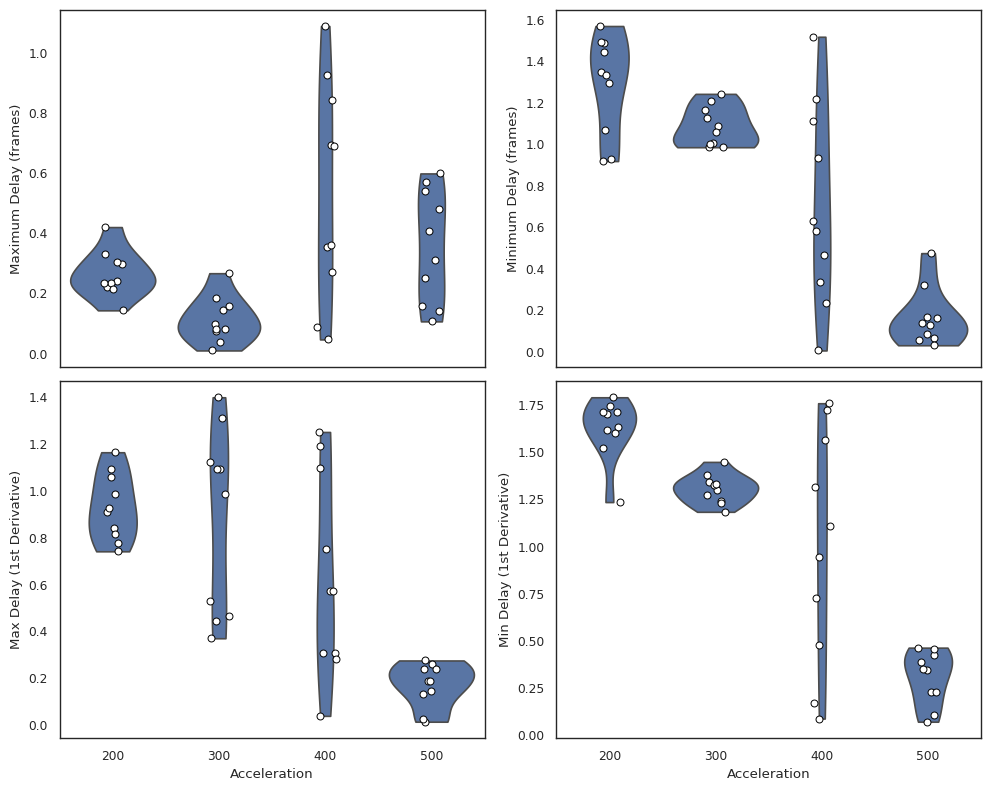

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("delay_all.csv")
# Rename the misspelled column
df = df.rename(columns={'Diff1_MaxDelalys': 'Diff1_MaxDelays', 'Diff1_MinDelalys': 'Diff1_MinDelays'})
df["Acceleration"] = df["Acceleration"].astype(str)

accel_order = [
    "200",
    "300",
    "400",
    "500"
]

metrics = [
    "MaxDelays",
    "MinDelays",
    "Diff1_MaxDelays",
    "Diff1_MinDelays"
]

ylabels = [
    "Maximum Delay (frames)",
    "Minimum Delay (frames)",
    "Max Delay (1st Derivative)",
    "Min Delay (1st Derivative)"
]

# -------------------------
# Figure setup
# -------------------------
sns.set(style="white", context="paper")

fig, axes = plt.subplots(
    nrows=2,
    ncols=2,
    figsize=(10, 8),
    sharex=True
)

axes = axes.flatten()

# -------------------------
# Plot each metric
# -------------------------
for ax, metric, ylabel in zip(axes, metrics, ylabels):

    sns.violinplot(
        data=df,
        x="Acceleration",
        y=metric,
        order=accel_order,
        inner=None,
        cut=0,
        linewidth=1.2,
        ax=ax
    )

    sns.stripplot(
        data=df,
        x="Acceleration",
        y=metric,
        order=accel_order,
        jitter=True,
        size=5,
        color="white",
        edgecolor="black",
        linewidth=0.7,
        ax=ax
    )

    ax.set_ylabel(ylabel)
    ax.set_xlabel("")

# -------------------------
# Final formatting
# -------------------------
for ax in axes:
    ax.tick_params(axis="x", rotation=0)

axes[2].set_xlabel("Acceleration")
axes[3].set_xlabel("Acceleration")

plt.tight_layout()
plt.show()

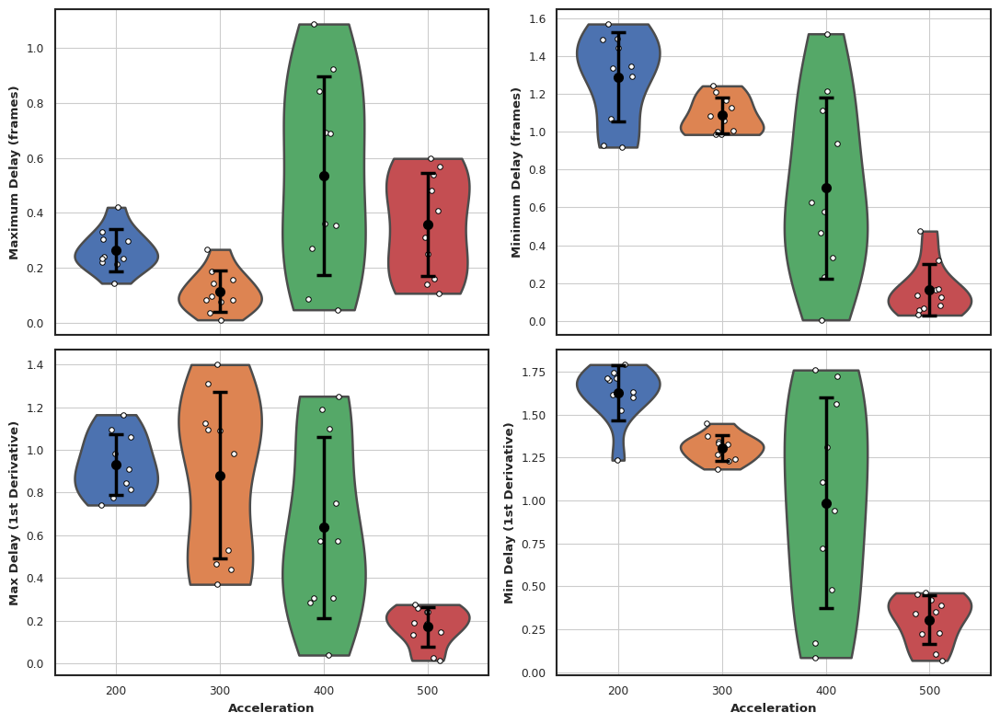

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("delay_all.csv")
# Rename the misspelled columns
df = df.rename(columns={'Diff1_MaxDelalys': 'Diff1_MaxDelays', 'Diff1_MinDelalys': 'Diff1_MinDelays'})
df["Acceleration"] = df["Acceleration"].astype(str)

accel_order = ["200", "300", "400", "500"]

metrics = [
    "MaxDelays",
    "MinDelays",
    "Diff1_MaxDelays",
    "Diff1_MinDelays"
]

yabels = [
    "Maximum Delay (frames)",
    "Minimum Delay (frames)",
    "Max Delay (1st Derivative)",
    "Min Delay (1st Derivative)"
]

# -------------------------
# Styling
# -------------------------
sns.set_theme(
    style="white",
    context="paper",
    rc={
        "axes.linewidth": 1.5,
        "font.size": 11,
        "axes.labelweight": "bold",
        "axes.titleweight": "bold"
    }
)

palette = ["#4C72B0", "#DD8452", "#55A868", "#C44E52"]

# -------------------------
# Figure
# -------------------------
fig, axes = plt.subplots(2, 2, figsize=(11, 8), sharex=True)
axes = axes.flatten()

# -------------------------
# Plot loop
# -------------------------
for ax, metric, ylabel in zip(axes, metrics, yabels):

    # Violin
    sns.violinplot(
        data=df,
        x="Acceleration",
        y=metric,
        hue="Acceleration", # Added hue for palette
        order=accel_order,
        palette=palette,
        inner=None,
        cut=0,
        linewidth=1.8,
        saturation=1,
        ax=ax,
        legend=False # Hide legend as it's redundant with hue
    )

    # Raw data (subtle)
    sns.stripplot(
        data=df,
        x="Acceleration",
        y=metric,
        order=accel_order,
        color="white",
        edgecolor="black",
        size=4,
        jitter=0.15,
        linewidth=0.7,
        ax=ax,
        zorder=2
    )

    # Mean ± SD (bold)
    for i, acc in enumerate(accel_order):
        values = df[df["Acceleration"] == acc][metric]
        mean = values.mean()
        std = values.std()

        ax.errorbar(
            i,
            mean,
            yerr=std,
            fmt="o",
            color="black",
            markersize=7,
            elinewidth=2.5,
            capsize=6,
            capthick=2.5,
            zorder=3
        )

    ax.set_ylabel(ylabel, fontweight="bold")
    ax.set_xlabel("")
    ax.grid(True)

# -------------------------
# Axis labels
# -------------------------
axes[2].set_xlabel("Acceleration", fontweight="bold")
axes[3].set_xlabel("Acceleration", fontweight="bold")

# -------------------------
# Final touches
# -------------------------
for ax in axes:
    ax.tick_params(width=1.5)
    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_linewidth(1.5)

plt.tight_layout()
plt.show()

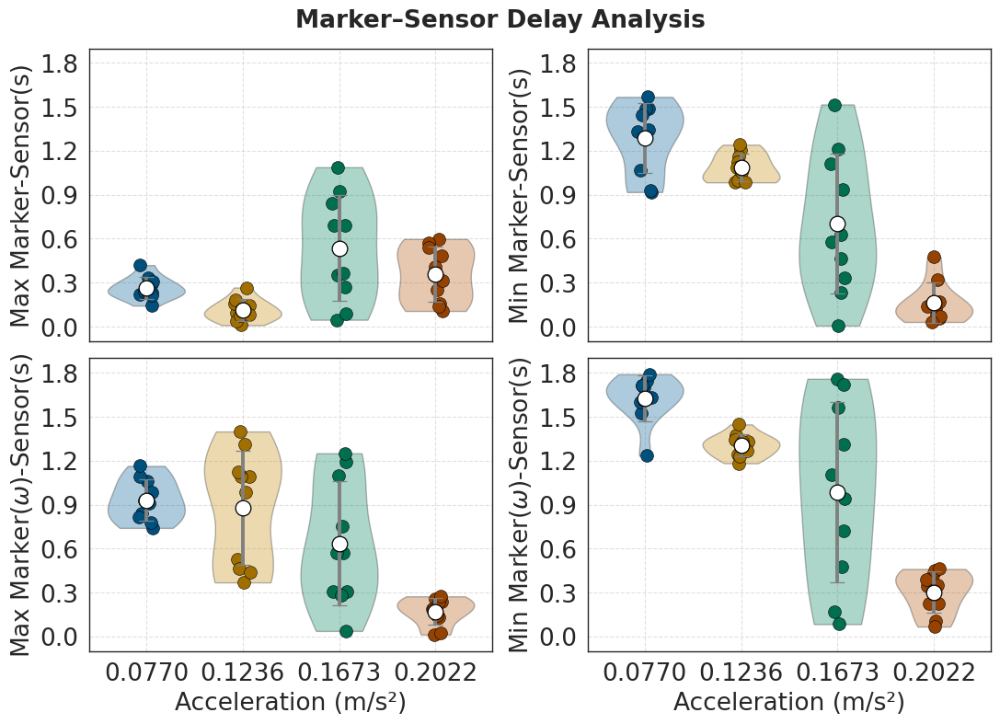

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import to_rgb, to_hex


# -------------------------
# Load data
# -------------------------
df = pd.read_csv("delay_all.csv")

# Rename misspelled columns
df = df.rename(columns={
    'Diff1_MaxDelalys': 'Diff1_MaxDelays',
    'Diff1_MinDelalys': 'Diff1_MinDelays'
})

df["Acceleration"] = df["Acceleration"].astype(str)

accel_order = ["200", "300", "400", "500"]

metrics = [
    "MaxDelays",
    "MinDelays",
    "Diff1_MaxDelays",
    "Diff1_MinDelays"
]

yabels = [
    "Max Marker-Sensor(s)",
    "Min Marker-Sensor(s)",
    "Max Marker($\\omega$)-Sensor(s)",
    "Min Marker($\\omega$)-Sensor(s)"
]

# --------------------------
# Helper function to darken color
# --------------------------
def darken_color(color, factor=0.7):
    rgb = to_rgb(color)
    darker_rgb = tuple(c * factor for c in rgb)
    return to_hex(darker_rgb)

# -------------------------
# Styling
# -------------------------
sns.set_theme(
    style="white",
    context="paper",
    rc={
        "axes.linewidth": 1.5,
        "font.size": 11,
        "axes.labelweight": "normal"
    }
)

accel_label_map = {
    "200": "0.0770",
    "300": "0.1236",
    "400": "0.1673",
    "500": "0.2022"
}

# -------------------------
# COLOR CONTROL (EDIT HERE)
# -------------------------
base_colors = {
    "200": "#0072B2",  # vivid blue
    "300": "#E69F00",  # golden orange
    "400": "#009E73",  # emerald green
    "500": "#D55E00"   # strong vermillion
}

violin_alpha = 0.35
scatter_size = 75
scatter_linewidth = 0.2

# -------------------------
# Figure
# -------------------------
fig, axes = plt.subplots(2, 2, figsize=(11, 8), sharex=True)
axes = axes.flatten()

# -------------------------
# Global y-axis limits
# -------------------------
# y_min = df[metrics].min().min()
# y_max = df[metrics].max().max()

# -------------------------
# Plot loop
# -------------------------
for ax, metric, ylabel in zip(axes, metrics, yabels):

    # --- Violins (light background)
    sns.violinplot(
        data=df,
        x="Acceleration",
        y=metric,
        hue="Acceleration", # Added hue for palette
        order=accel_order,
        palette=[base_colors[a] for a in accel_order],
        inner=None,
        cut=0,
        linewidth=1.0,
        ax=ax,
        legend=False # Hide legend as it's redundant with hue
     )

    ax.set_ylabel(ylabel, fontsize=19, fontweight="normal")
    ax.tick_params(axis="both", labelsize=19)
    # ax.set_ylim(0.00, 1.80)
    # ax.set_ylim(y_min, y_max)

    # Make violins transparent
    for coll in ax.collections:
        coll.set_alpha(violin_alpha)

    # --- Scatter points (same color, bold)
    for i, acc in enumerate(accel_order):
        values = df[df["Acceleration"] == acc][metric]

        ax.scatter(
            np.full(len(values), i) + np.random.uniform(-0.08, 0.08, len(values)),
            values,
            s=100,  # bigger
            facecolor=darken_color(base_colors[acc], 0.7),  # darker
            edgecolor="black",
            linewidth=0.4,  # thicker edge
            zorder=3
        )

        # --- Mean ± SD (white mean, gray SD)
        mean = values.mean()
        std = values.std()

        ax.errorbar(
            i,
            mean,
            yerr=std,
            fmt="o",
            markerfacecolor="white",
            markeredgecolor="black",
            markeredgewidth=0.9,
            markersize=12,
            ecolor="gray",
            elinewidth=2.8,
            capsize=6,
            capthick=2.2,
            zorder=4
        )

    ax.set_ylabel(ylabel, fontweight="normal")
    ax.set_xlabel("")
    ax.grid(True,  linestyle="--", linewidth=0.8, alpha=0.6)
    ax.set_xticks(range(len(accel_order)))
    ax.set_xticklabels(
    [accel_label_map[a] for a in accel_order],
    fontweight="normal"
    )
   # --- SET FIXED Y-AXIS LIMIT HERE ---
    ax.set_ylim(-0.1, 1.90)
    ax.set_yticks(np.linspace(0, 1.8, 7))  # optional

# -------------------------
# Axis labels
# -------------------------
axes[2].set_xlabel("Acceleration (m/s²)", fontsize=19, fontweight="normal")
axes[3].set_xlabel("Acceleration (m/s²)", fontsize=19, fontweight="normal")





# -------------------------
# Final touches
# -------------------------
for ax in axes:
    ax.tick_params(width=1.0)
    for spine in ax.spines.values():
        spine.set_linewidth(1.0)
fig.suptitle("Marker–Sensor Delay Analysis", fontsize=19, fontweight="bold", y=0.98)
plt.tight_layout()
plt.show()

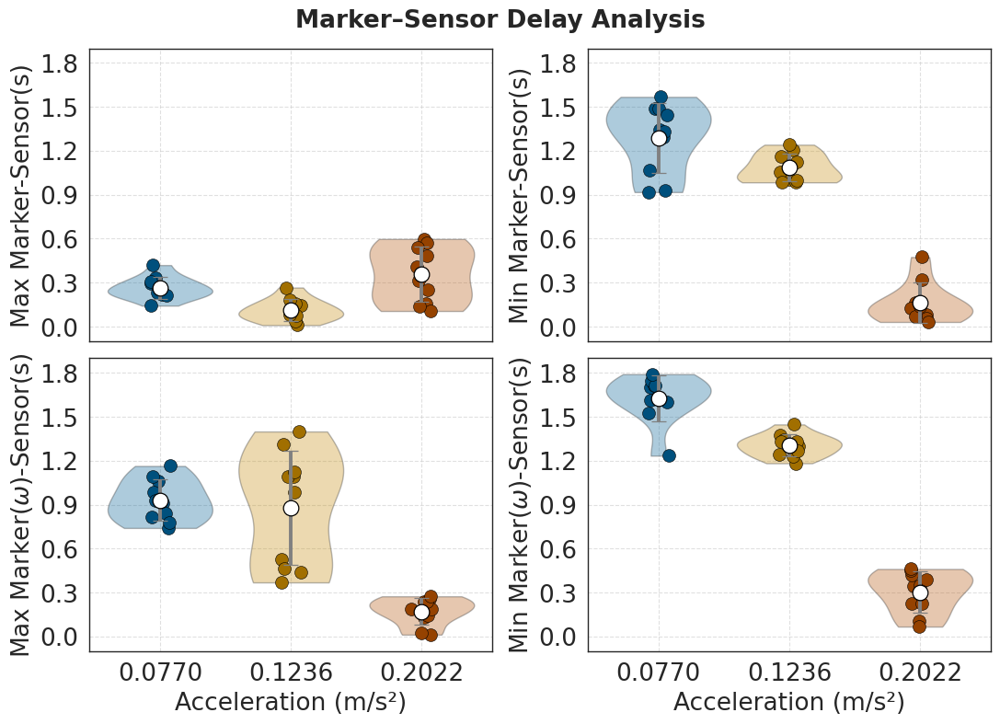

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import to_rgb, to_hex

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("delay_all.csv")

# Rename misspelled columns
df = df.rename(columns={
    'Diff1_MaxDelalys': 'Diff1_MaxDelays',
    'Diff1_MinDelalys': 'Diff1_MinDelays'
})

# EXCLUDE Acceleration = 400
df = df[df["Acceleration"] != 400]

df["Acceleration"] = df["Acceleration"].astype(str)

# -------------------------
# Configuration
# -------------------------
accel_order = ["200", "300", "500"]

metrics = [
    "MaxDelays",
    "MinDelays",
    "Diff1_MaxDelays",
    "Diff1_MinDelays"
]

yabels = [
    "Max Marker-Sensor(s)",
    "Min Marker-Sensor(s)",
    "Max Marker($\\omega$)-Sensor(s)",
    "Min Marker($\\omega$)-Sensor(s)"
]

accel_label_map = {
    "200": "0.0770",
    "300": "0.1236",
    "500": "0.2022"
}

# -------------------------
# Helper function
# -------------------------
def darken_color(color, factor=0.7):
    rgb = to_rgb(color)
    darker_rgb = tuple(c * factor for c in rgb)
    return to_hex(darker_rgb)

# -------------------------
# Styling
# -------------------------
sns.set_theme(
    style="white",
    context="paper",
    rc={
        "axes.linewidth": 1.5,
        "font.size": 11,
        "axes.labelweight": "normal"
    }
)

# -------------------------
# Colors
# -------------------------
base_colors = {
    "200": "#0072B2",  # vivid blue
    "300": "#E69F00",  # golden orange
    "500": "#D55E00"   # strong vermillion
}

violin_alpha = 0.35

# -------------------------
# Figure
# -------------------------
fig, axes = plt.subplots(2, 2, figsize=(11, 8), sharex=True)
axes = axes.flatten()

# -------------------------
# Plot loop
# -------------------------
for ax, metric, ylabel in zip(axes, metrics, yabels):

    # --- Violin plot
    sns.violinplot(
        data=df,
        x="Acceleration",
        y=metric,
        hue="Acceleration",
        order=accel_order,
        palette=[base_colors[a] for a in accel_order],
        inner=None,
        cut=0,
        linewidth=1.0,
        ax=ax,
        legend=False
    )

    # Make violins transparent
    for coll in ax.collections:
        coll.set_alpha(violin_alpha)

    # --- Scatter points + mean ± SD
    for i, acc in enumerate(accel_order):
        values = df[df["Acceleration"] == acc][metric]

        ax.scatter(
            np.full(len(values), i) + np.random.uniform(-0.08, 0.08, len(values)),
            values,
            s=100,
            facecolor=darken_color(base_colors[acc], 0.7),
            edgecolor="black",
            linewidth=0.4,
            zorder=3
        )

        mean = values.mean()
        std = values.std()

        ax.errorbar(
            i,
            mean,
            yerr=std,
            fmt="o",
            markerfacecolor="white",
            markeredgecolor="black",
            markeredgewidth=0.9,
            markersize=12,
            ecolor="gray",
            elinewidth=2.8,
            capsize=6,
            capthick=2.2,
            zorder=4
        )

    # -------------------------
    # Axis formatting
    # -------------------------
    ax.set_ylabel(ylabel, fontsize=19, fontweight="normal")
    ax.set_xlabel("")
    ax.set_ylim(-0.1, 1.90)
    ax.set_yticks(np.linspace(0, 1.8, 7))
    ax.tick_params(axis="both", labelsize=19)
    ax.grid(True, linestyle="--", linewidth=0.8, alpha=0.6)

    ax.set_xticks(range(len(accel_order)))
    ax.set_xticklabels(
        [accel_label_map[a] for a in accel_order],
        fontweight="normal"
    )

# -------------------------
# X-axis labels
# -------------------------
axes[2].set_xlabel("Acceleration (m/s²)", fontsize=19, fontweight="normal")
axes[3].set_xlabel("Acceleration (m/s²)", fontsize=19, fontweight="normal")

# -------------------------
# Final touches
# -------------------------
for ax in axes:
    ax.tick_params(width=1.0)
    for spine in ax.spines.values():
        spine.set_linewidth(1.0)

fig.suptitle("Marker–Sensor Delay Analysis", fontsize=19, fontweight="bold", y=0.98)
plt.tight_layout()
plt.show()


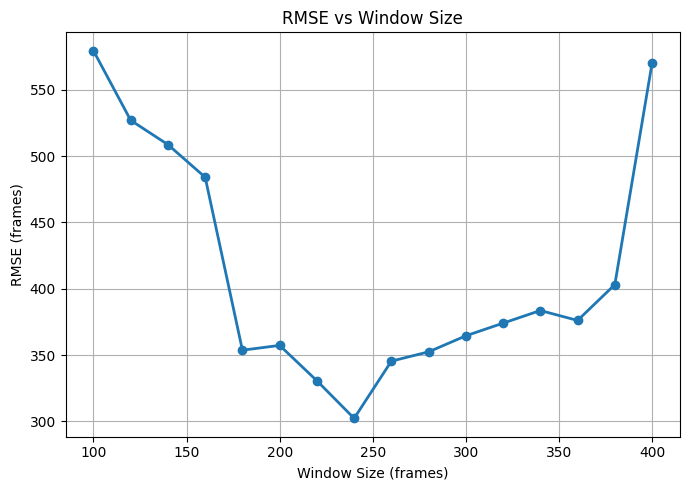

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# -------------------------
# Load data
# -------------------------
# Upload your CSV in Colab and update the filename
df = pd.read_csv("slope_detection_summary112.csv")

# -------------------------
# Compute frame error
# -------------------------
df["Frame_Error"] = df["Sensor_DetectedFrame"] - df["Marker_DetectedFrame"]

# -------------------------
# Compute RMSE per WindowSize
# -------------------------
rmse_df = (
    df.groupby("WindowSize")["Frame_Error"]
      .apply(lambda x: np.sqrt(np.mean(x**2)))
      .reset_index(name="RMSE")
)

# Sort by WindowSize for plotting
rmse_df = rmse_df.sort_values("WindowSize")

# -------------------------
# Plot RMSE vs WindowSize
# -------------------------
plt.figure(figsize=(7, 5))
plt.plot(
    rmse_df["WindowSize"],
    rmse_df["RMSE"],
    marker="o",
    linewidth=2
)

plt.xlabel("Window Size (frames)")
plt.ylabel("RMSE (frames)")
plt.title("RMSE vs Window Size")
plt.grid(True)

plt.tight_layout()
plt.show()


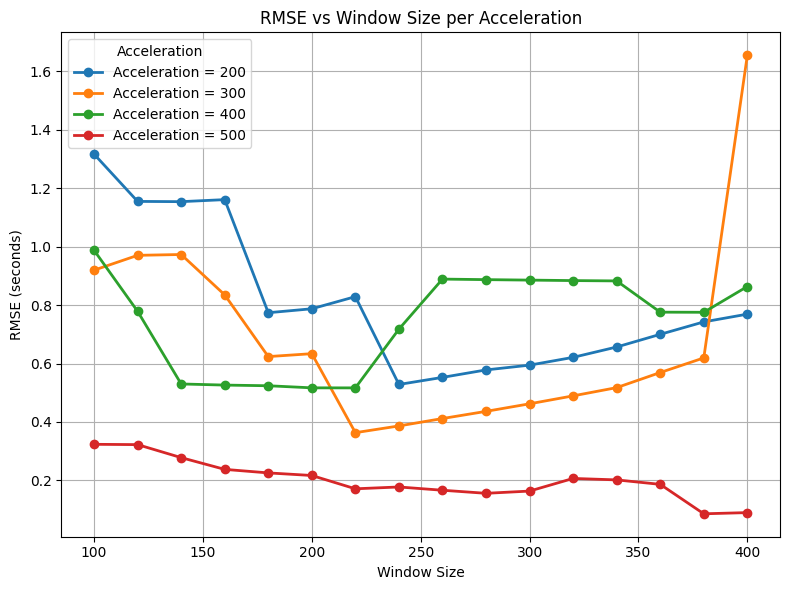

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# -------------------------
# User-defined parameters
# -------------------------
fs = 600  # sampling rate in Hz (change if needed)

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112.csv")

# -------------------------
# Compute frame error
# -------------------------
df["Frame_Error"] = df["Sensor_DetectedFrame"] - df["Marker_DetectedFrame"]

# -------------------------
# Compute RMSE per WindowSize per Acceleration
# -------------------------
rmse_df = (
    df.groupby(["Acceleration", "WindowSize"])["Frame_Error"]
      .apply(lambda x: np.sqrt(np.mean(x**2)))
      .reset_index(name="RMSE_frames")
)

# -------------------------
# Convert RMSE from frames to seconds
# -------------------------
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# Sort for clean plotting
rmse_df = rmse_df.sort_values(["Acceleration", "WindowSize"])

# -------------------------
# Plot RMSE vs WindowSize (separate curve per acceleration)
# -------------------------
plt.figure(figsize=(8, 6))

for acc in rmse_df["Acceleration"].unique():
    subset = rmse_df[rmse_df["Acceleration"] == acc]
    plt.plot(
        subset["WindowSize"],
        subset["RMSE_seconds"],
        marker="o",
        linewidth=2,
        label=f"Acceleration = {acc}"
    )

plt.xlabel("Window Size")
plt.ylabel("RMSE (seconds)")
plt.title("RMSE vs Window Size per Acceleration")
plt.grid(True)
plt.legend(title="Acceleration")

plt.tight_layout()
plt.show()


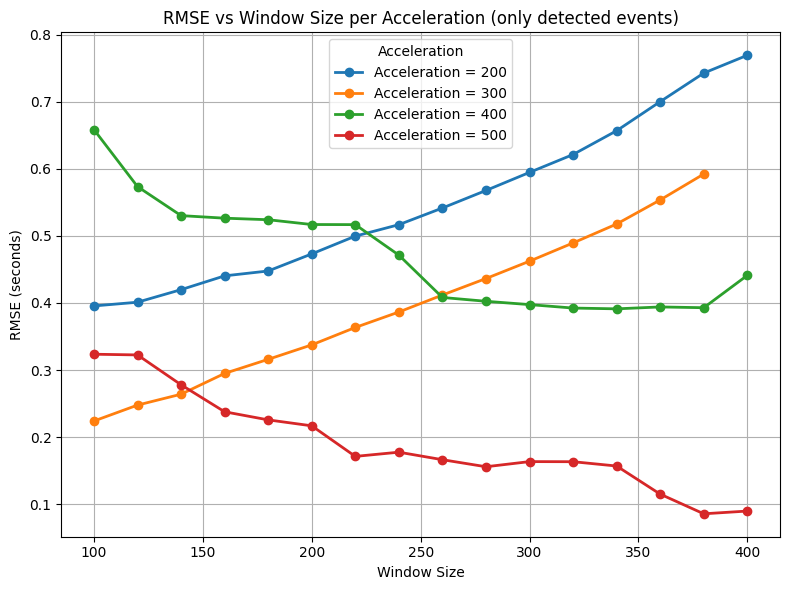

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# -------------------------
# User-defined parameters
# -------------------------
fs = 600  # sampling rate in Hz (change if needed)

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112.csv")

# -------------------------
# Keep only rows where both sensor and marker detected an event
# -------------------------
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()

# -------------------------
# Compute frame error only for valid detections
# -------------------------
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# -------------------------
# Compute RMSE per WindowSize per Acceleration
# -------------------------
rmse_df = (
    df_valid.groupby(["Acceleration", "WindowSize"])["Frame_Error"]
            .apply(lambda x: np.sqrt(np.mean(x**2)))
            .reset_index(name="RMSE_frames")
)

# -------------------------
# Convert RMSE from frames to seconds
# -------------------------
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# -------------------------
# Sort for clean plotting
# -------------------------
rmse_df = rmse_df.sort_values(["Acceleration", "WindowSize"])

# -------------------------
# Plot RMSE vs WindowSize (separate curve per acceleration)
# -------------------------
plt.figure(figsize=(8, 6))

for acc in rmse_df["Acceleration"].unique():
    subset = rmse_df[rmse_df["Acceleration"] == acc]
    plt.plot(
        subset["WindowSize"],
        subset["RMSE_seconds"],
        marker="o",
        linewidth=2,
        label=f"Acceleration = {acc}"
    )

plt.xlabel("Window Size")
plt.ylabel("RMSE (seconds)")
plt.title("RMSE vs Window Size per Acceleration (only detected events)")
plt.grid(True)
plt.legend(title="Acceleration")

plt.tight_layout()
plt.show()


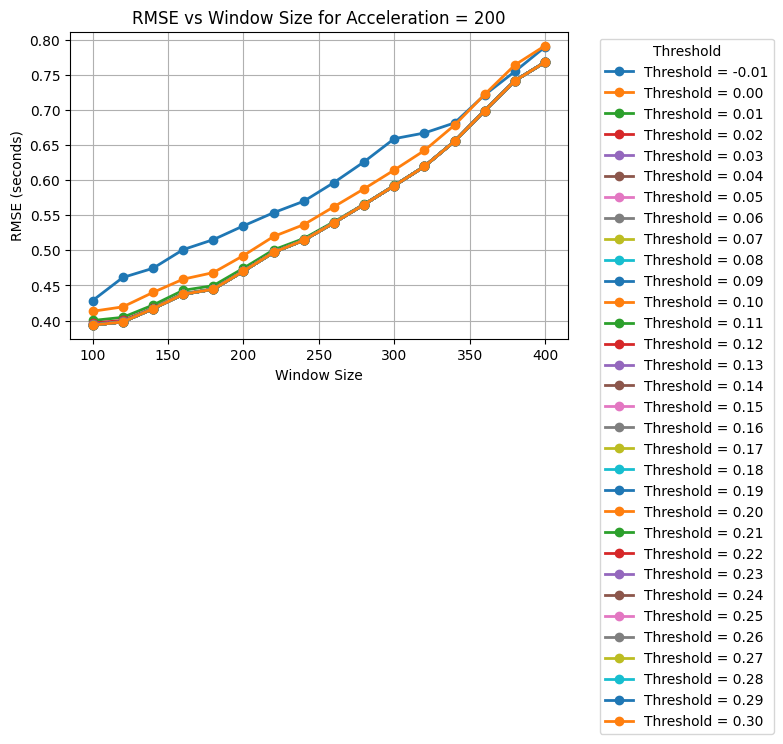

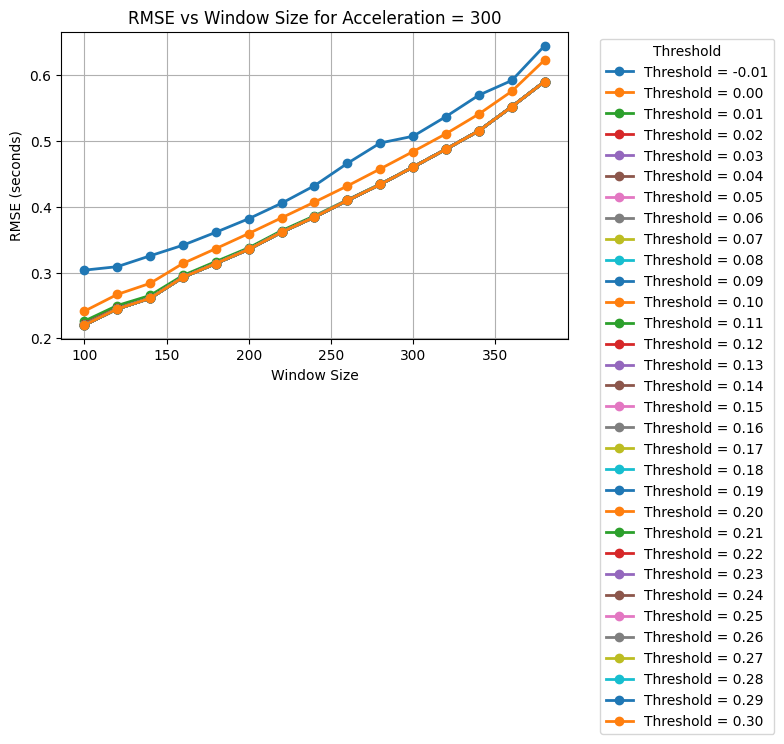

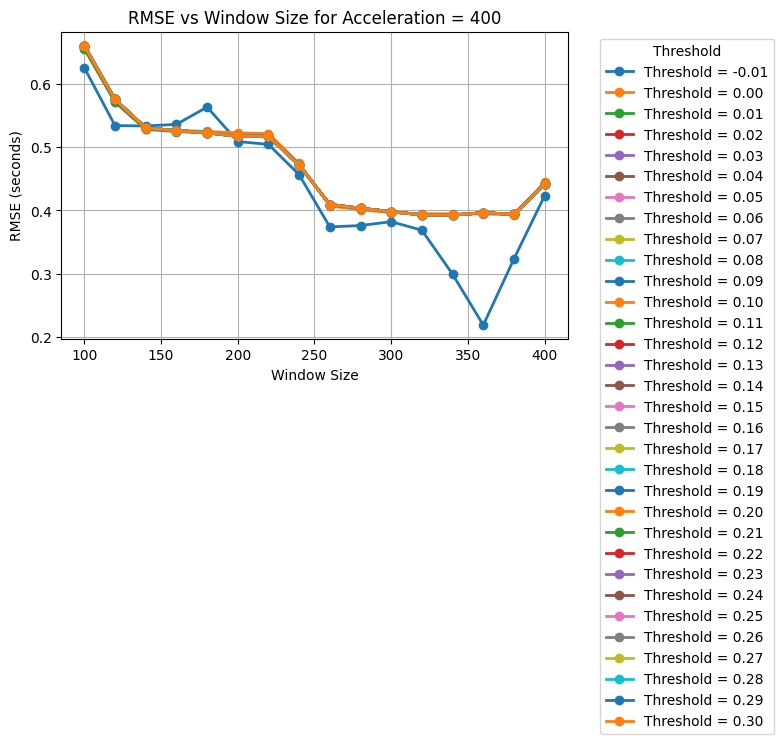

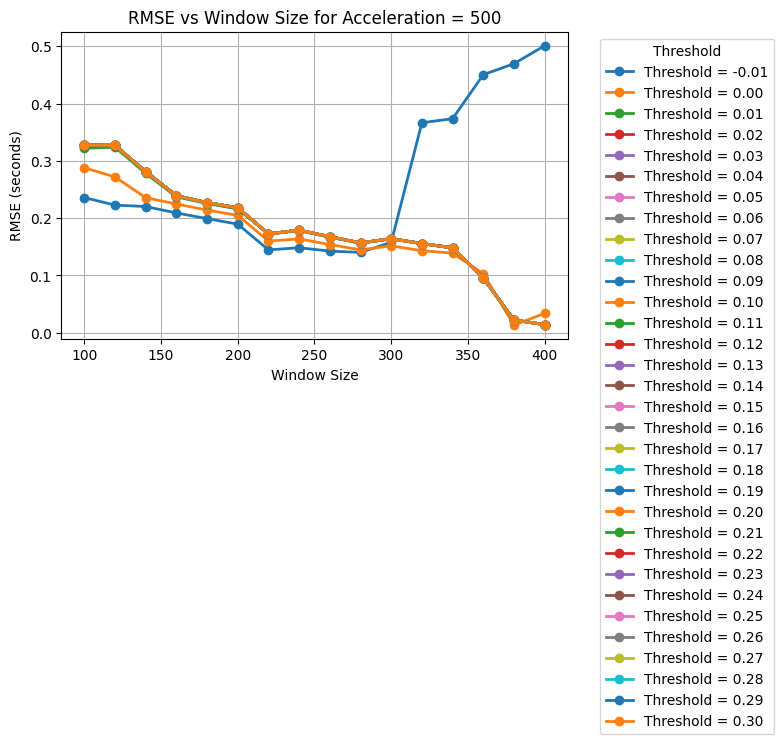

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# -------------------------
# User-defined parameters
# -------------------------
fs = 600  # sampling rate in Hz (change if needed)

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112.csv")

# -------------------------
# Keep only rows where both sensor and marker detected an event
# -------------------------
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()

# -------------------------
# Compute frame error
# -------------------------
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# -------------------------
# Compute RMSE per Threshold & WindowSize per Acceleration
# -------------------------
rmse_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
            .apply(lambda x: np.sqrt(np.mean(x**2)))
            .reset_index(name="RMSE_frames")
)

# -------------------------
# Convert RMSE from frames to seconds
# -------------------------
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# -------------------------
# Sort for clean plotting
# -------------------------
rmse_df = rmse_df.sort_values(["Acceleration", "Threshold", "WindowSize"])

# -------------------------
# Plot RMSE vs WindowSize (one line per Threshold) for each Acceleration
# -------------------------
accelerations = rmse_df["Acceleration"].unique()
for acc in accelerations:
    plt.figure(figsize=(8, 6))
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    for th in sorted(subset_acc["Threshold"].unique()):
        subset_th = subset_acc[subset_acc["Threshold"] == th]
        plt.plot(
            subset_th["WindowSize"],
            subset_th["RMSE_seconds"],
            marker="o",
            linewidth=2,
            label=f"Threshold = {th:.2f}"
        )

    plt.xlabel("Window Size")
    plt.ylabel("RMSE (seconds)")
    plt.title(f"RMSE vs Window Size for Acceleration = {acc}")
    plt.grid(True)
    plt.legend(title="Threshold", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


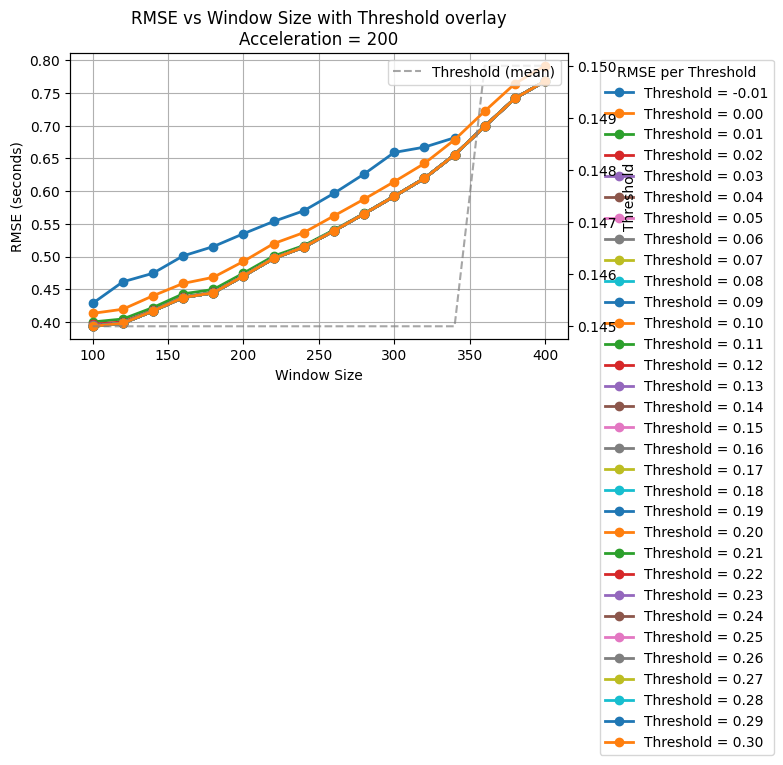

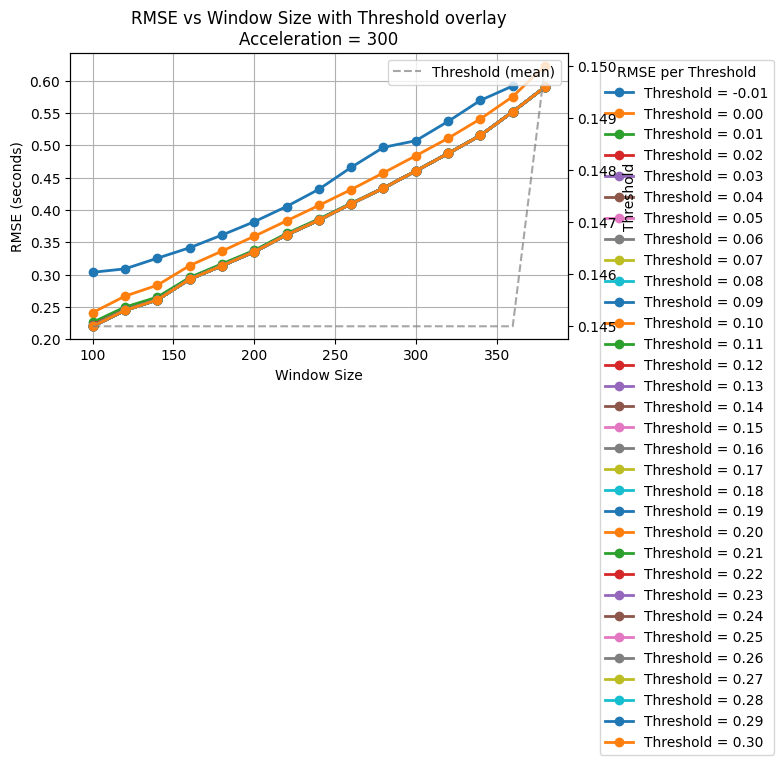

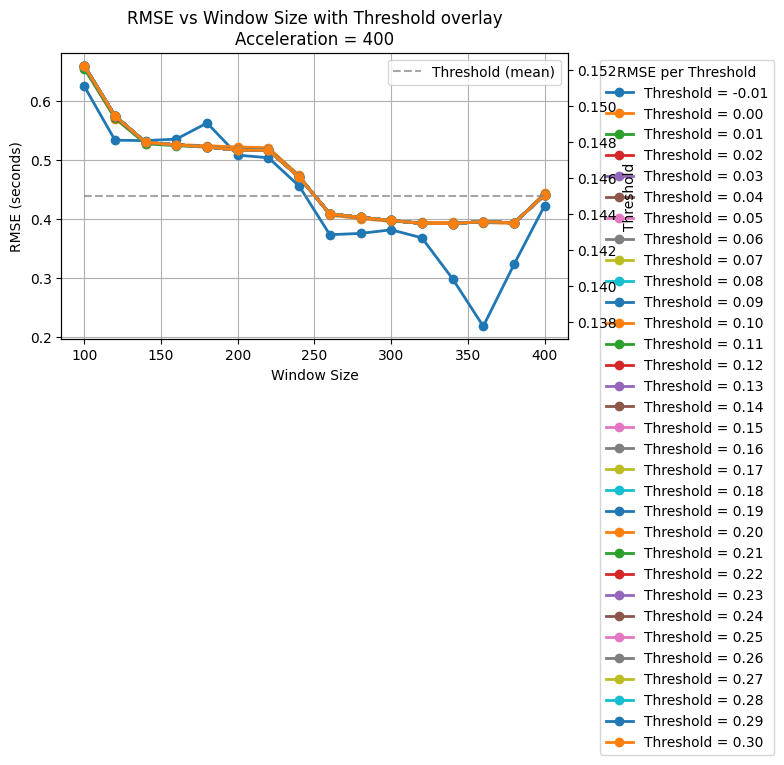

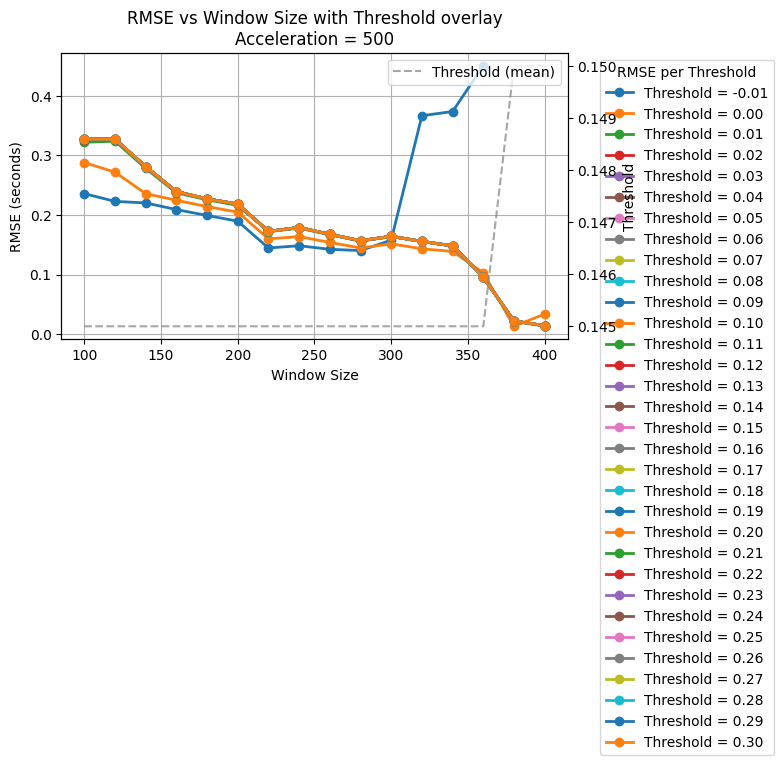

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

fs = 600  # sampling rate in Hz

df = pd.read_csv("slope_detection_summary112NEW.csv")

# Valid detections
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# RMSE per Threshold & WindowSize per Acceleration
rmse_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
            .apply(lambda x: np.sqrt(np.mean(x**2)))
            .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs
rmse_df = rmse_df.sort_values(["Acceleration", "Threshold", "WindowSize"])

# Plot
accelerations = rmse_df["Acceleration"].unique()
for acc in accelerations:
    plt.figure(figsize=(8, 6))
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    # Primary axis: RMSE vs WindowSize
    ax1 = plt.gca()
    for th in sorted(subset_acc["Threshold"].unique()):
        subset_th = subset_acc[subset_acc["Threshold"] == th]
        ax1.plot(
            subset_th["WindowSize"],
            subset_th["RMSE_seconds"],
            marker="o",
            linewidth=2,
            label=f"Threshold = {th:.2f}"
        )
    ax1.set_xlabel("Window Size")
    ax1.set_ylabel("RMSE (seconds)")
    ax1.grid(True)

    # Secondary axis: Threshold values (right y-axis)
    ax2 = ax1.twinx()
    threshold_means = subset_acc.groupby("WindowSize")["Threshold"].mean()
    ax2.plot(
        threshold_means.index,
        threshold_means.values,
        linestyle='--',
        color='gray',
        alpha=0.7,
        label="Threshold (mean)"
    )
    ax2.set_ylabel("Threshold")

    # Legends
    ax1.legend(title="RMSE per Threshold", bbox_to_anchor=(1.05, 1), loc='upper left')
    ax2.legend(loc='upper right')

    plt.title(f"RMSE vs Window Size with Threshold overlay\nAcceleration = {acc}")
    plt.tight_layout()
    plt.show()


In [ ]:
import pandas as pd
import numpy as np
from tabulate import tabulate  # pip install tabulate

fs = 600  # sampling rate in Hz

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112NEW.csv")

# Keep only valid detections
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# RMSE per Threshold & WindowSize per Acceleration
rmse_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
            .apply(lambda x: np.sqrt(np.mean(x**2)))
            .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# -------------------------
# Pretty table per acceleration
# -------------------------
accelerations = sorted(rmse_df["Acceleration"].unique())

for acc in accelerations:
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    # Pivot table: rows = WindowSize, columns = Threshold, values = RMSE
    table = subset_acc.pivot(index="WindowSize", columns="Threshold", values="RMSE_seconds")

    # Sort rows and columns
    table = table.sort_index().sort_index(axis=1)

    # Round values for clarity
    table_rounded = table.round(4)

    # Print nicely using tabulate
    print(f"\n=== RMSE Table for Acceleration = {acc} ===")
    print(tabulate(table_rounded, headers='keys', tablefmt='grid', showindex=True))

    # Optional: save to CSV
    table_rounded.to_csv(f"rmse_table_acc_{acc}.csv")



=== RMSE Table for Acceleration = 200 ===
+--------------+----------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+
|   WindowSize |    -0.01 |    0.0 |   0.01 |   0.02 |   0.03 |   0.04 |   0.05 |   0.06 |   0.07 |   0.08 |   0.09 |    0.1 |   0.11 |   0.12 |   0.13 |   0.14 |   0.15 |   0.16 |   0.17 |   0.18 |   0.19 |    0.2 |   0.21 |   0.22 |   0.23 |   0.24 |   0.25 |   0.26 |   0.27 |   0.28 |   0.29 |    0.3 |
+==============+==========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+
|          100 |   0.4285 | 0.4131 |


=== RMSE Table for Acceleration = 200 ===
+--------------+----------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+
|   WindowSize |    -0.01 |    0.0 |   0.01 |   0.02 |   0.03 |   0.04 |   0.05 |   0.06 |   0.07 |   0.08 |   0.09 |    0.1 |   0.11 |   0.12 |   0.13 |   0.14 |   0.15 |   0.16 |   0.17 |   0.18 |   0.19 |    0.2 |   0.21 |   0.22 |   0.23 |   0.24 |   0.25 |   0.26 |   0.27 |   0.28 |   0.29 |    0.3 |
+==============+==========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+
|          100 |   0.4285 | 0.4131 |

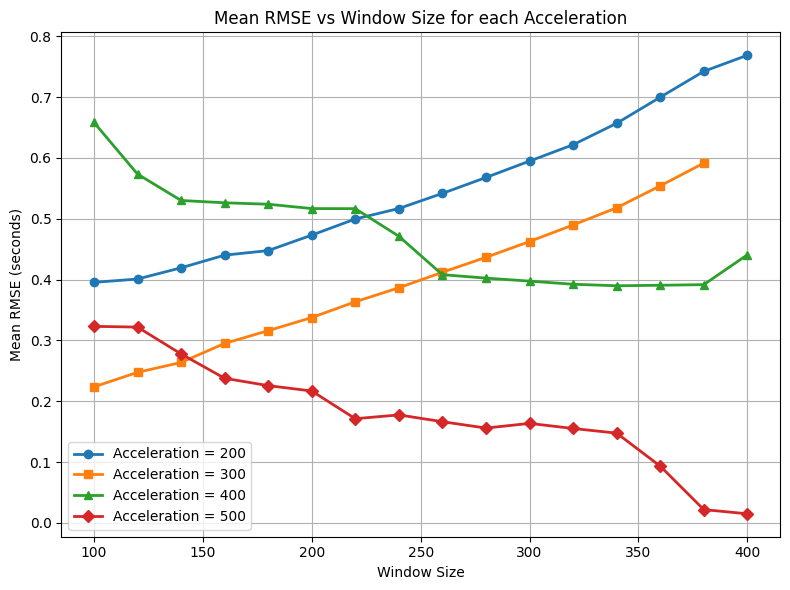

In [ ]:
import pandas as pd
import numpy as np
from tabulate import tabulate  # pip install tabulate
import matplotlib.pyplot as plt

fs = 600  # sampling rate in Hz

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112NEW.csv")

# Keep only valid detections
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# RMSE per Threshold & WindowSize per Acceleration
rmse_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
            .apply(lambda x: np.sqrt(np.mean(x**2)))
            .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# -------------------------
# Pretty table per acceleration
# -------------------------
accelerations = sorted(rmse_df["Acceleration"].unique())

for acc in accelerations:
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    # Pivot table: rows = WindowSize, columns = Threshold, values = RMSE
    table = subset_acc.pivot(index="WindowSize", columns="Threshold", values="RMSE_seconds")

    # Sort rows and columns
    table = table.sort_index().sort_index(axis=1)

    # Round values for clarity
    table_rounded = table.round(4)

    # Print nicely using tabulate
    print(f"\n=== RMSE Table for Acceleration = {acc} ===")
    print(tabulate(table_rounded, headers='keys', tablefmt='grid', showindex=True))

    # Optional: save to CSV
    table_rounded.to_csv(f"rmse_table_acc_{acc}.csv")

# -------------------------
# Plot RMSE vs WindowSize for each Acceleration
# -------------------------
plt.figure(figsize=(8,6))

thresholds = sorted(rmse_df["Threshold"].unique())
markers = ["o", "s", "^", "D", "P", "X", "*"]  # extend if needed
colors = plt.cm.tab10.colors

for i, acc in enumerate(accelerations):
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    # Compute mean RMSE across Thresholds for each WindowSize
    mean_rmse = subset_acc.groupby("WindowSize")["RMSE_seconds"].mean()

    plt.plot(
        mean_rmse.index,
        mean_rmse.values,
        label=f"Acceleration = {acc}",
        marker=markers[i % len(markers)],
        color=colors[i % len(colors)],
        linewidth=2
    )

plt.xlabel("Window Size")
plt.ylabel("Mean RMSE (seconds)")
plt.title("Mean RMSE vs Window Size for each Acceleration")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()



=== RMSE Table for Acceleration = 200 ===
+--------------+----------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+--------+
|   WindowSize |    -0.01 |    0.0 |   0.01 |   0.02 |   0.03 |   0.04 |   0.05 |   0.06 |   0.07 |   0.08 |   0.09 |    0.1 |   0.11 |   0.12 |   0.13 |   0.14 |   0.15 |   0.16 |   0.17 |   0.18 |   0.19 |    0.2 |   0.21 |   0.22 |   0.23 |   0.24 |   0.25 |   0.26 |   0.27 |   0.28 |   0.29 |    0.3 |
+==============+==========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+========+
|          100 |   0.4285 | 0.4131 |

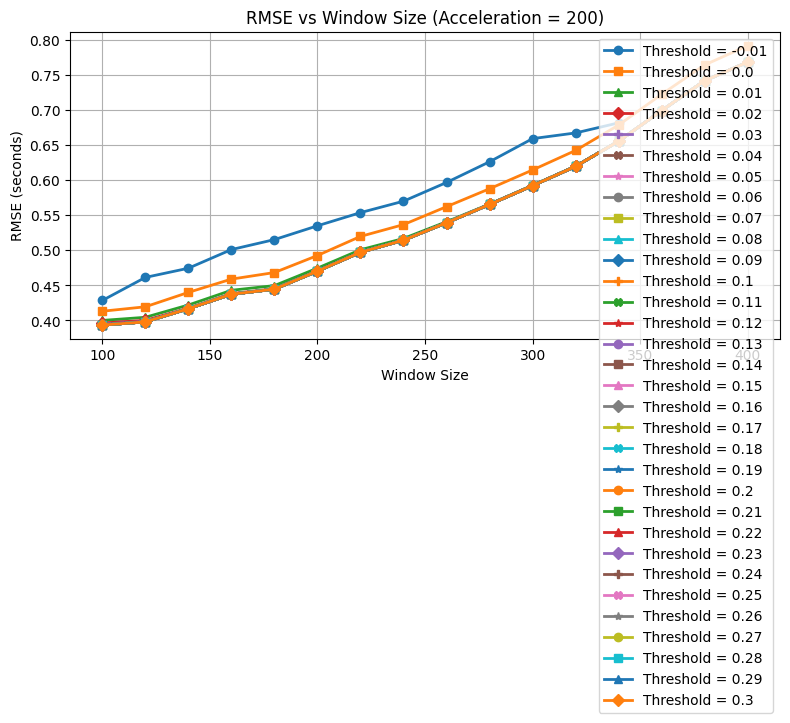

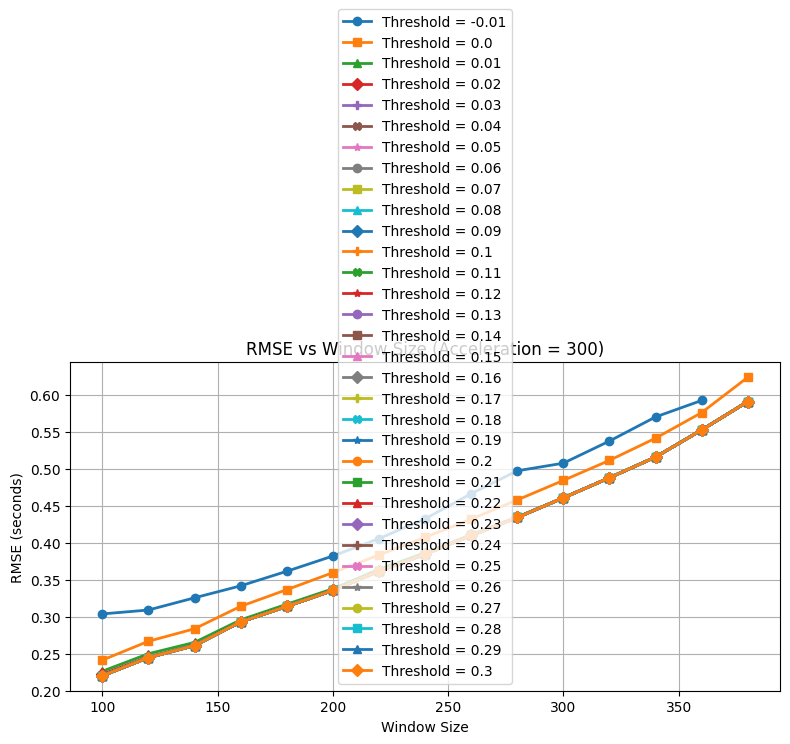

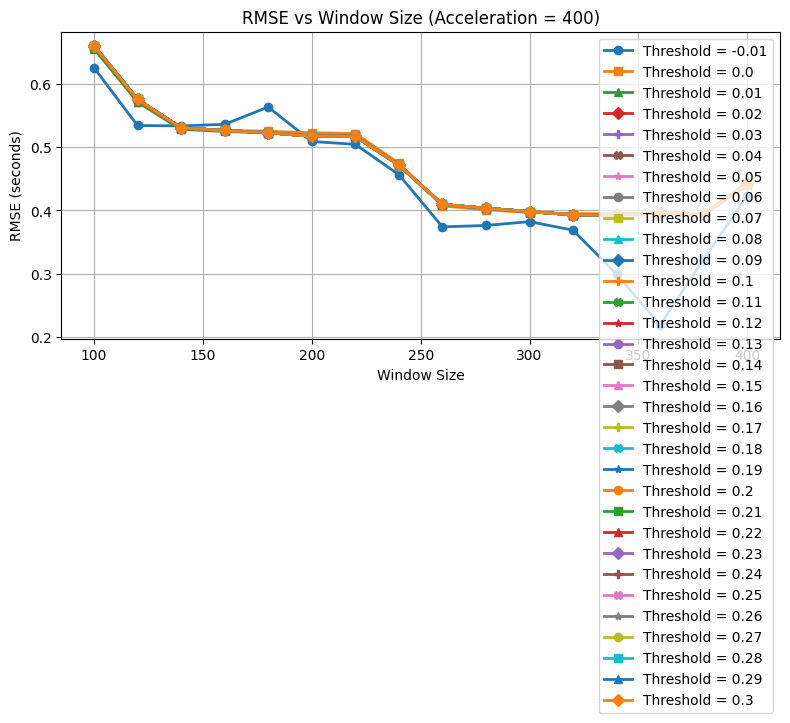

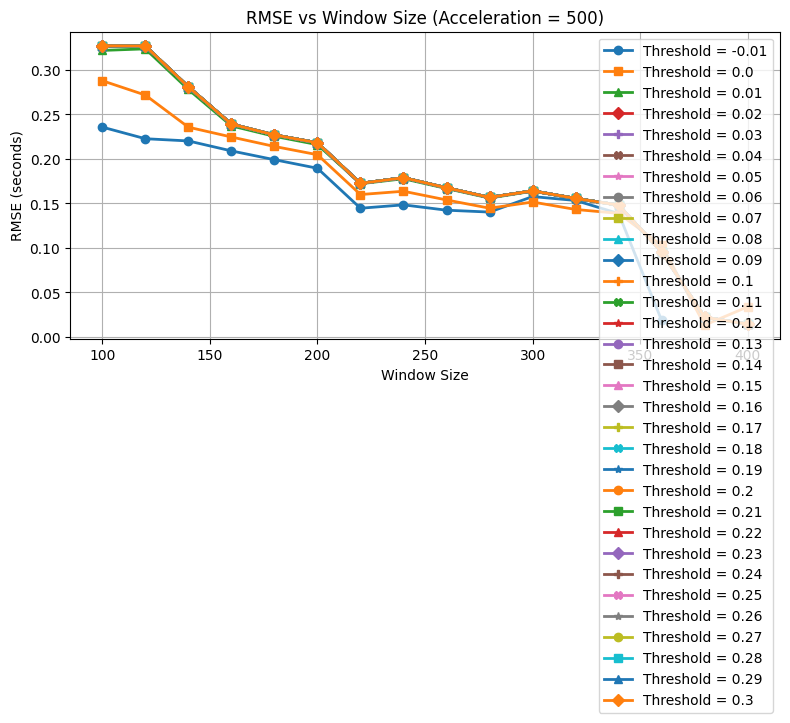

In [ ]:
import pandas as pd
import numpy as np
from tabulate import tabulate  # pip install tabulate
import matplotlib.pyplot as plt

fs = 600  # sampling rate in Hz

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112NEW.csv")

# Keep only valid detections
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# RMSE per Threshold & WindowSize per Acceleration
rmse_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
            .apply(lambda x: np.sqrt(np.mean(x**2)))
            .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# -------------------------
# Pretty table per acceleration
# -------------------------
accelerations = sorted(rmse_df["Acceleration"].unique())

for acc in accelerations:
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    # Pivot table: rows = WindowSize, columns = Threshold, values = RMSE
    table = subset_acc.pivot(index="WindowSize", columns="Threshold", values="RMSE_seconds")

    # Sort rows and columns
    table = table.sort_index().sort_index(axis=1)

    # Round values for clarity
    table_rounded = table.round(4)

    # Print nicely using tabulate
    print(f"\n=== RMSE Table for Acceleration = {acc} ===")
    print(tabulate(table_rounded, headers='keys', tablefmt='grid', showindex=True))

    # Optional: save to CSV
    table_rounded.to_csv(f"rmse_table_acc_{acc}.csv")

# -------------------------
# Plot RMSE vs WindowSize for each Acceleration
# -------------------------
markers = ["o", "s", "^", "D", "P", "X", "*"]
colors = plt.cm.tab10.colors

for acc in accelerations:
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]
    thresholds = sorted(subset_acc["Threshold"].unique())

    plt.figure(figsize=(8,6))

    for i, th in enumerate(thresholds):
        subset_th = subset_acc[subset_acc["Threshold"] == th]
        subset_th = subset_th.sort_values("WindowSize")

        plt.plot(
            subset_th["WindowSize"],
            subset_th["RMSE_seconds"],
            label=f"Threshold = {th}",
            marker=markers[i % len(markers)],
            color=colors[i % len(colors)],
            linewidth=2
        )

    plt.xlabel("Window Size")
    plt.ylabel("RMSE (seconds)")
    plt.title(f"RMSE vs Window Size (Acceleration = {acc})")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


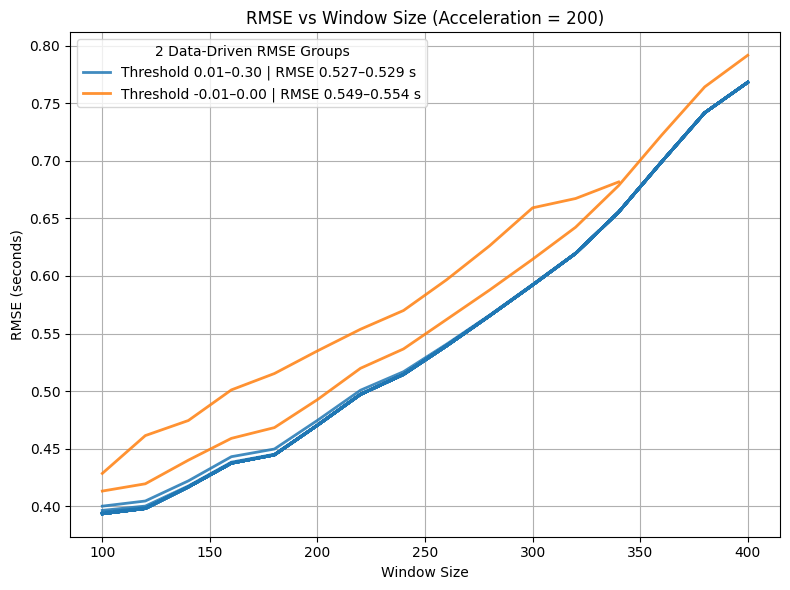

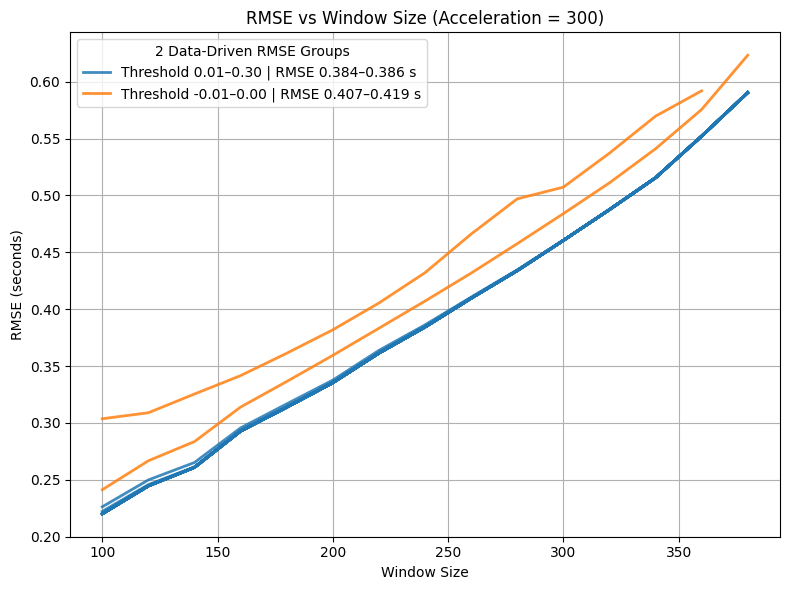

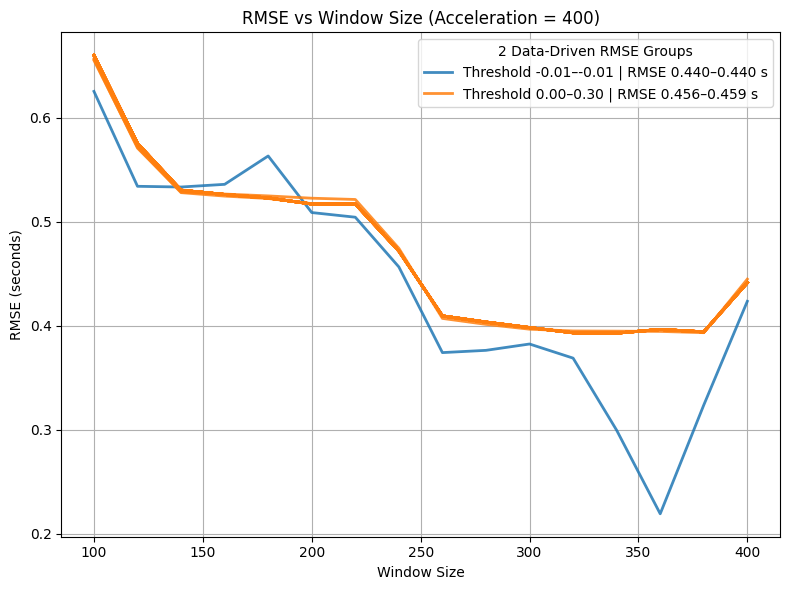

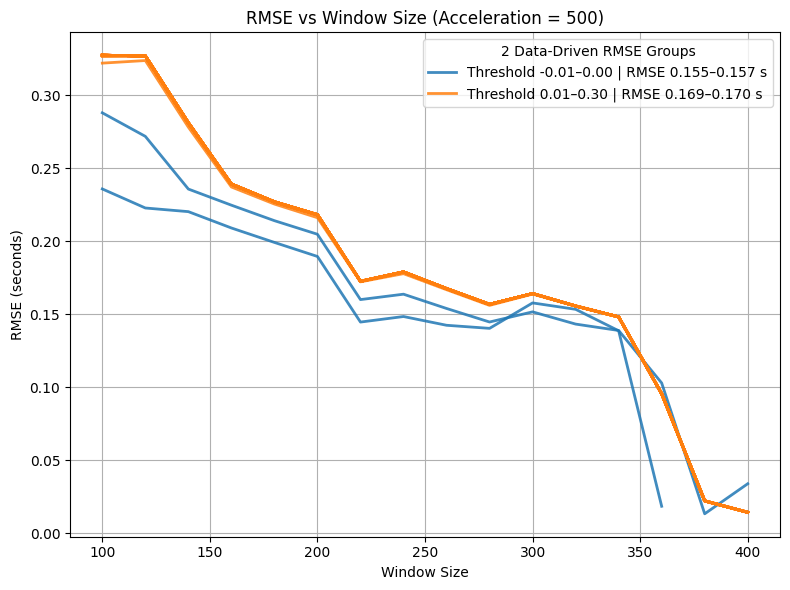

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

fs = 600  # sampling rate in Hz

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# -------------------------
# RMSE computation
# -------------------------
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

accelerations = sorted(rmse_df["Acceleration"].unique())
colors = plt.cm.tab10.colors

# -------------------------
# Plot per acceleration
# -------------------------
for acc in accelerations:
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    # -----------------------------------------
    # Median RMSE per threshold
    # -----------------------------------------
    th_summary = (
        subset_acc
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_summary[["RMSE_seconds"]].values

    # -----------------------------------------
    # Choose number of clusters (2 or 3)
    # -----------------------------------------
    best_k = None
    best_score = -1

    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k = k
            best_score = score

    # -----------------------------------------
    # Final clustering
    # -----------------------------------------
    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_summary["Cluster"] = kmeans.fit_predict(X)

    # Order clusters by RMSE
    cluster_order = (
        th_summary
        .groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )

    cluster_map = {c: i for i, c in enumerate(cluster_order)}
    th_summary["Cluster"] = th_summary["Cluster"].map(cluster_map)

    # -----------------------------------------
    # Build cluster descriptors
    # -----------------------------------------
    groups = {}

    for c in sorted(th_summary["Cluster"].unique()):
        data = th_summary[th_summary["Cluster"] == c]
        groups[c] = {
            "thresholds": data["Threshold"].tolist(),
            "th_min": data["Threshold"].min(),
            "th_max": data["Threshold"].max(),
            "rmse_min": data["RMSE_seconds"].min(),
            "rmse_max": data["RMSE_seconds"].max()
        }

    # -----------------------------------------
    # Plot
    # -----------------------------------------
    plt.figure(figsize=(8, 6))
    plotted = set()

    for c, info in groups.items():
        for th in info["thresholds"]:
            curve = (
                subset_acc[subset_acc["Threshold"] == th]
                .sort_values("WindowSize")
            )

            label = None
            if c not in plotted:
                label = (
                    f"Threshold {info['th_min']:.2f}–{info['th_max']:.2f} | "
                    f"RMSE {info['rmse_min']:.3f}–{info['rmse_max']:.3f} s"
                )
                plotted.add(c)

            plt.plot(
                curve["WindowSize"],
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85,
                label=label
            )

    plt.xlabel("Window Size")
    plt.ylabel("RMSE (seconds)")
    plt.title(f"RMSE vs Window Size (Acceleration = {acc})")
    plt.legend(title=f"{best_k} Data-Driven RMSE Groups")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


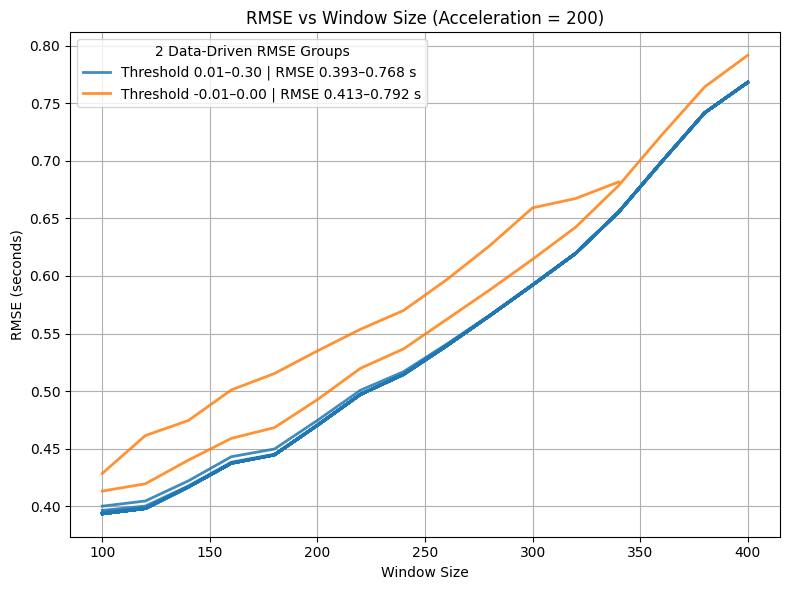

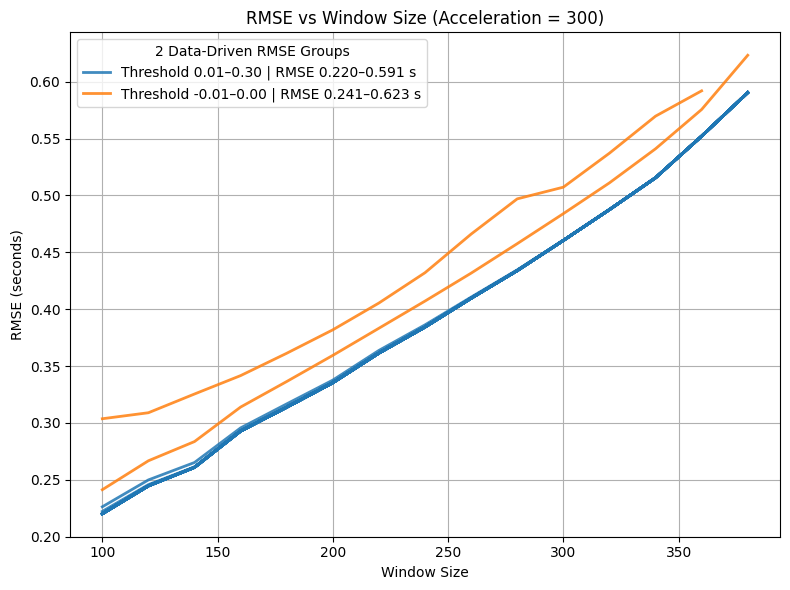

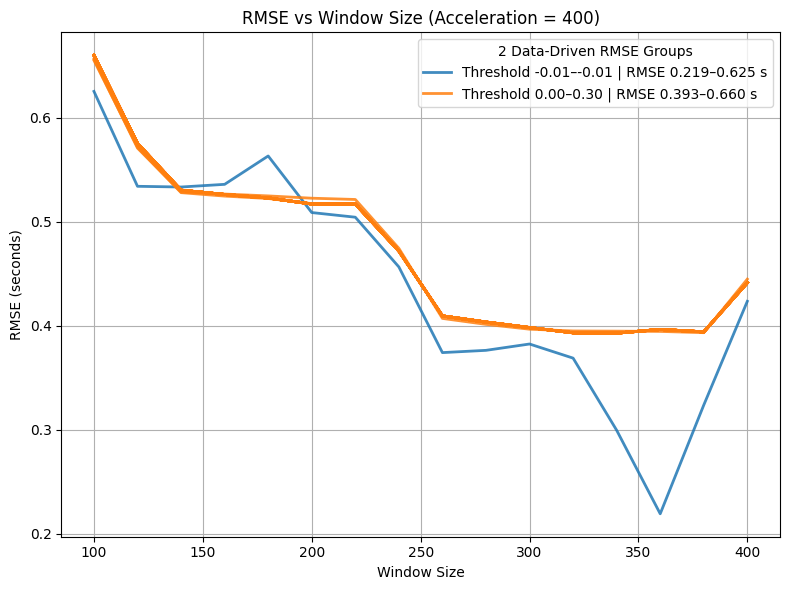

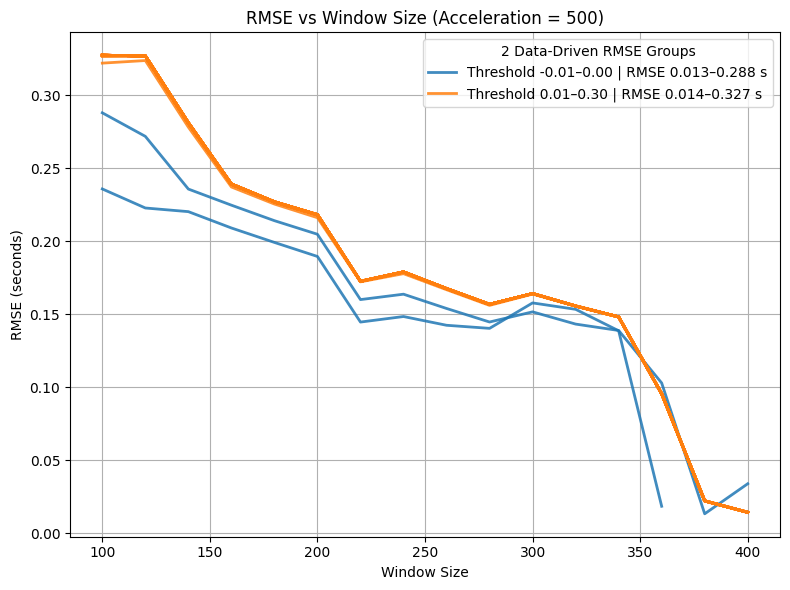

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

fs = 600  # sampling rate in Hz

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# -------------------------
# RMSE computation
# -------------------------
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

accelerations = sorted(rmse_df["Acceleration"].unique())
colors = plt.cm.tab10.colors

# -------------------------
# Plot per acceleration
# -------------------------
for acc in accelerations:
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    # ------------------------------------------------
    # Median RMSE per threshold (for clustering only)
    # ------------------------------------------------
    th_median = (
        subset_acc
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values

    # -----------------------------------------
    # Select number of clusters (2 or 3)
    # -----------------------------------------
    best_k = None
    best_score = -1

    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k = k
            best_score = score

    # -----------------------------------------
    # Final clustering
    # -----------------------------------------
    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    # Order clusters by RMSE
    cluster_order = (
        th_median
        .groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )

    cluster_map = {c: i for i, c in enumerate(cluster_order)}
    th_median["Cluster"] = th_median["Cluster"].map(cluster_map)

    # ------------------------------------------------
    # Build CORRECT cluster descriptors
    # (using full RMSE range across window sizes)
    # ------------------------------------------------
    groups = {}

    for c in sorted(th_median["Cluster"].unique()):
        thresholds = th_median[th_median["Cluster"] == c]["Threshold"].tolist()

        full_data = subset_acc[subset_acc["Threshold"].isin(thresholds)]

        groups[c] = {
            "thresholds": thresholds,
            "th_min": min(thresholds),
            "th_max": max(thresholds),
            "rmse_min": full_data["RMSE_seconds"].min(),
            "rmse_max": full_data["RMSE_seconds"].max()
        }

    # -----------------------------------------
    # Plot
    # -----------------------------------------
    plt.figure(figsize=(8, 6))
    plotted = set()

    for c, info in groups.items():
        for th in info["thresholds"]:
            curve = (
                subset_acc[subset_acc["Threshold"] == th]
                .sort_values("WindowSize")
            )

            label = None
            if c not in plotted:
                label = (
                    f"Threshold {info['th_min']:.2f}–{info['th_max']:.2f} | "
                    f"RMSE {info['rmse_min']:.3f}–{info['rmse_max']:.3f} s"
                )
                plotted.add(c)

            plt.plot(
                curve["WindowSize"],
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85,
                label=label
            )

    plt.xlabel("Window Size")
    plt.ylabel("RMSE (seconds)")
    plt.title(f"RMSE vs Window Size (Acceleration = {acc})")
    plt.legend(title=f"{best_k} Data-Driven RMSE Groups")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


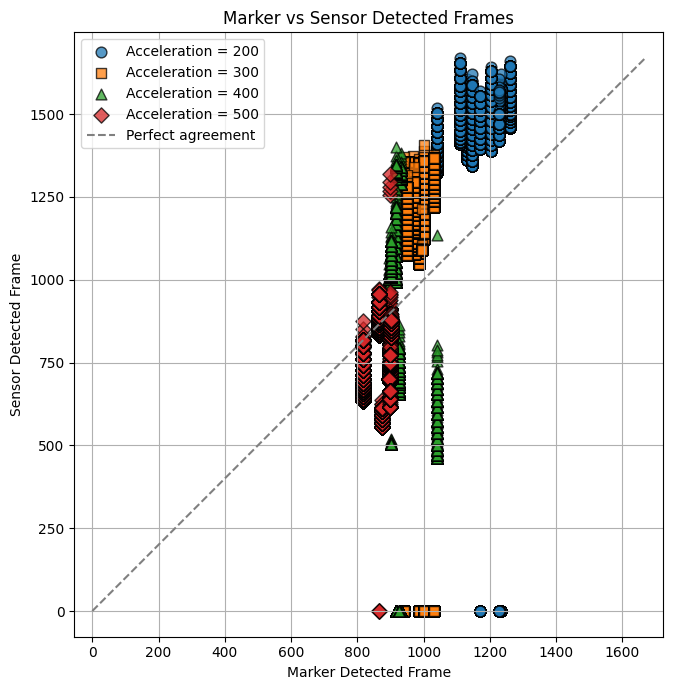

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112.csv")

# -------------------------
# Define styles per acceleration
# -------------------------
accelerations = sorted(df["Acceleration"].unique())

markers = ["o", "s", "^", "D", "P", "X", "*"]  # extend if needed
colors = plt.cm.tab10.colors  # clean, distinct colors

style_map = {}
for i, acc in enumerate(accelerations):
    style_map[acc] = {
        "marker": markers[i % len(markers)],
        "color": colors[i % len(colors)]
    }

# -------------------------
# Create scatter plot
# -------------------------
plt.figure(figsize=(7, 7))

for acc in accelerations:
    subset = df[df["Acceleration"] == acc]
    plt.scatter(
        subset["Marker_DetectedFrame"],
        subset["Sensor_DetectedFrame"],
        label=f"Acceleration = {acc}",
        marker=style_map[acc]["marker"],
        color=style_map[acc]["color"],
        s=60,
        alpha=0.75,
        edgecolors="black"
    )

# -------------------------
# Reference line: perfect agreement
# -------------------------
min_frame = min(df["Marker_DetectedFrame"].min(), df["Sensor_DetectedFrame"].min())
max_frame = max(df["Marker_DetectedFrame"].max(), df["Sensor_DetectedFrame"].max())

plt.plot(
    [min_frame, max_frame],
    [min_frame, max_frame],
    linestyle="--",
    linewidth=1.5,
    color="gray",
    label="Perfect agreement"
)

# -------------------------
# Labels and formatting
# -------------------------
plt.xlabel("Marker Detected Frame")
plt.ylabel("Sensor Detected Frame")
plt.title("Marker vs Sensor Detected Frames")
plt.legend()
plt.grid(True)
plt.axis("equal")

plt.tight_layout()
plt.show()


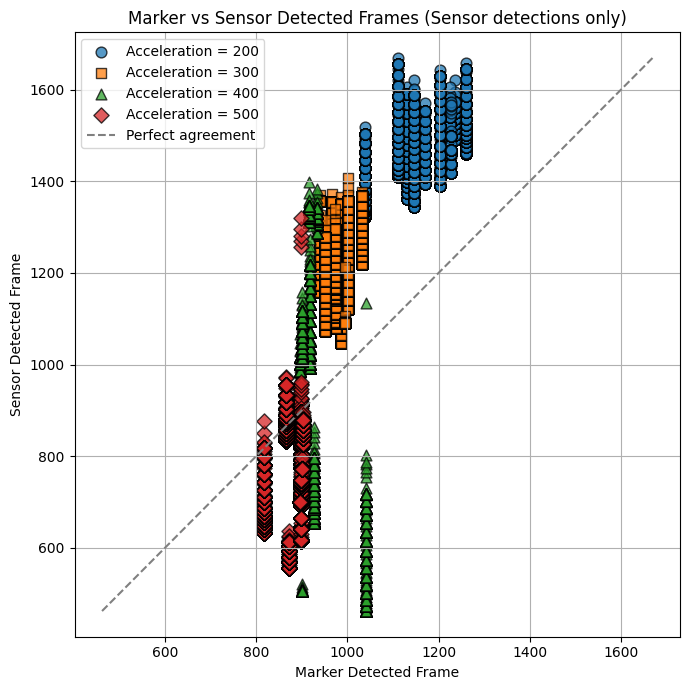

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112.csv")

# -------------------------
# Filter out sensor non-detections
# -------------------------
df_plot = df[df["Sensor_DetectedFrame"] != 0].copy()  # only keep rows where sensor detected something

# -------------------------
# Define styles per acceleration
# -------------------------
accelerations = sorted(df_plot["Acceleration"].unique())

markers = ["o", "s", "^", "D", "P", "X", "*"]  # extend if needed
colors = plt.cm.tab10.colors  # clean, distinct colors

style_map = {}
for i, acc in enumerate(accelerations):
    style_map[acc] = {
        "marker": markers[i % len(markers)],
        "color": colors[i % len(colors)]
    }

# -------------------------
# Create scatter plot
# -------------------------
plt.figure(figsize=(7, 7))

for acc in accelerations:
    subset = df_plot[df_plot["Acceleration"] == acc]
    plt.scatter(
        subset["Marker_DetectedFrame"],
        subset["Sensor_DetectedFrame"],
        label=f"Acceleration = {acc}",
        marker=style_map[acc]["marker"],
        color=style_map[acc]["color"],
        s=60,
        alpha=0.75,
        edgecolors="black"
    )

# -------------------------
# Reference line: perfect agreement
# -------------------------
min_frame = min(df_plot["Marker_DetectedFrame"].min(), df_plot["Sensor_DetectedFrame"].min())
max_frame = max(df_plot["Marker_DetectedFrame"].max(), df_plot["Sensor_DetectedFrame"].max())

plt.plot(
    [min_frame, max_frame],
    [min_frame, max_frame],
    linestyle="--",
    linewidth=1.5,
    color="gray",
    label="Perfect agreement"
)

# -------------------------
# Labels and formatting
# -------------------------
plt.xlabel("Marker Detected Frame")
plt.ylabel("Sensor Detected Frame")
plt.title("Marker vs Sensor Detected Frames (Sensor detections only)")
plt.legend()
plt.grid(True)
plt.axis("equal")

plt.tight_layout()
plt.show()


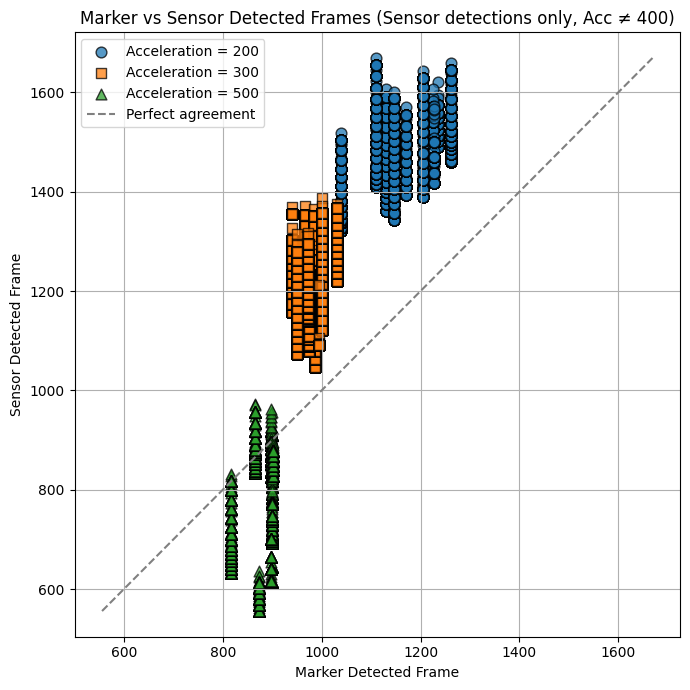

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112NEW.csv")

# -------------------------
# Filter out sensor non-detections
# AND exclude acceleration = 400
# -------------------------
df_plot = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Acceleration"] != 400)
].copy()

# -------------------------
# Define styles per acceleration
# -------------------------
accelerations = sorted(df_plot["Acceleration"].unique())

markers = ["o", "s", "^", "D", "P", "X", "*"]  # extend if needed
colors = plt.cm.tab10.colors  # clean, distinct colors

style_map = {}
for i, acc in enumerate(accelerations):
    style_map[acc] = {
        "marker": markers[i % len(markers)],
        "color": colors[i % len(colors)]
    }

# -------------------------
# Create scatter plot
# -------------------------
plt.figure(figsize=(7, 7))

for acc in accelerations:
    subset = df_plot[df_plot["Acceleration"] == acc]
    plt.scatter(
        subset["Marker_DetectedFrame"],
        subset["Sensor_DetectedFrame"],
        label=f"Acceleration = {acc}",
        marker=style_map[acc]["marker"],
        color=style_map[acc]["color"],
        s=60,
        alpha=0.75,
        edgecolors="black"
    )

# -------------------------
# Reference line: perfect agreement
# -------------------------
min_frame = min(
    df_plot["Marker_DetectedFrame"].min(),
    df_plot["Sensor_DetectedFrame"].min()
)
max_frame = max(
    df_plot["Marker_DetectedFrame"].max(),
    df_plot["Sensor_DetectedFrame"].max()
)

plt.plot(
    [min_frame, max_frame],
    [min_frame, max_frame],
    linestyle="--",
    linewidth=1.5,
    color="gray",
    label="Perfect agreement"
)

# -------------------------
# Labels and formatting
# -------------------------
plt.xlabel("Marker Detected Frame")
plt.ylabel("Sensor Detected Frame")
plt.title("Marker vs Sensor Detected Frames (Sensor detections only, Acc ≠ 400)")
plt.legend()
plt.grid(True)
plt.axis("equal")

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np

# -------------------------
# Load CSV
# -------------------------
df = pd.read_csv("trial_dataAll_08_02_14_26_36.csv")   # replace with actual filename

# -------------------------
# Select the column of interest
# -------------------------
x = np.sort(df["Number e1"].dropna().values)

# -------------------------
# Compute minimum non-zero step
# -------------------------
diffs = np.diff(x)
min_step = np.min(diffs[diffs > 0])

print("Estimated minimum step:", min_step)


KeyError: 'Number e1'

In [ ]:
import pandas as pd

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112.csv")

# Keep only accelerations of interest
accelerations_of_interest = [200, 300, 400, 500]
df = df[df["Acceleration"].isin(accelerations_of_interest)]

# -------------------------
# Count detections per Threshold, Acceleration, Trial
# -------------------------
count_df = (
    df.groupby(["Threshold", "Acceleration", "Trial"])
      .size()
      .reset_index(name="Detection_Count")
)

# -------------------------
# Pivot table: Trials as columns
# -------------------------
table = (
    count_df.pivot_table(
        index=["Threshold", "Acceleration"],
        columns="Trial",
        values="Detection_Count",
        fill_value=0
    )
)

# -------------------------
# Add total count per Threshold–Acceleration
# -------------------------
table["Total"] = table.sum(axis=1)

# -------------------------
# Clean formatting
# -------------------------
table = table.reset_index().sort_values(
    ["Threshold", "Acceleration"]
)

# Display table
table


Trial,Threshold,Acceleration,1,2,3,4,5,6,7,8,9,10,Total
0,-0.01,200,13.0,13.0,11.0,16.0,10.0,12.0,11.0,13.0,3.0,6.0,108.0
1,-0.01,300,10.0,14.0,14.0,3.0,8.0,16.0,15.0,14.0,15.0,1.0,110.0
2,-0.01,400,0.0,14.0,13.0,12.0,5.0,15.0,14.0,0.0,0.0,13.0,86.0
3,-0.01,500,6.0,13.0,0.0,16.0,7.0,16.0,10.0,14.0,2.0,6.0,90.0
4,0.00,200,16.0,16.0,16.0,16.0,14.0,15.0,12.0,13.0,14.0,6.0,138.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,0.29,500,6.0,13.0,0.0,16.0,7.0,16.0,10.0,14.0,2.0,6.0,90.0
124,0.30,200,16.0,16.0,16.0,16.0,14.0,15.0,12.0,13.0,14.0,6.0,138.0
125,0.30,300,15.0,16.0,14.0,14.0,14.0,16.0,15.0,14.0,15.0,1.0,134.0
126,0.30,400,0.0,16.0,16.0,16.0,13.0,15.0,16.0,0.0,0.0,13.0,105.0


In [ ]:
import pandas as pd

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112.csv")

# -------------------------
# Explicit detection condition
# -------------------------
df_detected = df[df["Sensor_DetectedFrame"] != 0]

# -------------------------
# Restrict to accelerations of interest
# -------------------------
accelerations_of_interest = [200, 300, 400, 500]
df_detected = df_detected[df_detected["Acceleration"].isin(accelerations_of_interest)]

# -------------------------
# Count detections per Threshold, Acceleration, WindowSize, Trial
# -------------------------
count_df = (
    df_detected
    .groupby(["Threshold", "Acceleration", "WindowSize", "Trial"])
    .size()
    .reset_index(name="Sensor_Detection_Count")
)

# -------------------------
# Pivot: Trials as columns
# -------------------------
table = (
    count_df.pivot_table(
        index=["Threshold", "Acceleration", "WindowSize"],
        columns="Trial",
        values="Sensor_Detection_Count",
        fill_value=0
    )
)

# -------------------------
# Add total detections per row
# -------------------------
table["Total"] = table.sum(axis=1)

# -------------------------
# Final formatting
# -------------------------
table = table.reset_index().sort_values(
    ["Threshold", "Acceleration", "WindowSize"]
)

table


Trial,Threshold,Acceleration,WindowSize,1,2,3,4,5,6,7,8,9,10,Total
0,-0.01,200,100,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,6.0
1,-0.01,200,120,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,7.0
2,-0.01,200,140,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,8.0
3,-0.01,200,160,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,7.0
4,-0.01,200,180,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2011,0.30,500,320,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,4.0
2012,0.30,500,340,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,4.0
2013,0.30,500,360,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,3.0
2014,0.30,500,380,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,2.0


/tmp/ipython-input-141654368.py:170: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


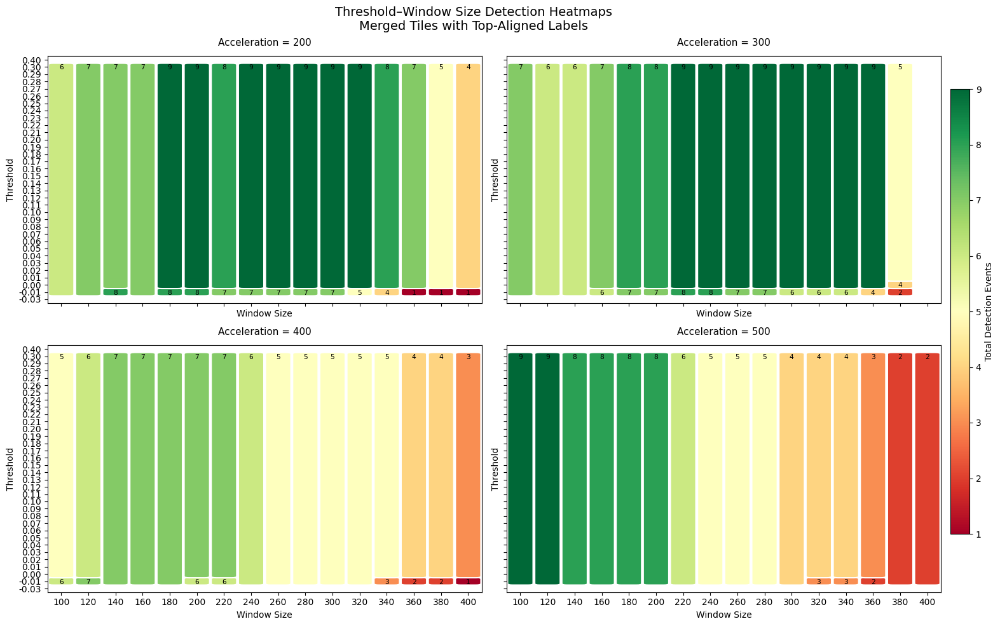

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.patches import FancyBboxPatch

# =========================
# 1. LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112.csv")

# =========================
# 2. FILTER VALID DETECTIONS
# =========================
df = df[df["Sensor_DetectedFrame"] != 0]

accelerations = [200, 300, 400, 500]
df = df[df["Acceleration"].isin(accelerations)]

# =========================
# 3. SORT FOR EVENT COUNTING
# =========================
df = df.sort_values(
    ["Threshold", "Acceleration", "WindowSize", "Trial", "Sensor_DetectedFrame"]
)

# =========================
# 4. COUNT CONTIGUOUS EVENTS
# =========================
def count_contiguous_events(frames):
    if len(frames) == 0:
        return 0
    return np.sum(np.diff(frames) > 1) + 1

event_df = (
    df.groupby(["Threshold", "Acceleration", "WindowSize", "Trial"])
      ["Sensor_DetectedFrame"]
      .apply(count_contiguous_events)
      .reset_index(name="EventCount")
)

# =========================
# 5. SUM ACROSS TRIALS
# =========================
summary_df = (
    event_df.groupby(["Acceleration", "Threshold", "WindowSize"])
    .agg(Total=("EventCount", "sum"))
    .reset_index()
)

# =========================
# 6. PLOTTING
# =========================
fig, axes = plt.subplots(
    2, 2,
    figsize=(15, 10),
    sharex=True,
    sharey=True
)
axes = axes.flatten()

vmin, vmax = summary_df["Total"].min(), summary_df["Total"].max()
cmap = plt.cm.RdYlGn

# Visual padding (display only)
padding_min, padding_max = -0.03, 0.40

for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    heatmap = sub.pivot(index="Threshold", columns="WindowSize", values="Total")

    # Insert padding rows
    padded_thresholds = np.sort(
        np.unique(
            np.concatenate([
                [padding_min],
                heatmap.index.values,
                [padding_max]
            ])
        )
    )
    heatmap = heatmap.reindex(padded_thresholds)

    thresholds = heatmap.index.values
    window_sizes = heatmap.columns.values

    # Lock grid coordinates
    ax.set_xlim(-0.5, len(window_sizes) - 0.5)
    ax.set_ylim(-0.5, len(thresholds) - 0.5)
    ax.margins(0)
    ax.set_aspect("auto")

    # Draw merged tiles
    for j in range(len(window_sizes)):
        col = heatmap.iloc[:, j].values
        i = 0

        while i < len(col):
            val = col[i]

            if np.isnan(val):
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == val:
                k += 1

            height = k - i + 1
            color = cmap((val - vmin) / (vmax - vmin))

            rect = FancyBboxPatch(
                (j - 0.45, i - 0.5),
                0.9,
                height,
                boxstyle="round,pad=0.02,rounding_size=0.18",
                linewidth=1.5,
                edgecolor="white",
                facecolor=color
            )
            ax.add_patch(rect)

            # ---- TOP-ALIGNED LABEL (intentional) ----
            y_top = i - 0.5 + height - 0.15

            ax.text(
                j,
                y_top,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=8,
                color="black",
                fontfamily="monospace"
            )

            i = k + 1

    # Axes formatting
    ax.set_title(f"Acceleration = {acc}", fontsize=11, y=1.02)
    ax.set_xticks(np.arange(len(window_sizes)))
    ax.set_xticklabels(window_sizes)
    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")
    ax.grid(False)

# =========================
# COLORBAR (outside)
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([1.0, 0.15, 0.02, 0.7])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Total Detection Events")

# =========================
# FIGURE TITLE
# =========================
fig.suptitle(
    "Threshold–Window Size Detection Heatmaps\n"
    "Merged Tiles with Top-Aligned Labels",
    fontsize=14,
    y=0.98
)

plt.tight_layout()
plt.show()


/tmp/ipython-input-3915521658.py:57: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda g: np.sqrt(np.mean(g["Error"] ** 2)))
/tmp/ipython-input-3915521658.py:178: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


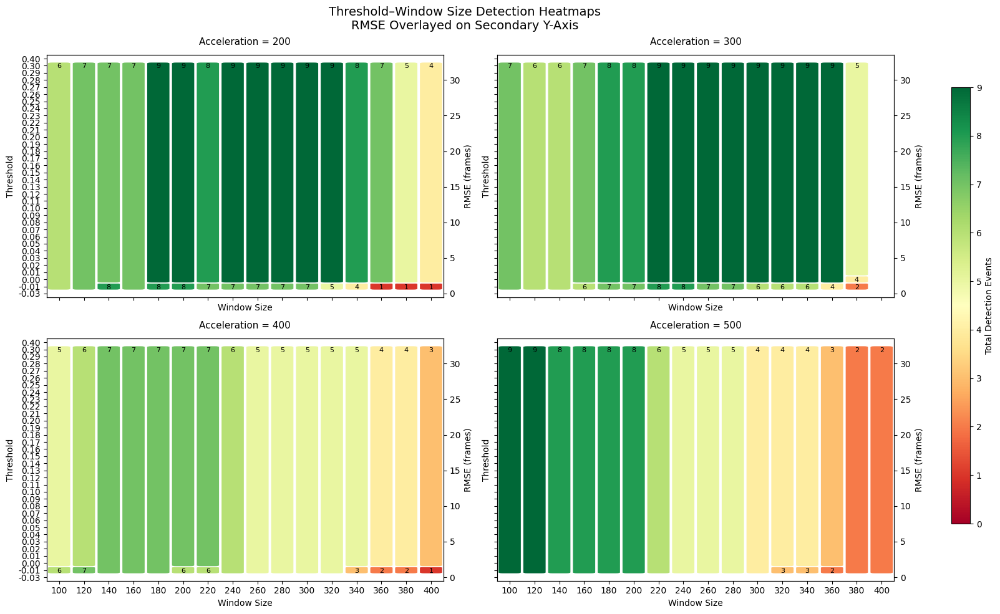

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.patches import FancyBboxPatch

# =========================
# 1. LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112.csv")

# =========================
# 2. FILTER VALID DETECTIONS
# =========================
df = df[df["Sensor_DetectedFrame"] != 0]

accelerations = [200, 300, 400, 500]
df = df[df["Acceleration"].isin(accelerations)]

# =========================
# 3. SORT FOR EVENT COUNTING
# =========================
df = df.sort_values(
    ["Threshold", "Acceleration", "WindowSize", "Trial", "Sensor_DetectedFrame"]
)

# =========================
# 4. COUNT CONTIGUOUS EVENTS
# =========================
def count_contiguous_events(frames):
    if len(frames) == 0:
        return 0
    return np.sum(np.diff(frames) > 1) + 1

event_df = (
    df.groupby(["Threshold", "Acceleration", "WindowSize", "Trial"])
      ["Sensor_DetectedFrame"]
      .apply(count_contiguous_events)
      .reset_index(name="EventCount")
)

# =========================
# 5. SUM ACROSS TRIALS
# =========================
summary_df = (
    event_df.groupby(["Acceleration", "Threshold", "WindowSize"])
    .agg(Total=("EventCount", "sum"))
    .reset_index()
)

# =========================
# 6. RMSE COMPUTATION
# =========================
rmse_df = (
    df.assign(Error=lambda x: x["Sensor_DetectedFrame"] - x["Marker_DetectedFrame"])
      .groupby(["Acceleration", "Threshold"])
      .apply(lambda g: np.sqrt(np.mean(g["Error"] ** 2)))
      .reset_index(name="RMSE")
)

# =========================
# 7. PLOTTING
# =========================
fig, axes = plt.subplots(2, 2, figsize=(15, 10), sharex=True, sharey=True)
axes = axes.flatten()

vmin, vmax = 0, summary_df["Total"].max()
cmap = plt.cm.RdYlGn

padding_min, padding_max = -0.03, 0.40

for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
           .fillna(0)
    )

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds)

    thresholds = heatmap.index.values
    window_sizes = heatmap.columns.values

    ax.set_xlim(-0.5, len(window_sizes) - 0.5)
    ax.set_ylim(-0.5, len(thresholds) - 0.5)
    ax.margins(0)

    # ---- DRAW HEATMAP TILES ----
    for j in range(len(window_sizes)):
        col = heatmap.iloc[:, j].values
        i = 0
        while i < len(col):
            val = col[i]
            if np.isnan(val):
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == val:
                k += 1

            height = k - i + 1
            color = cmap((val - vmin) / (vmax - vmin))

            ax.add_patch(
                FancyBboxPatch(
                    (j - 0.45, i - 0.5),
                    0.9,
                    height,
                    boxstyle="round,pad=0.02,rounding_size=0.18",
                    edgecolor="white",
                    facecolor=color,
                    linewidth=1.2
                )
            )

            y_top = i - 0.5 + height - 0.15
            ax.text(j, y_top, f"{int(val)}",
                    ha="center", va="top", fontsize=8)

            i = k + 1

    # ---- RMSE SECONDARY AXIS ----
    ax_r = ax.twinx()

    rmse_rows = []
    rmse_vals = []

    for _, row in rmse_sub.iterrows():
        if row["Threshold"] in thresholds:
            rmse_rows.append(np.where(thresholds == row["Threshold"])[0][0])
            rmse_vals.append(row["RMSE"])

    ax_r.plot(
        rmse_vals,
        rmse_rows,
        color="black",
        marker="o",
        linewidth=1.5,
        markersize=4
    )

    ax_r.set_ylim(ax.get_ylim())
    ax_r.set_ylabel("RMSE (frames)")
    ax_r.grid(False)

    # ---- AXES FORMATTING ----
    ax.set_title(f"Acceleration = {acc}", fontsize=11, y=1.02)
    ax.set_xticks(np.arange(len(window_sizes)))
    ax.set_xticklabels(window_sizes)
    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([1.02, 0.15, 0.02, 0.7])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Total Detection Events")

fig.suptitle(
    "Threshold–Window Size Detection Heatmaps\n"
    "RMSE Overlayed on Secondary Y-Axis",
    fontsize=14,
    y=0.98
)

plt.tight_layout()
plt.show()


/tmp/ipython-input-3037160967.py:57: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda g: np.sqrt(np.mean(g["Error"].values ** 2))) # Explicitly select 'Error' column
/tmp/ipython-input-3037160967.py:198: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


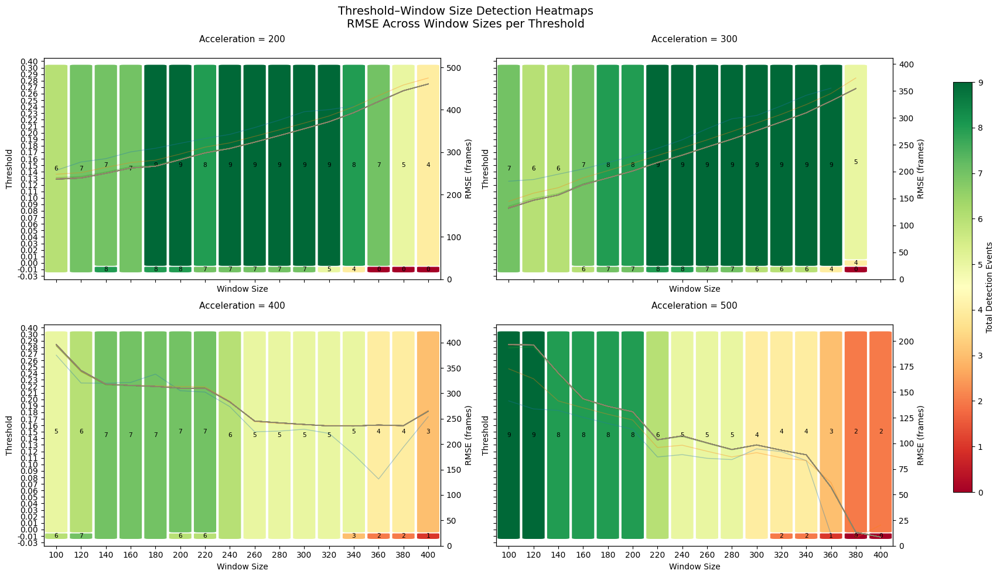

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.patches import FancyBboxPatch

# =========================
# 1. LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

# =========================
# 2. FILTER VALID DETECTIONS
# =========================
df = df[df["Sensor_DetectedFrame"] != 0]

accelerations = [200, 300, 400, 500]
df = df[df["Acceleration"].isin(accelerations)]

# =========================
# 3. SORT FOR EVENT COUNTING
# =========================
df = df.sort_values(
    ["Threshold", "Acceleration", "WindowSize", "Trial", "Sensor_DetectedFrame"]
)

# =========================
# 4. COUNT CONTIGUOUS EVENTS
# =========================
def count_contiguous_events(frames):
    if len(frames) == 0:
        return 0
    return np.sum(np.diff(frames) > 1) + 1

event_df = (
    df.groupby(["Threshold", "Acceleration", "WindowSize", "Trial"])
      ["Sensor_DetectedFrame"]
      .apply(count_contiguous_events)
      .reset_index(name="EventCount")
)

# =========================
# 5. SUM ACROSS TRIALS
# =========================
summary_df = (
    event_df.groupby(["Acceleration", "Threshold", "WindowSize"])
    .agg(Total=("EventCount", "sum"))
    .reset_index()
)

# =========================
# 6. RMSE COMPUTATION (frames)
# =========================
rmse_df = (
    df.assign(Error=lambda x: x["Sensor_DetectedFrame"] - x["Marker_DetectedFrame"])
      .groupby(["Acceleration", "Threshold", "WindowSize"])
      .apply(lambda g: np.sqrt(np.mean(g["Error"].values ** 2))) # Explicitly select 'Error' column
      .reset_index(name="RMSE")
)

# =========================
# 7. PLOTTING
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

vmin, vmax = 0, summary_df["Total"].max()
cmap = plt.cm.RdYlGn

padding_min, padding_max = -0.03, 0.40

for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ---- FULL GRID WITH ZEROS ----
    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
           .fillna(0)
    )

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds)

    thresholds = heatmap.index.values
    window_sizes = heatmap.columns.values

    ax.set_xlim(-0.5, len(window_sizes) - 0.5)
    ax.set_ylim(-0.5, len(thresholds) - 0.5)
    ax.margins(0)

    # =========================
    # DRAW MERGED HEATMAP TILES
    # =========================
    for j in range(len(window_sizes)):
        col = heatmap.iloc[:, j].values
        i = 0

        while i < len(col):

            val = col[i]

            # ---- FIX: SKIP NaN PADDING ROWS ----
            if np.isnan(val):
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == val:
                k += 1

            height = k - i + 1
            color = cmap((val - vmin) / (vmax - vmin))

            ax.add_patch(
                FancyBboxPatch(
                    (j - 0.45, i - 0.5),
                    0.9,
                    height,
                    boxstyle="round,pad=0.02,rounding_size=0.18",
                    linewidth=1.2,
                    edgecolor="white",
                    facecolor=color
                )
            )

            # ---- CENTERED LABEL ----
            y_center = (i - 0.5) + height / 2
            ax.text(
                j,
                y_center,
                f"{int(val)}",
                ha="center",
                va="center",
                fontsize=8,
                fontfamily="monospace"
            )

            i = k + 1

    # =========================
    # RMSE OVERLAY (ONE LINE PER THRESHOLD)
    # =========================
    ax_r = ax.twinx()

    for th in np.sort(rmse_sub["Threshold"].unique()):
        rmse_line = rmse_sub[rmse_sub["Threshold"] == th].sort_values("WindowSize")
        # Reindex to ensure all window sizes are present, filling missing with NaN
        rmse_line = rmse_line.set_index('WindowSize')['RMSE'].reindex(window_sizes).reset_index()

        ax_r.plot(
            np.arange(len(window_sizes)),
            rmse_line["RMSE"],
            linewidth=1.0,
            alpha=0.35
        )

    ax_r.set_ylabel("RMSE (frames)")
    ax_r.set_ylim(0, rmse_sub["RMSE"].max() * 1.1)
    ax_r.grid(False)
    ax_r.set_xticks(np.arange(len(window_sizes)))
    ax_r.set_xticklabels(window_sizes)

    # =========================
    # AXES FORMATTING
    # =========================
    ax.set_title(f"Acceleration = {acc}", fontsize=11, y=1.05)
    ax.set_xticks(np.arange(len(window_sizes)))
    ax.set_xticklabels(window_sizes)
    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([1.02, 0.15, 0.02, 0.7])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Total Detection Events")

# =========================
# FIGURE TITLE
# =========================
fig.suptitle(
    "Threshold–Window Size Detection Heatmaps\n"
    "RMSE Across Window Sizes per Threshold",
    fontsize=14,
    y=0.98
)

plt.tight_layout()
plt.show()

/tmp/ipython-input-3537091530.py:62: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda g: np.sqrt(np.mean(g["Error"].values ** 2)))
/tmp/ipython-input-3537091530.py:202: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


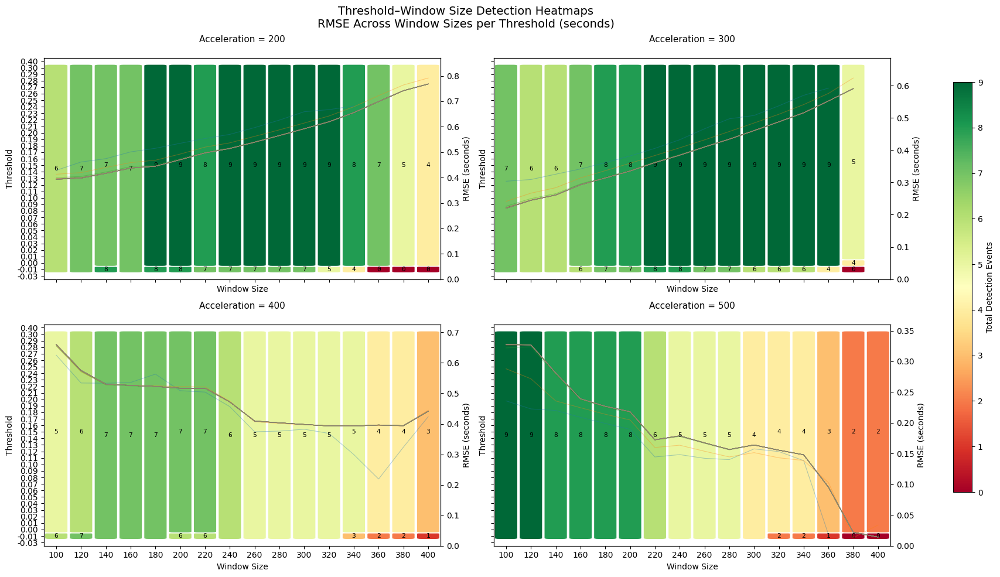

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.patches import FancyBboxPatch

# =========================
# PARAMETERS
# =========================
fs = 600  # frame rate (Hz)

# =========================
# 1. LOAD DATA
# =========================================================================
df = pd.read_csv("slope_detection_summary112NEW.csv")

# =========================
# 2. FILTER VALID DETECTIONS
# =========================
df = df[df["Sensor_DetectedFrame"] != 0]

accelerations = [200, 300, 400, 500]
df = df[df["Acceleration"].isin(accelerations)]

# =========================
# 3. SORT FOR EVENT COUNTING
# =========================
df = df.sort_values(
    ["Threshold", "Acceleration", "WindowSize", "Trial", "Sensor_DetectedFrame"]
)

# =========================
# 4. COUNT CONTIGUOUS EVENTS
# =========================
def count_contiguous_events(frames):
    if len(frames) == 0:
        return 0
    return np.sum(np.diff(frames) > 1) + 1

event_df = (
    df.groupby(["Threshold", "Acceleration", "WindowSize", "Trial"])
      ["Sensor_DetectedFrame"]
      .apply(count_contiguous_events)
      .reset_index(name="EventCount")
)

# =========================
# 5. SUM ACROSS TRIALS
# =========================
summary_df = (
    event_df.groupby(["Acceleration", "Threshold", "WindowSize"])
    .agg(Total=("EventCount", "sum"))
    .reset_index()
)

# =========================
# 6. RMSE COMPUTATION (SECONDS)
# =========================
rmse_df = (
    df.assign(Error=lambda x: x["Sensor_DetectedFrame"] - x["Marker_DetectedFrame"])
      .groupby(["Acceleration", "Threshold", "WindowSize"])
      .apply(lambda g: np.sqrt(np.mean(g["Error"].values ** 2)))
      .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# 7. PLOTTING
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

vmin, vmax = 0, summary_df["Total"].max()
cmap = plt.cm.RdYlGn

padding_min, padding_max = -0.03, 0.40

for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ---- FULL GRID WITH ZEROS ----
    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
           .fillna(0)
    )

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds)

    thresholds = heatmap.index.values
    window_sizes = heatmap.columns.values

    ax.set_xlim(-0.5, len(window_sizes) - 0.5)
    ax.set_ylim(-0.5, len(thresholds) - 0.5)
    ax.margins(0)

    # =========================
    # DRAW MERGED HEATMAP TILES
    # =========================
    for j in range(len(window_sizes)):
        col = heatmap.iloc[:, j].values
        i = 0

        while i < len(col):

            val = col[i]

            # Skip padding rows
            if np.isnan(val):
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == val:
                k += 1

            height = k - i + 1
            color = cmap((val - vmin) / (vmax - vmin))

            ax.add_patch(
                FancyBboxPatch(
                    (j - 0.45, i - 0.5),
                    0.9,
                    height,
                    boxstyle="round,pad=0.02,rounding_size=0.18",
                    linewidth=1.2,
                    edgecolor="white",
                    facecolor=color
                )
            )

            y_center = (i - 0.5) + height / 2
            ax.text(
                j, y_center,
                f"{int(val)}",
                ha="center", va="center",
                fontsize=8,
                fontfamily="monospace"
            )

            i = k + 1

    # =========================
    # RMSE OVERLAY (SECONDS)
    # =========================
    ax_r = ax.twinx()

    for th in np.sort(rmse_sub["Threshold"].unique()):
        rmse_line = rmse_sub[rmse_sub["Threshold"] == th].sort_values("WindowSize")
        # Reindex to ensure all window sizes are present, filling missing with NaN
        rmse_line = rmse_line.set_index('WindowSize')['RMSE_seconds'].reindex(window_sizes).reset_index()

        ax_r.plot(
            np.arange(len(window_sizes)),
            rmse_line["RMSE_seconds"],
            linewidth=0.8,
            alpha=0.35
        )

    ax_r.set_ylabel("RMSE (seconds)")
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.grid(False)
    ax_r.set_xticks(np.arange(len(window_sizes)))
    ax_r.set_xticklabels(window_sizes)

    # =========================
    # AXES FORMATTING
    # =========================
    ax.set_title(f"Acceleration = {acc}", fontsize=11, y=1.05)
    ax.set_xticks(np.arange(len(window_sizes)))
    ax.set_xticklabels(window_sizes)
    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([1.02, 0.15, 0.02, 0.7])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Total Detection Events")

# =========================
# FIGURE TITLE
# =========================
fig.suptitle(
    "Threshold–Window Size Detection Heatmaps\n"
    "RMSE Across Window Sizes per Threshold (seconds)",
    fontsize=14,
    y=0.98
)

plt.tight_layout()
plt.show()

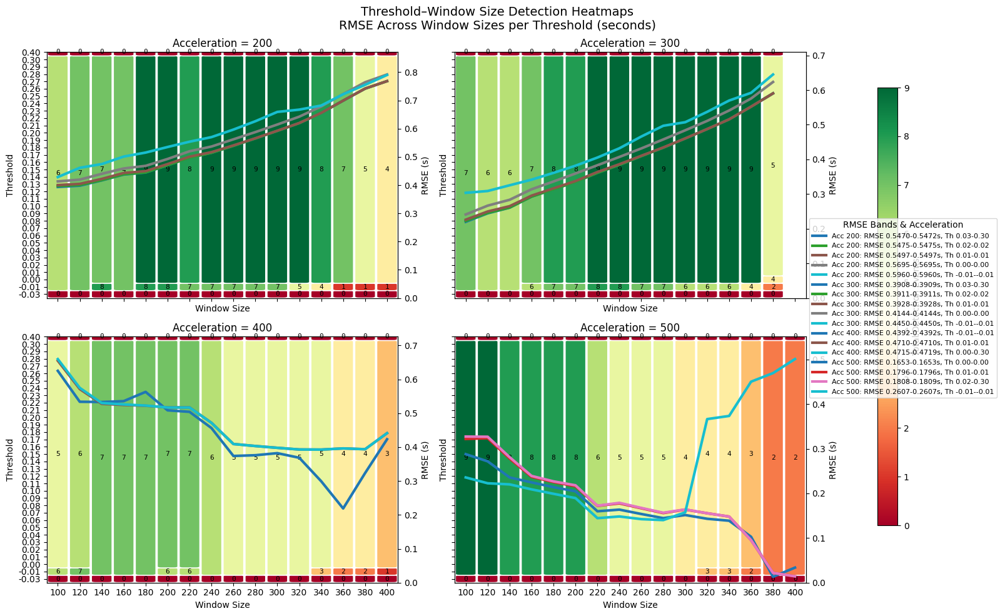

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable, get_cmap
from matplotlib.patches import FancyBboxPatch, Patch
from matplotlib.lines import Line2D
import matplotlib.cm as cm
import numpy as np

# =========================
# PLOTTING FIXED
# =========================
fs = 600
padding_min, padding_max = -0.03, 0.40
RMSE_EPS = 0.0002

accelerations = [200, 300, 400, 500]

fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

vmin, vmax = 0, summary_df["Total"].max()
cmap = plt.cm.RdYlGn

all_legend_items = []

for ax, acc in zip(axes, accelerations):

    # Subset data
    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # Pivot for heatmap
    heatmap = sub.pivot(index="Threshold", columns="WindowSize", values="Total").fillna(0)

    # Add padding thresholds
    padded_thresholds = np.sort(np.unique([padding_min, *heatmap.index.values, padding_max]))
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    window_sizes = heatmap.columns.values

    # Axis limits
    ax.set_xlim(-0.5, len(window_sizes)-0.5)
    y_min, y_max = thresholds.min() - 0.5, thresholds.max() + 0.5
    ax.set_ylim(y_min, y_max)
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")
    ax.set_xticks(np.arange(len(window_sizes)))
    ax.set_xticklabels(window_sizes)
    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])
    ax.set_title(f"Acceleration = {acc}")

    # ------------------------
    # # DRAW HEATMAP TILES
    # # ------------------------
    for j, col_name in enumerate(heatmap.columns):
        col = heatmap[col_name].values
        i = 0
        while i < len(col):
            val = col[i]
            k = i
            while k + 1 < len(col) and col[k+1] == val:
                k += 1
            height = k - i + 1
            color = cmap((val - vmin)/(vmax - vmin))

            ax.add_patch(
                FancyBboxPatch(
                    (j-0.45, i-0.5), 0.9, height,
                    boxstyle="round,pad=0.02,rounding_size=0.18",
                    facecolor=color, edgecolor='white', linewidth=1.2
                )
            )

            # Number inside tile
            ax.text(j, i - 0.5 + height/2, f"{int(val)}",
                    ha="center", va="center", fontsize=8, fontfamily='monospace')

            i = k + 1




    # ------------------------
    # RMSE OVERLAY (DATA-DRIVEN BANDS)
    # ------------------------
    mean_rmse = rmse_sub.groupby("Threshold")["RMSE_seconds"].mean().sort_values()
    bands = []
    current = []
    for th, rmse in mean_rmse.items():
        if not current:
            current = [(th, rmse)]
        elif abs(rmse - current[-1][1]) <= RMSE_EPS:
            current.append((th, rmse))
        else:
            bands.append(current)
            current = [(th, rmse)]
    if current:
        bands.append(current)

    colors = cm.tab10(np.linspace(0,1,len(bands)))
    ax_r = ax.twinx()

    for band, color in zip(bands, colors):
        ths = [x[0] for x in band]
        band_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]
        curve = band_data.groupby("WindowSize")["RMSE_seconds"].mean().reindex(window_sizes)
        ax_r.plot(np.arange(len(window_sizes)), curve, linewidth=3, color=color)

        all_legend_items.append(
            Line2D([0], [0], color=color, lw=3,
                   label=f"Acc {acc}: RMSE {min(x[1] for x in band):.4f}-{max(x[1] for x in band):.4f}s, Th {min(ths):.2f}-{max(ths):.2f}")
        )

    ax_r.set_ylabel("RMSE (s)")
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max()*1.1)

# ------------------------
# FIGURE LEGEND AND COLORBAR
# ------------------------
plt.suptitle("Threshold–Window Size Detection Heatmaps\nRMSE Across Window Sizes per Threshold (seconds)", fontsize=14, y=0.98)
plt.tight_layout(rect=[0,0,0.85,1])

# Heatmap colorbar
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Total Detection Events")

# RMSE bands legend
fig.legend(handles=all_legend_items, loc='center right', fontsize=8, title="RMSE Bands & Acceleration")

plt.show()


/tmp/ipython-input-2445416128.py:224: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


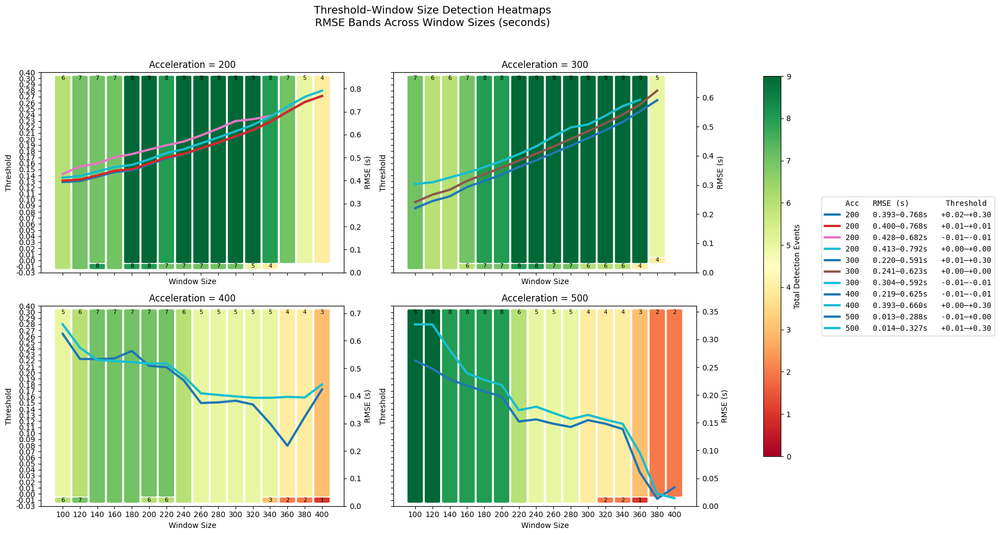

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.patches import FancyBboxPatch
from matplotlib.lines import Line2D
import matplotlib.cm as cm

# =========================
# PARAMETERS
# =========================
fs = 600
RMSE_EPS = 0.002
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# -------------------------
# RMSE
# -------------------------
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# -------------------------
# Detection counts (tiles)
# -------------------------
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# FIGURE SETUP
# =========================
accelerations = sorted(rmse_df["Acceleration"].unique())

fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ---- HEATMAP ----
    heatmap = sub.pivot(
        index="Threshold",
        columns="WindowSize",
        values="Total"
    ).fillna(0)

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    window_sizes = heatmap.columns.values

    ax.set_title(f"Acceleration = {acc}")
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")

    ax.set_xticks(np.arange(len(window_sizes)))
    ax.set_xticklabels(window_sizes)
    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    # ---- DRAW HEATMAP TILES ----
    for j, ws in enumerate(window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < len(col):
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]
            color = cmap((val - vmin) / (vmax - vmin))

            ax.add_patch(
                FancyBboxPatch(
                    (j - 0.45, i - 0.5),
                    0.9, height,
                    boxstyle="round,pad=0.02,rounding_size=0.18",
                    facecolor=color,
                    edgecolor="white",
                    linewidth=1.2
                )
            )

            ax.text(
                j, i - 0.5 + height - 0.05,
                f"{int(val)}",
                ha="center", va="top",
                fontsize=8,
                fontfamily="monospace"
            )

            i = k + 1

    # =========================
    # RMSE BANDS (RIGHT AXIS)
    # =========================
    mean_rmse = (
        rmse_sub
        .groupby("Threshold")["RMSE_seconds"]
        .mean()
        .sort_values()
    )

    bands, current = [], []
    for th, rmse in mean_rmse.items():
        if not current:
            current = [(th, rmse)]
        elif abs(rmse - current[-1][1]) <= RMSE_EPS:
            current.append((th, rmse))
        else:
            bands.append(current)
            current = [(th, rmse)]
    if current:
        bands.append(current)

    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (s)")
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)

    band_colors = cm.tab10(np.linspace(0, 1, len(bands)))

    for band, color in zip(bands, band_colors):
        ths = [x[0] for x in band]

        full = rmse_sub[rmse_sub["Threshold"].isin(ths)]
        rmse_min, rmse_max = full["RMSE_seconds"].min(), full["RMSE_seconds"].max()
        th_min, th_max = min(ths), max(ths)

        curve = (
            full.groupby("WindowSize")["RMSE_seconds"]
            .mean()
            .reindex(window_sizes)
        )

        ax_r.plot(
            np.arange(len(window_sizes)),
            curve,
            linewidth=3,
            color=color
        )

        legend_items.append(
            Line2D(
                [0], [0], color=color, lw=3,
                label=(
                    f"{acc:<6}"
                    f"{rmse_min:.3f}–{rmse_max:.3f}s   "
                    f"{th_min:+.2f}–{th_max:+.2f}"
                )
            )
        )

# =========================
# GLOBAL LEGEND & COLORBAR
# =========================
header = Line2D(
    [], [], color="none",
    label=f"{'Acc':<6}{'RMSE (s)':<16}{'Threshold'}"
)

fig.legend(
    handles=[header] + legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\n"
    "RMSE Bands Across Window Sizes (seconds)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


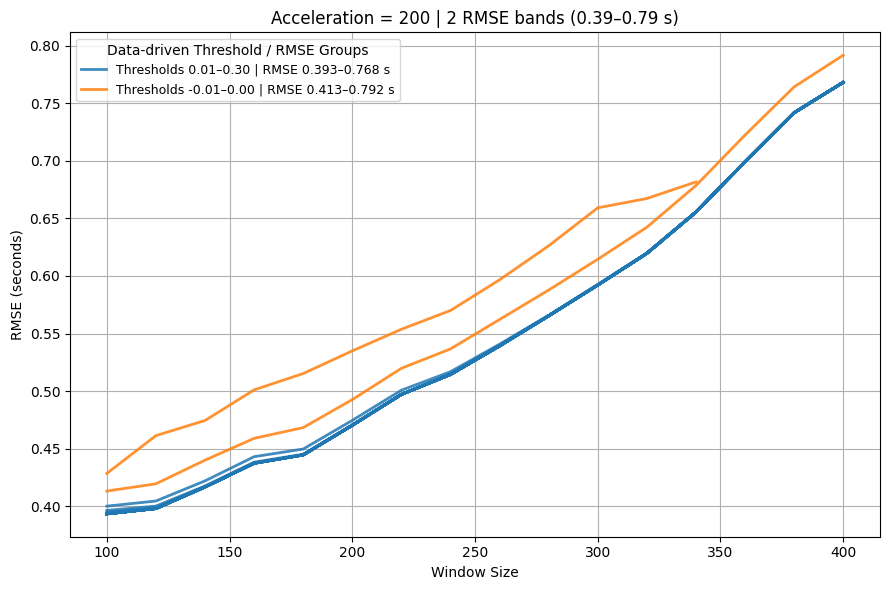

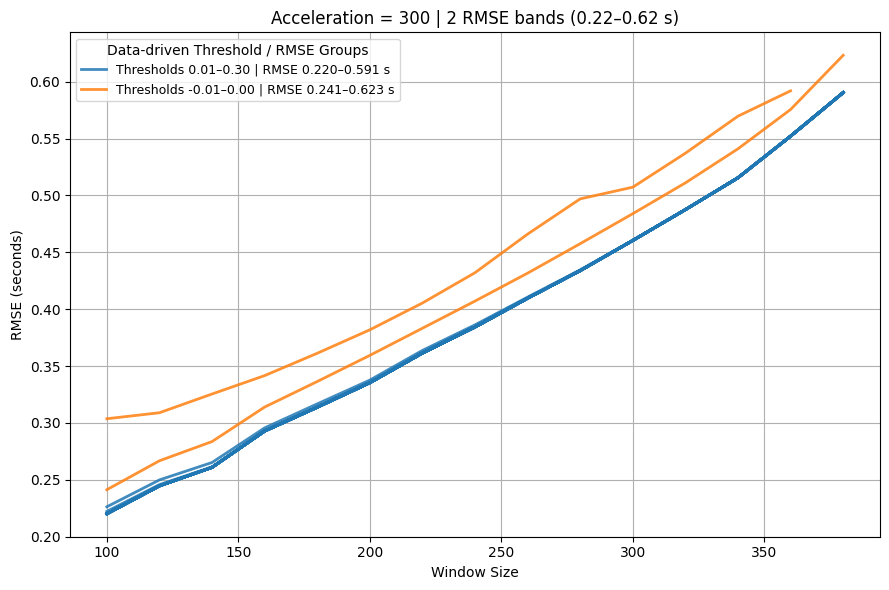

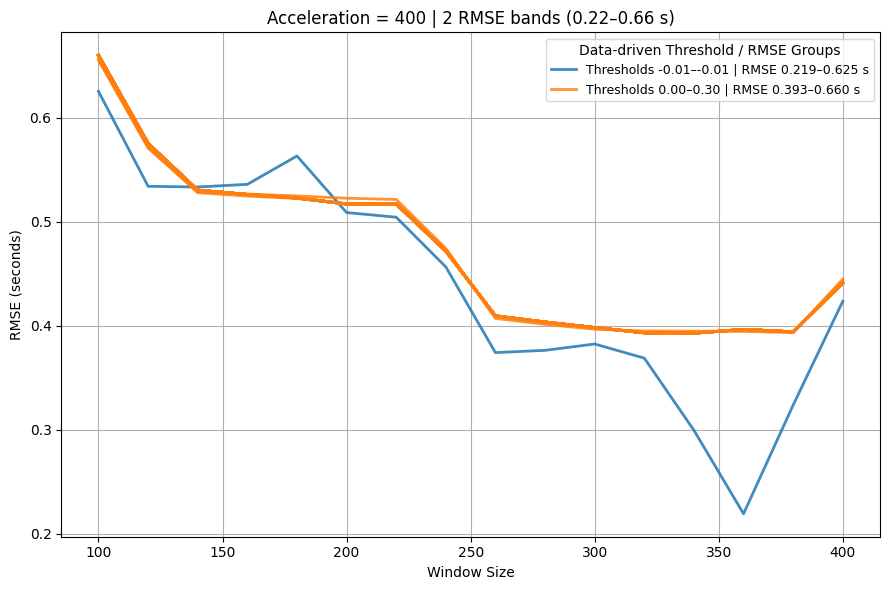

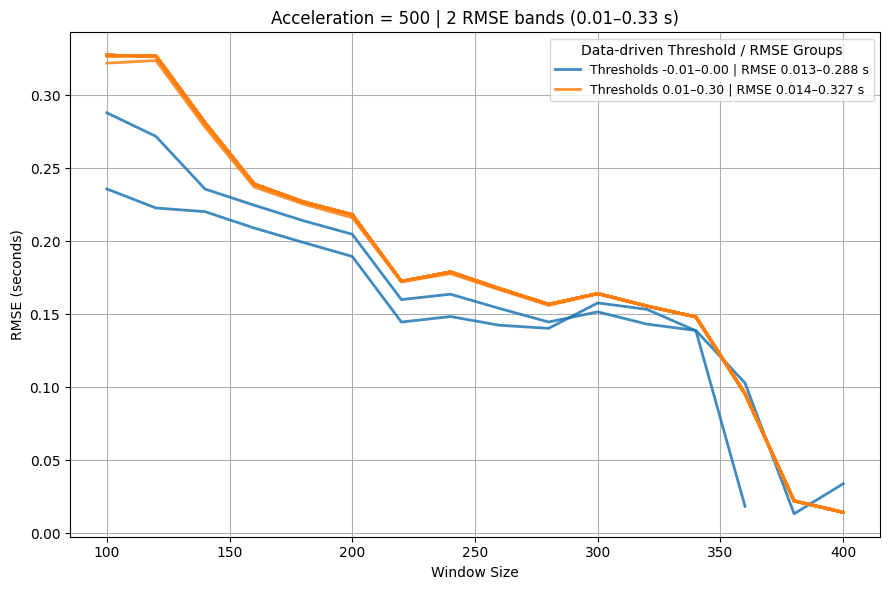

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

fs = 600  # sampling rate in Hz

# -------------------------
# Load data
# -------------------------
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# -------------------------
# RMSE computation
# -------------------------
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

accelerations = sorted(rmse_df["Acceleration"].unique())
colors = plt.cm.tab10.colors

# -------------------------
# Plot per acceleration
# -------------------------
for acc in accelerations:
    subset_acc = rmse_df[rmse_df["Acceleration"] == acc]

    # Median RMSE per threshold (for clustering only)
    th_median = (
        subset_acc
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values

    # Select 2 or 3 clusters using silhouette score
    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    # Final clustering
    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    # Order clusters by RMSE
    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    # Build cluster descriptors using FULL RMSE range
    groups = {}
    for c in sorted(th_median["Cluster"].unique()):
        thresholds = sorted(
            th_median[th_median["Cluster"] == c]["Threshold"]
        )
        full = subset_acc[subset_acc["Threshold"].isin(thresholds)]

        groups[c] = dict(
            th_min=min(thresholds),
            th_max=max(thresholds),
            rmse_min=full["RMSE_seconds"].min(),
            rmse_max=full["RMSE_seconds"].max(),
            thresholds=thresholds
        )

    # -------------------------
    # Plot
    # -------------------------
    plt.figure(figsize=(9, 6))
    used = set()

    for c, info in groups.items():
        for th in info["thresholds"]:
            curve = subset_acc[
                subset_acc["Threshold"] == th
            ].sort_values("WindowSize")

            label = None
            if c not in used:
                label = (
                    f"Thresholds {info['th_min']:.2f}–{info['th_max']:.2f} | "
                    f"RMSE {info['rmse_min']:.3f}–{info['rmse_max']:.3f} s"
                )
                used.add(c)

            plt.plot(
                curve["WindowSize"],
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85,
                label=label
            )

    # -------------------------
    # Title with RMSE summary
    # -------------------------
    rmse_lo = subset_acc["RMSE_seconds"].min()
    rmse_hi = subset_acc["RMSE_seconds"].max()

    plt.title(
        f"Acceleration = {acc} | "
        f"{best_k} RMSE bands ({rmse_lo:.2f}–{rmse_hi:.2f} s)"
    )

    plt.xlabel("Window Size")
    plt.ylabel("RMSE (seconds)")
    plt.legend(
        title="Data-driven Threshold / RMSE Groups",
        fontsize=9,
        title_fontsize=10
    )
    plt.grid(True)
    plt.tight_layout()
    plt.show()


/tmp/ipython-input-2579253207.py:266: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


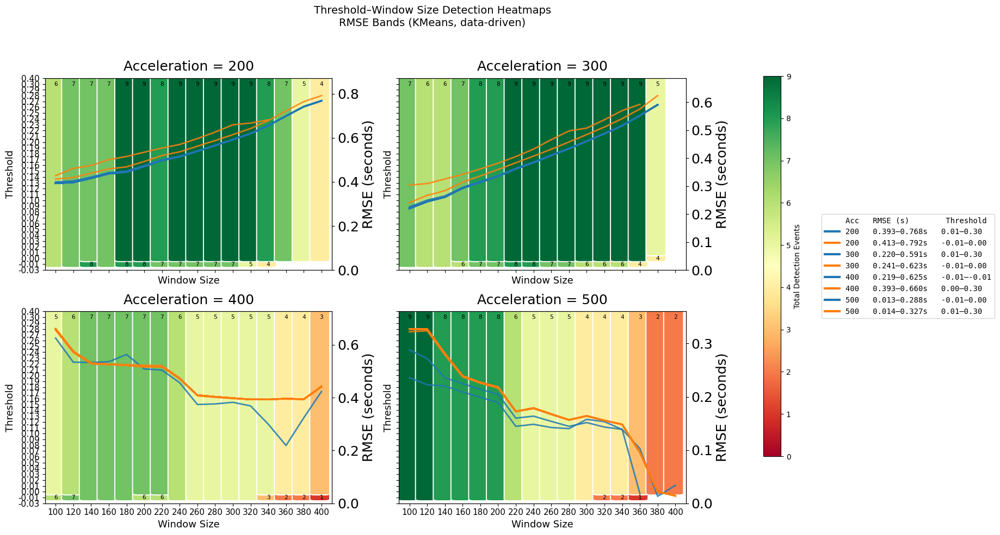

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D
import matplotlib.cm as cm

fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# Detection counts (tiles)
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(rmse_df["Acceleration"].unique())

# --- Define all unique window sizes from the entire dataset for consistency ---
all_unique_window_sizes = sorted(df_valid["WindowSize"].unique())

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # =========================
    # HEATMAP
    # =========================
    heatmap = sub.pivot(
        index="Threshold",
        columns="WindowSize",
        values="Total"
    ).reindex(columns=all_unique_window_sizes).fillna(0) # Reindex columns with all_unique_window_sizes

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    window_sizes = heatmap.columns.values # Now window_sizes will always be all_unique_window_sizes

    # thresholds = heatmap.index.values
    # window_sizes = heatmap.columns.values  # all unique window sizes

    # ------------------------
    # NEW: set x-axis limits to prevent tile overlap
    # ------------------------
    n_ws = len(window_sizes)
    padding = 0.1
    ax.set_xlim(-0.5 - padding, n_ws - 0.5 + padding)


    ax.set_title(f"Acceleration = {acc}",fontsize=18, pad=10)
    ax.set_xlabel("Window Size", fontsize=13)
    ax.set_ylabel("Threshold", fontsize=13)

    ax.set_xticks(np.arange(len(window_sizes)))
    ax.set_xticklabels(window_sizes)
    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.tick_params(axis="x", labelsize=11)
    ax.tick_params(axis="y", labelsize=11)


    # ---- DRAW TILES ----
    for j, ws in enumerate(window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < len(col):
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (j - 0.60, i - 0.5),
                    1.0, height* 1.22,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )

            ax.text(
                j, i - 0.5 + height - 0.05,
                f"{int(val)}",
                ha="center", va="top",
                fontsize=8, fontfamily="monospace"
            )

            i = k + 1

    # =========================
    # EXACT RMSE CLUSTERING LOGIC
    # =========================
    th_median = (
        rmse_sub
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    # ---- FULL RMSE RANGE PER CLUSTER ----
    groups = {}
    for c in sorted(th_median["Cluster"].unique()):
        ths = sorted(th_median[th_median["Cluster"] == c]["Threshold"])
        full = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        groups[c] = dict(
            th_min=min(ths),
            th_max=max(ths),
            rmse_min=full["RMSE_seconds"].min(),
            rmse_max=full["RMSE_seconds"].max(),
            thresholds=ths
        )

    # =========================
    # RMSE OVERLAY (RIGHT AXIS)
    # =========================
    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (seconds)",fontsize=18)
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.tick_params(axis="y", labelsize=18)


    colors = plt.cm.tab10.colors
    used = set()

    for c, info in groups.items():
        for th in info["thresholds"]:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
            )
            # Reindex to ensure consistent length with window_sizes for plotting
            curve_reindexed = curve.set_index('WindowSize')['RMSE_seconds'].reindex(window_sizes)

            ax_r.plot(
                np.arange(len(window_sizes)),
                curve_reindexed.values,
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)], lw=3,
                label=(
                    f"{acc:<6}"
                    f"{info['rmse_min']:.3f}–{info['rmse_max']:.3f}s   "
                    f"{info['th_min']:.2f}–{info['th_max']:.2f}"
                )
            )
        )

# =========================
# GLOBAL LEGEND & COLORBAR
# =========================
header = Line2D(
    [], [], color="none",
    label=f"{'Acc':<6}{'RMSE (s)':<16}{'Threshold'}"
)

fig.legend(
    handles=[header] + legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\n"
    "RMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()

/tmp/ipython-input-2385519463.py:265: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


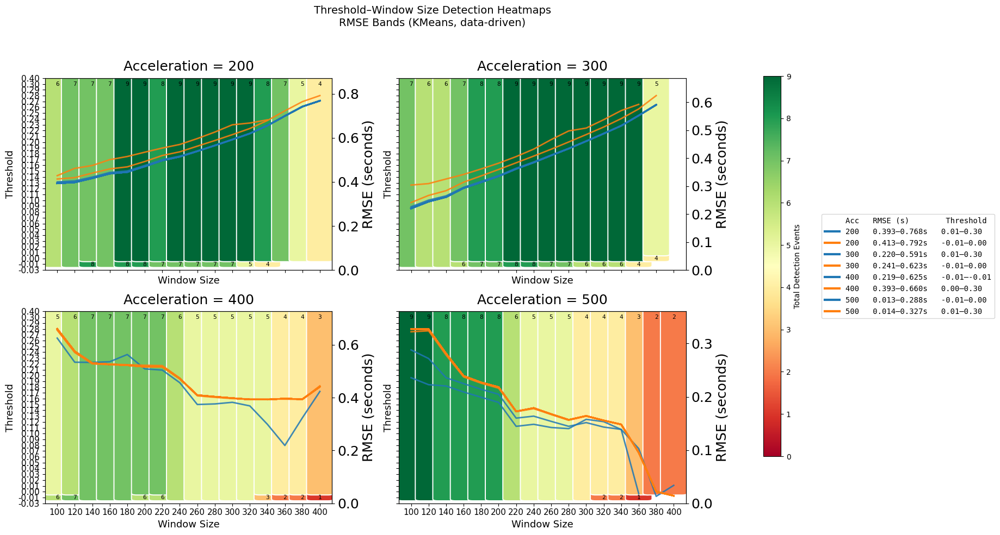

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D
import matplotlib.cm as cm

fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# Detection counts (tiles)
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(rmse_df["Acceleration"].unique())
all_unique_window_sizes = sorted(df_valid["WindowSize"].unique())

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# BEFORE the main loop
all_window_sizes = sorted(df_valid["WindowSize"].unique())
n_ws_max = len(all_window_sizes)
tile_width = 1.4  # or whatever width you want

# Then, inside your loop, instead of per-ax calculation, just do:
#ax.set_xlim(-tile_width / 2, n_ws_max - 1 + tile_width / 2)

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    # ---- FIXED x-axis scaling ----
    # The previous code for x-axis scaling was problematic and removed.
    # The standard x-axis scaling is applied later in AXES FORMATTING.

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ------------------------
    # HEATMAP
    # ------------------------
    heatmap = sub.pivot(
        index="Threshold",
        columns="WindowSize",
        values="Total"
    ).reindex(columns=all_unique_window_sizes).fillna(0)

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    window_sizes = heatmap.columns.values

    # ------------------------
    # DYNAMIC TILE WIDTH & X-LIMITS (using tile_width defined globally)
    # ------------------------
    ax.set_xlim(-tile_width / 2, len(window_sizes) - 1 + tile_width / 2)

    ax.set_title(f"Acceleration = {acc}", fontsize=18, pad=10)
    ax.set_xlabel("Window Size", fontsize=13)
    ax.set_ylabel("Threshold", fontsize=13)

    ax.set_xticks(np.arange(len(window_sizes)))
    ax.set_xticklabels(window_sizes)
    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.tick_params(axis="x", labelsize=11)
    ax.tick_params(axis="y", labelsize=11)

    # ------------------------
    # DRAW TILES
    # ------------------------
    for j, ws in enumerate(window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < len(col):
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (j - tile_width / 2, i - 0.5),  # center tile
                    tile_width,
                    height * 1.3,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )

            ax.text(
                j, i - 0.5 + height - 0.05,
                f"{int(val)}",
                ha="center", va="top",
                fontsize=8,
                fontfamily="monospace"
            )

            i = k + 1

    # ------------------------
    # RMSE CLUSTERING
    # ------------------------
    th_median = (
        rmse_sub
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values
    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_median["Cluster"] = th_median["Cluster"].map({c: i for i, c in enumerate(order)})

    # ------------------------
    # FULL RMSE RANGE PER CLUSTER
    # ------------------------
    groups = {}
    for c in sorted(th_median["Cluster"].unique()):
        ths = sorted(th_median[th_median["Cluster"] == c]["Threshold"])
        full = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        groups[c] = dict(
            th_min=min(ths),
            th_max=max(ths),
            rmse_min=full["RMSE_seconds"].min(),
            rmse_max=full["RMSE_seconds"].max(),
            thresholds=ths
        )

    # ------------------------
    # RMSE OVERLAY (RIGHT AXIS)
    # ------------------------
    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (seconds)", fontsize=18)
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors
    for c, info in groups.items():
        for th in info["thresholds"]:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
            )
            curve_reindexed = curve.set_index('WindowSize')['RMSE_seconds'].reindex(window_sizes)
            ax_r.plot(
                np.arange(len(window_sizes)),
                curve_reindexed.values,
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)], lw=3,
                label=(
                    f"{acc:<6}"
                    f"{info['rmse_min']:.3f}–{info['rmse_max']:.3f}s   "
                    f"{info['th_min']:.2f}–{info['th_max']:.2f}"
                )
            )
        )

# =========================
# GLOBAL LEGEND & COLORBAR
# =========================
header = Line2D([], [], color="none",
                label=f"{'Acc':<6}{'RMSE (s)':<16}{'Threshold'}")

fig.legend(
    handles=[header] + legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\n"
    "RMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()

/tmp/ipython-input-2067990588.py:279: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


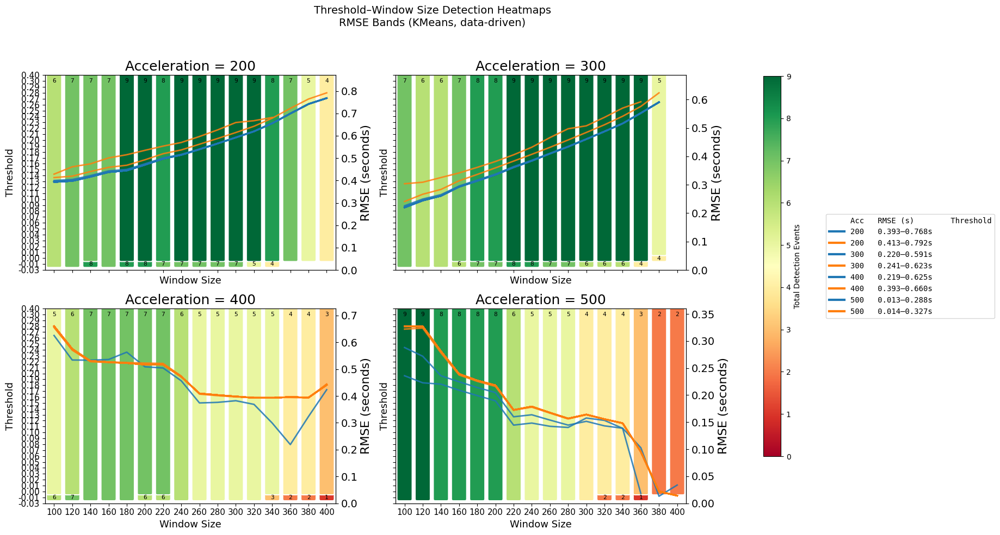

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# Detection counts (tiles)
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(rmse_df["Acceleration"].unique())
all_window_sizes = sorted(df_valid["WindowSize"].unique())
n_ws = len(all_window_sizes)

# =========================
# TILE GEOMETRY (KEY PART)
# =========================
tile_width  = 2.3     # visual width of tile
tile_stride = 2.9     # horizontal spacing between tile centers (MUST be > width)

x_positions = np.arange(n_ws) * tile_stride

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    # ----- Global x-axis geometry -----
    ax.set_xlim(
        -tile_stride / 2,
        (n_ws - 1) * tile_stride + tile_stride / 2
    )

    ax.set_xticks(x_positions)
    ax.set_xticklabels(all_window_sizes)

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ------------------------
    # HEATMAP DATA
    # ------------------------
    heatmap = sub.pivot(
        index="Threshold",
        columns="WindowSize",
        values="Total"
    ).reindex(columns=all_window_sizes).fillna(0)

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values

    ax.set_title(f"Acceleration = {acc}", fontsize=18)
    ax.set_xlabel("Window Size", fontsize=13)
    ax.set_ylabel("Threshold", fontsize=13)

    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.tick_params(axis="x", labelsize=11)
    ax.tick_params(axis="y", labelsize=11)

    # ------------------------
    # DRAW TILES
    # ------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0

        while i < len(col):
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - tile_width / 2, i - 0.5),
                    tile_width,
                    height * 1.3,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )

            ax.text(
                x_positions[j],
                i - 0.5 + height - 0.05,
                f"{int(val)}",
                ha="center", va="top",
                fontsize=8,
                fontfamily="monospace"
            )

            i = k + 1

    # ------------------------
    # RMSE CLUSTERING
    # ------------------------
    th_median = (
        rmse_sub
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values
    best_k, best_score = None, -1

    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    # ------------------------
    # RMSE OVERLAY
    # ------------------------
    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (seconds)", fontsize=16)
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.tick_params(axis="y", labelsize=14)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)], lw=3,
                label=f"{acc:<6}"
                      f"{curve['RMSE_seconds'].min():.3f}–"
                      f"{curve['RMSE_seconds'].max():.3f}s"
            )
        )

# # =========================
# # LEGEND & COLORBAR
# # =========================
# fig.legend(
#     handles=legend_items,
#     loc="center right",
#     bbox_to_anchor=(1.15, 0.5),
#     fontsize=8,
#     prop={"family": "monospace"}
# )

# sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
# sm.set_array([])

# cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
# fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

# plt.suptitle(
#     "Threshold–Window Size Detection Heatmaps\n"
#     "RMSE Bands (KMeans, data-driven)",
#     fontsize=14
# )

# plt.tight_layout(rect=[0, 0, 0.85, 0.95])
# plt.show()
# ------------------------
# RMSE OVERLAY + LEGEND DATA
# ------------------------
ax_r = ax.twinx()
ax_r.set_ylabel("RMSE (seconds)", fontsize=16)
ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
ax_r.tick_params(axis="y", labelsize=14)

colors = plt.cm.tab10.colors

for c in sorted(th_median["Cluster"].unique()):

    # ---- thresholds in this cluster ----
    ths = sorted(th_median[th_median["Cluster"] == c]["Threshold"])

    cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

    rmse_min = cluster_data["RMSE_seconds"].min()
    rmse_max = cluster_data["RMSE_seconds"].max()

    th_min = min(ths)
    th_max = max(ths)

    # ---- plot all curves in cluster ----
    for th in ths:
        curve = (
            rmse_sub[rmse_sub["Threshold"] == th]
            .sort_values("WindowSize")
            .set_index("WindowSize")
            .reindex(all_window_sizes)
        )

        ax_r.plot(
            x_positions,
            curve["RMSE_seconds"],
            color=colors[c % len(colors)],
            linewidth=2,
            alpha=0.85
        )

    # ---- ONE legend entry per cluster ----
    legend_items.append(
        Line2D(
            [0], [0],
            color=colors[c % len(colors)],
            lw=3,
            label=(
                f"{acc:<6}"
                f"{rmse_min:.3f}–{rmse_max:.3f}s   "
                f"{th_min:.2f}–{th_max:.2f}"
            )
        )
    )


/tmp/ipython-input-511416342.py:285: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


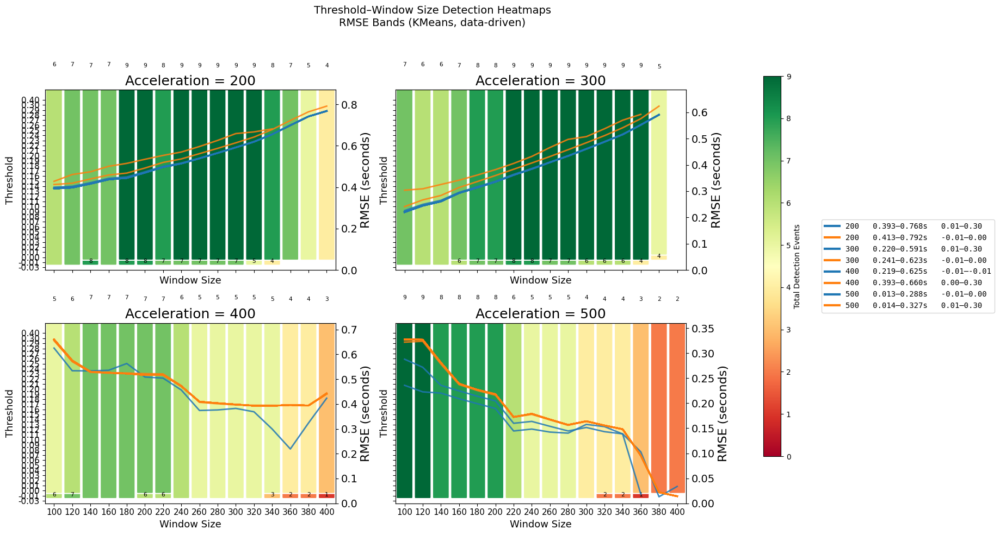

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(rmse_df["Acceleration"].unique())
all_window_sizes = sorted(df_valid["WindowSize"].unique())
n_ws = len(all_window_sizes)

# =========================
# TILE GEOMETRY
# =========================
tile_width = 5.3
tile_stride = 5.9
tile_height_scale = 2.5   # controls vertical growth
x_positions = np.arange(n_ws) * tile_stride

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

legend_items = []  # <-- FIX: collected once, globally

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    # ----- Global x-axis -----
    ax.set_xlim(
        -tile_stride / 2,
        (n_ws - 1) * tile_stride + tile_stride / 2
    )
    ax.set_xticks(x_positions)
    ax.set_xticklabels(all_window_sizes)

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ------------------------
    # HEATMAP DATA
    # ------------------------
    heatmap = sub.pivot(
        index="Threshold",
        columns="WindowSize",
        values="Total"
    ).reindex(columns=all_window_sizes).fillna(0)

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values

    ax.set_title(f"Acceleration = {acc}", fontsize=18)
    ax.set_xlabel("Window Size", fontsize=13)
    ax.set_ylabel("Threshold", fontsize=13)

    ax.set_yticks(np.arange(len(thresholds)))
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.tick_params(axis="x", labelsize=11)
    ax.tick_params(axis="y", labelsize=11)
    ax.set_ylim(-0.5, len(thresholds) - 0.5 + (tile_height_scale - 1))


    # ------------------------
    # DRAW TILES
    # ------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0

        while i < len(col):
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]


            # ax.add_patch(
            #     FancyBboxPatch(
            #         (x_positions[j] - tile_width / 2, i - 0.7),
            #         tile_width,
            #         height * 5.9,
            #         boxstyle="round,pad=0.06,rounding_size=0.29",
            #         facecolor=cmap((val - vmin) / (vmax - vmin)),
            #         edgecolor="white",
            #         linewidth=1.4
            #     )
            # )

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - tile_width / 2, i - 0.5),
                    tile_width,
                    height * tile_height_scale,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                    )
             )


            ax.text(
                x_positions[j],
                #i - 0.5 + height - 0.05,
                 i - 0.5 + (height * tile_height_scale) / 2,

                f"{int(val)}",
                ha="center", va="top",
                # ha="center", va="center"

                fontsize=8,
                fontfamily="monospace"
            )


            i = k + 1

    # ------------------------
    # RMSE CLUSTERING
    # ------------------------
    th_median = (
        rmse_sub
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values
    best_k, best_score = None, -1

    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    # ------------------------
    # RMSE OVERLAY
    # ------------------------
    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (seconds)", fontsize=16)
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.tick_params(axis="y", labelsize=14)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = sorted(th_median[th_median["Cluster"] == c]["Threshold"])
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        rmse_min = cluster_data["RMSE_seconds"].min()
        rmse_max = cluster_data["RMSE_seconds"].max()

        th_min = min(ths)
        th_max = max(ths)

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85
            )

        # ---- ONE LEGEND ENTRY PER CLUSTER ----
        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=(
                    f"{acc:<6}"
                    f"{rmse_min:.3f}–{rmse_max:.3f}s   "
                    f"{th_min:.2f}–{th_max:.2f}"
                )
            )
        )

# =========================
# LEGEND & COLORBAR
# =========================
fig.legend(
    handles=legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\n"
    "RMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


/tmp/ipython-input-4124515375.py:257: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


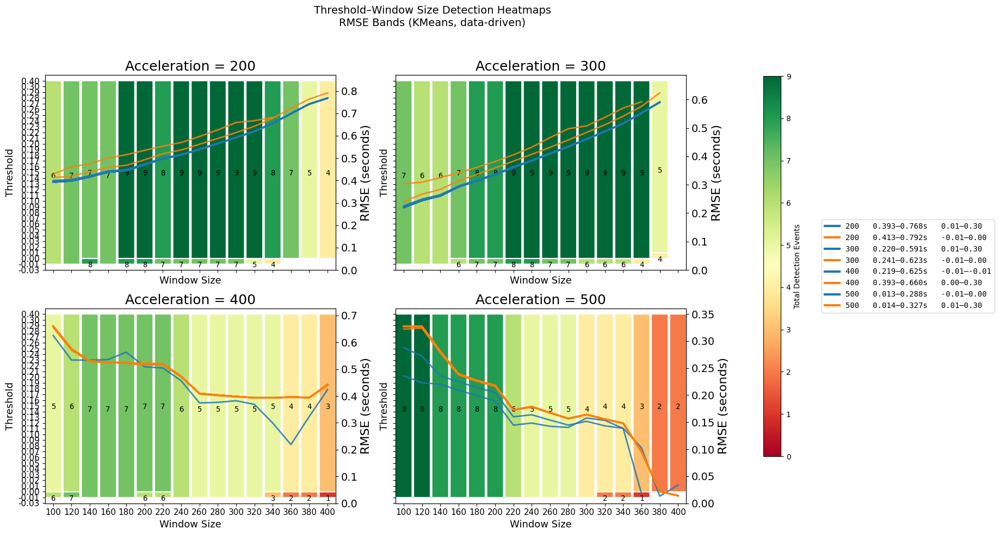

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(rmse_df["Acceleration"].unique())
all_window_sizes = sorted(df_valid["WindowSize"].unique())
n_ws = len(all_window_sizes)

# =========================
# TILE GEOMETRY
# =========================
tile_width = 5.3       # horizontal width of each tile
tile_stride = 5.9      # horizontal spacing between tiles
tile_height_scale = 20.5  # vertical scaling of tiles
x_positions = np.arange(n_ws) * tile_stride

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

legend_items = []  # collect legend items globally

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ------------------------
    # HEATMAP DATA
    # ------------------------
    heatmap = sub.pivot(
        index="Threshold",
        columns="WindowSize",
        values="Total"
    ).reindex(columns=all_window_sizes).fillna(0)

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values

    # ------------------------
    # SCALE AXES
    # ------------------------
    ax.set_xlim(-tile_width / 2, (n_ws - 1) * tile_stride + tile_width / 2)
    ax.set_ylim(-0.5, len(thresholds) * tile_height_scale - 0.5)
    ax.set_yticks(np.arange(len(thresholds)) * tile_height_scale)
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.set_xticks(x_positions)
    ax.set_xticklabels(all_window_sizes)

    ax.set_title(f"Acceleration = {acc}", fontsize=18)
    ax.set_xlabel("Window Size", fontsize=13)
    ax.set_ylabel("Threshold", fontsize=13)
    ax.tick_params(axis="x", labelsize=11)
    ax.tick_params(axis="y", labelsize=11)

    # ------------------------
    # DRAW TILES
    # ------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < len(col):
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]

            # draw tile
            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - tile_width / 2, i * tile_height_scale),
                    tile_width,
                    height * tile_height_scale,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )


            # number inside tile
            ax.text(
                x_positions[j],
                # i - 0.5 + height - 0.05,
                i * tile_height_scale + (height * tile_height_scale) / 2,
                f"{int(val)}",
                ha="center", va="top",
                fontsize=10, fontfamily="monospace"
            )

            i = k + 1

    # ------------------------
    # RMSE CLUSTERING
    # ------------------------
    th_median = (
        rmse_sub
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values
    best_k, best_score = None, -1

    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_median["Cluster"] = th_median["Cluster"].map({c: i for i, c in enumerate(order)})

    # ------------------------
    # RMSE OVERLAY
    # ------------------------
    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (seconds)", fontsize=16)
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.tick_params(axis="y", labelsize=14)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = sorted(th_median[th_median["Cluster"] == c]["Threshold"])
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        rmse_min = cluster_data["RMSE_seconds"].min()
        rmse_max = cluster_data["RMSE_seconds"].max()
        th_min = min(ths)
        th_max = max(ths)

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=(
                    f"{acc:<6}"
                    f"{rmse_min:.3f}–{rmse_max:.3f}s   "
                    f"{th_min:.2f}–{th_max:.2f}"
                )
            )
        )

# =========================
# LEGEND & COLORBAR
# =========================
fig.legend(
    handles=legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


/tmp/ipython-input-1347376705.py:283: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


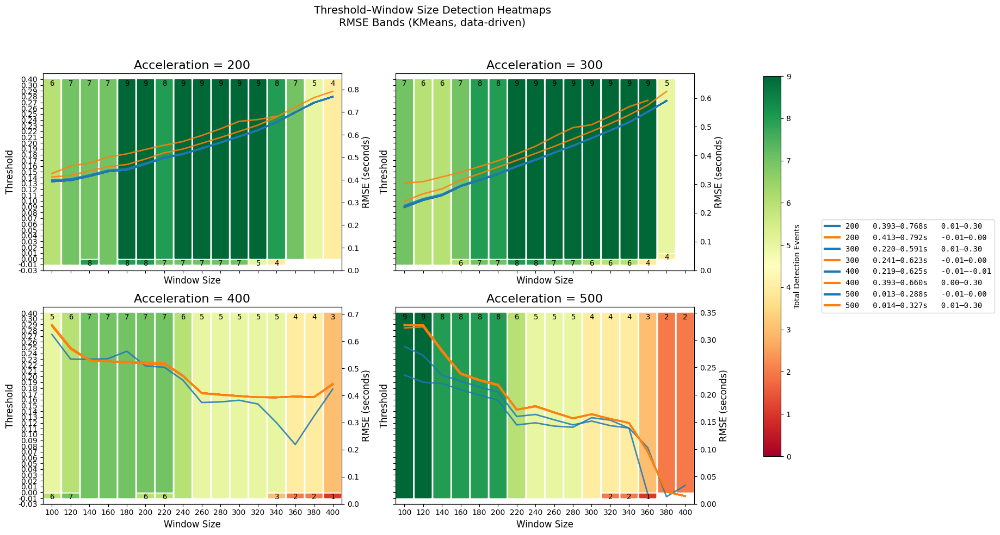

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
n_ws = len(all_window_sizes)

# =========================
# TILE GEOMETRY (MASTER CONTROLS)
# =========================
tile_width = 15.3
tile_stride = tile_width + 0.6       # axis spacing follows width
tile_height_scale = 0.5             # axis spacing follows height
text_padding = 0.12 * tile_height_scale

x_positions = np.arange(n_ws) * tile_stride

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ------------------------
    # HEATMAP DATA
    # ------------------------
    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    padded_thresholds = np.sort(
        np.unique([padding_min, *heatmap.index.values, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)
    thresholds = heatmap.index.values

    # ------------------------
    # AXIS SCALING (AUTO)
    # ------------------------
    y_positions = np.arange(len(thresholds)) * tile_height_scale

    ax.set_xlim(
        -tile_width / 2,
        x_positions[-1] + tile_width / 2
    )

    ax.set_ylim(
        0,
        len(thresholds) * tile_height_scale
    )

    ax.set_xticks(x_positions)
    ax.set_xticklabels(all_window_sizes)

    ax.set_yticks(y_positions)
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.set_title(f"Acceleration = {acc}", fontsize=16)
    ax.set_xlabel("Window Size", fontsize=12)
    ax.set_ylabel("Threshold", fontsize=12)

    ax.tick_params(axis="x", labelsize=10)
    ax.tick_params(axis="y", labelsize=10)

    # ------------------------
    # DRAW TILES
    # ------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0

        while i < len(col):
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < len(col) and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]

            tile_bottom = i * tile_height_scale
            tile_height = height * tile_height_scale
            tile_top = tile_bottom + tile_height

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - tile_width / 2, tile_bottom),
                    tile_width,
                    tile_height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )

            # ------------------------
            # VALUE LABEL (TOP-ALIGNED)
            # ------------------------
            if tile_height > 0.6 * tile_height_scale:
                ax.text(
                    x_positions[j],
                    tile_top - text_padding,
                    f"{int(val)}",
                    ha="center",
                    va="top",
                    fontsize=10,
                    fontfamily="monospace",
                    color="black"
                )

            i = k + 1

    # ------------------------
    # RMSE CLUSTERING
    # ------------------------
    th_median = (
        rmse_sub
        .groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )

    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    # ------------------------
    # RMSE OVERLAY
    # ------------------------
    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (seconds)", fontsize=12)
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.tick_params(axis="y", labelsize=10)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = sorted(th_median[th_median["Cluster"] == c]["Threshold"])
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        rmse_min = cluster_data["RMSE_seconds"].min()
        rmse_max = cluster_data["RMSE_seconds"].max()
        th_min, th_max = min(ths), max(ths)

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=(
                    f"{acc:<6}"
                    f"{rmse_min:.3f}–{rmse_max:.3f}s   "
                    f"{th_min:.2f}–{th_max:.2f}"
                )
            )
        )

# =========================
# LEGEND & COLORBAR
# =========================
fig.legend(
    handles=legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


/tmp/ipython-input-4028974853.py:167: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


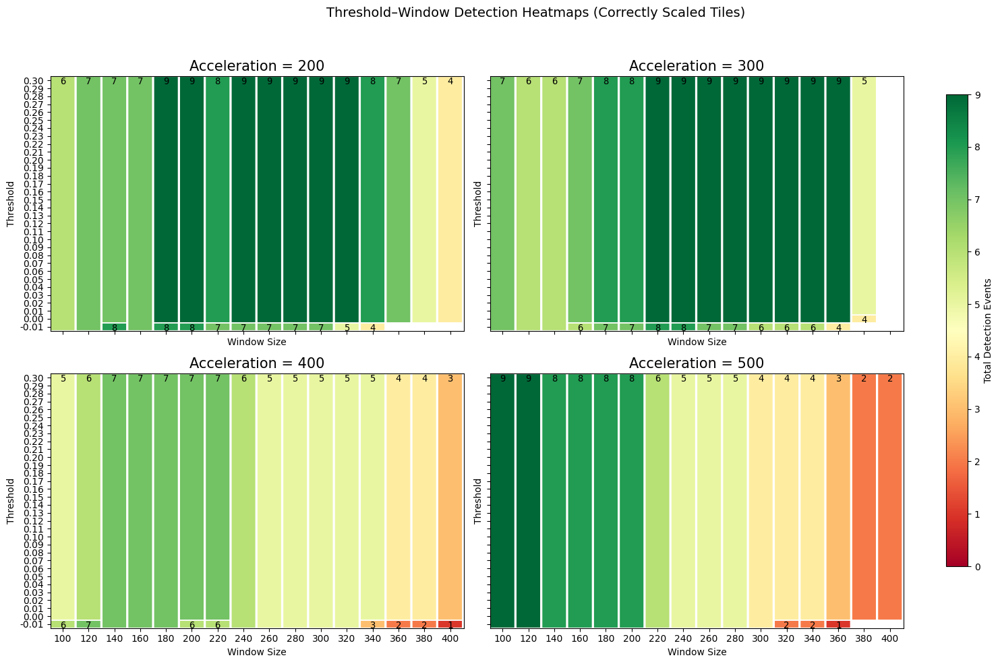

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE GEOMETRY (TRUE SCALING)
# =========================
tile_width = 2.5
tile_height = 5.3
tile_gap = 0.15

fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df["Frame_Error"] = df["Sensor_DetectedFrame"] - df["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(summary_df["Acceleration"].unique())
window_sizes = sorted(summary_df["WindowSize"].unique())

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=window_sizes)
        .fillna(0)
    )

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    n_cols = len(window_sizes)

    # ------------------------
    # AXIS SCALING (DATA-DRIVEN)
    # ------------------------
    ax.set_xlim(0, n_cols * (tile_width + tile_gap))
    ax.set_ylim(0, n_rows * tile_height)

    ax.set_xticks(
        np.arange(n_cols) * (tile_width + tile_gap) + tile_width / 2
    )
    ax.set_xticklabels(window_sizes)

    ax.set_yticks(
        np.arange(n_rows) * tile_height + tile_height / 2
    )
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.set_title(f"Acceleration = {acc}", fontsize=15)
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")

    # ------------------------
    # DRAW TILES
    # ------------------------
    for j, ws in enumerate(window_sizes):
        col = heatmap[ws].values
        i = 0

        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]

            x0 = j * (tile_width + tile_gap)
            y0 = i * tile_height
            h = height * tile_height

            ax.add_patch(
                FancyBboxPatch(
                    (x0, y0),
                    tile_width,
                    h,
                    boxstyle="round,pad=0.02",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.2
                )
            )

            # ------------------------
            # TOP-ALIGNED LABEL
            # ------------------------
            if h >= tile_height:
                ax.text(
                    x0 + tile_width / 2,
                    y0 + h - 0.08 * tile_height,
                    f"{int(val)}",
                    ha="center",
                    va="top",
                    fontsize=10,
                    fontfamily="monospace"
                )

            i = k + 1

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Detection Heatmaps (Correctly Scaled Tiles)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


/tmp/ipython-input-589501661.py:210: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


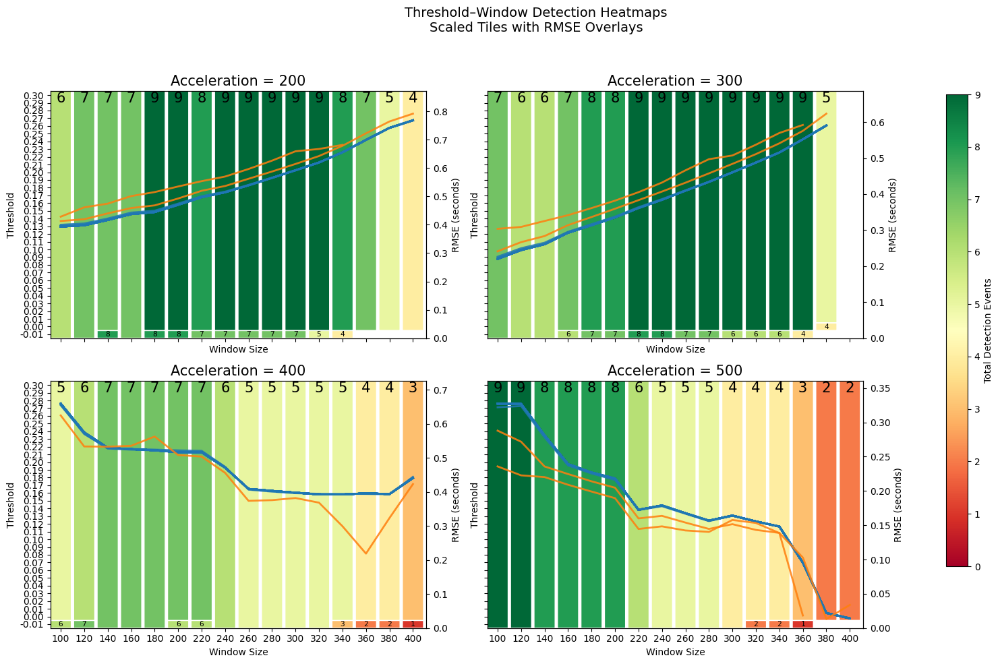

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE GEOMETRY (TRUE SCALING)
# =========================
tile_width = 1.0
tile_height = 1.8          # master vertical scaling
tile_gap = 0.15

fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df["Frame_Error"] = df["Sensor_DetectedFrame"] - df["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(summary_df["Acceleration"].unique())
window_sizes = sorted(summary_df["WindowSize"].unique())

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=window_sizes)
        .fillna(0)
    )

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    n_cols = len(window_sizes)

    # ------------------------
    # AXIS SCALING (DATA UNITS)
    # ------------------------
    ax.set_xlim(0, n_cols * (tile_width + tile_gap))
    ax.set_ylim(0, n_rows * tile_height)

    ax.set_xticks(
        np.arange(n_cols) * (tile_width + tile_gap) + tile_width / 2
    )
    ax.set_xticklabels(window_sizes)

    ax.set_yticks(
        np.arange(n_rows) * tile_height + tile_height / 2
    )
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.set_title(f"Acceleration = {acc}", fontsize=15)
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")

    # ------------------------
    # DRAW TILES + SCALED TEXT
    # ------------------------
    for j, ws in enumerate(window_sizes):
        col = heatmap[ws].values
        i = 0

        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]

            x0 = j * (tile_width + tile_gap)
            y0 = i * tile_height
            h = height * tile_height

            ax.add_patch(
                FancyBboxPatch(
                    (x0, y0),
                    tile_width,
                    h,
                    boxstyle="round,pad=0.02",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.2
                )
            )

            # ------------------------
            # FONT SIZE SCALES WITH TILE HEIGHT
            # ------------------------
            fontsize = np.clip(0.35 * h, 8, 16)

            ax.text(
                x0 + tile_width / 2,
                y0 + h - 0.08 * tile_height,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=fontsize,
                fontfamily="monospace"
            )

            i = k + 1

    # =========================
    # RMSE OVERLAY (SAFE)
    # =========================
    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (seconds)")
    ax_r.tick_params(axis="y", labelsize=10)

    th_median = (
        rmse_sub.groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values
    if len(X) >= 2:
        kmeans = KMeans(n_clusters=2, n_init=20, random_state=0)
        th_median["Cluster"] = kmeans.fit_predict(X)
    else:
        th_median["Cluster"] = 0

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
                .set_index("WindowSize")
                .reindex(window_sizes)
            )

            ax_r.plot(
                np.arange(n_cols) * (tile_width + tile_gap) + tile_width / 2,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85
            )

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Detection Heatmaps\nScaled Tiles with RMSE Overlays",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


/tmp/ipython-input-2433230479.py:281: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


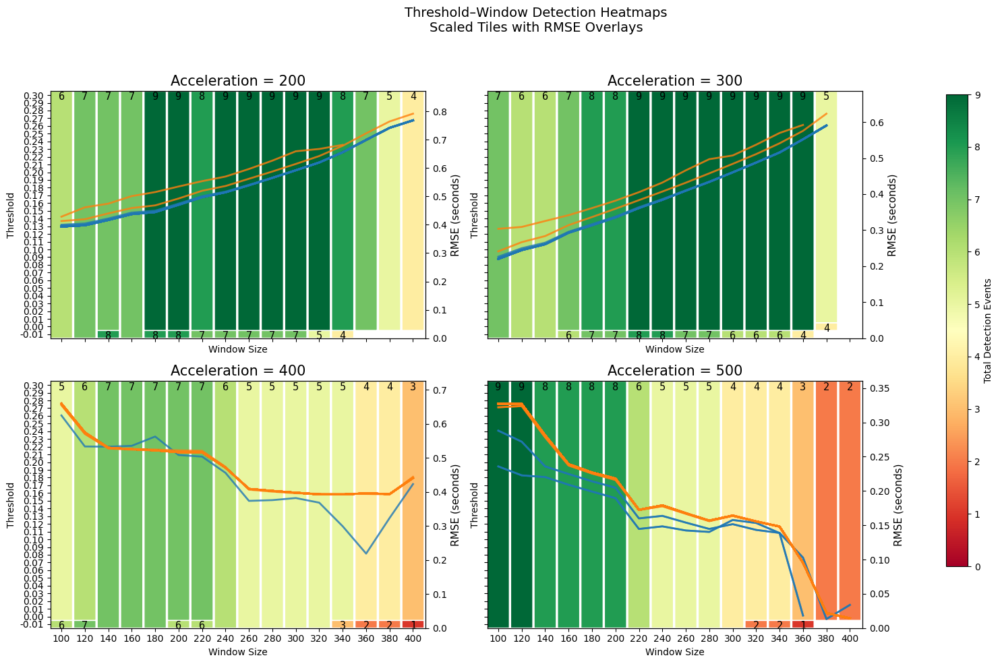

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE GEOMETRY (TRUE SCALING)
# =========================
tile_width = 2.0
tile_height = 5.8        # increase → taller tiles
tile_gap = 0.15

# ------------------------
# TEXT CONTROL (independent)
# ------------------------
TEXT_SIZE = 11          # base font size for all tiles
TEXT_MAX_SIZE = 18      # optional cap if you want scaling
TEXT_TOP_PADDING_FRAC = 0.10  # distance from top of tile

fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df["Frame_Error"] = df["Sensor_DetectedFrame"] - df["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(summary_df["Acceleration"].unique())
window_sizes = sorted(summary_df["WindowSize"].unique())

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=window_sizes)
        .fillna(0)
    )

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    n_cols = len(window_sizes)

    # ------------------------
    # AXIS SCALING (DATA-DRIVEN)
    # ------------------------
    ax.set_xlim(0, n_cols * (tile_width + tile_gap))
    ax.set_ylim(0, n_rows * tile_height)

    x_centers = np.arange(n_cols) * (tile_width + tile_gap) + tile_width / 2
    y_centers = np.arange(n_rows) * tile_height + tile_height / 2

    ax.set_xticks(x_centers)
    ax.set_xticklabels(window_sizes)

    ax.set_yticks(y_centers)
    ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    ax.set_title(f"Acceleration = {acc}", fontsize=15)
    ax.set_xlabel("Window Size")
    ax.set_ylabel("Threshold")

    # ------------------------
    # DRAW TILES
    # ------------------------
    for j, ws in enumerate(window_sizes):
        col = heatmap[ws].values
        i = 0

        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = k - i + 1
            val = col[i]

            x0 = j * (tile_width + tile_gap)
            y0 = i * tile_height
            h = height * tile_height

            ax.add_patch(
                FancyBboxPatch(
                    (x0, y0),
                    tile_width,
                    h,
                    boxstyle="round,pad=0.02",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.2
                )
            )

            # ------------------------
            # FONT SIZE SCALES WITH TILE HEIGHT
            # ------------------------
            if h >= tile_height:
              # independent text size
              font_size = TEXT_SIZE

              ax.text(
                  x0 + tile_width / 2,
                  y0 + h - TEXT_TOP_PADDING_FRAC * tile_height,
                  f"{int(val)}",
                  ha="center",
                  va="top",
                  fontsize=font_size,
                  fontfamily="monospace",
                  color="black"
                )

                # font_size = np.clip(0.38 * h * 6, 8, 14)

                # ax.text(
                #     x0 + tile_width / 2,
                #     y0 + h - 0.10 * tile_height,
                #     f"{int(val)}",
                #     ha="center",
                #     va="top",
                #     fontsize=font_size,
                #     fontfamily="monospace",
                #     color="black"
                # )


            i = k + 1

    # ------------------------
    # RMSE OVERLAY (SAFE)
    # ------------------------
    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (seconds)", fontsize=11)
    ax_r.tick_params(axis="y", labelsize=10)

    th_median = (
        rmse_sub.groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )

    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
                .set_index("WindowSize")
                .reindex(window_sizes)
            )

            ax_r.plot(
                x_centers,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.8
            )

            rmse_legend_items = []

for c in sorted(th_median["Cluster"].unique()):
    ths = th_median[th_median["Cluster"] == c]["Threshold"]

    for th in ths:
        curve = (
            rmse_sub[rmse_sub["Threshold"] == th]
            .sort_values("WindowSize")
            .set_index("WindowSize")
            .reindex(window_sizes)
        )

        ax_r.plot(
            x_centers,
            curve["RMSE_seconds"],
            color=colors[c % len(colors)],
            linewidth=2,
            alpha=0.8
        )

    # Add one legend handle per cluster per acceleration
    rmse_legend_items.append(
        Line2D(
            [0], [0],
            color=colors[c % len(colors)],
            lw=3,
            label=f"{acc} cluster {c}"
        )
    )


# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])

cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Detection Heatmaps\nScaled Tiles with RMSE Overlays",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()

fig.legend(
    handles=rmse_legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.55),
    fontsize=10,
    title="RMSE clusters",
    prop={"family": "monospace"}
)



/tmp/ipython-input-932594219.py:263: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


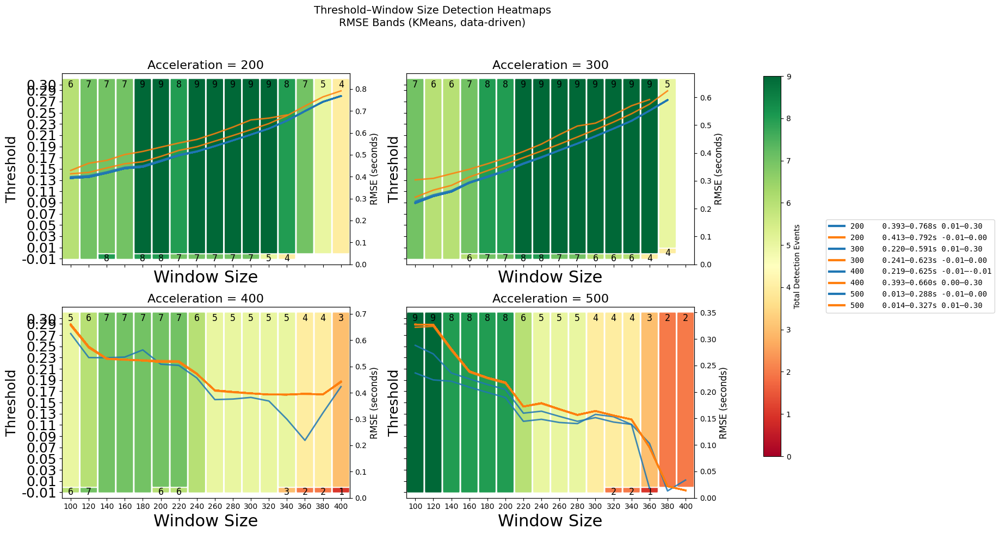

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 15.0          # width of each tile
TILE_HEIGHT = 0.5          # height unit for one row
TILE_GAP = 0.6             # horizontal spacing between tiles

TEXT_SIZE = 12             # font size of numbers on tiles
TEXT_COLOR = "black"
TEXT_PADDING_FRAC = 0.1    # fraction of tile height from top

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.03, 0.40

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
n_ws = len(all_window_sizes)

# X positions for tiles
x_positions = np.arange(n_ws) * (TILE_WIDTH + TILE_GAP)

# =========================
# FIGURE SETUP
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # ------------------------
    # HEATMAP DATA
    # ------------------------
    heatmap = sub.pivot(index="Threshold", columns="WindowSize", values="Total").reindex(columns=all_window_sizes).fillna(0)
    padded_thresholds = np.sort(np.unique([padding_min, *heatmap.index.values, padding_max]))
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)
    thresholds = heatmap.index.values
    n_rows = len(thresholds)

    # ------------------------
    # AXIS SCALING
    # ------------------------
    y_positions = np.arange(n_rows) * TILE_HEIGHT
    ax.set_xlim(-TILE_WIDTH / 2, x_positions[-1] + TILE_WIDTH / 2)
    ax.set_ylim(0, n_rows * TILE_HEIGHT)
    # extra space for top/bottom to accommodate text
    # top_bottom_padding = 1.2 * TEXT_SIZE / 72  # rough conversion from points to axis units

    # y_min = thresholds[0] - top_bottom_padding
    # y_max = thresholds[-1] + top_bottom_padding

    # ax.set_ylim(y_min, y_max)

    ax.set_xticks(x_positions)
    ax.set_xticklabels(all_window_sizes)
    # ax.set_yticks(y_positions)
    # ax.set_yticklabels([f"{t:.2f}" for t in thresholds])

    # Example: manually choose which thresholds to show on Y-axis
    manual_threshold_labels = [-0.01, 0.01, 0.03, 0.05, 0.07, 0.09, 0.11,0.13,0.15,0.17,0.19,0.21,0.23,0.25,0.27,0.29,0.30]
    # manual_threshold_labels = [thresholds[0], 0.01, 0.03, 0.05, 0.07, 0.09, 0.11, 0.13, 0.15, 0.17, 0.19, 0.21, 0.23, 0.25, 0.27, thresholds[-1]]



    # Find the corresponding positions on the axis
    y_ticks_manual = [y_positions[np.where(thresholds == t)[0][0]] for t in manual_threshold_labels]
    # y_ticks_manual = np.interp(manual_threshold_labels, thresholds, y_positions)


    # Set Y-axis ticks and labels
    ax.set_yticks(y_ticks_manual)
    ax.set_yticklabels([f"{t:.2f}" for t in manual_threshold_labels])



    ax.set_title(f"Acceleration = {acc}", fontsize=16)
    ax.set_xlabel("Window Size", fontsize=22)
    ax.set_ylabel("Threshold", fontsize=18)
    ax.tick_params(axis="x", labelsize=10)
    ax.tick_params(axis="y", labelsize=18)

    # ------------------------
    # DRAW TILES & TEXT
    # ------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue

            # find contiguous block
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1
            height = k - i + 1
            val = col[i]

            # tile geometry
            tile_bottom = i * TILE_HEIGHT
            tile_height = height * TILE_HEIGHT
            tile_top = tile_bottom + tile_height

            # draw tile
            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, tile_bottom),
                    TILE_WIDTH,
                    tile_height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )

            # draw number on tile (independent control)
            ax.text(
                x_positions[j],
                tile_top - TEXT_PADDING_FRAC * TILE_HEIGHT,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )

            i = k + 1

    # ------------------------
    # RMSE CLUSTERING
    # ------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values
    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k: continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score
    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)
    order = th_median.groupby("Cluster")["RMSE_seconds"].mean().sort_values().index
    th_median["Cluster"] = th_median["Cluster"].map({c: i for i, c in enumerate(order)})

    # ------------------------
    # RMSE OVERLAY
    # ------------------------
    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (seconds)", fontsize=12)
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.tick_params(axis="y", labelsize=10)

    colors = plt.cm.tab10.colors
    for c in sorted(th_median["Cluster"].unique()):
        ths = sorted(th_median[th_median["Cluster"] == c]["Threshold"])
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]
        rmse_min = cluster_data["RMSE_seconds"].min()
        rmse_max = cluster_data["RMSE_seconds"].max()
        th_min, th_max = min(ths), max(ths)

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .sort_values("WindowSize")
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2,
                alpha=0.85
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=f"{acc:<6} {rmse_min:.3f}–{rmse_max:.3f}s {th_min:.2f}–{th_max:.2f}"
            )
        )

# =========================
# COLORBAR & LEGEND
# =========================
fig.legend(
    handles=legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


/tmp/ipython-input-779231881.py:309: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


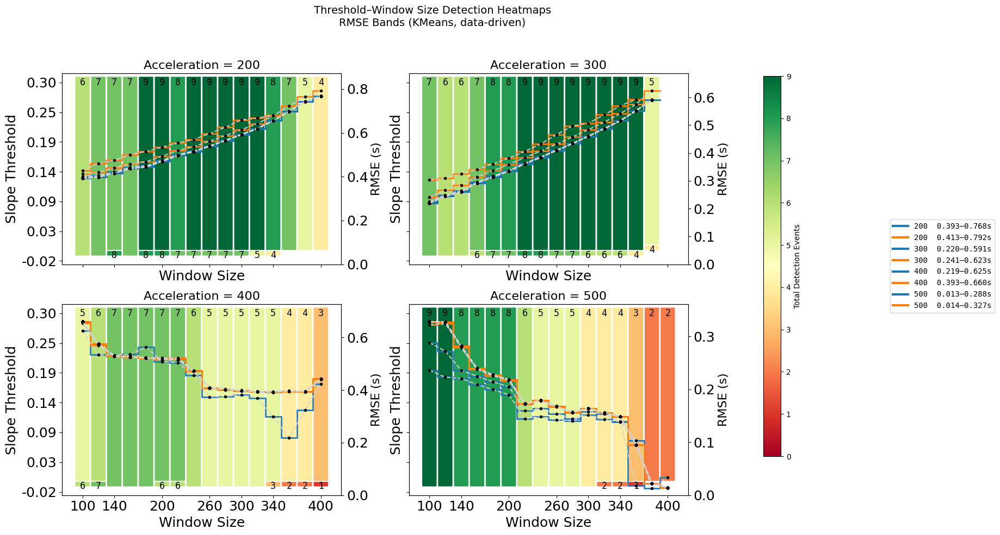

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 15.0
TILE_HEIGHT = 0.5
TILE_GAP = 0.6

TEXT_SIZE = 12
TEXT_COLOR = "black"
TEXT_PADDING_FRAC = 0.10

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # =========================
    # HARD VISUAL CUTOFF FOR TILES
    # =========================
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[
      (heatmap.index >= TILE_THRESHOLD_MIN) &
      (heatmap.index <= TILE_THRESHOLD_MAX)
       ]

    padded_thresholds = np.sort(
       np.unique([padding_min, *visible_thresholds, padding_max])
      )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * TILE_HEIGHT

    # ------------------------
    # AUTOMATIC Y-AXIS SCALING (TILE-SPACE SAFE)
    # ------------------------
    pad_tiles = 0.6  # padding expressed in TILE_HEIGHT units

    ax.set_ylim(
       -pad_tiles * TILE_HEIGHT,
       n_rows * TILE_HEIGHT + pad_tiles * TILE_HEIGHT
    )

    # Define y_first and y_last correctly from `thresholds` array
    y_first = thresholds[0]
    y_last = thresholds[-1]

    # Automatic ticks: keep first & last
    n_ticks = 7
    y_tick_values = np.linspace(y_first, y_last, n_ticks)
    y_tick_positions = np.interp(y_tick_values, thresholds, y_positions)

    ax.set_yticks(y_tick_positions)
    ax.set_yticklabels([f"{t:.2f}" for t in y_tick_values])

    # X-axis tick generation fix
    from matplotlib.ticker import MaxNLocator

    # Determine tick indices for all_window_sizes
    num_ws_to_show = min(7, len(all_window_sizes)) # Max 7 ticks, or fewer if list is short
    tick_indices_to_show = np.round(np.linspace(0, len(all_window_sizes) - 1, num_ws_to_show)).astype(int)

    x_tick_positions = x_positions[tick_indices_to_show]
    x_tick_labels = [all_window_sizes[idx] for idx in tick_indices_to_show]

    # Set ticks and font size
    ax.set_xticks(x_tick_positions)
    ax.set_xticklabels([str(int(t)) for t in x_tick_labels], fontsize=18)



    ax.set_title(f"Acceleration = {acc}", fontsize=16)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)
    ax.tick_params(axis="y", labelsize=18)

    # ------------------------
    # DRAW TILES
    # ------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0

        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            tile_height = (k - i + 1) * TILE_HEIGHT
            tile_bottom = i * TILE_HEIGHT
            tile_top = tile_bottom + tile_height
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, tile_bottom),
                    TILE_WIDTH,
                    tile_height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )

            ax.text(
                x_positions[j],
                tile_top - TEXT_PADDING_FRAC * TILE_HEIGHT,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )

            i = k + 1

    # ------------------------
    # RMSE CLUSTERING & OVERLAY
    # ------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )
    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=16)
    ax_r.tick_params(axis="y", labelsize=18)



    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        rmse_min_val = cluster_data['RMSE_seconds'].min()
        rmse_max_val = cluster_data['RMSE_seconds'].max()

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )
            # --- STEP LINE (matches example image style)
            ax_r.step(
              x_positions,
              curve["RMSE_seconds"],
              where="mid",
              color=colors[c % len(colors)],
              linewidth=2.0,
              alpha=0.95,
              zorder=4
            )

            # --- TRUE DATA POINTS (gray circles on the steps)
            ax_r.plot(
             x_positions,
             curve["RMSE_seconds"],
             linestyle="--",
             color="lightgray",
             marker="o",
             markersize=3.5,
             markerfacecolor="black",
             markeredgecolor="black",
             markeredgewidth=0.6,
             alpha=0.9,
             zorder=5
           )


        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=f"{acc}  {rmse_min_val:.3f}–" \
                      f"{rmse_max_val:.3f}s"
            )
        )

# =========================
# COLORBAR & LEGEND
# =========================
fig.legend(
    handles=legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()

/tmp/ipython-input-3890119304.py:301: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


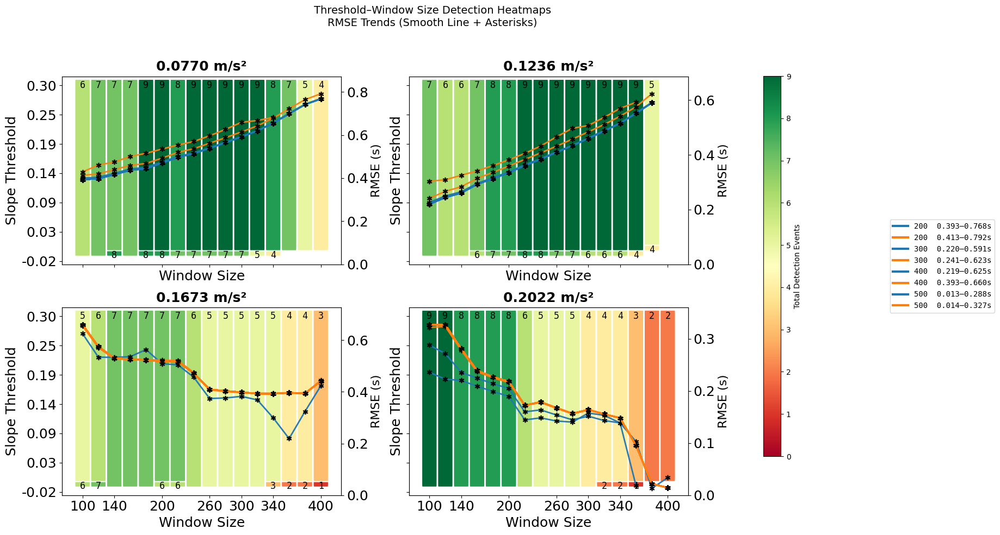

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 15.0
TILE_HEIGHT = 0.5
TILE_GAP = 0.6

TEXT_SIZE = 12
TEXT_COLOR = "black"
TEXT_PADDING_FRAC = 0.10

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # -------------------------
    # HARD TILE CUTOFF
    # -------------------------
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[
        (heatmap.index >= TILE_THRESHOLD_MIN) &
        (heatmap.index <= TILE_THRESHOLD_MAX)
    ]

    padded_thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * TILE_HEIGHT

    # -------------------------
    # AXIS SCALING
    # -------------------------
    pad_tiles = 0.6
    ax.set_ylim(
        -pad_tiles * TILE_HEIGHT,
        n_rows * TILE_HEIGHT + pad_tiles * TILE_HEIGHT
    )

    y_first, y_last = thresholds[0], thresholds[-1]
    y_tick_vals = np.linspace(y_first, y_last, 7)
    y_tick_pos = np.interp(y_tick_vals, thresholds, y_positions)

    ax.set_yticks(y_tick_pos)
    ax.set_yticklabels([f"{t:.2f}" for t in y_tick_vals])

    tick_idx = np.round(
        np.linspace(0, len(all_window_sizes) - 1, min(7, len(all_window_sizes)))
    ).astype(int)

    ax.set_xticks(x_positions[tick_idx])
    ax.set_xticklabels(
        [str(all_window_sizes[i]) for i in tick_idx],
        fontsize=18
    )

    # ax.set_title(f"Acceleration = {acc}", fontsize=16)
    ACC_TITLES = {
    200: "0.0770 m/s²",
    300: "0.1236 m/s²",
    400: "0.1673 m/s²",
    500: "0.2022 m/s²"
    }

    ax.set_title(
    ACC_TITLES[acc],
    fontsize=18,
    fontweight="bold",
    pad=8
    )


    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)
    ax.tick_params(axis="y", labelsize=18)

    # -------------------------
    # DRAW TILES
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = (k - i + 1) * TILE_HEIGHT
            bottom = i * TILE_HEIGHT
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )

            ax.text(
                x_positions[j],
                bottom + height - TEXT_PADDING_FRAC * TILE_HEIGHT,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )
            i = k + 1

    # -------------------------
    # RMSE CLUSTERING
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )
    th_median["Cluster"] = th_median["Cluster"].map({c: i for i, c in enumerate(order)})

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=16)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            # --- gray dashed connector
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                linestyle="--",
                linewidth=1.0,
                color="gray",
                alpha=0.6,
                zorder=3
            )

            # --- smooth colored line + asterisks
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2.0,
                marker="$*$",
                # markerfacecolor ="black",
                markeredgecolor="black",
                # marker="*",
                markersize=6,
                alpha=0.95,
                zorder=4
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=f"{acc}  {cluster_data['RMSE_seconds'].min():.3f}–"
                      f"{cluster_data['RMSE_seconds'].max():.3f}s"
            )
        )

# =========================
# COLORBAR & LEGEND
# =========================
fig.legend(
    handles=legend_items,
    loc="center right",
    bbox_to_anchor=(1.15, 0.5),
    fontsize=8,
    prop={"family": "monospace"}
)

sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Trends (Smooth Line + Asterisks)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


/tmp/ipython-input-4055435700.py:346: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.85, 0.95])


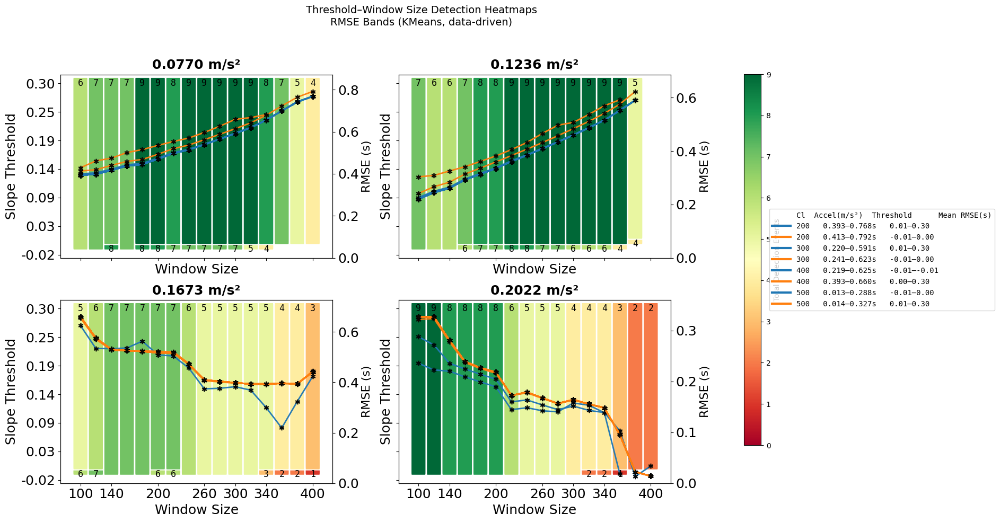

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 15.0
TILE_HEIGHT = 0.5
TILE_GAP = 0.6

TEXT_SIZE = 12
TEXT_COLOR = "black"
TEXT_PADDING_FRAC = 0.10

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(16, 10), sharex=True, sharey=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # -------------------------
    # HARD TILE CUTOFF
    # -------------------------
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[
        (heatmap.index >= TILE_THRESHOLD_MIN) &
        (heatmap.index <= TILE_THRESHOLD_MAX)
    ]

    padded_thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * TILE_HEIGHT

    # -------------------------
    # AXIS SCALING
    # -------------------------
    pad_tiles = 0.6
    ax.set_ylim(
        -pad_tiles * TILE_HEIGHT,
        n_rows * TILE_HEIGHT + pad_tiles * TILE_HEIGHT
    )

    y_first, y_last = thresholds[0], thresholds[-1]
    y_tick_vals = np.linspace(y_first, y_last, 7)
    y_tick_pos = np.interp(y_tick_vals, thresholds, y_positions)

    ax.set_yticks(y_tick_pos)
    ax.set_yticklabels([f"{t:.2f}" for t in y_tick_vals])

    tick_idx = np.round(
        np.linspace(0, len(all_window_sizes) - 1, min(7, len(all_window_sizes)))
    ).astype(int)

    ax.set_xticks(x_positions[tick_idx])
    ax.set_xticklabels(
        [str(all_window_sizes[i]) for i in tick_idx],
        fontsize=18
    )

    # ax.set_title(f"Acceleration = {acc}", fontsize=16)
    ACC_TITLES = {
    200: "0.0770 m/s²",
    300: "0.1236 m/s²",
    400: "0.1673 m/s²",
    500: "0.2022 m/s²"
    }

    ax.set_title(
    ACC_TITLES[acc],
    fontsize=18,
    fontweight="bold",
    pad=8
    )


    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)
    ax.tick_params(axis="y", labelsize=18)

    # -------------------------
    # DRAW TILES
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = (k - i + 1) * TILE_HEIGHT
            bottom = i * TILE_HEIGHT
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.4
                )
            )

            ax.text(
                x_positions[j],
                bottom + height - TEXT_PADDING_FRAC * TILE_HEIGHT,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )
            i = k + 1

    # -------------------------
    # RMSE CLUSTERING
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )
    th_median["Cluster"] = th_median["Cluster"].map({c: i for i, c in enumerate(order)})

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=16)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            # --- gray dashed connector
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                linestyle="--",
                linewidth=1.0,
                color="gray",
                alpha=0.6,
                zorder=3
            )

            # --- smooth colored line + asterisks
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2.0,
                marker="$*$",
                # markerfacecolor ="black",
                markeredgecolor="black",
                # marker="*",
                markersize=6,
                alpha=0.95,
                zorder=4
            )

        # legend_items.append(
        #     Line2D(
        #         [0], [0],
        #         color=colors[c % len(colors)],
        #         lw=3,
        #         label=f"{acc}  {cluster_data['RMSE_seconds'].min():.3f}–"
        #               f"{cluster_data['RMSE_seconds'].max():.3f}s"
        #     )
        # )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=(
                    f"{acc:<5} "
                    f"{cluster_data['RMSE_seconds'].min():.3f}–"
                    f"{cluster_data['RMSE_seconds'].max():.3f}s   "
                    f"{ths.min():.2f}–{ths.max():.2f}"
               )
            )
        )


# # =========================
# # COLORBAR & LEGEND
# # =========================
# fig.legend(
#     handles=legend_items,
#     loc="center right",
#     bbox_to_anchor=(1.15, 0.5),
#     fontsize=8,
#     prop={"family": "monospace"}
# )

# sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
# sm.set_array([])
# cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
# fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

# plt.suptitle(
#     "Threshold–Window Size Detection Heatmaps\nRMSE Trends (Smooth Line + Asterisks)",
#     fontsize=14
# )
# =========================
# COLORBAR & LEGEND
# =========================
# fig.legend(
#     handles=legend_items,
#     loc="center right",
#     bbox_to_anchor=(1.15, 0.5),
#     fontsize=8,
#     prop={"family": "monospace"}
# )

fig.legend(
    handles=[legend_header] + legend_items,
    loc="center right",
    bbox_to_anchor=(1.18, 0.5),
    fontsize=9,
    prop={"family": "monospace"},
    handlelength=2.5,
    handletextpad=0.8
)


sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])
fig.colorbar(sm, cax=cbar_ax).set_label("Total Detection Events")

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)
plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()


/tmp/ipython-input-2548786924.py:330: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.12, 1, 0.95])


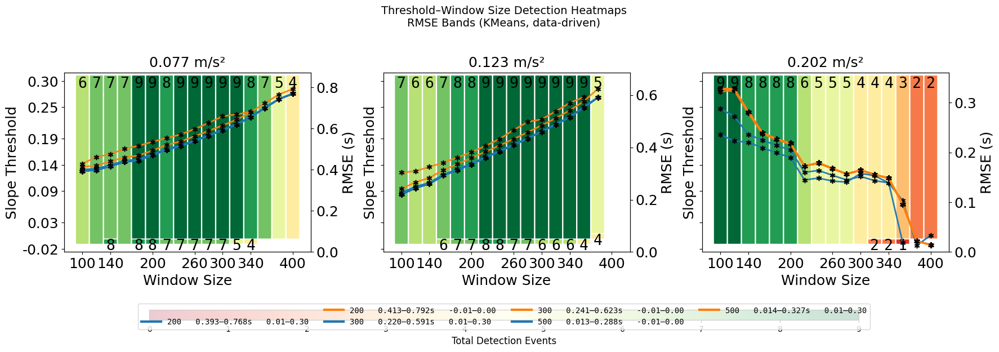

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.5
TILE_GAP = 0.9

TEXT_SIZE = 19
TEXT_COLOR = "black"
TEXT_PADDING_FRAC = 0.10

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True, sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # -------------------------
    # HARD TILE CUTOFF
    # -------------------------
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[
        (heatmap.index >= TILE_THRESHOLD_MIN) &
        (heatmap.index <= TILE_THRESHOLD_MAX)
    ]

    padded_thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * TILE_HEIGHT

    # -------------------------
    # AXIS SCALING
    # -------------------------
    pad_tiles = 0.6
    ax.set_ylim(
        -pad_tiles * TILE_HEIGHT,
        n_rows * TILE_HEIGHT + pad_tiles * TILE_HEIGHT
    )

    # y_first, y_last = thresholds[0], thresholds[-1]
    # y_tick_vals = np.linspace(y_first, y_last, 7)
    # y_tick_pos = np.interp(y_tick_vals, thresholds, y_positions)

    # ax.set_yticks(y_tick_pos)
    # ax.set_yticklabels([f"{t:.2f}" for t in y_tick_vals])

    # -------------------------
    # Y-axis tick labels
    # -------------------------
    # if acc in [200, 500]:  # only for 0.077 and 0.202 m/s²
    #     y_first, y_last = thresholds[0], thresholds[-1]
    #     y_tick_vals = np.linspace(y_first, y_last, 7)  # 7 evenly spaced ticks
    #     y_tick_pos = np.interp(y_tick_vals, thresholds, y_positions)
    #     ax.set_yticks(y_tick_pos)
    #     ax.set_yticklabels([f"{t:.2f}" for t in y_tick_vals], fontsize=18)
    # else:
    #     ax.set_yticks([])  # hide y-axis numbers for the middle subplot
    # -------------------------
    # Y-axis tick labels (only for acc 200 and 500)
    # -------------------------
    if acc in [200, 500]:  # 0.077 and 0.202 m/s²
    # Use 7 evenly spaced positions along y_positions
        num_ticks = 7
        tick_idx = np.round(np.linspace(0, n_rows - 1, num_ticks)).astype(int)
        ax.set_yticks(y_positions[tick_idx])
        ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in tick_idx], fontsize=18)
    else:
        ax.set_yticklabels([])  # hide y-axis numbers for acc 300



    tick_idx = np.round(
        np.linspace(0, len(all_window_sizes) - 1, min(7, len(all_window_sizes)))
    ).astype(int)

    ax.set_xticks(x_positions[tick_idx])
    ax.set_xticklabels([str(all_window_sizes[i]) for i in tick_idx], fontsize=18)

    ax.set_title(ACC_TITLES[acc], fontsize=18, fontweight="normal", pad=8)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)
    ax.tick_params(axis="y", labelsize=18)

    # -------------------------
    # DRAW TILES
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = (k - i + 1) * TILE_HEIGHT
            bottom = i * TILE_HEIGHT
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.2
                )
            )

            ax.text(
                x_positions[j],
                bottom + height - TEXT_PADDING_FRAC * TILE_HEIGHT,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )
            i = k + 1

    # -------------------------
    # RMSE CLUSTERING
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )
    th_median["Cluster"] = th_median["Cluster"].map({c: i for i, c in enumerate(order)})

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=18)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            # --- gray dashed connector
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                linestyle="--",
                linewidth=1.0,
                color="gray",
                alpha=0.6,
                zorder=3
            )

            # --- smooth colored line + asterisks
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2.0,
                marker="$*$",
                markeredgecolor="black",
                markersize=6,
                alpha=0.95,
                zorder=4
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=(
                    f"{acc:<5} "
                    f"{cluster_data['RMSE_seconds'].min():.3f}–"
                    f"{cluster_data['RMSE_seconds'].max():.3f}s   "
                    f"{ths.min():.2f}–{ths.max():.2f}"
               )
            )
        )

# =========================
# COLORBAR BELOW
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.15, 0.05, 0.7, 0.03])  # [left, bottom, width, height]
cbar = fig.colorbar(sm, cax=cbar_ax, orientation="horizontal")
cbar.set_label("Total Detection Events", fontsize=12)

# =========================
# LEGEND HORIZONTAL UNDER PLOTS
# =========================
legend_header = Line2D([0], [0], color="white", lw=0)  # placeholder for alignment
fig.legend(
    handles=[legend_header] + legend_items,
    loc="lower center",
    bbox_to_anchor=(0.5, 0.01),
    ncol=len(legend_items)//2 + 1,
    fontsize=9,
    prop={"family": "monospace"},
    handlelength=2.5,
    handletextpad=0.8
)

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)
plt.tight_layout(rect=[0, 0.12, 1, 0.95])
plt.show()


/tmp/ipython-input-351833265.py:310: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.12, 1, 0.95])


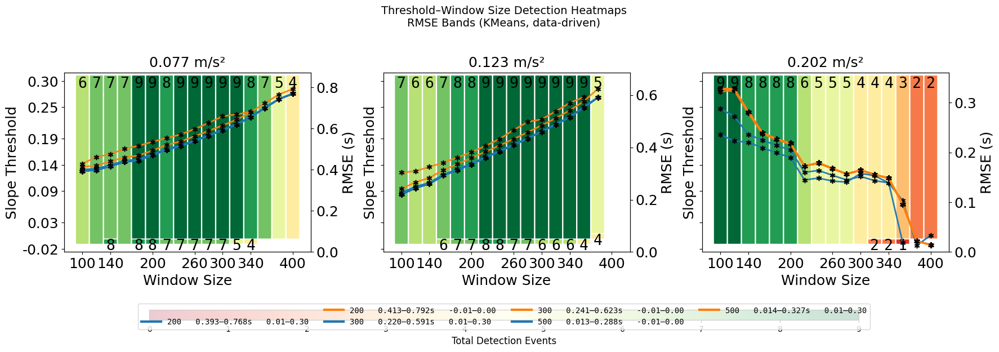

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.5
TILE_GAP = 0.9

TEXT_SIZE = 19
TEXT_COLOR = "black"
TEXT_PADDING_FRAC = 0.10

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True, sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # -------------------------
    # HARD TILE CUTOFF
    # -------------------------
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[
        (heatmap.index >= TILE_THRESHOLD_MIN) &
        (heatmap.index <= TILE_THRESHOLD_MAX)
    ]

    padded_thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * TILE_HEIGHT

    # -------------------------
    # AXIS SCALING
    # -------------------------
    pad_tiles = 0.6
    ax.set_ylim(
        -pad_tiles * TILE_HEIGHT,
        n_rows * TILE_HEIGHT + pad_tiles * TILE_HEIGHT
    )

    # -------------------------
    # Y-axis tick labels only for acc 200 and 500
    # -------------------------
    if acc in [200, 500]:
        num_ticks = 7  # 7 evenly spaced ticks
        tick_idx = np.round(np.linspace(0, n_rows - 1, num_ticks)).astype(int)
        ax.set_yticks(y_positions[tick_idx])
        ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in tick_idx], fontsize=18)
    else:
        ax.set_yticklabels([])  # hide y-axis numbers for acc 300

    # -------------------------
    # X-axis ticks
    # -------------------------
    tick_idx = np.round(
        np.linspace(0, len(all_window_sizes) - 1, min(7, len(all_window_sizes)))
    ).astype(int)
    ax.set_xticks(x_positions[tick_idx])
    ax.set_xticklabels([str(all_window_sizes[i]) for i in tick_idx], fontsize=18)

    ax.set_title(ACC_TITLES[acc], fontsize=18, fontweight="normal", pad=8)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)
    ax.tick_params(axis="y", labelsize=18)

    # -------------------------
    # DRAW TILES
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = (k - i + 1) * TILE_HEIGHT
            bottom = i * TILE_HEIGHT
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.2
                )
            )

            ax.text(
                x_positions[j],
                bottom + height - TEXT_PADDING_FRAC * TILE_HEIGHT,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )
            i = k + 1

    # -------------------------
    # RMSE CLUSTERING
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )
    th_median["Cluster"] = th_median["Cluster"].map({c: i for i, c in enumerate(order)})

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=18)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            # --- gray dashed connector
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                linestyle="--",
                linewidth=1.0,
                color="gray",
                alpha=0.6,
                zorder=3
            )

            # --- smooth colored line + asterisks
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2.0,
                marker="$*$",
                markeredgecolor="black",
                markersize=6,
                alpha=0.95,
                zorder=4
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=(
                    f"{acc:<5} "
                    f"{cluster_data['RMSE_seconds'].min():.3f}–"
                    f"{cluster_data['RMSE_seconds'].max():.3f}s   "
                    f"{ths.min():.2f}–{ths.max():.2f}"
               )
            )
        )

# =========================
# COLORBAR BELOW
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.15, 0.05, 0.7, 0.03])  # [left, bottom, width, height]
cbar = fig.colorbar(sm, cax=cbar_ax, orientation="horizontal")
cbar.set_label("Total Detection Events", fontsize=12)

# =========================
# LEGEND HORIZONTAL UNDER PLOTS
# =========================
legend_header = Line2D([0], [0], color="white", lw=0)  # placeholder for alignment
fig.legend(
    handles=[legend_header] + legend_items,
    loc="lower center",
    bbox_to_anchor=(0.5, 0.01),
    ncol=len(legend_items)//2 + 1,
    fontsize=9,
    prop={"family": "monospace"},
    handlelength=2.5,
    handletextpad=0.8
)

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)
plt.tight_layout(rect=[0, 0.12, 1, 0.95])
plt.show()


/tmp/ipython-input-2989347067.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.12, 1, 0.95])


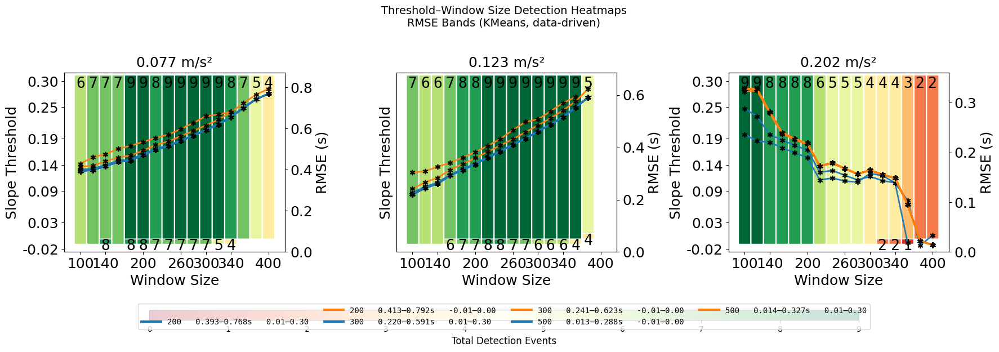

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.5
TILE_GAP = 0.9

TEXT_SIZE = 19
TEXT_COLOR = "black"
TEXT_PADDING_FRAC = 0.10

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE (no shared y-axis)
# =========================
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # -------------------------
    # HARD TILE CUTOFF
    # -------------------------
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[
        (heatmap.index >= TILE_THRESHOLD_MIN) &
        (heatmap.index <= TILE_THRESHOLD_MAX)
    ]

    padded_thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * TILE_HEIGHT

    # -------------------------
    # AXIS SCALING
    # -------------------------
    pad_tiles = 0.6
    ax.set_ylim(
        -pad_tiles * TILE_HEIGHT,
        n_rows * TILE_HEIGHT + pad_tiles * TILE_HEIGHT
    )

    # -------------------------
    # Y-axis tick labels
    # -------------------------
    if acc in [200, 500]:  # only for 0.077 and 0.202 m/s²
        num_ticks = 7
        tick_idx = np.round(np.linspace(0, n_rows - 1, num_ticks)).astype(int)
        ax.set_yticks(y_positions[tick_idx])
        ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in tick_idx], fontsize=18)
    else:
        ax.set_yticks([])  # hide middle subplot y-axis numbers

    # -------------------------
    # X-axis
    # -------------------------
    tick_idx = np.round(
        np.linspace(0, len(all_window_sizes) - 1, min(7, len(all_window_sizes)))
    ).astype(int)
    ax.set_xticks(x_positions[tick_idx])
    ax.set_xticklabels([str(all_window_sizes[i]) for i in tick_idx], fontsize=18)

    ax.set_title(ACC_TITLES[acc], fontsize=18, fontweight="normal", pad=8)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)
    ax.tick_params(axis="y", labelsize=18)

    # -------------------------
    # DRAW TILES
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = (k - i + 1) * TILE_HEIGHT
            bottom = i * TILE_HEIGHT
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.2
                )
            )

            ax.text(
                x_positions[j],
                bottom + height - TEXT_PADDING_FRAC * TILE_HEIGHT,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )
            i = k + 1

    # -------------------------
    # RMSE CLUSTERING
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )
    th_median["Cluster"] = th_median["Cluster"].map({c: i for i, c in enumerate(order)})

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=18)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            # --- gray dashed connector
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                linestyle="--",
                linewidth=1.0,
                color="gray",
                alpha=0.6,
                zorder=3
            )

            # --- smooth colored line + asterisks
            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2.0,
                marker="$*$",
                markeredgecolor="black",
                markersize=6,
                alpha=0.95,
                zorder=4
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=(
                    f"{acc:<5} "
                    f"{cluster_data['RMSE_seconds'].min():.3f}–"
                    f"{cluster_data['RMSE_seconds'].max():.3f}s   "
                    f"{ths.min():.2f}–{ths.max():.2f}"
               )
            )
        )

# =========================
# COLORBAR BELOW
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.15, 0.05, 0.7, 0.03])  # [left, bottom, width, height]
cbar = fig.colorbar(sm, cax=cbar_ax, orientation="horizontal")
cbar.set_label("Total Detection Events", fontsize=12)

# =========================
# LEGEND HORIZONTAL UNDER PLOTS
# =========================
legend_header = Line2D([0], [0], color="white", lw=0)  # placeholder
fig.legend(
    handles=[legend_header] + legend_items,
    loc="lower center",
    bbox_to_anchor=(0.5, 0.01),
    ncol=len(legend_items)//2 + 1,
    fontsize=9,
    prop={"family": "monospace"},
    handlelength=2.5,
    handletextpad=0.8
)

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)
plt.tight_layout(rect=[0, 0.12, 1, 0.95])
plt.show()


/tmp/ipython-input-2954702379.py:327: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.12, 1, 0.95])


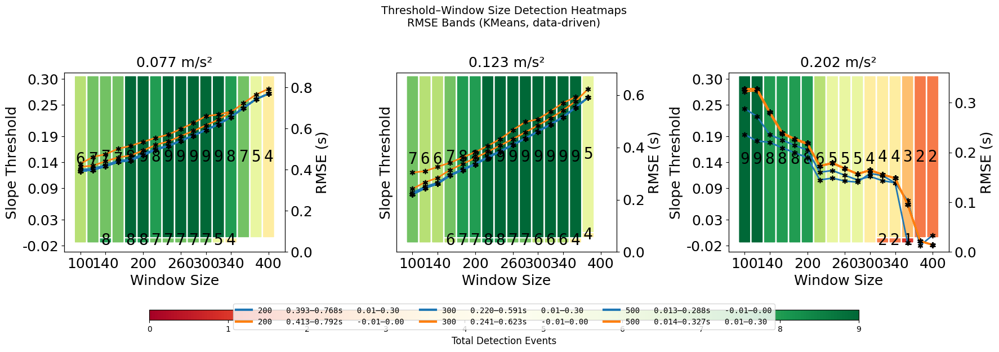

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS (UPDATED)
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.9          # ⬅ BIGGER TILES
TILE_GAP = 0.9

TEXT_SIZE = 20
TEXT_COLOR = "black"

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # -------------------------
    # HARD TILE CUTOFF
    # -------------------------
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[
        (heatmap.index >= TILE_THRESHOLD_MIN) &
        (heatmap.index <= TILE_THRESHOLD_MAX)
    ]

    padded_thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)

    # ⬅ larger vertical spacing
    y_positions = np.arange(n_rows) * (TILE_HEIGHT * 1.15)

    # -------------------------
    # AXIS SCALING
    # -------------------------
    pad_tiles = 0.9
    ax.set_ylim(
        -pad_tiles * TILE_HEIGHT,
        y_positions[-1] + TILE_HEIGHT + pad_tiles * TILE_HEIGHT
    )

    # -------------------------
    # Y-axis tick labels
    # -------------------------
    if acc in [200, 500]:
        num_ticks = 7
        tick_idx = np.round(
            np.linspace(0, n_rows - 1, num_ticks)
        ).astype(int)

        ax.set_yticks(y_positions[tick_idx] + TILE_HEIGHT / 2)
        ax.set_yticklabels(
            [f"{thresholds[i]:.2f}" for i in tick_idx],
            fontsize=18
        )
    else:
        ax.set_yticks([])

    # -------------------------
    # X-axis
    # -------------------------
    tick_idx = np.round(
        np.linspace(0, len(all_window_sizes) - 1,
                    min(7, len(all_window_sizes)))
    ).astype(int)

    ax.set_xticks(x_positions[tick_idx])
    ax.set_xticklabels(
        [str(all_window_sizes[i]) for i in tick_idx],
        fontsize=18
    )

    ax.set_title(ACC_TITLES[acc], fontsize=18, pad=8)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)

    # -------------------------
    # DRAW BIG TILES
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = (k - i + 1) * TILE_HEIGHT * 1.15
            bottom = y_positions[i]
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.30",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.5
                )
            )

            # ⬅ centered text
            ax.text(
                x_positions[j],
                bottom + height / 2,
                f"{int(val)}",
                ha="center",
                va="center",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )

            i = k + 1

    # -------------------------
    # RMSE (RIGHT Y-AXIS)
    # -------------------------
    th_median = (
        rmse_sub.groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )
    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=18)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        cluster_data = rmse_sub[rmse_sub["Threshold"].isin(ths)]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                linestyle="--",
                linewidth=1.0,
                color="gray",
                alpha=0.6
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c % len(colors)],
                linewidth=2.0,
                marker="$*$",
                markeredgecolor="black",
                markersize=6
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c % len(colors)],
                lw=3,
                label=(
                    f"{acc:<5} "
                    f"{cluster_data['RMSE_seconds'].min():.3f}–"
                    f"{cluster_data['RMSE_seconds'].max():.3f}s   "
                    f"{ths.min():.2f}–{ths.max():.2f}"
                )
            )
        )

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.15, 0.05, 0.7, 0.03])
cbar = fig.colorbar(sm, cax=cbar_ax, orientation="horizontal")
cbar.set_label("Total Detection Events", fontsize=12)

# =========================
# LEGEND
# =========================
fig.legend(
    handles=legend_items,
    loc="lower center",
    bbox_to_anchor=(0.5, 0.01),
    ncol=3,
    fontsize=9,
    prop={"family": "monospace"}
)

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0.12, 1, 0.95])
plt.show()


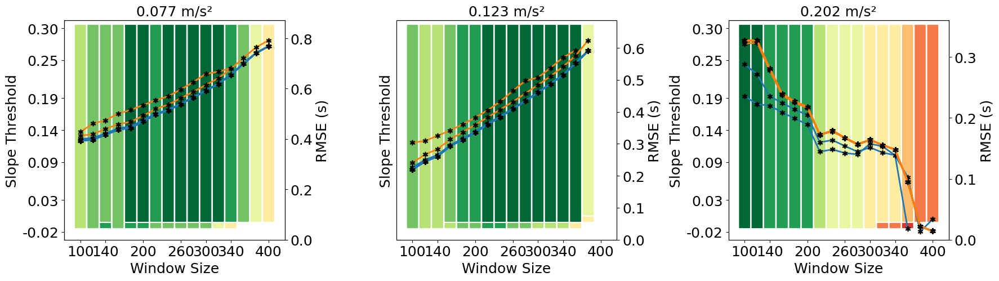

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.9
TILE_GAP = 0.9

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[
        (heatmap.index >= TILE_THRESHOLD_MIN) &
        (heatmap.index <= TILE_THRESHOLD_MAX)
    ]

    padded_thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)

    y_positions = np.arange(n_rows) * (TILE_HEIGHT * 1.15)

    ax.set_ylim(
        -0.9 * TILE_HEIGHT,
        y_positions[-1] + TILE_HEIGHT * 1.9
    )

    # -------------------------
    # Y-axis ticks (threshold)
    # -------------------------
    if acc in [200, 500]:
        idx = np.round(np.linspace(0, n_rows - 1, 7)).astype(int)
        ax.set_yticks(y_positions[idx] + TILE_HEIGHT / 2)
        ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in idx], fontsize=18)
    else:
        ax.set_yticks([])

    # -------------------------
    # X-axis
    # -------------------------
    idx = np.round(
        np.linspace(0, len(all_window_sizes) - 1, min(7, len(all_window_sizes)))
    ).astype(int)

    ax.set_xticks(x_positions[idx])
    ax.set_xticklabels([str(all_window_sizes[i]) for i in idx], fontsize=18)

    ax.set_title(ACC_TITLES[acc], fontsize=18)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)

    # -------------------------
    # DRAW BIG TILES (NO NUMBERS)
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = (k - i + 1) * TILE_HEIGHT * 1.15
            bottom = y_positions[i]
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.30",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.5
                )
            )

            i = k + 1

    # -------------------------
    # RMSE (RIGHT Y-AXIS)
    # -------------------------
    th_median = (
        rmse_sub.groupby("Threshold")["RMSE_seconds"]
        .median()
        .reset_index()
    )

    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    th_median["Cluster"] = KMeans(
        n_clusters=best_k, n_init=20, random_state=0
    ).fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean()
        .sort_values()
        .index
    )

    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=18)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                linestyle="--",
                color="gray",
                alpha=0.6
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c],
                linewidth=2,
                marker="$*$",
                markeredgecolor="black",
                markersize=6
            )

# =========================
# COLORBAR
# =========================
# sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
# sm.set_array([])
# cbar = fig.colorbar(sm, ax=axes, orientation="horizontal", pad=0.1)
# cbar.set_label("Total Detection Events", fontsize=12)

# plt.suptitle(
#     "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
#     fontsize=14
# )

plt.tight_layout(rect=[0, 0.1, 1, 0.95])
plt.show()


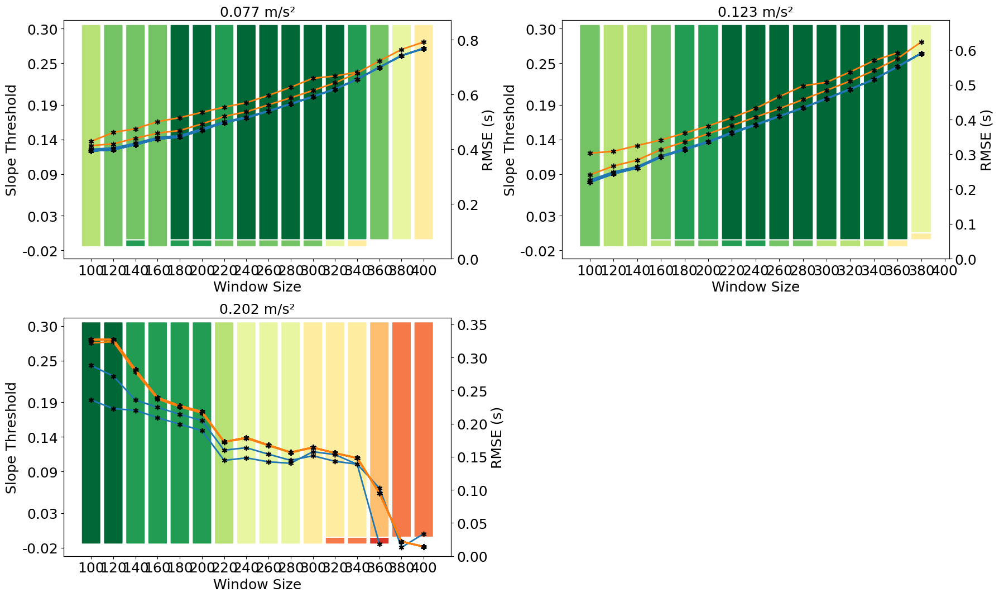

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.9
TILE_GAP = 3.9

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = [200, 300, 500]  # fixed order
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE (2 rows, 2 columns)
# =========================
fig, axes = plt.subplots(2, 2, figsize=(18, 12), sharex=False)
axes = axes.flatten()

# Empty bottom-right
axes[-1].axis("off")

cmap = plt.cm.RdYlGn  # changed to blue shades
vmin, vmax = 0, summary_df["Total"].max()

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):
    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[(heatmap.index >= TILE_THRESHOLD_MIN) & (heatmap.index <= TILE_THRESHOLD_MAX)]
    padded_thresholds = np.sort(np.unique([padding_min, *visible_thresholds, padding_max]))
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * (TILE_HEIGHT * 1.15)

    ax.set_ylim(-0.9*TILE_HEIGHT, y_positions[-1]+TILE_HEIGHT*1.9)

    # -------------------------
    # Y-axis ticks (threshold)
    # -------------------------
    idx = np.round(np.linspace(0, n_rows - 1, 7)).astype(int)
    ax.set_yticks(y_positions[idx] + TILE_HEIGHT / 2)
    ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in idx], fontsize=18)

    # -------------------------
    # X-axis ticks (all WindowSize)
    # -------------------------
    ax.set_xticks(x_positions)
    ax.set_xticklabels([str(ws) for ws in all_window_sizes], fontsize=18)

    ax.set_title(ACC_TITLES[acc], fontsize=18)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)

    # -------------------------
    # DRAW BIG TILES (NO NUMBERS)
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1
            height = (k - i + 1) * TILE_HEIGHT * 1.15
            bottom = y_positions[i]
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.30",
                    facecolor=cmap((val - vmin)/(vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.5
                )
            )
            i = k + 1

    # -------------------------
    # RMSE (RIGHT Y-AXIS)
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2,3]:
        if len(X) <= k: continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    th_median["Cluster"] = KMeans(n_clusters=best_k, n_init=20, random_state=0).fit_predict(X)
    order = th_median.groupby("Cluster")["RMSE_seconds"].mean().sort_values().index
    th_median["Cluster"] = th_median["Cluster"].map({c:i for i,c in enumerate(order)})

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max()*1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=18)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors
    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        for th in ths:
            curve = rmse_sub[rmse_sub["Threshold"]==th].set_index("WindowSize").reindex(all_window_sizes)
            ax_r.plot(x_positions, curve["RMSE_seconds"], linestyle="--", color="gray", alpha=0.6)
            ax_r.plot(x_positions, curve["RMSE_seconds"], color=colors[c], linewidth=2, marker="$*$", markeredgecolor="black", markersize=6)

plt.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.show()


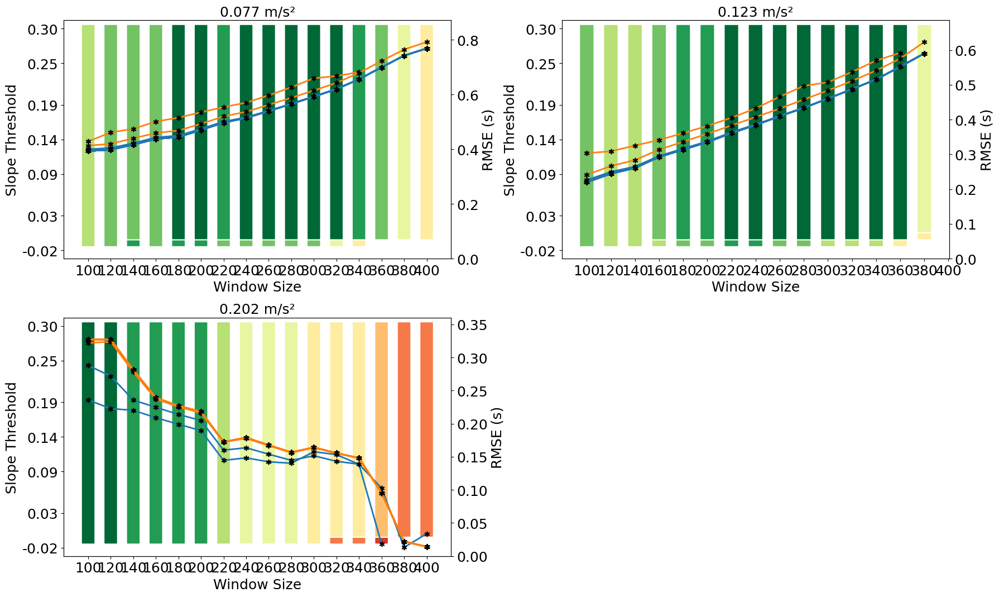

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.9
TILE_GAP = 18.9  # spacing between tiles

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = [200, 300, 500]  # fixed order
all_window_sizes = sorted(summary_df["WindowSize"].unique())

# -------------------------
# Compute tile starting positions (edges)
# -------------------------
x_positions = np.cumsum([0] + [TILE_WIDTH + TILE_GAP for _ in range(len(all_window_sizes)-1)])

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE (2 rows, 2 columns)
# =========================
fig, axes = plt.subplots(2, 2, figsize=(18, 12), sharex=False)
axes = axes.flatten()
axes[-1].axis("off")  # empty subplot

cmap = plt.cm.RdYlGn  # can replace with blues if desired
vmin, vmax = 0, summary_df["Total"].max()

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):
    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30

    visible_thresholds = heatmap.index[(heatmap.index >= TILE_THRESHOLD_MIN) & (heatmap.index <= TILE_THRESHOLD_MAX)]
    padded_thresholds = np.sort(np.unique([padding_min, *visible_thresholds, padding_max]))
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * (TILE_HEIGHT * 1.15)
    ax.set_ylim(-0.9*TILE_HEIGHT, y_positions[-1]+TILE_HEIGHT*1.9)


    # -------------------------
    # Y-axis ticks (threshold)
    # -------------------------
    idx = np.round(np.linspace(0, n_rows - 1, 7)).astype(int)
    ax.set_yticks(y_positions[idx] + TILE_HEIGHT / 2)
    ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in idx], fontsize=18)

    # -------------------------
    # X-axis ticks (all WindowSize)
    # -------------------------
    ax.set_xticks(x_positions + TILE_WIDTH/2)  # center labels on tiles
    ax.set_xticklabels([str(ws) for ws in all_window_sizes], fontsize=18)

    ax.set_title(ACC_TITLES[acc], fontsize=18)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)

    # -------------------------
    # DRAW BIG TILES (NO NUMBERS)
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1
            height = (k - i + 1) * TILE_HEIGHT * 1.15
            bottom = y_positions[i]
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j], bottom),  # tile left edge at x_positions[j]
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.30",
                    facecolor=cmap((val - vmin)/(vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.5
                )
            )
            i = k + 1

    # -------------------------
    # RMSE (RIGHT Y-AXIS)
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2,3]:
        if len(X) <= k: continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    th_median["Cluster"] = KMeans(n_clusters=best_k, n_init=20, random_state=0).fit_predict(X)
    order = th_median.groupby("Cluster")["RMSE_seconds"].mean().sort_values().index
    th_median["Cluster"] = th_median["Cluster"].map({c:i for i,c in enumerate(order)})

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max()*1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=18)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors
    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        for th in ths:
            curve = rmse_sub[rmse_sub["Threshold"]==th].set_index("WindowSize").reindex(all_window_sizes)
            ax_r.plot(x_positions + TILE_WIDTH/2, curve["RMSE_seconds"], linestyle="--", color="gray", alpha=0.6)
            ax_r.plot(x_positions + TILE_WIDTH/2, curve["RMSE_seconds"], color=colors[c], linewidth=2, marker="$*$", markeredgecolor="black", markersize=6)

plt.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.show()


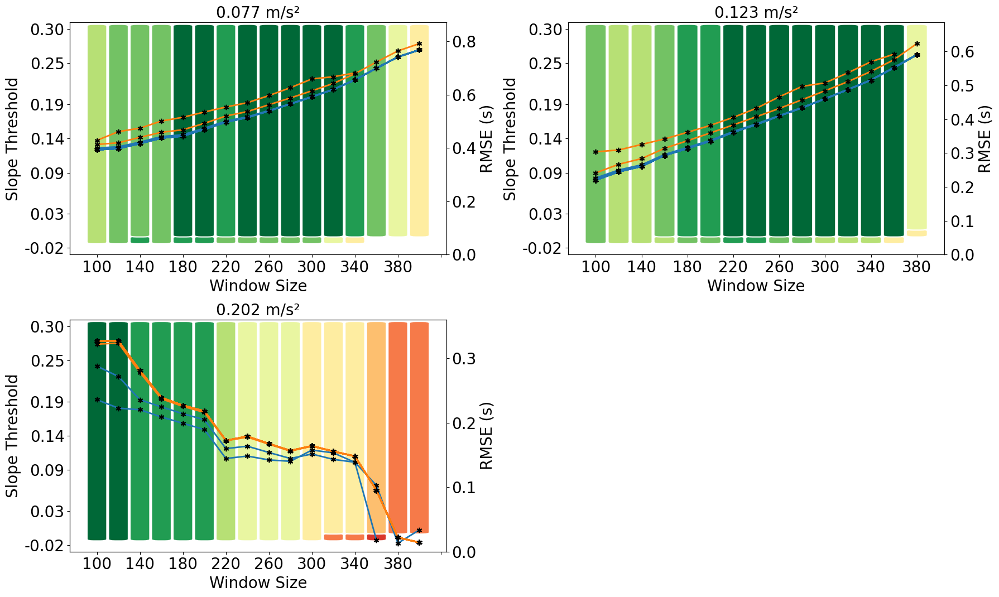

In [ ]:
#CORRECT CODE USED FOR PAPER
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.lines import Line2D
from matplotlib.ticker import MaxNLocator

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 0.8  # width relative to x-axis scale
TILE_HEIGHT = 0.9
TILE_GAP = 0.4   # space between tiles vertically (y-axis)

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")
df_valid = df[(df["Sensor_DetectedFrame"] != 0) & (df["Marker_DetectedFrame"] != 0)].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid.groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = [200, 300, 500]  # fixed order
all_window_sizes = sorted(summary_df["WindowSize"].unique())

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE (2 rows, 2 columns)
# =========================
fig, axes = plt.subplots(2, 2, figsize=(18, 12), sharex=False)
axes = axes.flatten()
axes[-1].axis("off")  # empty bottom-right

cmap = plt.cm.RdYlGn           # Blues shades of blue
vmin, vmax = 0, summary_df["Total"].max()

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):
    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    # Pivot heatmap
    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # Pad thresholds
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30
    visible_thresholds = heatmap.index[(heatmap.index >= TILE_THRESHOLD_MIN) & (heatmap.index <= TILE_THRESHOLD_MAX)]
    padded_thresholds = np.sort(np.unique([padding_min, *visible_thresholds, padding_max]))
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * (TILE_HEIGHT + TILE_GAP)

    ax.set_ylim(-0.9*TILE_HEIGHT, y_positions[-1]+TILE_HEIGHT*1.9)
    # ax.set_ylim(-0.9*TILE_HEIGHT, y_positions[-1]+TILE_HEIGHT*1.9)

    # -------------------------
    # Y-axis ticks (threshold)
    # -------------------------
    idx = np.round(np.linspace(0, n_rows - 1, min(7, n_rows))).astype(int)
    ax.set_yticks(y_positions[idx] + TILE_HEIGHT / 2)
    ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in idx], fontsize=20)

    # -------------------------
    # X-axis ticks (all WindowSize evenly)
    # -------------------------
    x_positions = np.arange(len(all_window_sizes))
    ax.set_xticks(x_positions)
    ax.set_xticklabels([str(ws) for ws in all_window_sizes], fontsize=20, rotation=0)
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))

    ax.set_title(ACC_TITLES[acc], fontsize=20)
    ax.set_xlabel("Window Size", fontsize=20)
    ax.set_ylabel("Slope Threshold", fontsize=20)

    # -------------------------
    # DRAW BIG TILES (NO NUMBERS)
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1
            height = (k - i + 1) * (TILE_HEIGHT + TILE_GAP)
            bottom = y_positions[i]
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j]-TILE_WIDTH/2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.30",
                    facecolor=cmap((val - vmin)/(vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.5
                )
            )
            i = k + 1

    # -------------------------
    # RMSE (RIGHT Y-AXIS)
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2,3]:
        if len(X) <= k: continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    th_median["Cluster"] = KMeans(n_clusters=best_k, n_init=20, random_state=0).fit_predict(X)
    order = th_median.groupby("Cluster")["RMSE_seconds"].mean().sort_values().index
    th_median["Cluster"] = th_median["Cluster"].map({c:i for i,c in enumerate(order)})

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max()*1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=20)
    ax_r.tick_params(axis="y", labelsize=20)

    colors = plt.cm.tab10.colors
    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"]==c]["Threshold"]
        for th in ths:
            curve = rmse_sub[rmse_sub["Threshold"]==th].set_index("WindowSize").reindex(all_window_sizes)
            ax_r.plot(x_positions, curve["RMSE_seconds"], linestyle="--", color="gray", alpha=0.6)
            ax_r.plot(x_positions, curve["RMSE_seconds"], color=colors[c], linewidth=2,
                      marker="$*$", markeredgecolor="black", markersize=6)

plt.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.show()


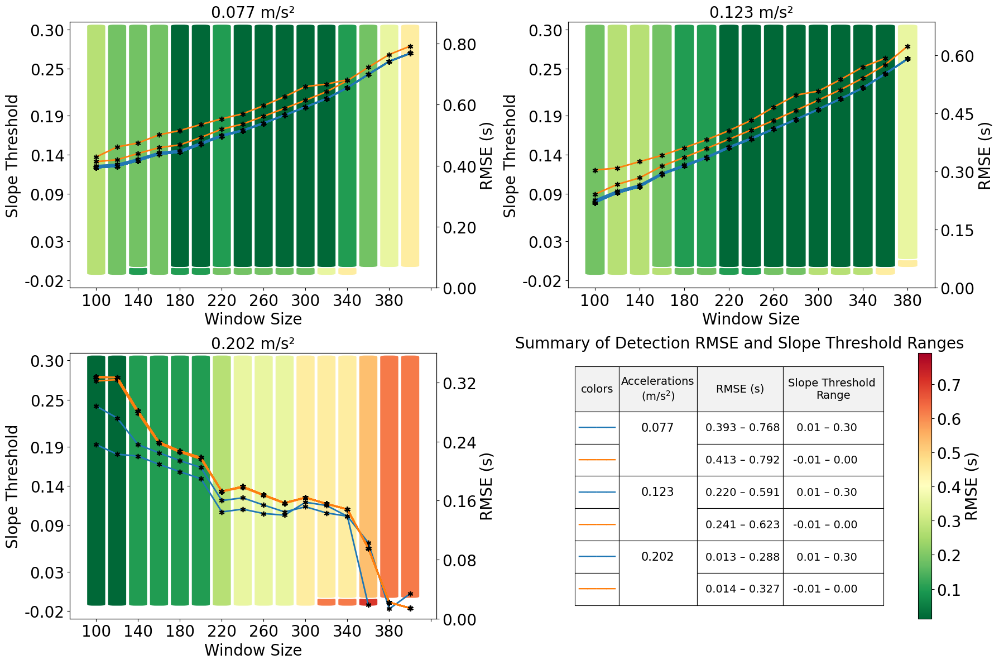

In [ ]:
# CORRECT CODE USED FOR PAPER (FULL + TABLE PANEL)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.lines import Line2D
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FormatStrFormatter


# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 0.8
TILE_HEIGHT = 0.9
TILE_GAP = 0.4

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")
df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 400
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = [200, 300, 500]
all_window_sizes = sorted(summary_df["WindowSize"].unique())

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(18, 12))
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

# =========================
# MAIN HEATMAP PANELS
# =========================
for ax, acc in zip(axes[:3], accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    visible = heatmap.index[
        (heatmap.index >= -0.01) &
        (heatmap.index <= 0.30)
    ]
    padded = np.sort(np.unique([padding_min, *visible, padding_max]))
    heatmap = heatmap.reindex(padded, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_pos = np.arange(n_rows) * (TILE_HEIGHT + TILE_GAP)

    ax.set_ylim(-0.9*TILE_HEIGHT, y_pos[-1] + TILE_HEIGHT*1.9)

    idx = np.round(np.linspace(0, n_rows-1, min(7, n_rows))).astype(int)
    ax.set_yticks(y_pos[idx] + TILE_HEIGHT/2)
    ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in idx], fontsize=20)

    x_pos = np.arange(len(all_window_sizes))
    ax.set_xticks(x_pos)
    ax.set_xticklabels(all_window_sizes, fontsize=20)
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))

    ax.set_title(ACC_TITLES[acc], fontsize=20)
    ax.set_xlabel("Window Size", fontsize=20)
    ax.set_ylabel("Slope Threshold", fontsize=20)

    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k+1 < n_rows and col[k+1] == col[i]:
                k += 1
            height = (k-i+1)*(TILE_HEIGHT+TILE_GAP)
            ax.add_patch(
                FancyBboxPatch(
                    (x_pos[j]-TILE_WIDTH/2, y_pos[i]),
                    TILE_WIDTH, height,
                    boxstyle="round,pad=0.06,rounding_size=0.30",
                    facecolor=cmap((col[i]-vmin)/(vmax-vmin)),
                    edgecolor="white",
                    linewidth=1.5
                )
            )
            i = k + 1

    # RMSE curves
    th_med = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_med[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    th_med["Cluster"] = KMeans(
        n_clusters=best_k, n_init=20, random_state=0
    ).fit_predict(X)

    order = (
        th_med.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_med["Cluster"] = th_med["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    # ax_r = ax.twinx()
    # ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max()*1.1)
    # ax_r.set_ylabel("RMSE (s)", fontsize=20)
    # ax_r.tick_params(axis="y", labelsize=20)

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max()*1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=20)
    ax_r.tick_params(axis="y", labelsize=20)

    ax_r.yaxis.set_major_formatter(FormatStrFormatter("%.2f"))
    ax_r.yaxis.set_major_locator(MaxNLocator(nbins=5))


    colors = plt.cm.tab10.colors
    for c in sorted(th_med["Cluster"].unique()):
        for th in th_med[th_med["Cluster"] == c]["Threshold"]:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )
            ax_r.plot(x_pos, curve["RMSE_seconds"],
                      linestyle="--", color="gray", alpha=0.6)
            ax_r.plot(x_pos, curve["RMSE_seconds"],
                      color=colors[c], linewidth=2,
                      marker="$*$", markeredgecolor="black",
                      markersize=6)

# =========================
# TABLE + HEATMAP PANEL
# =========================
# ax = axes[3]
# ax.clear()

# table_df = pd.DataFrame({
#     "Acceleration (m/s²)": ["0.077","0.077","0.123","0.123","0.202","0.202"],
#     "RMSE Range (s)": ["0.393–0.768","0.413–0.792","0.220–0.591",
#                        "0.241–0.623","0.013–0.288","0.014–0.327"],
#     "Threshold Range": ["0.01–0.30","−0.01–0.00","0.01–0.30",
#                         "−0.01–0.00","−0.01–0.00","0.01–0.30"]
# })

# tbl = ax.table(
#     cellText=table_df.values,
#     colLabels=table_df.columns,
#     cellLoc="center",
#     colLoc="center",
#     bbox=[0, 0.48, 1, 0.50]
# )
# tbl.auto_set_font_size(False)
# tbl.set_fontsize(14)

# for (r, c), cell in tbl.get_celld().items():
#     if r == 0:
#         cell.set_text_props(weight="bold")
#         cell.set_facecolor("#E6E6E6")
#     cell.set_edgecolor("black")

# heat_vals = np.array([
#     [0.393,0.768],
#     [0.413,0.792],
#     [0.220,0.591],
#     [0.241,0.623],
#     [0.013,0.288],
#     [0.014,0.327]
# ])

# im = ax.imshow(
#     heat_vals, cmap="RdYlGn_r",
#     aspect="auto", origin="lower",
#     extent=[0,2,0,6]
# )

# ax.set_xticks([0.5,1.5])
# ax.set_xticklabels(["Min RMSE","Max RMSE"], fontsize=14)
# ax.set_yticks(np.arange(6)+0.5)
# ax.set_yticklabels([
#     "0.077 (0.01–0.30)",
#     "0.077 (−0.01–0.00)",
#     "0.123 (0.01–0.30)",
#     "0.123 (−0.01–0.00)",
#     "0.202 (−0.01–0.00)",
#     "0.202 (0.01–0.30)"
# ], fontsize=13)

# cbar = fig.colorbar(im, ax=ax, fraction=0.04, pad=0.04)
# cbar.set_label("RMSE (s)", fontsize=14)
# =========================
# TABLE PANEL (MATCHING PROVIDED FIGURE)
# =========================
ax = axes[3]
ax.clear()
ax.axis("off")

# ---- Table content (exact) ----
# rows = [
#     ["", "0.077", "0.393 – 0.768", "0.01 – 0.30"],
#     ["", "",     "0.413 – 0.792", "-0.01 – 0.00"],
#     ["", "0.123", "0.220 – 0.591", "0.01 – 0.30"],
#     ["", "",     "0.241 – 0.623", "-0.01 – 0.00"],
#     ["", "0.202", "0.013 – 0.288", "0.01 – 0.30"],
#     ["", "",     "0.014 – 0.327", "-0.01 – 0.00"],
# ]
rows = [
    ["", "0.077", "0.393 – 0.768", " 0.01 – 0.30"],
    ["", "",     "0.413 – 0.792", "-0.01 – 0.00"],
    ["", "0.123", "0.220 – 0.591", " 0.01 – 0.30"],
    ["", "",     "0.241 – 0.623", "-0.01 – 0.00"],
    ["", "0.202", "0.013 – 0.288", " 0.01 – 0.30"],
    ["", "",     "0.014 – 0.327", "-0.01 – 0.00"],
]


columns = [
    "colors",
    "Accelerations\n(m/s$^2$)",
    # "Accelerations (m/s^2)",
    "RMSE (s)",
    "Slope Threshold \nRange"
]

# ---- Draw table ----
table = ax.table(
    cellText=rows,
    colLabels=columns,
    cellLoc="left",
    colLoc="center",
    loc="center",
    bbox=[0.02, 0.05, 0.90, 0.90],
    colWidths=[3.95, 6.95, 7.72, 8.95]  # ← KEY FIX
)
# colWidths=[0.10, 0.26, 0.22, 0.32]


# ---- Draw table ----
# table = ax.table(
#     cellText=rows,
#     colLabels=columns,
#     cellLoc="left",
#     colLoc="center",
#     loc="center",
#     bbox=[0.02, 0.05, 0.90, 0.90]
# )
# table = ax.table(
#     cellText=rows,
#     colLabels=columns,
#     cellLoc="left",
#     colLoc="center",
#     loc="center",
#     bbox=[0.02, 0.05, 0.90, 0.90],
#     colWidths=[0.10, 0.26, 0.22, 0.32]  # <<< FIX
# )


table.auto_set_font_size(False)
table.set_fontsize(14)

# =========================
# MERGE ACCELERATION CELLS (VISUAL MERGE)
# =========================
# merge_groups = [
#     (1, 2),  # 0.077
#     (3, 4),  # 0.123
#     (5, 6),  # 0.202
# ]

# acc_text = ["0.077", "0.123", "0.202"]

# for (r1, r2), txt in zip(merge_groups, acc_text):
#     top_cell = table[(r1, 1)]
#     bot_cell = table[(r2, 1)]

#     # Text only in top cell
#     top_cell.get_text().set_text(txt)
#     top_cell.get_text().set_ha("center")
#     top_cell.get_text().set_va("center")
#     top_cell.get_text().set_fontsize(14)

#     bot_cell.get_text().set_text("")

#     # Remove inner border
#     top_cell.visible_edges = "TLR"
#     bot_cell.visible_edges = "BLR"

#     # Span two rows
#     top_cell.set_height(
#         top_cell.get_height() + bot_cell.get_height()
#     )

merge_groups = [(1, 2), (3, 4), (5, 6)]
acc_text = ["0.077", "0.123", "0.202"]

for (r1, r2), txt in zip(merge_groups, acc_text):
    top = table[(r1, 1)]
    bot = table[(r2, 1)]

    # Put text in top cell only
    top.get_text().set_text(txt)
    top.get_text().set_ha("center")
    top.get_text().set_va("center")
    top.get_text().set_fontsize(15)

    # Clear bottom cell text
    bot.get_text().set_text("")

    # Remove ONLY the internal horizontal line
    top.visible_edges = "TLR"   # no bottom edge
    bot.visible_edges = "BLR"   # no top edge

    # Adjust padding to visually center across both rows
    top.PAD = 0.30
    bot.PAD = 0.30


# Increase header row height
for c in range(len(columns)):
    cell = table[(0, c)]
    cell.set_height(cell.get_height() * 1.4)

# ---- Header styling ----
for c in range(len(columns)):
    cell = table[(0, c)]
    cell.set_text_props(weight="normal")
    cell.set_facecolor("#F2F2F2")
    cell.set_edgecolor("black")

# ---- Grid styling ----
for (r, c), cell in table.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.8)

# ---- Draw color indicators (blue/orange lines) ----
color_pairs = [
    ("tab:blue", "tab:orange"),
    ("tab:blue", "tab:orange"),
    ("tab:blue", "tab:orange"),
]

row_map = [(1, 2), (3, 4), (5, 6)]

for (r1, r2), (c1, c2) in zip(row_map, color_pairs):
    for r, col in zip([r1, r2], [c1, c2]):
        cell = table[(r, 0)]
        cell.get_text().set_text("────")
        cell.get_text().set_color(col)
        cell.get_text().set_fontsize(20)
        # cell._loc = "center"
        cell.get_text().set_ha("center")
        cell.get_text().set_va("center")


# ---- RMSE colorbar (right side) ----
rmse_vals = np.array([
    0.393, 0.768, 0.413, 0.792,
    0.220, 0.591, 0.241, 0.623,
    0.013, 0.288, 0.014, 0.327
])

norm = plt.Normalize(rmse_vals.min(), rmse_vals.max())
sm = plt.cm.ScalarMappable(norm=norm, cmap="RdYlGn_r")
sm.set_array([])

cbar = fig.colorbar(
    sm,
    ax=ax,
    fraction=0.045,
    pad=0.02
)
cbar.set_label("RMSE (s)", fontsize=20)
cbar.ax.tick_params(labelsize=20)

ax.set_title("Summary of Detection RMSE and Slope Threshold Ranges", fontsize=20)

plt.tight_layout()
plt.show()


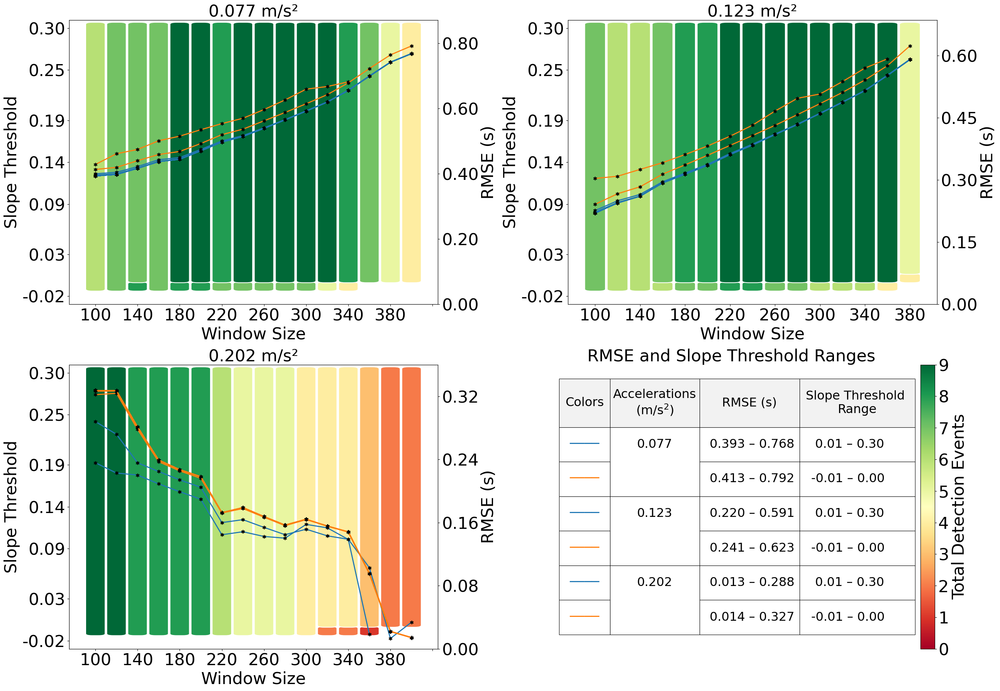

In [ ]:
# CORRECT CODE USED FOR PAPER (FULL + TABLE PANEL)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.lines import Line2D
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FormatStrFormatter


# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 0.8
TILE_HEIGHT = 0.9
TILE_GAP = 0.4

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")
df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] -
    df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 400
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = [200, 300, 500]
all_window_sizes = sorted(summary_df["WindowSize"].unique())

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(2, 2, figsize=(26, 18))
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

# =========================
# MAIN HEATMAP PANELS
# =========================
for ax, acc in zip(axes[:3], accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    visible = heatmap.index[
        (heatmap.index >= -0.01) &
        (heatmap.index <= 0.30)
    ]
    padded = np.sort(np.unique([padding_min, *visible, padding_max]))
    heatmap = heatmap.reindex(padded, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_pos = np.arange(n_rows) * (TILE_HEIGHT + TILE_GAP)

    ax.set_ylim(-0.9*TILE_HEIGHT, y_pos[-1] + TILE_HEIGHT*1.9)

    idx = np.round(np.linspace(0, n_rows-1, min(7, n_rows))).astype(int)
    ax.set_yticks(y_pos[idx] + TILE_HEIGHT/2)
    ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in idx], fontsize=31)

    x_pos = np.arange(len(all_window_sizes))
    ax.set_xticks(x_pos)
    ax.set_xticklabels(all_window_sizes, fontsize=31)
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))

    ax.set_title(ACC_TITLES[acc], fontsize=31)
    ax.set_xlabel("Window Size", fontsize=31)
    ax.set_ylabel("Slope Threshold", fontsize=31)

    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k+1 < n_rows and col[k+1] == col[i]:
                k += 1
            height = (k-i+1)*(TILE_HEIGHT+TILE_GAP)
            ax.add_patch(
                FancyBboxPatch(
                    (x_pos[j]-TILE_WIDTH/2, y_pos[i]),
                    TILE_WIDTH, height,
                    boxstyle="round,pad=0.06,rounding_size=0.30",
                    facecolor=cmap((col[i]-vmin)/(vmax-vmin)),
                    edgecolor="white",
                    linewidth=1.5
                )
            )
            i = k + 1

    # RMSE curves
    th_med = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_med[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    th_med["Cluster"] = KMeans(
        n_clusters=best_k, n_init=20, random_state=0
    ).fit_predict(X)

    order = (
        th_med.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_med["Cluster"] = th_med["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    # ax_r = ax.twinx()
    # ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max()*1.1)
    # ax_r.set_ylabel("RMSE (s)", fontsize=20)
    # ax_r.tick_params(axis="y", labelsize=20)

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max()*1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=31)
    ax_r.tick_params(axis="y", labelsize=31)

    ax_r.yaxis.set_major_formatter(FormatStrFormatter("%.2f"))
    ax_r.yaxis.set_major_locator(MaxNLocator(nbins=5))


    colors = plt.cm.tab10.colors
    for c in sorted(th_med["Cluster"].unique()):
        for th in th_med[th_med["Cluster"] == c]["Threshold"]:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )
            ax_r.plot(x_pos, curve["RMSE_seconds"],
                      linestyle="--", color="gray", alpha=0.6)
            ax_r.plot(x_pos, curve["RMSE_seconds"],
                      color=colors[c], linewidth=2,
                      marker="$*$", markeredgecolor="black",
                      markersize=6)

# =========================
# TABLE + HEATMAP PANEL
# =========================
# ax = axes[3]
# ax.clear()

# table_df = pd.DataFrame({
#     "Acceleration (m/s²)": ["0.077","0.077","0.123","0.123","0.202","0.202"],
#     "RMSE Range (s)": ["0.393–0.768","0.413–0.792","0.220–0.591",
#                        "0.241–0.623","0.013–0.288","0.014–0.327"],
#     "Threshold Range": ["0.01–0.30","−0.01–0.00","0.01–0.30",
#                         "−0.01–0.00","−0.01–0.00","0.01–0.30"]
# })

# tbl = ax.table(
#     cellText=table_df.values,
#     colLabels=table_df.columns,
#     cellLoc="center",
#     colLoc="center",
#     bbox=[0, 0.48, 1, 0.50]
# )
# tbl.auto_set_font_size(False)
# tbl.set_fontsize(14)

# for (r, c), cell in tbl.get_celld().items():
#     if r == 0:
#         cell.set_text_props(weight="bold")
#         cell.set_facecolor("#E6E6E6")
#     cell.set_edgecolor("black")

# heat_vals = np.array([
#     [0.393,0.768],
#     [0.413,0.792],
#     [0.220,0.591],
#     [0.241,0.623],
#     [0.013,0.288],
#     [0.014,0.327]
# ])

# im = ax.imshow(
#     heat_vals, cmap="RdYlGn_r",
#     aspect="auto", origin="lower",
#     extent=[0,2,0,6]
# )

# ax.set_xticks([0.5,1.5])
# ax.set_xticklabels(["Min RMSE","Max RMSE"], fontsize=14)
# ax.set_yticks(np.arange(6)+0.5)
# ax.set_yticklabels([
#     "0.077 (0.01–0.30)",
#     "0.077 (−0.01–0.00)",
#     "0.123 (0.01–0.30)",
#     "0.123 (−0.01–0.00)",
#     "0.202 (−0.01–0.00)",
#     "0.202 (0.01–0.30)"
# ], fontsize=13)

# cbar = fig.colorbar(im, ax=ax, fraction=0.04, pad=0.04)
# cbar.set_label("RMSE (s)", fontsize=14)
# =========================
# TABLE PANEL (MATCHING PROVIDED FIGURE)
# =========================
ax = axes[3]
ax.clear()
ax.axis("off")

# ---- Table content (exact) ----
# rows = [
#     ["", "0.077", "0.393 – 0.768", "0.01 – 0.30"],
#     ["", "",     "0.413 – 0.792", "-0.01 – 0.00"],
#     ["", "0.123", "0.220 – 0.591", "0.01 – 0.30"],
#     ["", "",     "0.241 – 0.623", "-0.01 – 0.00"],
#     ["", "0.202", "0.013 – 0.288", "0.01 – 0.30"],
#     ["", "",     "0.014 – 0.327", "-0.01 – 0.00"],
# ]
rows = [
    ["", "0.077", "0.393 – 0.768", " 0.01 – 0.30"],
    ["", "",     "0.413 – 0.792", "-0.01 – 0.00"],
    ["", "0.123", "0.220 – 0.591", " 0.01 – 0.30"],
    ["", "",     "0.241 – 0.623", "-0.01 – 0.00"],
    ["", "0.202", "0.013 – 0.288", " 0.01 – 0.30"],
    ["", "",     "0.014 – 0.327", "-0.01 – 0.00"],
]


columns = [
    "Colors",
    "Accelerations\n(m/s$^2$)",
    # "Accelerations (m/s^2)",
    "RMSE (s)",
    "Slope Threshold \nRange"
]

# ---- Draw table ----
table = ax.table(
    cellText=rows,
    colLabels=columns,
    cellLoc="left",
    colLoc="center",
    loc="center",
    bbox=[-0.027, 0.05, 1.09, 0.90],
    colWidths=[3.95, 6.95, 7.76, 8.97]  # ← KEY FIX
)
# bbox=[-0.025, 0.05, 1.05, 0.90]
# colWidths=[0.10, 0.26, 0.22, 0.32]


# ---- Draw table ----
# table = ax.table(
#     cellText=rows,
#     colLabels=columns,
#     cellLoc="left",
#     colLoc="center",
#     loc="center",
#     bbox=[0.02, 0.05, 0.90, 0.90]
# )
# table = ax.table(
#     cellText=rows,
#     colLabels=columns,
#     cellLoc="left",
#     colLoc="center",
#     loc="center",
#     bbox=[0.02, 0.05, 0.90, 0.90],
#     colWidths=[0.10, 0.26, 0.22, 0.32]  # <<< FIX
# )


table.auto_set_font_size(False)
table.set_fontsize(23)

# =========================
# MERGE ACCELERATION CELLS (VISUAL MERGE)
# =========================
# merge_groups = [
#     (1, 2),  # 0.077
#     (3, 4),  # 0.123
#     (5, 6),  # 0.202
# ]

# acc_text = ["0.077", "0.123", "0.202"]

# for (r1, r2), txt in zip(merge_groups, acc_text):
#     top_cell = table[(r1, 1)]
#     bot_cell = table[(r2, 1)]

#     # Text only in top cell
#     top_cell.get_text().set_text(txt)
#     top_cell.get_text().set_ha("center")
#     top_cell.get_text().set_va("center")
#     top_cell.get_text().set_fontsize(14)

#     bot_cell.get_text().set_text("")

#     # Remove inner border
#     top_cell.visible_edges = "TLR"
#     bot_cell.visible_edges = "BLR"

#     # Span two rows
#     top_cell.set_height(
#         top_cell.get_height() + bot_cell.get_height()
#     )

merge_groups = [(1, 2), (3, 4), (5, 6)]
acc_text = ["0.077", "0.123", "0.202"]

for (r1, r2), txt in zip(merge_groups, acc_text):
    top = table[(r1, 1)]
    bot = table[(r2, 1)]

    # Put text in top cell only
    top.get_text().set_text(txt)
    top.get_text().set_ha("center")
    top.get_text().set_va("center")
    top.get_text().set_fontsize(23)

    # Clear bottom cell text
    bot.get_text().set_text("")

    # Remove ONLY the internal horizontal line
    top.visible_edges = "TLR"   # no bottom edge
    bot.visible_edges = "BLR"   # no top edge

    # Adjust padding to visually center across both rows
    top.PAD = 0.30
    bot.PAD = 0.30


# Increase header row height
for c in range(len(columns)):
    cell = table[(0, c)]
    cell.set_height(cell.get_height() * 1.4)

# ---- Header styling ----
for c in range(len(columns)):
    cell = table[(0, c)]
    cell.set_text_props(weight="normal")
    cell.set_facecolor("#F2F2F2")
    cell.set_edgecolor("black")

# ---- Grid styling ----
for (r, c), cell in table.get_celld().items():
    cell.set_edgecolor("black")
    cell.set_linewidth(0.8)

# ---- Draw color indicators (blue/orange lines) ----
color_pairs = [
    ("tab:blue", "tab:orange"),
    ("tab:blue", "tab:orange"),
    ("tab:blue", "tab:orange"),
]

row_map = [(1, 2), (3, 4), (5, 6)]

for (r1, r2), (c1, c2) in zip(row_map, color_pairs):
    for r, col in zip([r1, r2], [c1, c2]):
        cell = table[(r, 0)]
        cell.get_text().set_text("────")
        cell.get_text().set_color(col)
        cell.get_text().set_fontsize(23)
        # cell._loc = "center"
        cell.get_text().set_ha("center")
        cell.get_text().set_va("center")


# ---- RMSE colorbar (right side) ----
# rmse_vals = np.array([
#     0.393, 0.768, 0.413, 0.792,
#     0.220, 0.591, 0.241, 0.623,
#     0.013, 0.288, 0.014, 0.327
# ])

# norm = plt.Normalize(rmse_vals.min(), rmse_vals.max())
# sm = plt.cm.ScalarMappable(norm=norm, cmap="RdYlGn_r")
# sm.set_array([])

# cbar = fig.colorbar(
#     sm,
#     ax=ax,
#     fraction=0.045,
#     pad=0.05
# )
# cbar.set_label("RMSE (s)", fontsize=20)
# cbar.ax.tick_params(labelsize=20)

from matplotlib.ticker import MaxNLocator
from matplotlib.cm import ScalarMappable

# ---- Heatmap colorbar (raw counts of total detections) ----
sm = ScalarMappable(
    norm=plt.Normalize(vmin=0, vmax=summary_df["Total"].max()),
    cmap=cmap
)
sm.set_array([])

cbar = fig.colorbar(
    sm,
    ax=ax,
    fraction=0.045,  # adjust size
    pad=0.07         # adjust distance from plot
)

# Force integer ticks
cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
cbar.ax.tick_params(labelsize=31)

# Set the colorbar label
cbar.set_label("Total Detection Events", fontsize=31)


ax.set_title("RMSE and Slope Threshold Ranges", fontsize=31)# fonts 28 was used instead of 31 for paper

plt.tight_layout()
plt.show()


/tmp/ipython-input-147401852.py:291: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.12, 1, 0.95])


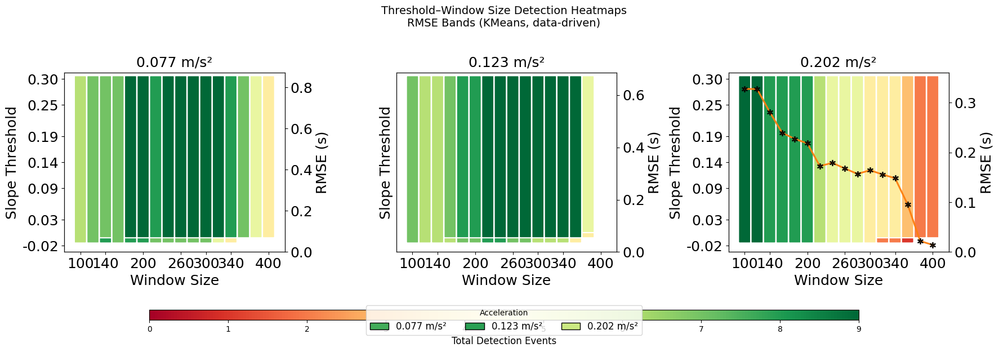

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch, Patch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE CONTROLS
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.9
TILE_GAP = 0.9

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

rmse_legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # -------------------------
    # HARD TILE CUTOFF
    # -------------------------
    visible_thresholds = heatmap.index[
        (heatmap.index >= -0.01) &
        (heatmap.index <= 0.30)
    ]

    padded_thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * (TILE_HEIGHT * 1.15)

    ax.set_ylim(
        -0.9 * TILE_HEIGHT,
        y_positions[-1] + TILE_HEIGHT * 1.9
    )

    # -------------------------
    # Y-axis ticks
    # -------------------------
    if acc in [200, 500]:
        idx = np.round(np.linspace(0, n_rows - 1, 7)).astype(int)
        ax.set_yticks(y_positions[idx] + TILE_HEIGHT / 2)
        ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in idx], fontsize=18)
    else:
        ax.set_yticks([])

    # -------------------------
    # X-axis
    # -------------------------
    idx = np.round(
        np.linspace(0, len(all_window_sizes) - 1,
                    min(7, len(all_window_sizes)))
    ).astype(int)

    ax.set_xticks(x_positions[idx])
    ax.set_xticklabels([str(all_window_sizes[i]) for i in idx], fontsize=18)

    ax.set_title(ACC_TITLES[acc], fontsize=18, pad=8)
    ax.set_xlabel("Window Size", fontsize=18)
    ax.set_ylabel("Slope Threshold", fontsize=18)

    # -------------------------
    # DRAW TILES (NO NUMBERS)
    # -------------------------
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue

            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1

            height = (k - i + 1) * TILE_HEIGHT * 1.15
            bottom = y_positions[i]
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.30",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.5
                )
            )
            i = k + 1

    # -------------------------
    # RMSE (RIGHT AXIS)
    # -------------------------
    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k, best_score = None, -1
    for k in [2, 3]:
        if len(X) <= k:
            continue
        labels = KMeans(n_clusters=k, n_init=20, random_state=0).fit_predict(X)
        score = silhouette_score(X, labels)
        if score > best_score:
            best_k, best_score = k, score

    kmeans = KMeans(n_clusters=best_k, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    order = (
        th_median.groupby("Cluster")["RMSE_seconds"]
        .mean().sort_values().index
    )
    th_median["Cluster"] = th_median["Cluster"].map(
        {c: i for i, c in enumerate(order)}
    )

    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=18)
    ax_r.tick_params(axis="y", labelsize=18)

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(all_window_sizes)
            )

            # ax_r.plot(x_positions, curve["RMSE_seconds"],
            #           "--", color="gray", alpha=0.6)
            # ax_r.plot(x_positions, curve["RMSE_seconds"],
            #           color=colors[c % len(colors)], lw=2)
            # --- gray dashed connector
ax_r.plot(
    x_positions,
    curve["RMSE_seconds"],
    linestyle="--",
    linewidth=1.0,
    color="gray",
    alpha=0.6,
    zorder=3
)

# --- colored RMSE curve WITH asterisks
ax_r.plot(
    x_positions,
    curve["RMSE_seconds"],
    color=colors[c % len(colors)],
    linewidth=2.2,
    marker="$*$",
    markersize=7,
    markeredgecolor="black",
    alpha=0.95,
    zorder=4
)


# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.15, 0.05, 0.7, 0.03])
cbar = fig.colorbar(sm, cax=cbar_ax, orientation="horizontal")
cbar.set_label("Total Detection Events", fontsize=12)

# =========================
# ACCELERATION LEGEND (NEW)
# =========================
acc_legend_items = []
for acc in accelerations:
    mean_total = summary_df[summary_df["Acceleration"] == acc]["Total"].mean()
    acc_legend_items.append(
        Patch(
            facecolor=cmap((mean_total - vmin) / (vmax - vmin)),
            edgecolor="black",
            label=ACC_TITLES[acc]
        )
    )

fig.legend(
    handles=acc_legend_items,
    loc="lower center",
    bbox_to_anchor=(0.5, -0.01),
    ncol=3,
    fontsize=12,
    title="Acceleration"
)

plt.suptitle(
    "Threshold–Window Size Detection Heatmaps\nRMSE Bands (KMeans, data-driven)",
    fontsize=14
)

plt.tight_layout(rect=[0, 0.12, 1, 0.95])
plt.show()


/tmp/ipython-input-1309244491.py:240: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.08, 1, 0.93])


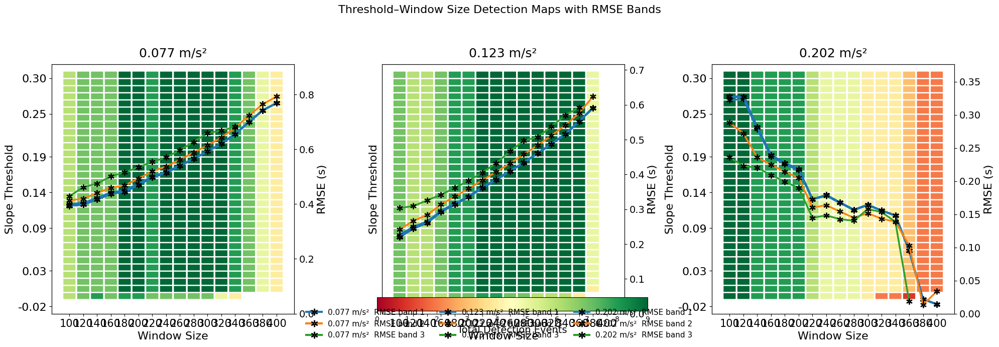

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# TILE CONTROLS (BIG BOXES)
# =========================
TILE_WIDTH = 29.0
TILE_HEIGHT = 0.7
TILE_GAP = 1.0

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df_valid["Frame_Error"] = (
    df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]
)

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# REMOVE 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(20, 7), sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=window_sizes)
        .fillna(0)
    )

    visible_thresholds = heatmap.index[
        (heatmap.index >= -0.01) & (heatmap.index <= 0.30)
    ]

    thresholds = np.sort(
        np.unique([padding_min, *visible_thresholds, padding_max])
    )

    heatmap = heatmap.reindex(thresholds, fill_value=0)

    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * TILE_HEIGHT

    ax.set_ylim(-TILE_HEIGHT, n_rows * TILE_HEIGHT + TILE_HEIGHT)

    # -------------------------
    # LEFT Y-AXIS (Threshold)
    # -------------------------
    if acc in [200, 500]:
        tick_idx = np.linspace(0, n_rows - 1, 7).round().astype(int)
        ax.set_yticks(y_positions[tick_idx])
        ax.set_yticklabels([f"{thresholds[i]:.2f}" for i in tick_idx], fontsize=16)
    else:
        ax.set_yticks([])

    # -------------------------
    # X-AXIS
    # -------------------------
    ax.set_xticks(x_positions)
    ax.set_xticklabels(window_sizes, fontsize=15)
    ax.set_xlabel("Window Size", fontsize=16)

    ax.set_title(ACC_TITLES[acc], fontsize=18, pad=10)
    ax.set_ylabel("Slope Threshold", fontsize=16)

    # -------------------------
    # DRAW BIG TILES
    # -------------------------
    for j, ws in enumerate(window_sizes):
        for i, val in enumerate(heatmap[ws].values):
            if val == 0:
                continue

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, y_positions[i]),
                    TILE_WIDTH,
                    TILE_HEIGHT,
                    boxstyle="round,pad=0.02",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.8
                )
            )

    # =========================
    # RMSE (RIGHT Y-AXIS)
    # =========================
    ax_r = ax.twinx()
    ax_r.set_ylabel("RMSE (s)", fontsize=16)
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.15)
    ax_r.tick_params(axis="y", labelsize=14)

    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    best_k = 2 if len(X) < 4 else 3
    labels = KMeans(n_clusters=best_k, n_init=20, random_state=0).fit_predict(X)
    th_median["Cluster"] = labels

    colors = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                linestyle="--",
                color="gray",
                alpha=0.6,
                zorder=3
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors[c],
                linewidth=2.5,
                marker="$*$",
                markersize=8,
                markeredgecolor="black",
                zorder=4
            )

        legend_items.append(
            Line2D(
                [0], [0],
                color=colors[c],
                lw=3,
                marker="$*$",
                markersize=9,
                markeredgecolor="black",
                label=f"{ACC_TITLES[acc]}  RMSE band {c+1}"
            )
        )

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar = fig.colorbar(sm, ax=axes, orientation="horizontal", pad=0.10, fraction=0.05)
cbar.set_label("Total Detection Events", fontsize=14)

# =========================
# LEGEND
# =========================
fig.legend(
    handles=legend_items,
    loc="lower center",
    bbox_to_anchor=(0.5, 0.01),
    ncol=3,
    fontsize=11,
    frameon=False
)

plt.suptitle(
    "Threshold–Window Size Detection Maps with RMSE Bands",
    fontsize=16
)

plt.tight_layout(rect=[0, 0.08, 1, 0.93])
plt.show()


/tmp/ipython-input-2900186612.py:208: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.05, 1, 0.93])


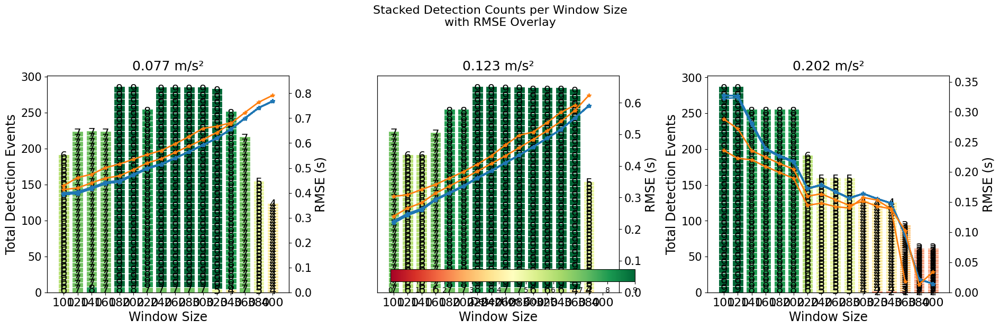

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# VISUAL CONTROLS
# =========================
BAR_WIDTH = 22
TEXT_SIZE = 16
TEXT_COLOR = "black"

# =========================
# CONSTANTS
# =========================
fs = 600
TH_MIN, TH_MAX = -0.01, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df["Frame_Error"] = df["Sensor_DetectedFrame"] - df["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
      .apply(lambda x: np.sqrt(np.mean(x**2)))
      .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# COUNTS
# =========================
summary_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])
      .size()
      .reset_index(name="Total")
)

# =========================
# REMOVE 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(window_sizes)) * (BAR_WIDTH + 6)

# =========================
# TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(19, 6), sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()
legend_items = []

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[
        (summary_df["Acceleration"] == acc) &
        (summary_df["Threshold"].between(TH_MIN, TH_MAX))
    ]

    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    thresholds = sorted(sub["Threshold"].unique())

    # --- stacked bars
    bottoms = np.zeros(len(window_sizes))

    for th in thresholds:
        vals = (
            sub[sub["Threshold"] == th]
            .set_index("WindowSize")
            .reindex(window_sizes)["Total"]
            .fillna(0)
            .values
        )

        colors = cmap((vals - vmin) / (vmax - vmin))

        bars = ax.bar(
            x_positions,
            vals,
            BAR_WIDTH,
            bottom=bottoms,
            color=colors,
            edgecolor="white",
            linewidth=0.8
        )

        # numbers inside bars
        for x, v, b in zip(x_positions, vals, bottoms):
            if v > 0:
                ax.text(
                    x,
                    b + v / 2,
                    f"{int(v)}",
                    ha="center",
                    va="center",
                    fontsize=TEXT_SIZE,
                    color=TEXT_COLOR,
                    fontfamily="monospace"
                )

        bottoms += vals

    # -------------------------
    # AXES
    # -------------------------
    ax.set_xticks(x_positions)
    ax.set_xticklabels(window_sizes, fontsize=16)
    ax.set_xlabel("Window Size", fontsize=17)

    ax.set_title(ACC_TITLES[acc], fontsize=18, pad=8)

    # Y-axis labels only for left & right
    if acc in [200, 500]:
        ax.set_ylabel("Total Detection Events", fontsize=17)
        ax.tick_params(axis="y", labelsize=15)
    else:
        ax.set_yticks([])

    # =========================
    # RMSE OVERLAY
    # =========================
    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=17)
    ax_r.tick_params(axis="y", labelsize=15)

    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    kmeans = KMeans(n_clusters=2, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    colors_rmse = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors_rmse[c],
                linewidth=2.0,
                marker="*",
                markersize=6
            )

        legend_items.append(
            Line2D([0], [0], color=colors_rmse[c], lw=3,
                   label=f"{acc} RMSE cluster {c+1}")
        )

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar = fig.colorbar(sm, ax=axes, orientation="horizontal", fraction=0.05, pad=0.12)
cbar.set_label("Detection Count", fontsize=14)

# =========================
# TITLE
# =========================
plt.suptitle(
    "Stacked Detection Counts per Window Size\nwith RMSE Overlay",
    fontsize=16
)

plt.tight_layout(rect=[0, 0.05, 1, 0.93])
plt.show()


/tmp/ipython-input-3372723862.py:198: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.15, 1, 0.92])


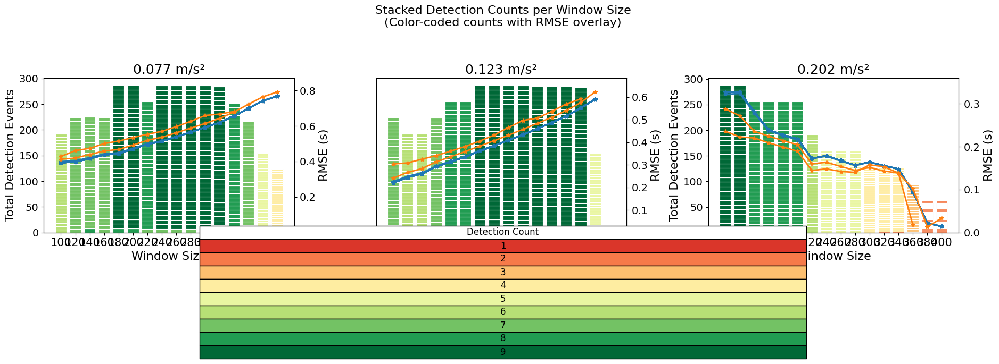

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# VISUAL CONTROLS
# =========================
BAR_WIDTH = 22
TEXT_SIZE = 14

# =========================
# CONSTANTS
# =========================
fs = 600
TH_MIN, TH_MAX = -0.01, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df["Frame_Error"] = df["Sensor_DetectedFrame"] - df["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
      .apply(lambda x: np.sqrt(np.mean(x**2)))
      .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# COUNTS
# =========================
summary_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])
      .size()
      .reset_index(name="Total")
)

# =========================
# REMOVE 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
window_sizes  = sorted(summary_df["WindowSize"].unique())
x_positions   = np.arange(len(window_sizes)) * (BAR_WIDTH + 6)

# =========================
# TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(19, 6), sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[
        (summary_df["Acceleration"] == acc) &
        (summary_df["Threshold"].between(TH_MIN, TH_MAX))
    ]

    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]
    thresholds = sorted(sub["Threshold"].unique())

    bottoms = np.zeros(len(window_sizes))

    for th in thresholds:
        vals = (
            sub[sub["Threshold"] == th]
            .set_index("WindowSize")
            .reindex(window_sizes)["Total"]
            .fillna(0)
            .values
        )

        colors = cmap((vals - vmin) / (vmax - vmin))

        ax.bar(
            x_positions,
            vals,
            BAR_WIDTH,
            bottom=bottoms,
            color=colors,
            edgecolor="white",
            linewidth=0.8
        )

        bottoms += vals

    # -------------------------
    # AXES
    # -------------------------
    ax.set_xticks(x_positions)
    ax.set_xticklabels(window_sizes, fontsize=15)
    ax.set_xlabel("Window Size", fontsize=16)
    ax.set_title(ACC_TITLES[acc], fontsize=18)

    if acc in [200, 500]:
        ax.set_ylabel("Total Detection Events", fontsize=16)
        ax.tick_params(axis="y", labelsize=14)
    else:
        ax.set_yticks([])

    # =========================
    # RMSE OVERLAY
    # =========================
    ax_r = ax.twinx()
    ax_r.set_ylim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_r.set_ylabel("RMSE (s)", fontsize=16)
    ax_r.tick_params(axis="y", labelsize=14)

    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    kmeans = KMeans(n_clusters=2, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    colors_rmse = plt.cm.tab10.colors

    for c in sorted(th_median["Cluster"].unique()):
        ths = th_median[th_median["Cluster"] == c]["Threshold"]

        for th in ths:
            curve = (
                rmse_sub[rmse_sub["Threshold"] == th]
                .set_index("WindowSize")
                .reindex(window_sizes)
            )

            ax_r.plot(
                x_positions,
                curve["RMSE_seconds"],
                color=colors_rmse[c],
                linewidth=2,
                marker="*",
                markersize=6
            )

# =========================
# COLOR → COUNT TABLE
# =========================
unique_counts = sorted(summary_df["Total"].unique())
table_colors = [cmap((c - vmin) / (vmax - vmin)) for c in unique_counts]

table_ax = fig.add_axes([0.25, 0.02, 0.5, 0.12])
table_ax.axis("off")

cell_text = [[str(c)] for c in unique_counts]
cell_colors = [[col] for col in table_colors]

table = table_ax.table(
    cellText=cell_text,
    cellColours=cell_colors,
    colLabels=["Detection Count"],
    loc="center",
    cellLoc="center"
)

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 1.5)

# =========================
# TITLE
# =========================
plt.suptitle(
    "Stacked Detection Counts per Window Size\n(Color-coded counts with RMSE overlay)",
    fontsize=16
)

plt.tight_layout(rect=[0, 0.15, 1, 0.92])
plt.show()


/tmp/ipython-input-1983613338.py:187: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.05, 1, 0.93])


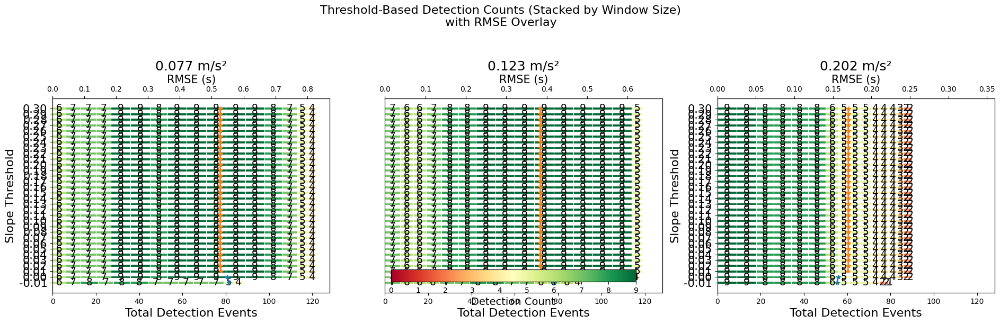

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D

# =========================
# VISUAL CONTROLS
# =========================
BAR_HEIGHT = 0.45
TEXT_SIZE = 14

# =========================
# CONSTANTS
# =========================
fs = 600
TH_MIN, TH_MAX = -0.01, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()

df["Frame_Error"] = df["Sensor_DetectedFrame"] - df["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
      .apply(lambda x: np.sqrt(np.mean(x**2)))
      .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# COUNTS
# =========================
summary_df = (
    df.groupby(["Acceleration", "Threshold", "WindowSize"])
      .size()
      .reset_index(name="Total")
)

# =========================
# REMOVE 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
window_sizes = sorted(summary_df["WindowSize"].unique())

# =========================
# TITLES
# =========================
ACC_TITLES = {
    200: "0.077 m/s²",
    300: "0.123 m/s²",
    500: "0.202 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(19, 6), sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

# =========================
# MAIN LOOP
# =========================
for ax, acc in zip(axes, accelerations):

    sub = summary_df[
        (summary_df["Acceleration"] == acc) &
        (summary_df["Threshold"].between(TH_MIN, TH_MAX))
    ]

    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    thresholds = np.sort(sub["Threshold"].unique())
    y_pos = np.arange(len(thresholds))

    lefts = np.zeros(len(thresholds))

    # -------------------------
    # STACKED HORIZONTAL BARS
    # -------------------------
    for ws in window_sizes:
        vals = (
            sub[sub["WindowSize"] == ws]
            .set_index("Threshold")
            .reindex(thresholds)["Total"]
            .fillna(0)
            .values
        )

        colors = cmap((vals - vmin) / (vmax - vmin))

        bars = ax.barh(
            y_pos,
            vals,
            height=BAR_HEIGHT,
            left=lefts,
            color=colors,
            edgecolor="white",
            linewidth=0.8
        )

        for y, v, l in zip(y_pos, vals, lefts):
            if v > 0:
                ax.text(
                    l + v / 2,
                    y,
                    f"{int(v)}",
                    ha="center",
                    va="center",
                    fontsize=TEXT_SIZE,
                    fontfamily="monospace"
                )

        lefts += vals

    # -------------------------
    # Y-AXIS (THRESHOLD)
    # -------------------------
    if acc in [200, 500]:
        ax.set_yticks(y_pos)
        ax.set_yticklabels([f"{t:.2f}" for t in thresholds], fontsize=15)
        ax.set_ylabel("Slope Threshold", fontsize=16)
    else:
        ax.set_yticks([])

    ax.set_xlabel("Total Detection Events", fontsize=16)
    ax.set_title(ACC_TITLES[acc], fontsize=18)

    # -------------------------
    # RMSE OVERLAY (TOP AXIS)
    # -------------------------
    ax_top = ax.twiny()
    ax_top.set_xlim(0, rmse_sub["RMSE_seconds"].max() * 1.1)
    ax_top.set_xlabel("RMSE (s)", fontsize=15)

    th_median = rmse_sub.groupby("Threshold")["RMSE_seconds"].median().reset_index()
    X = th_median[["RMSE_seconds"]].values

    kmeans = KMeans(n_clusters=2, n_init=20, random_state=0)
    th_median["Cluster"] = kmeans.fit_predict(X)

    for c in th_median["Cluster"].unique():
        ths = th_median[th_median["Cluster"] == c]["Threshold"]
        ys = [np.where(thresholds == t)[0][0] for t in ths]

        ax_top.plot(
            th_median.loc[ths.index, "RMSE_seconds"],
            ys,
            marker="*",
            linewidth=2
        )

# =========================
# COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar = fig.colorbar(sm, ax=axes, orientation="horizontal", fraction=0.05, pad=0.12)
cbar.set_label("Detection Count", fontsize=14)

# =========================
# TITLE
# =========================
plt.suptitle(
    "Threshold-Based Detection Counts (Stacked by Window Size)\nwith RMSE Overlay",
    fontsize=16
)

plt.tight_layout(rect=[0, 0.05, 1, 0.93])
plt.show()


/tmp/ipython-input-1123917597.py:203: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.05, 1, 0.95])


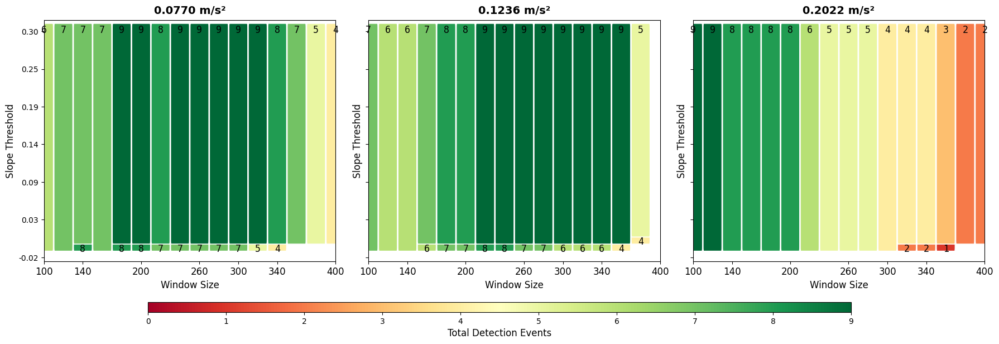

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import FancyBboxPatch
from matplotlib.cm import ScalarMappable

# =========================
# TILE & TEXT CONTROLS
# =========================
TILE_WIDTH = 15.0
TILE_HEIGHT = 0.5
TILE_GAP = 0.6

TEXT_SIZE = 12
TEXT_COLOR = "black"
TEXT_PADDING_FRAC = 0.10

# =========================
# CONSTANTS
# =========================
fs = 600
padding_min, padding_max = -0.02, 0.30

# =========================
# LOAD DATA
# =========================
df = pd.read_csv("slope_detection_summary112NEW.csv")

df_valid = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0)
].copy()
df_valid["Frame_Error"] = df_valid["Sensor_DetectedFrame"] - df_valid["Marker_DetectedFrame"]

# =========================
# RMSE
# =========================
rmse_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x**2)))
    .reset_index(name="RMSE_frames")
)
rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs

# =========================
# DETECTION COUNTS
# =========================
summary_df = (
    df_valid
    .groupby(["Acceleration", "Threshold", "WindowSize"])
    .size()
    .reset_index(name="Total")
)

# =========================
# EXCLUDE ACCELERATION 0.1673 m/s²
# =========================
summary_df = summary_df[summary_df["Acceleration"] != 400]
rmse_df     = rmse_df[rmse_df["Acceleration"] != 400]

accelerations = sorted(summary_df["Acceleration"].unique())
all_window_sizes = sorted(summary_df["WindowSize"].unique())
x_positions = np.arange(len(all_window_sizes)) * (TILE_WIDTH + TILE_GAP)

# =========================
# ACCELERATION TITLES
# =========================
ACC_TITLES = {
    200: "0.0770 m/s²",
    300: "0.1236 m/s²",
    500: "0.2022 m/s²"
}

# =========================
# FIGURE
# =========================
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True, sharex=True)
axes = axes.flatten()

cmap = plt.cm.RdYlGn
vmin, vmax = 0, summary_df["Total"].max()

# =========================
# MAIN LOOP
# =========================
rmse_summary = []  # for compact RMSE table

for ax, acc in zip(axes, accelerations):
    sub = summary_df[summary_df["Acceleration"] == acc]
    rmse_sub = rmse_df[rmse_df["Acceleration"] == acc]

    heatmap = (
        sub.pivot(index="Threshold", columns="WindowSize", values="Total")
        .reindex(columns=all_window_sizes)
        .fillna(0)
    )

    # HARD TILE CUTOFF
    TILE_THRESHOLD_MIN = -0.01
    TILE_THRESHOLD_MAX = 0.30
    visible_thresholds = heatmap.index[(heatmap.index >= TILE_THRESHOLD_MIN) & (heatmap.index <= TILE_THRESHOLD_MAX)]
    padded_thresholds = np.sort(np.unique([padding_min, *visible_thresholds, padding_max]))
    heatmap = heatmap.reindex(padded_thresholds, fill_value=0)

    thresholds = heatmap.index.values
    n_rows = len(thresholds)
    y_positions = np.arange(n_rows) * TILE_HEIGHT

    # AXIS SCALING
    pad_tiles = 0.6
    ax.set_ylim(-pad_tiles * TILE_HEIGHT, n_rows * TILE_HEIGHT + pad_tiles * TILE_HEIGHT)

    y_first, y_last = thresholds[0], thresholds[-1]
    y_tick_vals = np.linspace(y_first, y_last, 7)
    y_tick_pos = np.interp(y_tick_vals, thresholds, y_positions)
    ax.set_yticks(y_tick_pos)
    ax.set_yticklabels([f"{t:.2f}" for t in y_tick_vals])

    tick_idx = np.round(np.linspace(0, len(all_window_sizes) - 1, min(7, len(all_window_sizes)))).astype(int)
    ax.set_xticks(x_positions[tick_idx])
    ax.set_xticklabels([str(all_window_sizes[i]) for i in tick_idx], fontsize=12)

    ax.set_title(ACC_TITLES[acc], fontsize=14, fontweight="bold", pad=8)
    ax.set_xlabel("Window Size", fontsize=12)
    ax.set_ylabel("Slope Threshold", fontsize=12)
    ax.tick_params(axis="y", labelsize=10)

    # DRAW TILES
    for j, ws in enumerate(all_window_sizes):
        col = heatmap[ws].values
        i = 0
        while i < n_rows:
            if col[i] == 0:
                i += 1
                continue
            k = i
            while k + 1 < n_rows and col[k + 1] == col[i]:
                k += 1
            height = (k - i + 1) * TILE_HEIGHT
            bottom = i * TILE_HEIGHT
            val = col[i]

            ax.add_patch(
                FancyBboxPatch(
                    (x_positions[j] - TILE_WIDTH / 2, bottom),
                    TILE_WIDTH,
                    height,
                    boxstyle="round,pad=0.06,rounding_size=0.29",
                    facecolor=cmap((val - vmin) / (vmax - vmin)),
                    edgecolor="white",
                    linewidth=1.2
                )
            )

            ax.text(
                x_positions[j],
                bottom + height - TEXT_PADDING_FRAC * TILE_HEIGHT,
                f"{int(val)}",
                ha="center",
                va="top",
                fontsize=TEXT_SIZE,
                fontfamily="monospace",
                color=TEXT_COLOR
            )
            i = k + 1

    # STORE RMSE MIN-MAX FOR LEGEND
    rmse_summary.append({
        "Acceleration": ACC_TITLES[acc],
        "RMSE (s)": f"{rmse_sub['RMSE_seconds'].min():.3f} – {rmse_sub['RMSE_seconds'].max():.3f}"
    })

# =========================
# HEATMAP COLORBAR
# =========================
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])  # horizontal colorbar
cbar = fig.colorbar(sm, cax=cbar_ax, orientation="horizontal")
cbar.set_label("Total Detection Events", fontsize=12)

# =========================
# RMSE LEGEND AS TABLE BELOW COLORBAR
# =========================
# cell_text = [[r["RMSE (s)"]] for r in rmse_summary]
# row_labels = [r["Acceleration"] for r in rmse_summary]

# table = plt.table(cellText=cell_text,
#                   rowLabels=row_labels,
#                   colLabels=["RMSE (s)"],
#                   cellLoc='center',
#                   rowLoc='center',
#                   colLoc='center',
#                   bbox=[0.15, 0.03, 0.7, 0.08])  # adjust to sit below colorbar
# table.auto_set_font_size(False)
# table.set_fontsize(10)

# plt.suptitle(
#     "Threshold–Window Size Detection Heatmaps\nRMSE Summary (Min–Max, s)",
#     fontsize=14
# )
plt.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.show()


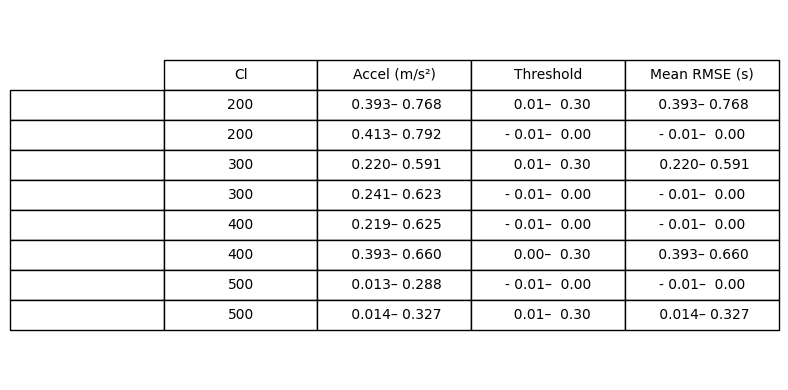

In [ ]:
import matplotlib.pyplot as plt

# =========================
# MANUAL TABLE DATA
# =========================
headers = ["Cl", "Accel (m/s²)", "Threshold", "Mean RMSE (s)"]
# Content: each row is a list of strings
rows = [
    ["200", "0.393–0.768", "0.01–0.30", "0.393–0.768"],
    ["200", "0.413–0.792", "-0.01–0.00", "-0.01–0.00"],
    ["300", "0.220–0.591", "0.01–0.30", "0.220–0.591"],
    ["300", "0.241–0.623", "-0.01–0.00", "-0.01–0.00"],
    ["400", "0.219–0.625", "-0.01–0.00", "-0.01–0.00"],
    ["400", "0.393–0.660", "0.00–0.30", "0.393–0.660"],
    ["500", "0.013–0.288", "-0.01–0.00", "-0.01–0.00"],
    ["500", "0.014–0.327", "0.01–0.30", "0.014–0.327"]
]

# =========================
# ALIGN NUMBERS
# =========================
# Replace minus sign spacing so all numbers line up
def align_numbers(cell):
    # split by range
    parts = cell.split("–")
    aligned_parts = []
    for p in parts:
        p = p.strip()
        # pad negative numbers with space for alignment
        if p.startswith("-"):
            p = "-" + p[1:].rjust(5)
        else:
            p = p.rjust(6)
        aligned_parts.append(p)
    return "–".join(aligned_parts)

rows_aligned = []
for r in rows:
    # Corrected: apply align_numbers only to columns 1, 2, and 3
    new_row = [r[0]] + [align_numbers(c) for c in r[1:]]
    rows_aligned.append(new_row)

# =========================
# PLOT TABLE
# =========================
fig, ax = plt.subplots(figsize=(8, 4))
ax.axis("off")  # hide axes

# Explicitly define colColours, rowColours, and colWidths to avoid any implicit sizing issues
num_cols = len(headers)
num_rows = len(rows_aligned)
col_widths = [1/num_cols] * num_cols # Equal width for all columns
header_colors = ['white'] * num_cols
row_colors = ['white'] * num_rows # Or use a list of colors per row if needed

table = ax.table(cellText=rows_aligned,
                 colLabels=headers,
                 colColours=header_colors, # Ensure explicit colors are passed
                 rowColours=row_colors, # Ensure explicit colors are passed
                 colWidths=col_widths, # Ensure explicit widths are passed
                 cellLoc='center',
                 rowLoc='center',
                 loc='center')

table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1.5)  # scale rows

plt.tight_layout()
plt.show()

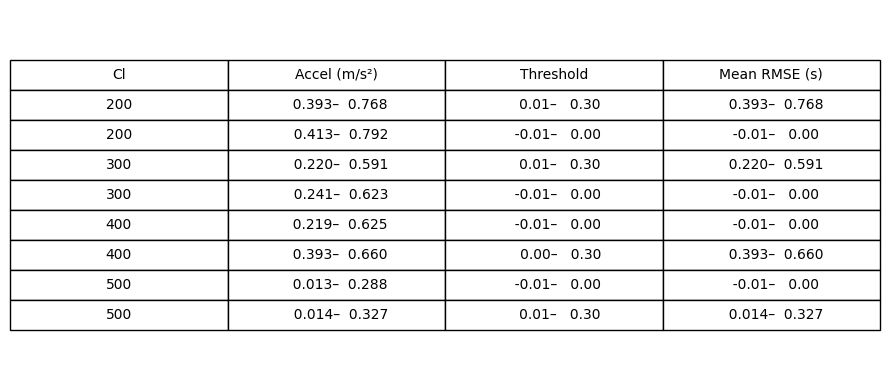

In [ ]:
import matplotlib.pyplot as plt

# =========================
# MANUAL TABLE DATA
# =========================
headers = ["Cl", "Accel (m/s²)", "Threshold", "Mean RMSE (s)"]

# Each row must have exactly 4 elements
rows = [
    ["200", "0.393–0.768", "0.01–0.30", "0.393–0.768"],
    ["200", "0.413–0.792", "-0.01–0.00", "-0.01–0.00"],
    ["300", "0.220–0.591", "0.01–0.30", "0.220–0.591"],
    ["300", "0.241–0.623", "-0.01–0.00", "-0.01–0.00"],
    ["400", "0.219–0.625", "-0.01–0.00", "-0.01–0.00"],
    ["400", "0.393–0.660", "0.00–0.30", "0.393–0.660"],
    ["500", "0.013–0.288", "-0.01–0.00", "-0.01–0.00"],
    ["500", "0.014–0.327", "0.01–0.30", "0.014–0.327"]
]

# =========================
# ALIGN NUMBERS
# =========================
def pad_number(cell):
    """Pad numbers and minus signs to align columns nicely"""
    if "–" in cell:  # range
        left, right = cell.split("–")
        left = left.rjust(7)  # pad to 7 chars
        right = right.rjust(7)
        return f"{left}–{right}"
    else:
        return cell.rjust(7)

# Apply only to numeric columns (columns 1,2,3)
rows_aligned = []
for r in rows:
    new_row = [r[0]] + [pad_number(c) for c in r[1:]]
    rows_aligned.append(new_row)

# =========================
# PLOT TABLE
# =========================
fig, ax = plt.subplots(figsize=(9, 4))
ax.axis("off")  # hide axes

table = ax.table(cellText=rows_aligned,
                 colLabels=headers,
                 cellLoc='center',
                 rowLoc='center',
                 loc='center')

table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1.5)  # scale rows for readability

plt.tight_layout()
plt.show()


In [ ]:
# ======================================================
# RIGHT PANEL: Stacked detection-event bars per range
# ======================================================

ax_hist.clear()

x_pos = np.arange(len(accelerations_of_interest))
bar_width = 0.6

for i, acc in enumerate(accelerations_of_interest):
    acc_data = summary[summary["Acceleration"] == acc]

    bottom = 0  # stacking baseline

    for _, row in acc_data.iterrows():
        height = row["Total"]

        # Draw stacked bar
        ax_hist.bar(
            i,
            height,
            bottom=bottom,
            width=bar_width,
            color=acc_colors[acc],
            edgecolor="black",
            alpha=0.85
        )

        # Vertical label inside bar
        ax_hist.text(
            i,
            bottom + height / 2,
            row["Range"],
            ha="center",
            va="center",
            rotation=90,
            fontsize=9,
            color="black"
        )

        bottom += height

# -------------------------
# Axis formatting
# -------------------------
ax_hist.set_xticks(x_pos)
ax_hist.set_xticklabels(accelerations_of_interest)
ax_hist.set_xlabel("Acceleration")
ax_hist.set_ylabel("Total Detection Events")
ax_hist.set_title("Detection Events by Threshold–Window Ranges")
ax_hist.grid(axis="y", linestyle="--", alpha=0.6)


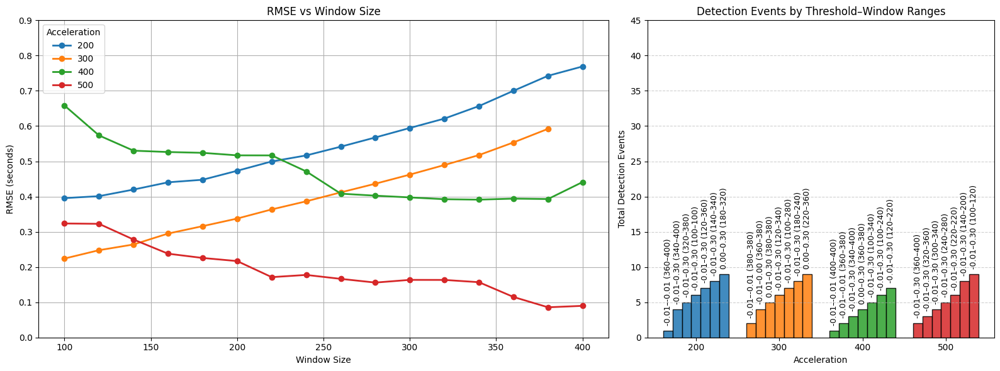

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================================================
# USER CONTROLS
# =====================================================
fs = 600
accelerations = [200, 300, 400, 500]

RMSE_YMAX = 0.9        # <-- MANUAL RMSE plot height
EVENT_YMAX = 45        # <-- MANUAL histogram height
group_spacing = 1.6   # <-- SPACE between acceleration histograms
bar_width = 0.18      # <-- width of each histogram bar

# =====================================================
# Load data
# =====================================================
df = pd.read_csv("slope_detection_summary112.csv")

# =====================================================
# ---------- RMSE COMPUTATION (LEFT PANEL) ------------
# =====================================================
df_rmse = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Marker_DetectedFrame"] != 0) &
    (df["Acceleration"].isin(accelerations))
].copy()

df_rmse["Frame_Error"] = (
    df_rmse["Sensor_DetectedFrame"] - df_rmse["Marker_DetectedFrame"]
)

rmse_df = (
    df_rmse
    .groupby(["Acceleration", "WindowSize"])["Frame_Error"]
    .apply(lambda x: np.sqrt(np.mean(x ** 2)))
    .reset_index(name="RMSE_frames")
)

rmse_df["RMSE_seconds"] = rmse_df["RMSE_frames"] / fs
rmse_df = rmse_df.sort_values(["Acceleration", "WindowSize"])

# =====================================================
# ---------- DETECTION EVENT COUNTS -------------------
# =====================================================
df_detected = df[
    (df["Sensor_DetectedFrame"] != 0) &
    (df["Acceleration"].isin(accelerations))
].copy()

df_detected = df_detected.sort_values(
    ["Acceleration", "Threshold", "WindowSize", "Trial", "Sensor_DetectedFrame"]
)

def count_contiguous_events(frames):
    if len(frames) == 0:
        return 0
    return np.sum(np.diff(frames) > 1) + 1

event_counts = (
    df_detected
    .groupby(["Acceleration", "Threshold", "WindowSize", "Trial"])["Sensor_DetectedFrame"]
    .apply(count_contiguous_events)
    .reset_index(name="Events")
)

event_counts = (
    event_counts
    .groupby(["Acceleration", "Threshold", "WindowSize"])["Events"]
    .sum()
    .reset_index(name="Total")
)

summary = (
    event_counts
    .groupby(["Acceleration", "Total"])
    .agg(
        Threshold_Min=("Threshold", "min"),
        Threshold_Max=("Threshold", "max"),
        Window_Min=("WindowSize", "min"),
        Window_Max=("WindowSize", "max")
    )
    .reset_index()
)

summary["Range"] = summary.apply(
    lambda r: f"{r.Threshold_Min:.2f}–{r.Threshold_Max:.2f} "
              f"({int(r.Window_Min)}–{int(r.Window_Max)})",
    axis=1
)

# =====================================================
# --------------------- PLOTTING ----------------------
# =====================================================
fig, (ax_rmse, ax_hist) = plt.subplots(
    1, 2, figsize=(16, 6), gridspec_kw={"width_ratios": [2.3, 1.4]}
)

# ---------------- RMSE plot ----------------
colors = plt.cm.tab10.colors
acc_colors = {acc: colors[i] for i, acc in enumerate(accelerations)}

for acc in accelerations:
    sub = rmse_df[rmse_df["Acceleration"] == acc]
    ax_rmse.plot(
        sub["WindowSize"],
        sub["RMSE_seconds"],
        marker="o",
        linewidth=2,
        color=acc_colors[acc],
        label=str(acc)
    )

ax_rmse.set_title("RMSE vs Window Size")
ax_rmse.set_xlabel("Window Size")
ax_rmse.set_ylabel("RMSE (seconds)")
ax_rmse.set_ylim(0, RMSE_YMAX)
ax_rmse.grid(True)
ax_rmse.legend(title="Acceleration")

# ---------------- Grouped histograms ----------------
x_base = np.arange(len(accelerations)) * group_spacing

for i, acc in enumerate(accelerations):
    acc_data = summary[summary["Acceleration"] == acc]
    n = len(acc_data)

    offsets = np.linspace(
        -bar_width * (n - 1) / 2,
        bar_width * (n - 1) / 2,
        n
    )

    for offset, (_, row) in zip(offsets, acc_data.iterrows()):
        ax_hist.bar(
            x_base[i] + offset,
            row["Total"],
            width=bar_width,
            color=acc_colors[acc],
            edgecolor="black",
            alpha=0.85
        )

        ax_hist.text(
            x_base[i] + offset,
            row["Total"] + 0.7,
            row["Range"],
            ha="center",
            va="bottom",
            rotation=90,
            fontsize=9
        )

ax_hist.set_xticks(x_base)
ax_hist.set_xticklabels(accelerations)
ax_hist.set_xlabel("Acceleration")
ax_hist.set_ylabel("Total Detection Events")
ax_hist.set_ylim(0, EVENT_YMAX)
ax_hist.set_title("Detection Events by Threshold–Window Ranges")
ax_hist.grid(axis="y", linestyle="--", alpha=0.6)

plt.tight_layout()
plt.show()
